<a href="https://colab.research.google.com/github/AndreiAf02/STAT561_Project/blob/main/Student_Performance_Transductive_TL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##STAT 561 Project Extension - Student Performance

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from time import perf_counter



from sklearn.preprocessing import StandardScaler, MinMaxScaler
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay, classification_report
import matplotlib.pyplot as plt
# !pip install pytorch-tabnet

# from pytorch_tabnet.tab_model import TabNetClassifier
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay



## Data taken from the UCI Machine Learning repository [here](https://doi.org/10.24432/C5MC89):

In [2]:
pip install ucimlrepo

In [25]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
predict_students_dropout_and_academic_success = fetch_ucirepo(id=697)

# data (as pandas dataframes)
X = predict_students_dropout_and_academic_success.data.features
y = predict_students_dropout_and_academic_success.data.targets

# metadata
print(predict_students_dropout_and_academic_success.metadata)

# variable information
print(predict_students_dropout_and_academic_success.variables)



{'uci_id': 697, 'name': "Predict Students' Dropout and Academic Success", 'repository_url': 'https://archive.ics.uci.edu/dataset/697/predict+students+dropout+and+academic+success', 'data_url': 'https://archive.ics.uci.edu/static/public/697/data.csv', 'abstract': "A dataset created from a higher education institution (acquired from several disjoint databases) related to students enrolled in different undergraduate degrees, such as agronomy, design, education, nursing, journalism, management, social service, and technologies.\nThe dataset includes information known at the time of student enrollment (academic path, demographics, and social-economic factors) and the students' academic performance at the end of the first and second semesters. \nThe data is used to build classification models to predict students' dropout and academic sucess. The problem is formulated as a three category classification task, in which there is a strong imbalance towards one of the classes.", 'area': 'Social Sc

In [26]:
X['International'].unique()

array([0, 1])

In [27]:
y['Target'].unique()

array(['Dropout', 'Graduate', 'Enrolled'], dtype=object)

In [28]:
## Cleaning up the 'unknown' education levels:

data_total = pd.concat([X, y], axis=1)

dropout_val = []
for i in range(len(data_total)):
  if data_total['Target'].iloc[i] == 'Dropout':
    dropout_val.append(1)
  elif data_total['Target'].iloc[i] == 'Graduate' or data_total['Target'].iloc[i] == 'Enrolled':
    dropout_val.append(0)

print(len(dropout_val))

data_total['Y'] = dropout_val

data_total = data_total.drop(columns=['Target'])

# data_total = data_total.reset_index(drop=True)
data_total

4424


,Marital Status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Y
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,1
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,0
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,1
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,0
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,0
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,1
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,1
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,0


In [29]:
X = data_total.iloc[:, :-1]
y = data_total.iloc[:,-1]
y

,Y
0,1
1,0
2,1
3,0
4,0
...,...
4419,0
4420,1
4421,1
4422,0


In [30]:
## Scaling the predictive data

scaler = MinMaxScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)
X_scaled = pd.DataFrame(X_scaled)

In [31]:
data2 = pd.concat([X_scaled, y], axis=1)
data2

,0,1,2,3,4,5,6,7,8,9,...,27,28,29,30,31,32,33,34,35,Y
0,0.0,0.285714,0.555556,0.013858,1.0,0.0,0.284211,0.000000,0.418605,0.255814,...,0.0,0.000000,0.000000,0.00,0.000000,0.0,0.372093,0.488889,0.766182,1
1,0.0,0.250000,0.111111,0.925989,1.0,0.0,0.684211,0.000000,0.000000,0.046512,...,0.0,0.260870,0.181818,0.30,0.735897,0.0,0.732558,0.111111,0.640687,0
2,0.0,0.000000,0.555556,0.907512,1.0,0.0,0.284211,0.000000,0.837209,0.837209,...,0.0,0.260870,0.000000,0.00,0.000000,0.0,0.372093,0.488889,0.766182,1
3,0.0,0.285714,0.222222,0.978108,1.0,0.0,0.284211,0.000000,0.860465,0.837209,...,0.0,0.260870,0.303030,0.25,0.667692,0.0,0.209302,0.000000,0.124174,0
4,0.2,0.678571,0.111111,0.801466,0.0,0.0,0.052632,0.000000,0.837209,0.860465,...,0.0,0.260870,0.181818,0.30,0.700000,0.0,0.732558,0.111111,0.640687,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,0.0,0.000000,0.666667,0.978108,1.0,0.0,0.315789,0.000000,0.000000,0.000000,...,0.0,0.260870,0.242424,0.25,0.682051,0.0,0.918605,0.800000,0.000000,0
4420,0.0,0.000000,0.222222,0.978108,1.0,0.0,0.263158,0.962963,0.000000,0.000000,...,0.0,0.260870,0.181818,0.10,0.592308,0.0,0.406977,0.311111,0.803170,1
4421,0.0,0.000000,0.111111,0.950693,1.0,0.0,0.621053,0.000000,0.837209,0.837209,...,0.0,0.347826,0.272727,0.05,0.726923,0.0,0.732558,0.111111,0.640687,1
4422,0.0,0.000000,0.111111,0.915244,1.0,0.0,0.894737,0.000000,0.837209,0.837209,...,0.0,0.217391,0.181818,0.25,0.646154,0.0,0.209302,0.000000,0.124174,0


In [32]:
y.value_counts()

,count
Y,
0,3003
1,1421


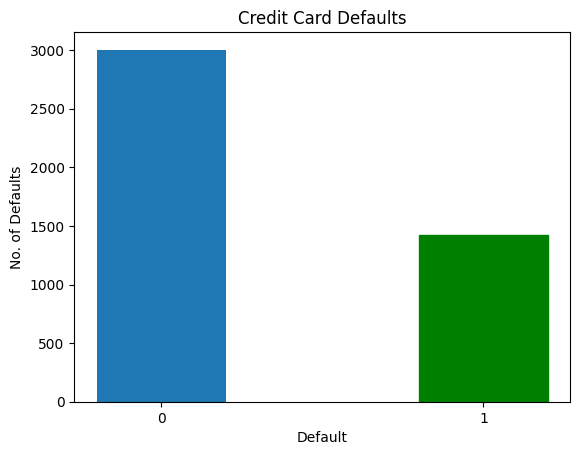

In [33]:
barlist = plt.bar([str(0),str(1)], y.value_counts(), width = 0.4)
barlist[1].set_color('g')

plt.xlabel("Default")
plt.ylabel("No. of Defaults")
plt.title("Credit Card Defaults")
plt.show()

In [34]:
data_total.iloc[:, 20].value_counts()

,count
International,
0,4314
1,110


In [35]:
data2.iloc[:, 20].value_counts()

,count
20,
0.0,4314
1.0,110


# Splitting for Source and Target Domains:


# Full Dataset:

Grouping by 'International': domestic students are source data, international students are target data

In [37]:
data_S = data2[data2.iloc[:,20] <= 0.5].reset_index(drop=True)  ## Source domain and classification - Domestic Students
data_T = data2[data2.iloc[:,20] > 0.5].reset_index(drop=True)  ## Target domain and classification - International Students

In [38]:
data_S

,0,1,2,3,4,5,6,7,8,9,...,27,28,29,30,31,32,33,34,35,Y
0,0.0,0.285714,0.555556,0.013858,1.0,0.000000,0.284211,0.0,0.418605,0.255814,...,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.372093,0.488889,0.766182,1
1,0.0,0.250000,0.111111,0.925989,1.0,0.000000,0.684211,0.0,0.000000,0.046512,...,0.000000,0.260870,0.181818,0.30,0.735897,0.000000,0.732558,0.111111,0.640687,0
2,0.0,0.000000,0.555556,0.907512,1.0,0.000000,0.284211,0.0,0.837209,0.837209,...,0.000000,0.260870,0.000000,0.00,0.000000,0.000000,0.372093,0.488889,0.766182,1
3,0.0,0.285714,0.222222,0.978108,1.0,0.000000,0.284211,0.0,0.860465,0.837209,...,0.000000,0.260870,0.303030,0.25,0.667692,0.000000,0.209302,0.000000,0.124174,0
4,0.2,0.678571,0.111111,0.801466,0.0,0.000000,0.052632,0.0,0.837209,0.860465,...,0.000000,0.260870,0.181818,0.30,0.700000,0.000000,0.732558,0.111111,0.640687,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4309,0.0,0.000000,0.111111,0.907512,1.0,0.000000,0.389474,0.0,0.000000,0.000000,...,0.000000,0.260870,0.181818,0.30,0.726923,0.000000,1.000000,0.244444,0.414795,0
4310,0.0,0.767857,0.111111,0.907512,1.0,0.904762,0.263158,0.0,0.046512,0.860465,...,0.263158,0.391304,0.303030,0.35,0.707692,0.083333,1.000000,0.244444,0.414795,0
4311,0.0,0.000000,0.666667,0.978108,1.0,0.000000,0.315789,0.0,0.000000,0.000000,...,0.000000,0.260870,0.242424,0.25,0.682051,0.000000,0.918605,0.800000,0.000000,0
4312,0.0,0.000000,0.111111,0.950693,1.0,0.000000,0.621053,0.0,0.837209,0.837209,...,0.000000,0.347826,0.272727,0.05,0.726923,0.000000,0.732558,0.111111,0.640687,1


In [39]:
data_T

,0,1,2,3,4,5,6,7,8,9,...,27,28,29,30,31,32,33,34,35,Y
0,0.0,0.000000,0.333333,0.924382,1.0,0.000000,0.442105,0.564815,0.000000,0.000000,...,0.000000,0.260870,0.212121,0.30,0.761538,0.0,1.000000,0.244444,0.414795,0
1,0.0,0.767857,0.111111,0.913537,1.0,0.904762,0.263158,0.046296,0.069767,0.069767,...,0.052632,0.260870,0.333333,0.15,0.646154,0.0,0.558140,0.288889,0.772787,1
2,0.0,0.285714,0.222222,0.978108,1.0,0.000000,0.401053,0.370370,0.418605,0.000000,...,0.000000,0.260870,0.181818,0.30,0.726923,0.0,0.151163,0.488889,1.000000,0
3,0.0,0.250000,0.111111,0.913537,1.0,0.000000,0.401053,0.370370,0.000000,0.000000,...,0.000000,0.260870,0.181818,0.00,0.000000,0.0,0.151163,0.488889,1.000000,1
4,0.0,0.250000,0.111111,0.912432,1.0,0.000000,0.368421,0.231481,0.860465,0.046512,...,0.000000,0.217391,0.333333,0.15,0.713462,0.0,0.732558,0.111111,0.640687,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105,0.0,0.000000,0.111111,0.013858,1.0,0.000000,0.694737,0.370370,0.000000,0.000000,...,0.210526,0.478261,0.363636,0.55,0.807692,0.0,0.151163,0.488889,1.000000,0
106,0.0,0.250000,0.111111,0.915244,1.0,0.000000,0.421053,0.231481,0.000000,0.000000,...,0.000000,0.217391,0.242424,0.20,0.605769,0.0,0.151163,0.488889,1.000000,0
107,0.0,0.000000,0.111111,0.978108,1.0,0.000000,0.305263,0.148148,0.000000,0.000000,...,0.000000,0.260870,0.181818,0.20,0.632692,0.0,1.000000,0.244444,0.414795,1
108,0.0,0.000000,0.222222,0.978108,1.0,0.000000,0.263158,0.962963,0.000000,0.000000,...,0.000000,0.260870,0.181818,0.10,0.592308,0.0,0.406977,0.311111,0.803170,1


## Source domain and task labels:

In [40]:
X_S_full = data_S.iloc[:, :-1]
X_S_full       ## Source domain


y_S_full = data_S.iloc[:, -1]
y_S_full       ## Source classification (response)

,Y
0,1
1,0
2,1
3,0
4,0
...,...
4309,0
4310,0
4311,0
4312,1


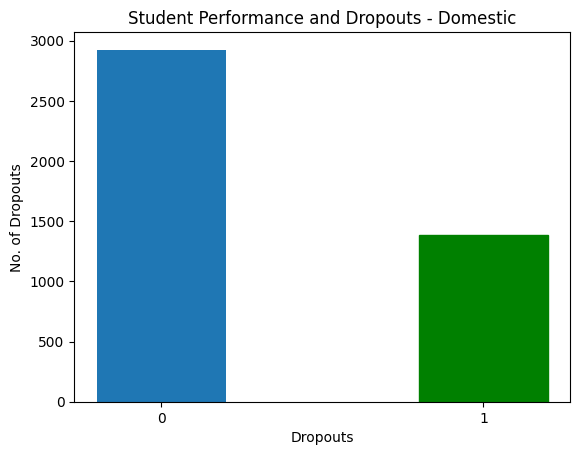

In [43]:
barlist_S = plt.bar([str(0),str(1)], y_S_full.value_counts(), width = 0.4)
barlist_S[1].set_color('g')

plt.xlabel("Dropouts")
plt.ylabel("No. of Dropouts")
plt.title("Student Performance and Dropouts - Domestic")
plt.show()

## Target domain and task labels:

In [44]:
X_T_full = data_T.iloc[:, :-1]
X_T_full       ## Target domain


y_T_full = data_T.iloc[:, -1]
y_T_full       ## Target classification (response)

,Y
0,0
1,1
2,0
3,1
4,0
...,...
105,0
106,0
107,1
108,1


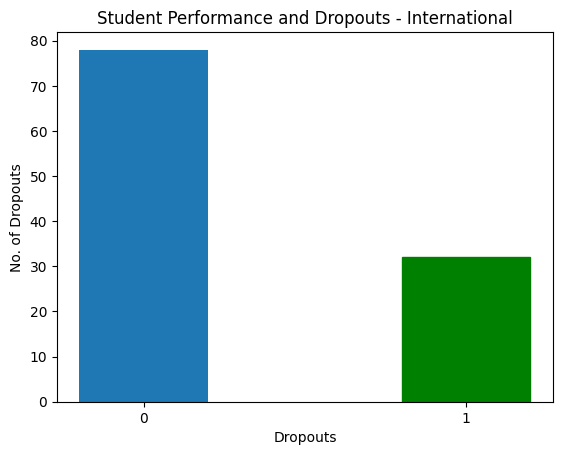

In [45]:
barlist_T = plt.bar([str(0),str(1)], y_T_full.value_counts(), width = 0.4)
barlist_T[1].set_color('g')

plt.xlabel("Dropouts")
plt.ylabel("No. of Dropouts")
plt.title("Student Performance and Dropouts - International")
plt.show()

## Updated Code (Modified from Shreya's code):

In [46]:
def create_dnn_model(input_shape):
  model = models.Sequential([layers.Dense(64, activation='relu', input_dim=input_shape),
        layers.Dense(32, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # For binary classification (yes/no diabetes)
    ])

  model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['AUC'])

  return model



def train_and_evaluate(model, X_train, X_test, y_train, y_test, domain):

    time_start = perf_counter()

    # Training and validation
    model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    # conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    # fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # # ROC Curve
    # ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    # ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    # ax1.set_xlabel('False Positive Rate')
    # ax1.set_ylabel('True Positive Rate')
    # ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    # ax1.legend(loc='lower right')
    # ax1.grid()

    # # Confusion Matrix
    # conf_disp.plot(ax=ax2, cmap='Blues')
    # ax2.set_title('Confusion Matrix')
    # plt.tight_layout()
    # plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)
    return time_elapsed


In [47]:
def Transductive_TL(model, X_test, y_test, domain):

    time_start = perf_counter()

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # ROC Curve
    ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    ax1.set_xlabel('False Positive Rate')
    ax1.set_ylabel('True Positive Rate')
    ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    ax1.legend(loc='lower right')
    ax1.grid()

    # Confusion Matrix
    # print('Confusion matrix:', conf_matrix)
    fpr = conf_matrix[0][1]/(conf_matrix[0][0]+conf_matrix[0][1])
    tnr = 1-fpr

    fnr = conf_matrix[1][0]/(conf_matrix[1][0] + conf_matrix[1][1])
    tpr = 1 - fnr
    print('FPR', fpr, 'TPR:', tpr, 'FNR:', fnr, 'TNR:', tnr)
    conf_disp.plot(ax=ax2, cmap='Blues')
    ax2.set_title('Confusion Matrix')
    plt.tight_layout()
    plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")
    print('False Negative Rate:', fnr)

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)

    return fpr, tnr, fnr, tpr, time_elapsed

In [48]:
X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)

In [49]:
print('X_S_train:',np.shape(X_S_train))
print('y_S_train:',np.shape(y_S_train))
print('X_S_test:',np.shape(X_S_test))
print('y_S_test:',np.shape(y_S_test))

X_S_train: (3451, 36)
y_S_train: (3451,)
X_S_test: (863, 36)
y_S_test: (863,)


In [50]:
model_source = create_dnn_model(X_S_train.shape[1])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.7031 - loss: 0.5839 - val_AUC: 0.8915 - val_loss: 0.4217
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8636 - loss: 0.4144 - val_AUC: 0.9103 - val_loss: 0.3437
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8918 - loss: 0.3626 - val_AUC: 0.9202 - val_loss: 0.3327
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8940 - loss: 0.3564 - val_AUC: 0.9232 - val_loss: 0.3204
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8884 - loss: 0.3634 - val_AUC: 0.9274 - val_loss: 0.3095
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9083 - loss: 0.3338 - val_AUC: 0.9283 - val_loss: 0.3071
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9127 - loss: 0.3245 - val_AUC: 0.9319 - val_loss: 0.3245
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9086 - loss: 0.3366 - val_AUC: 0.9313 - val_loss: 0.3016
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9138 - loss: 0.3236 - va

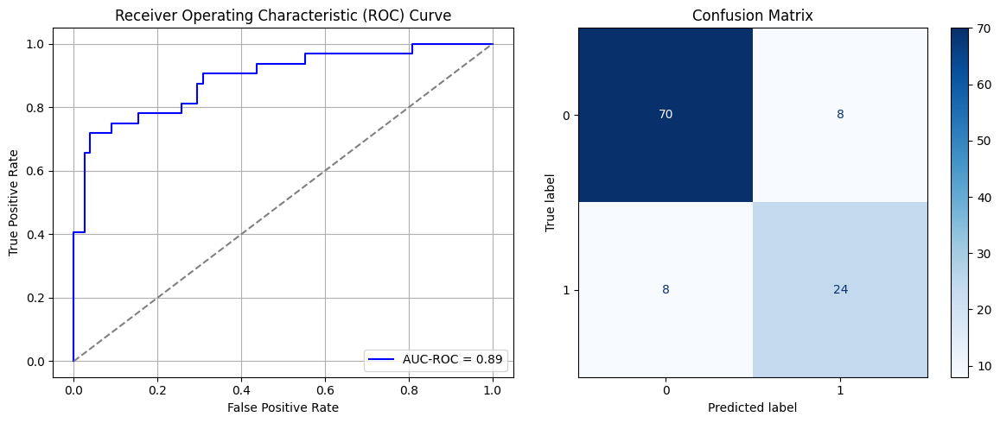

Best threshold based on F1-score: 0.7878816723823547
False Negative Rate: 0.25
Time elapsed (performance): 0.43382612499999595
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6120 - loss: 0.6228 - val_AUC: 0.8826 - val_loss: 0.4503
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8567 - loss: 0.4319 - val_AUC: 0.9081 - val_loss: 0.3478
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8950 - loss: 0.3655 - val_AUC: 0.9183 - val_loss: 0.3261
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8975 - loss: 0.3594 - val_AUC: 0.9250 - val_loss: 0.3111
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8994 - loss: 0.3348 - val_AUC: 0.9291 - val_loss: 0.3114
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9059 - loss: 0.3462 - val_AUC: 0.9289 - val_loss: 0.2995
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9201 - loss: 0.3098 - val_AUC: 0.9328 - val_loss: 0.2971
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9065 - loss: 0.3298 - val_AUC: 0.9324 - val_loss: 0.2928
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9043 - loss: 0.3330 - v

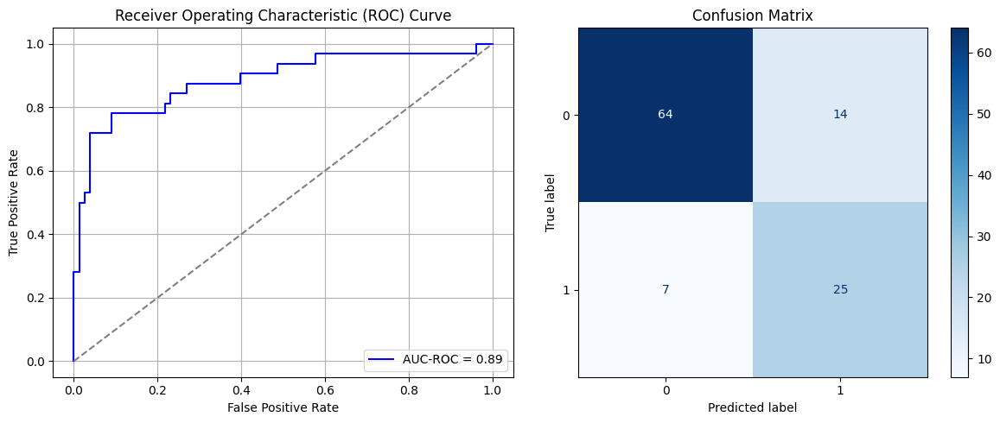

Best threshold based on F1-score: 0.8043175339698792
False Negative Rate: 0.21875
Time elapsed (performance): 0.4383483060000799
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6851 - loss: 0.5807 - val_AUC: 0.8798 - val_loss: 0.4196
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8616 - loss: 0.4224 - val_AUC: 0.9088 - val_loss: 0.3433
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8899 - loss: 0.3557 - val_AUC: 0.9172 - val_loss: 0.3213
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8921 - loss: 0.3518 - val_AUC: 0.9235 - val_loss: 0.3175
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8985 - loss: 0.3522 - val_AUC: 0.9270 - val_loss: 0.3041
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9096 - loss: 0.3269 - val_AUC: 0.9280 - val_loss: 0.3007
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9151 - loss: 0.3235 - val_AUC: 0.9293 - val_loss: 0.2968
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9173 - loss: 0.3210 - val_AUC: 0.9295 - val_loss: 0.3026
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9111 - loss: 0.3258 - va

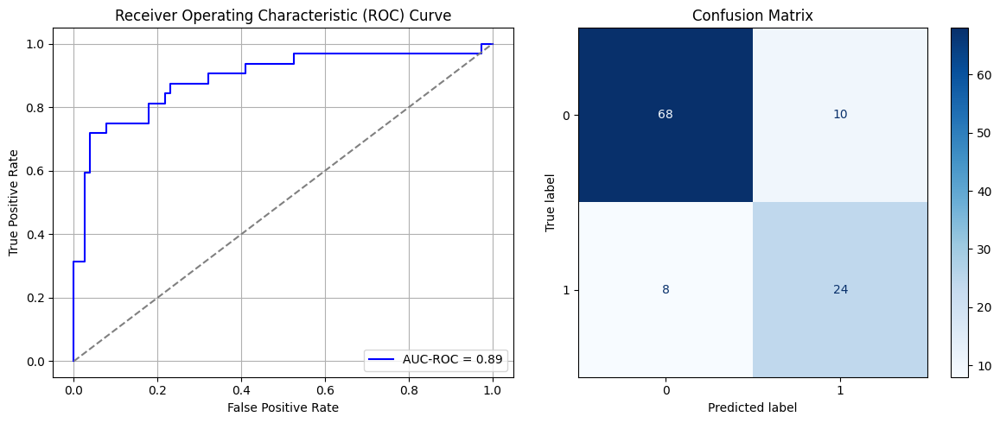

Best threshold based on F1-score: 0.8030918836593628
False Negative Rate: 0.25
Time elapsed (performance): 0.4452077989999452
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.7650 - loss: 0.5612 - val_AUC: 0.8856 - val_loss: 0.4040
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8773 - loss: 0.4073 - val_AUC: 0.9091 - val_loss: 0.3457
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8794 - loss: 0.3892 - val_AUC: 0.9184 - val_loss: 0.3302
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8939 - loss: 0.3574 - val_AUC: 0.9258 - val_loss: 0.3178
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9121 - loss: 0.3281 - val_AUC: 0.9303 - val_loss: 0.3271
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9040 - loss: 0.3346 - val_AUC: 0.9313 - val_loss: 0.2985
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9079 - loss: 0.3254 - val_AUC: 0.9314 - val_loss: 0.2957
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9153 - loss: 0.3127 - val_AUC: 0.9308 - val_loss: 0.3061
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9088 - loss: 0.3251 - va

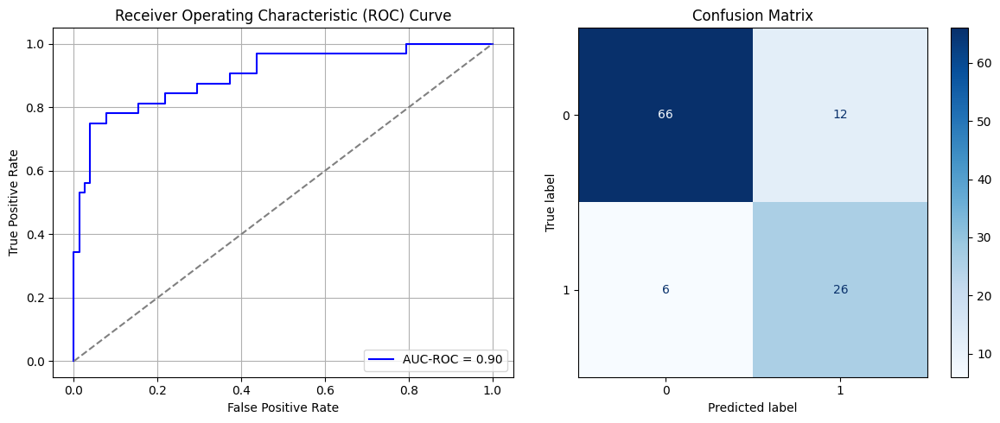

Best threshold based on F1-score: 0.7767171263694763
False Negative Rate: 0.1875
Time elapsed (performance): 0.48395792299993445
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6337 - loss: 0.6054 - val_AUC: 0.8860 - val_loss: 0.4418
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8678 - loss: 0.4384 - val_AUC: 0.9070 - val_loss: 0.3766
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8820 - loss: 0.3896 - val_AUC: 0.9198 - val_loss: 0.3238
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9033 - loss: 0.3456 - val_AUC: 0.9258 - val_loss: 0.3112
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9113 - loss: 0.3341 - val_AUC: 0.9282 - val_loss: 0.3138
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9135 - loss: 0.3333 - val_AUC: 0.9341 - val_loss: 0.2970
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9064 - loss: 0.3349 - val_AUC: 0.9317 - val_loss: 0.2980
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9013 - loss: 0.3479 - val_AUC: 0.9342 - val_loss: 0.2947
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9049 - loss: 0.3372 - va

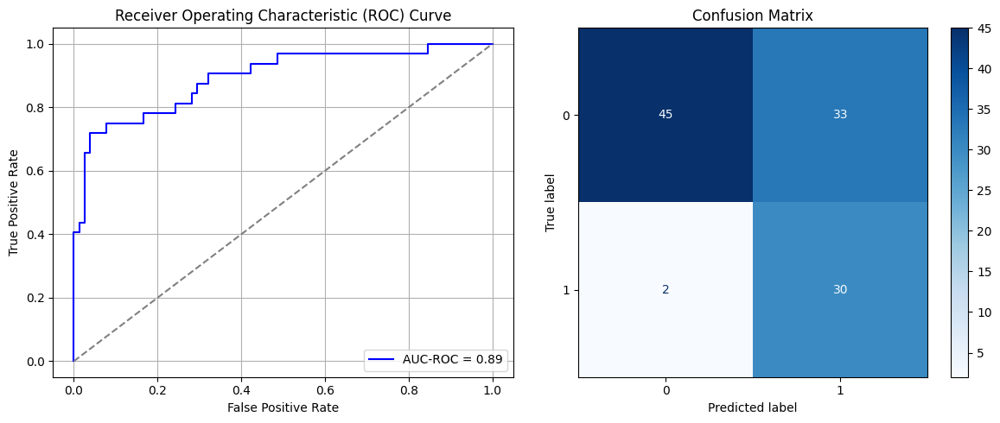

Best threshold based on F1-score: 0.9513648748397827
False Negative Rate: 0.0625
Time elapsed (performance): 0.6654027980000592
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7866 - loss: 0.5446 - val_AUC: 0.8964 - val_loss: 0.3931
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8809 - loss: 0.3957 - val_AUC: 0.9153 - val_loss: 0.3388
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8952 - loss: 0.3586 - val_AUC: 0.9259 - val_loss: 0.3432
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9012 - loss: 0.3475 - val_AUC: 0.9256 - val_loss: 0.3098
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8970 - loss: 0.3546 - val_AUC: 0.9299 - val_loss: 0.3118
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9073 - loss: 0.3350 - val_AUC: 0.9288 - val_loss: 0.3007
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9191 - loss: 0.3116 - val_AUC: 0.9301 - val_loss: 0.2990
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9216 - loss: 0.3039 - val_AUC: 0.9331 - val_loss: 0.2944
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9169 - loss: 0.3262 - va

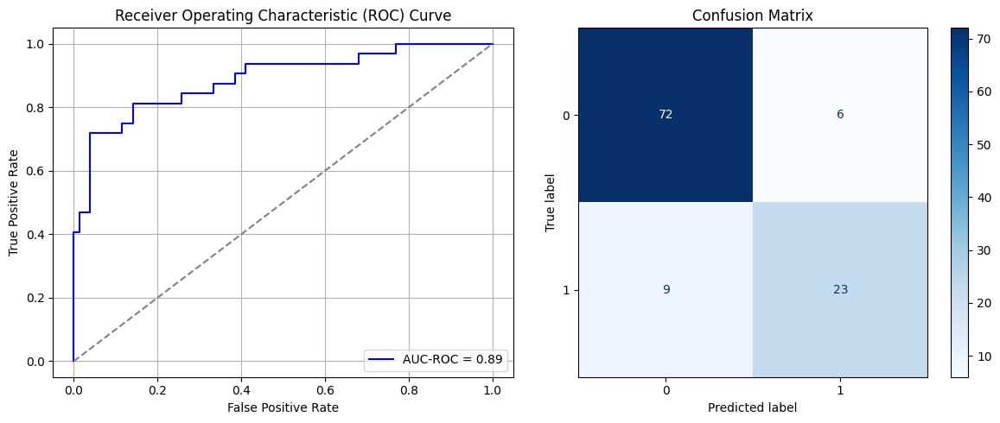

Best threshold based on F1-score: 0.7712447047233582
False Negative Rate: 0.28125
Time elapsed (performance): 0.47438621899982536


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7812 - loss: 0.5494 - val_AUC: 0.8902 - val_loss: 0.3962
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8630 - loss: 0.4112 - val_AUC: 0.9104 - val_loss: 0.3413
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8983 - loss: 0.3469 - val_AUC: 0.9185 - val_loss: 0.3336
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8863 - loss: 0.3717 - val_AUC: 0.9244 - val_loss: 0.3132
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9040 - loss: 0.3287 - val_AUC: 0.9258 - val_loss: 0.3093
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9112 - loss: 0.3209 - val_AUC: 0.9312 - val_loss: 0.3181
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9067 - loss: 0.3406 - val_AUC: 0.9255 - val_loss: 0.3204
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9135 - loss: 0.3192 - val_AUC: 0.9320 - val_loss: 0.3083
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9180 - loss: 

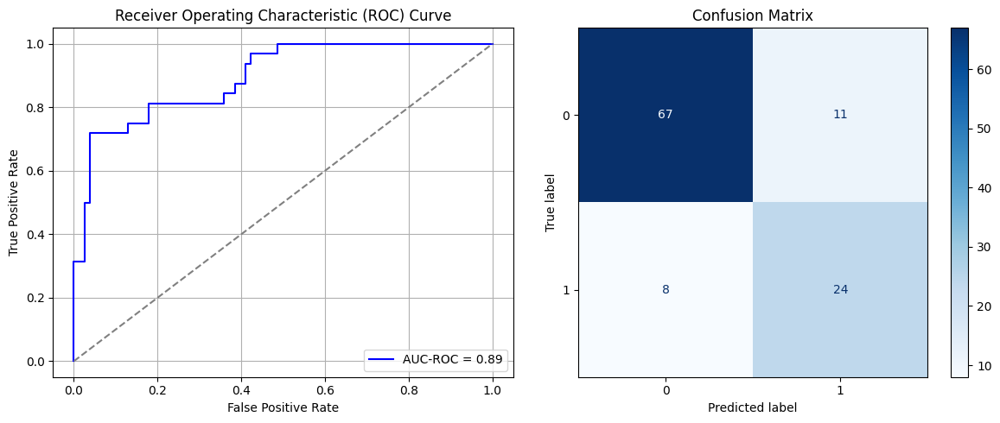

Best threshold based on F1-score: 0.7500587105751038
False Negative Rate: 0.25
Time elapsed (performance): 0.4684462769998845
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6680 - loss: 0.6103 - val_AUC: 0.8932 - val_loss: 0.4123
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8659 - loss: 0.4230 - val_AUC: 0.9063 - val_loss: 0.3548
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8910 - loss: 0.3640 - val_AUC: 0.9084 - val_loss: 0.3388
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8913 - loss: 0.3551 - val_AUC: 0.9181 - val_loss: 0.3203
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9117 - loss: 0.3302 - val_AUC: 0.9212 - val_loss: 0.3143
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9045 - loss: 0.3346 - val_AUC: 0.9198 - val_loss: 0.3210
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9065 - loss: 0.3264 - val_AUC: 0.9258 - val_loss: 0.3244
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9160 - loss: 0.3238 - val_AUC: 0.9270 - val_loss: 0.3025
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9061 - loss: 0.3280 - va

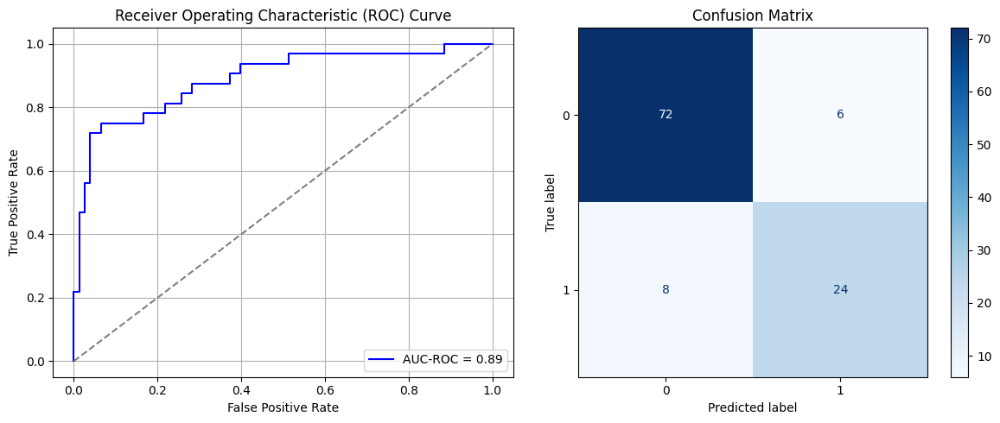

Best threshold based on F1-score: 0.7473415732383728
False Negative Rate: 0.25
Time elapsed (performance): 0.6425717020001684
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6623 - loss: 0.5903 - val_AUC: 0.8997 - val_loss: 0.4199
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8730 - loss: 0.4196 - val_AUC: 0.9152 - val_loss: 0.3451
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.3824 - val_AUC: 0.9212 - val_loss: 0.3198
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9040 - loss: 0.3377 - val_AUC: 0.9259 - val_loss: 0.3106
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9036 - loss: 0.3430 - val_AUC: 0.9292 - val_loss: 0.3035
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9125 - loss: 0.3151 - val_AUC: 0.9311 - val_loss: 0.3025
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9128 - loss: 0.3222 - val_AUC: 0.9320 - val_loss: 0.3068
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9095 - loss: 0.3316 - val_AUC: 0.9310 - val_loss: 0.2968
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9106 - loss: 0.3267 - va

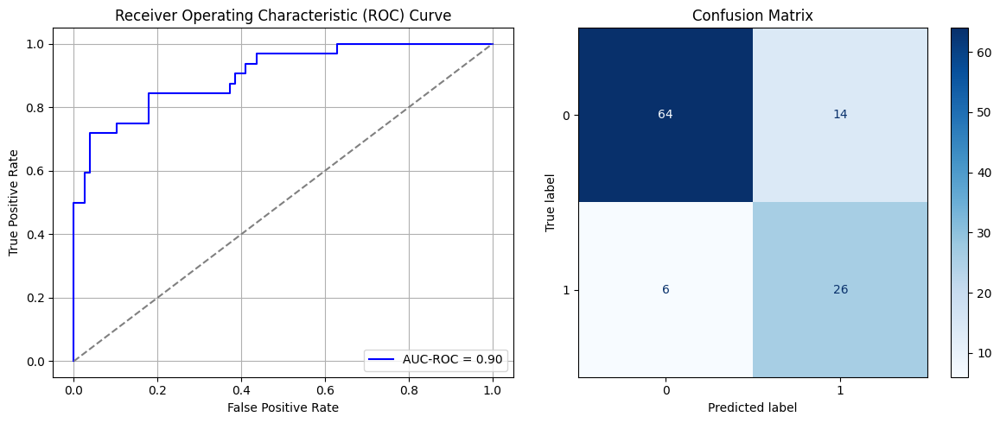

Best threshold based on F1-score: 0.8767850399017334
False Negative Rate: 0.1875
Time elapsed (performance): 0.47973930500006645
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7144 - loss: 0.5831 - val_AUC: 0.8910 - val_loss: 0.4117
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8767 - loss: 0.4037 - val_AUC: 0.9090 - val_loss: 0.3425
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8857 - loss: 0.3695 - val_AUC: 0.9171 - val_loss: 0.3224
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8887 - loss: 0.3584 - val_AUC: 0.9204 - val_loss: 0.3287
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9113 - loss: 0.3208 - val_AUC: 0.9236 - val_loss: 0.3100
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9093 - loss: 0.3263 - val_AUC: 0.9256 - val_loss: 0.3086
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9102 - loss: 0.3361 - val_AUC: 0.9278 - val_loss: 0.3006
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9229 - loss: 0.3048 - val_AUC: 0.9290 - val_loss: 0.3064
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9026 - loss: 0.3380 - va

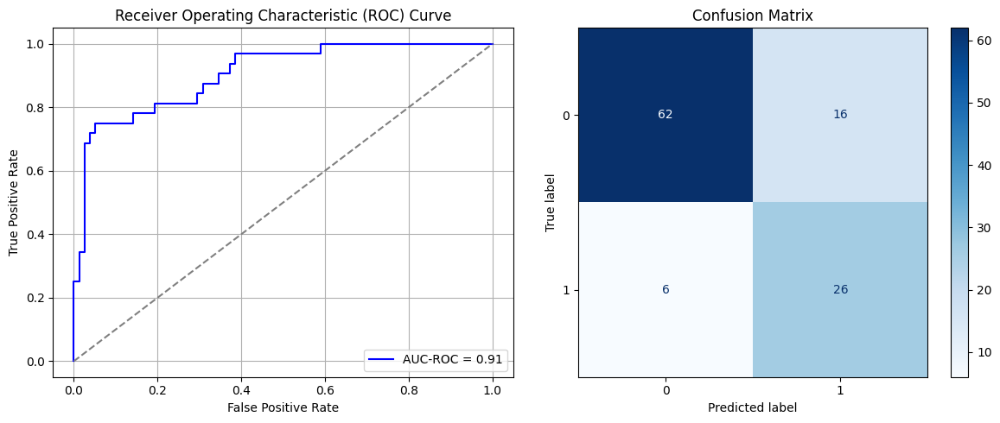

Best threshold based on F1-score: 0.8174147605895996
False Negative Rate: 0.1875
Time elapsed (performance): 0.48962168699995345
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7086 - loss: 0.5866 - val_AUC: 0.8977 - val_loss: 0.4009
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8723 - loss: 0.4085 - val_AUC: 0.9122 - val_loss: 0.3426
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8861 - loss: 0.3760 - val_AUC: 0.9210 - val_loss: 0.3210
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8964 - loss: 0.3520 - val_AUC: 0.9249 - val_loss: 0.3115
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9151 - loss: 0.3183 - val_AUC: 0.9280 - val_loss: 0.3074
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9124 - loss: 0.3317 - val_AUC: 0.9302 - val_loss: 0.3000
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9182 - loss: 0.3179 - val_AUC: 0.9307 - val_loss: 0.2981
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9123 - loss: 0.3253 - val_AUC: 0.9308 - val_loss: 0.2991
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9145 - loss: 0.3280 - va

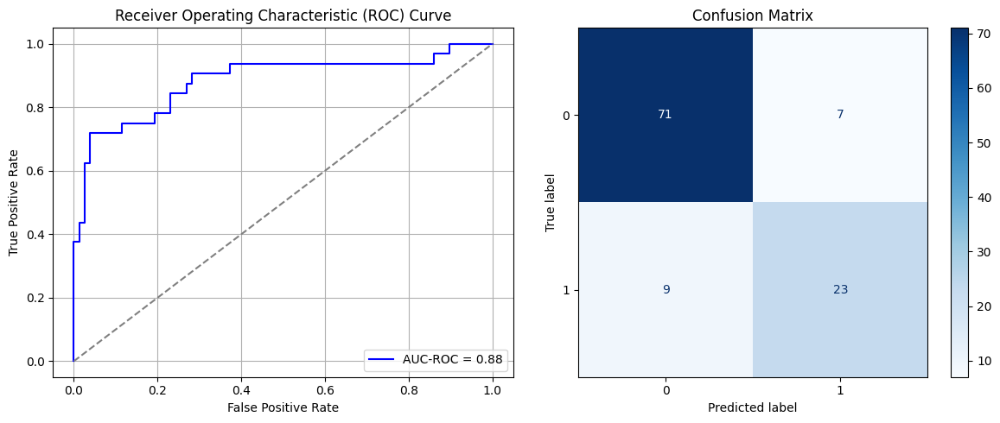

Best threshold based on F1-score: 0.6234731078147888
False Negative Rate: 0.28125
Time elapsed (performance): 0.6874961859998621
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.7373 - loss: 0.5514 - val_AUC: 0.8865 - val_loss: 0.3988
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8729 - loss: 0.4108 - val_AUC: 0.9093 - val_loss: 0.3506
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8980 - loss: 0.3560 - val_AUC: 0.9175 - val_loss: 0.3397
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8983 - loss: 0.3530 - val_AUC: 0.9245 - val_loss: 0.3169
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9073 - loss: 0.3376 - val_AUC: 0.9257 - val_loss: 0.3070
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9158 - loss: 0.3304 - val_AUC: 0.9292 - val_loss: 0.3076
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9150 - loss: 0.3248 - val_AUC: 0.9282 - val_loss: 0.3007
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9130 - loss: 0.3174 - val_AUC: 0.9331 - val_loss: 0.2937
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9056 - loss: 0.3375 - va

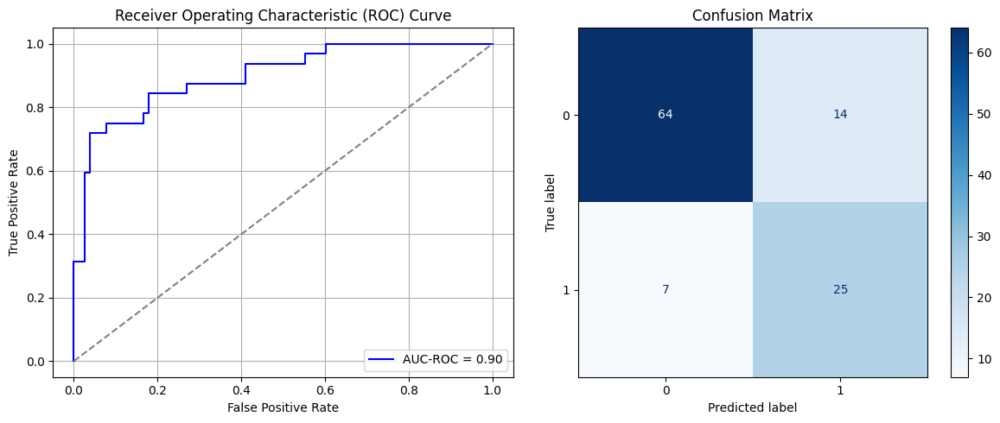

Best threshold based on F1-score: 0.7482386827468872
False Negative Rate: 0.21875
Time elapsed (performance): 0.46163683700001457
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6926 - loss: 0.5884 - val_AUC: 0.8865 - val_loss: 0.4034
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8740 - loss: 0.4098 - val_AUC: 0.9059 - val_loss: 0.3457
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8886 - loss: 0.3637 - val_AUC: 0.9145 - val_loss: 0.3309
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8957 - loss: 0.3471 - val_AUC: 0.9193 - val_loss: 0.3225
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9137 - loss: 0.3237 - val_AUC: 0.9234 - val_loss: 0.3117
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9033 - loss: 0.3426 - val_AUC: 0.9262 - val_loss: 0.3151
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9083 - loss: 0.3313 - val_AUC: 0.9276 - val_loss: 0.3027
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9019 - loss: 0.3453 - val_AUC: 0.9304 - val_loss: 0.2981
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9172 - loss: 0.3095 - va

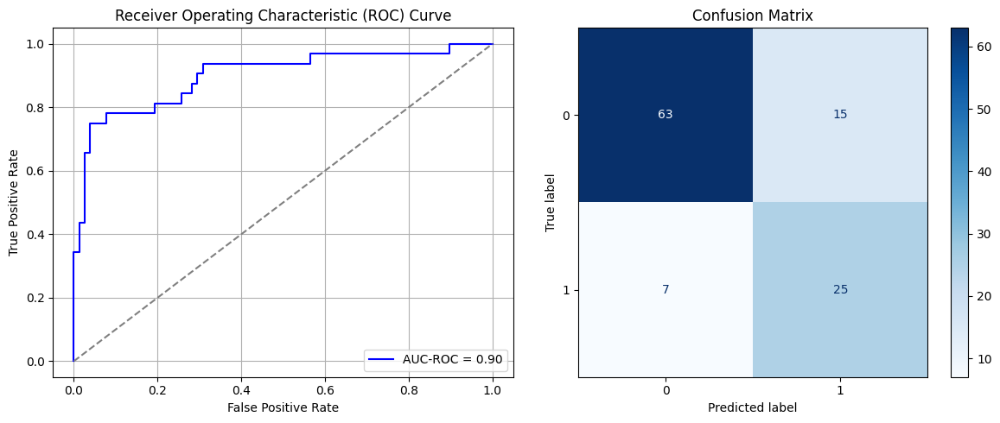

Best threshold based on F1-score: 0.7805712223052979
False Negative Rate: 0.21875
Time elapsed (performance): 0.4874335730000894
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7937 - loss: 0.5418 - val_AUC: 0.8897 - val_loss: 0.3946
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8685 - loss: 0.4031 - val_AUC: 0.9086 - val_loss: 0.3509
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 - loss: 0.3787 - val_AUC: 0.9151 - val_loss: 0.3322
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8923 - loss: 0.3523 - val_AUC: 0.9221 - val_loss: 0.3104
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9089 - loss: 0.3337 - val_AUC: 0.9252 - val_loss: 0.3050
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9248 - loss: 0.3075 - val_AUC: 0.9275 - val_loss: 0.3080
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9083 - loss: 0.3316 - val_AUC: 0.9302 - val_loss: 0.3030
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9117 - loss: 0.3272 - val_AUC: 0.9302 - val_loss: 0.2958
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9138 - loss: 0.3157 - va

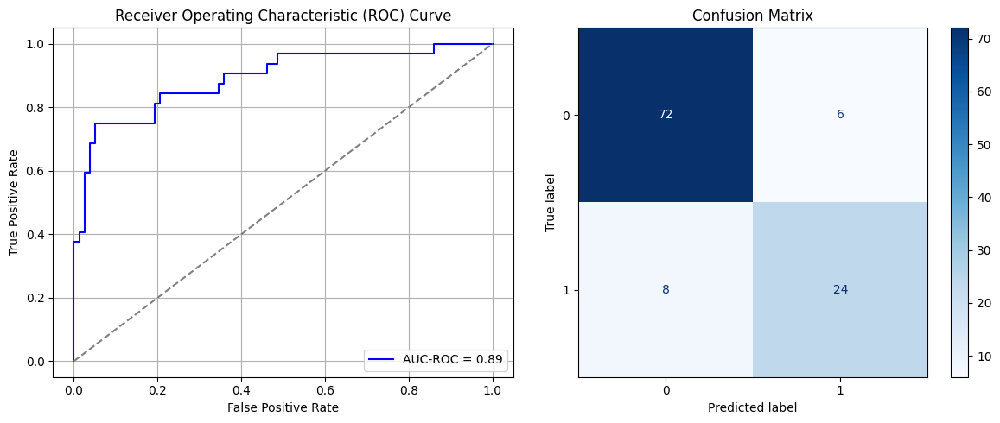

Best threshold based on F1-score: 0.6341149806976318
False Negative Rate: 0.25
Time elapsed (performance): 0.43891436099988823
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - AUC: 0.7202 - loss: 0.5765 - val_AUC: 0.8900 - val_loss: 0.4013
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8785 - loss: 0.3911 - val_AUC: 0.9060 - val_loss: 0.3480
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8877 - loss: 0.3753 - val_AUC: 0.9132 - val_loss: 0.3337
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9029 - loss: 0.3345 - val_AUC: 0.9201 - val_loss: 0.3235
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9028 - loss: 0.3441 - val_AUC: 0.9233 - val_loss: 0.3123
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9004 - loss: 0.3492 - val_AUC: 0.9260 - val_loss: 0.3229
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9028 - loss: 0.3465 - val_AUC: 0.9266 - val_loss: 0.3043
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9109 - loss: 0.3282 - val_AUC: 0.9231 - val_loss: 0.3144
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9191 - loss: 0.3141 - v

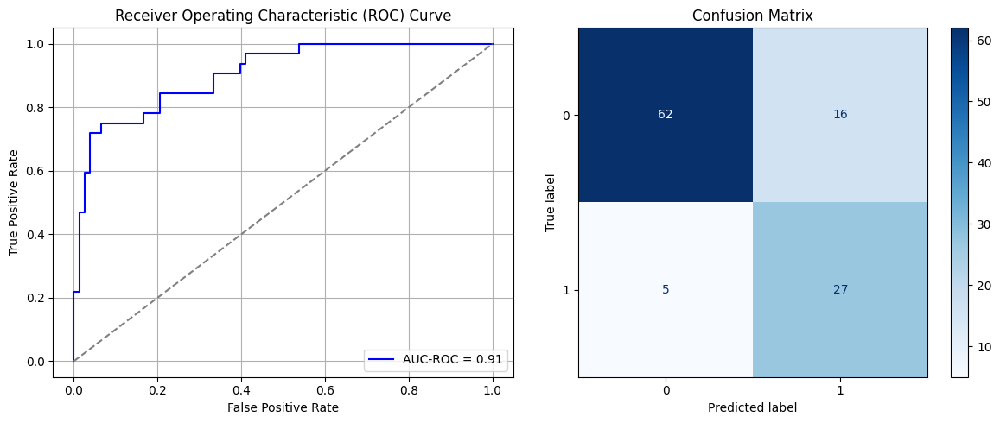

Best threshold based on F1-score: 0.8915575742721558
False Negative Rate: 0.15625
Time elapsed (performance): 0.4572473659998195
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6378 - loss: 0.6374 - val_AUC: 0.8881 - val_loss: 0.4404
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8438 - loss: 0.4426 - val_AUC: 0.9087 - val_loss: 0.3492
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8878 - loss: 0.3658 - val_AUC: 0.9157 - val_loss: 0.3381
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9058 - loss: 0.3399 - val_AUC: 0.9231 - val_loss: 0.3208
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9015 - loss: 0.3518 - val_AUC: 0.9274 - val_loss: 0.3157
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9054 - loss: 0.3344 - val_AUC: 0.9287 - val_loss: 0.3103
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9079 - loss: 0.3330 - val_AUC: 0.9324 - val_loss: 0.3034
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9031 - loss: 0.3326 - val_AUC: 0.9310 - val_loss: 0.3058
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9190 - loss: 0.3169 - va

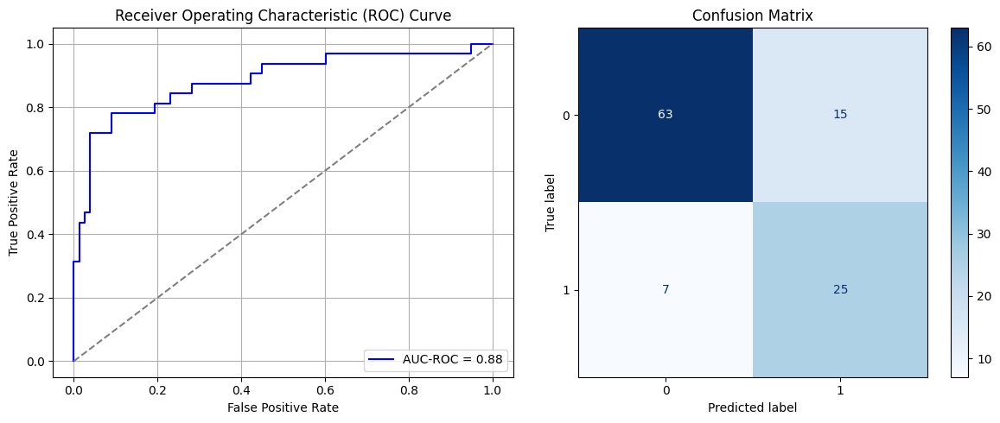

Best threshold based on F1-score: 0.8418458700180054
False Negative Rate: 0.21875
Time elapsed (performance): 0.4428588299999774
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6565 - loss: 0.5861 - val_AUC: 0.8835 - val_loss: 0.4423
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8546 - loss: 0.4387 - val_AUC: 0.9040 - val_loss: 0.3717
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8907 - loss: 0.3742 - val_AUC: 0.9177 - val_loss: 0.3386
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9088 - loss: 0.3384 - val_AUC: 0.9233 - val_loss: 0.3178
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9086 - loss: 0.3362 - val_AUC: 0.9288 - val_loss: 0.3129
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9084 - loss: 0.3357 - val_AUC: 0.9297 - val_loss: 0.3013
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9039 - loss: 0.3447 - val_AUC: 0.9323 - val_loss: 0.2976
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9152 - loss: 0.3193 - val_AUC: 0.9341 - val_loss: 0.3030
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9108 - loss: 0.3306 - va

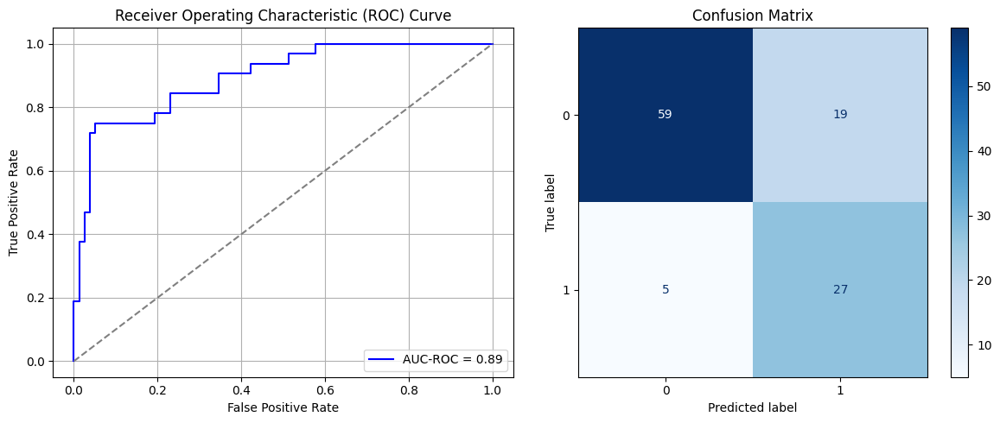

Best threshold based on F1-score: 0.7738766670227051
False Negative Rate: 0.15625
Time elapsed (performance): 0.45954107100010333
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - AUC: 0.6706 - loss: 0.5868 - val_AUC: 0.8963 - val_loss: 0.4098
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8741 - loss: 0.4091 - val_AUC: 0.9112 - val_loss: 0.3423
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8919 - loss: 0.3701 - val_AUC: 0.9209 - val_loss: 0.3226
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8869 - loss: 0.3610 - val_AUC: 0.9244 - val_loss: 0.3117
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8997 - loss: 0.3360 - val_AUC: 0.9264 - val_loss: 0.3076
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9117 - loss: 0.3316 - val_AUC: 0.9289 - val_loss: 0.3043
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9118 - loss: 0.3312 - val_AUC: 0.9301 - val_loss: 0.3000
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9116 - loss: 0.3282 - val_AUC: 0.9316 - val_loss: 0.2949
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9043 - loss: 0.3298 - v

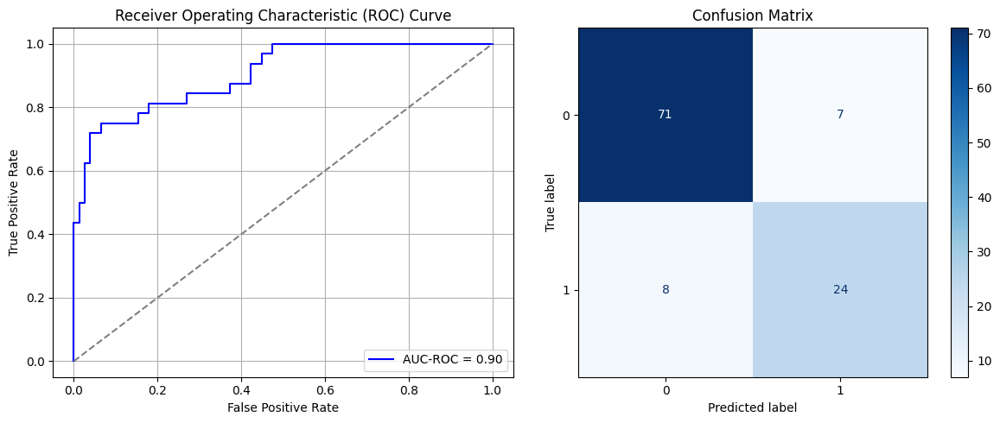

Best threshold based on F1-score: 0.7615766525268555
False Negative Rate: 0.25
Time elapsed (performance): 0.4812046189999819
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6355 - loss: 0.6231 - val_AUC: 0.8850 - val_loss: 0.4424
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8688 - loss: 0.4191 - val_AUC: 0.9049 - val_loss: 0.3616
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8976 - loss: 0.3519 - val_AUC: 0.9144 - val_loss: 0.3287
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8920 - loss: 0.3562 - val_AUC: 0.9193 - val_loss: 0.3183
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9045 - loss: 0.3462 - val_AUC: 0.9230 - val_loss: 0.3094
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9184 - loss: 0.3223 - val_AUC: 0.9267 - val_loss: 0.3043
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9142 - loss: 0.3240 - val_AUC: 0.9294 - val_loss: 0.3027
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9237 - loss: 0.3043 - val_AUC: 0.9281 - val_loss: 0.3004
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9194 - loss: 0.3104 - va

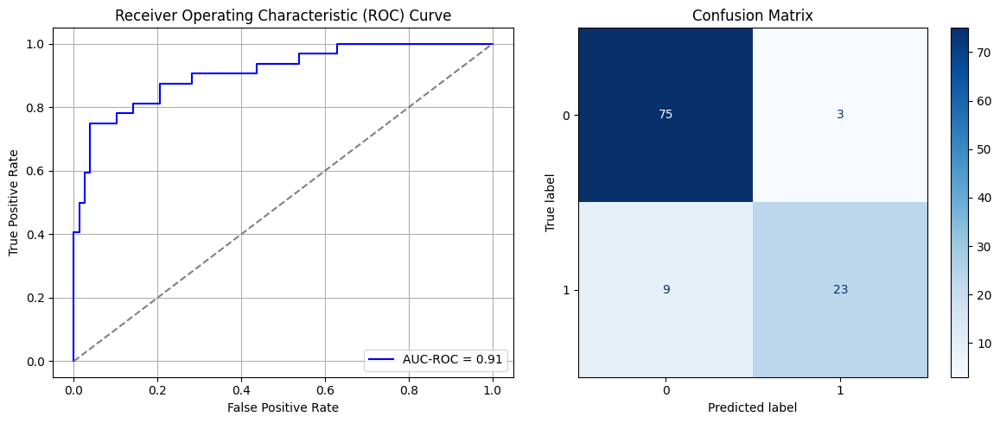

Best threshold based on F1-score: 0.45913970470428467
False Negative Rate: 0.28125
Time elapsed (performance): 0.4711749670000245
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.5481 - loss: 0.6703 - val_AUC: 0.8806 - val_loss: 0.4616
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8566 - loss: 0.4430 - val_AUC: 0.9043 - val_loss: 0.3683
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8912 - loss: 0.3760 - val_AUC: 0.9148 - val_loss: 0.3399
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8827 - loss: 0.3801 - val_AUC: 0.9198 - val_loss: 0.3210
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9119 - loss: 0.3289 - val_AUC: 0.9267 - val_loss: 0.3140
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9074 - loss: 0.3356 - val_AUC: 0.9261 - val_loss: 0.3076
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9109 - loss: 0.3239 - val_AUC: 0.9268 - val_loss: 0.3039
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9073 - loss: 0.3299 - val_AUC: 0.9264 - val_loss: 0.3041
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9088 - loss: 0.3429 - va

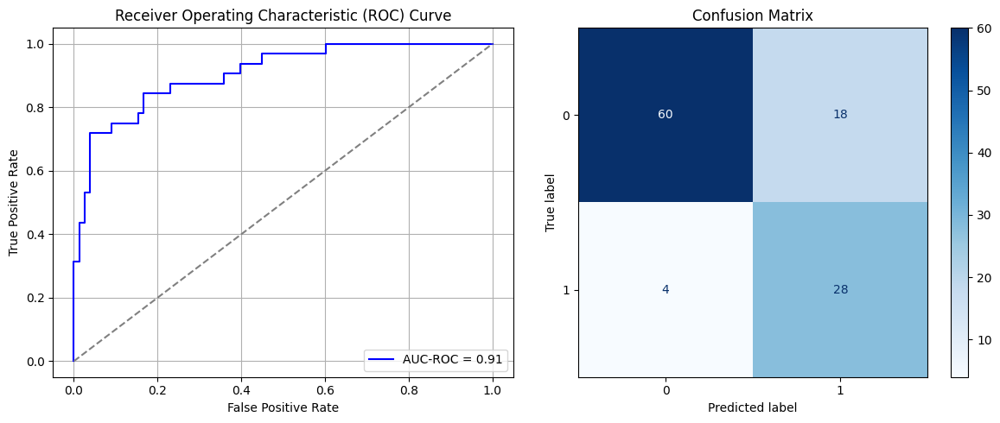

Best threshold based on F1-score: 0.8622244596481323
False Negative Rate: 0.125
Time elapsed (performance): 0.6803272499998911
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6671 - loss: 0.5865 - val_AUC: 0.8989 - val_loss: 0.3785
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8636 - loss: 0.4086 - val_AUC: 0.9138 - val_loss: 0.3307
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9002 - loss: 0.3367 - val_AUC: 0.9178 - val_loss: 0.3196
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8999 - loss: 0.3575 - val_AUC: 0.9237 - val_loss: 0.3263
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8971 - loss: 0.3450 - val_AUC: 0.9251 - val_loss: 0.3093
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9103 - loss: 0.3264 - val_AUC: 0.9275 - val_loss: 0.3049
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9051 - loss: 0.3381 - val_AUC: 0.9303 - val_loss: 0.2987
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9141 - loss: 0.3206 - val_AUC: 0.9317 - val_loss: 0.2978
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9132 - loss: 0.3245 - va

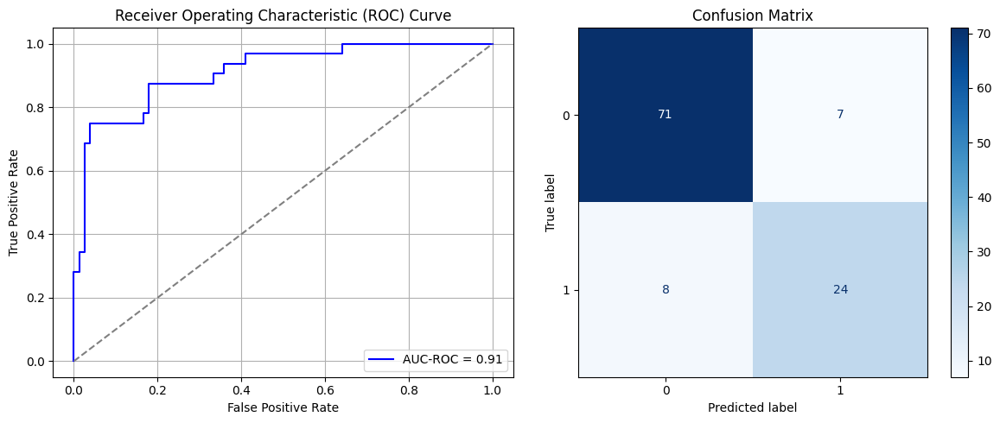

Best threshold based on F1-score: 0.6376096606254578
False Negative Rate: 0.25
Time elapsed (performance): 0.4878495650000332
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6811 - loss: 0.6059 - val_AUC: 0.8950 - val_loss: 0.3959
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8785 - loss: 0.3887 - val_AUC: 0.9104 - val_loss: 0.3434
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8811 - loss: 0.3708 - val_AUC: 0.9185 - val_loss: 0.3243
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9020 - loss: 0.3471 - val_AUC: 0.9256 - val_loss: 0.3176
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9051 - loss: 0.3434 - val_AUC: 0.9272 - val_loss: 0.3066
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9120 - loss: 0.3309 - val_AUC: 0.9285 - val_loss: 0.3045
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9004 - loss: 0.3471 - val_AUC: 0.9295 - val_loss: 0.2998
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9077 - loss: 0.3364 - val_AUC: 0.9304 - val_loss: 0.2972
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9041 - loss: 0.3457 - va

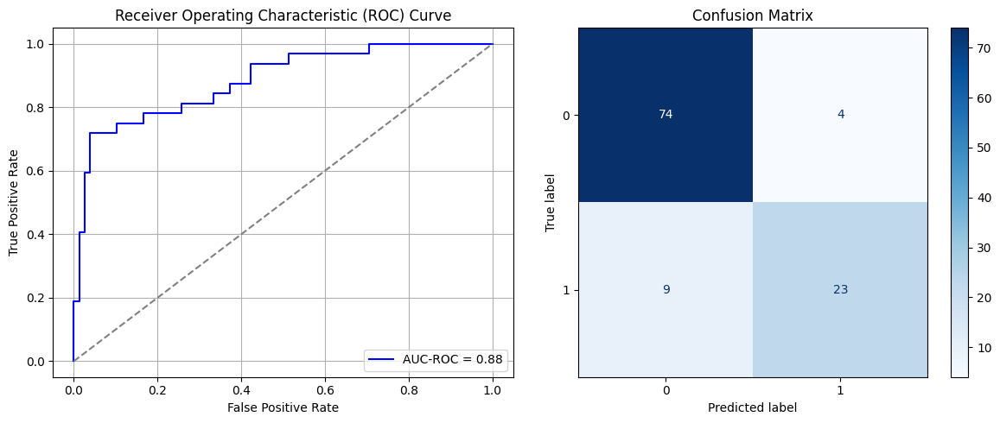

Best threshold based on F1-score: 0.6397448778152466
False Negative Rate: 0.28125
Time elapsed (performance): 0.4739132030001656
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6706 - loss: 0.5949 - val_AUC: 0.8887 - val_loss: 0.4245
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8676 - loss: 0.4175 - val_AUC: 0.9094 - val_loss: 0.3470
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9003 - loss: 0.3541 - val_AUC: 0.9194 - val_loss: 0.3319
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8976 - loss: 0.3520 - val_AUC: 0.9210 - val_loss: 0.3169
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9080 - loss: 0.3433 - val_AUC: 0.9229 - val_loss: 0.3208
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9094 - loss: 0.3232 - val_AUC: 0.9274 - val_loss: 0.3052
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9167 - loss: 0.3269 - val_AUC: 0.9289 - val_loss: 0.3033
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9178 - loss: 0.3256 - val_AUC: 0.9308 - val_loss: 0.2970
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9173 - loss: 0.3117 - va

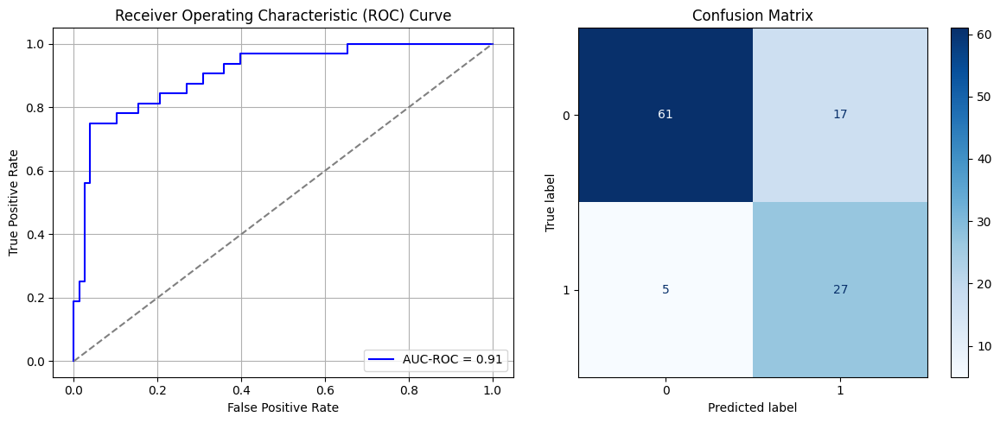

Best threshold based on F1-score: 0.8111739158630371
False Negative Rate: 0.15625
Time elapsed (performance): 0.6718676759999198
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.7526 - loss: 0.5410 - val_AUC: 0.8917 - val_loss: 0.3948
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8855 - loss: 0.3811 - val_AUC: 0.9148 - val_loss: 0.3583
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8930 - loss: 0.3577 - val_AUC: 0.9229 - val_loss: 0.3186
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8944 - loss: 0.3576 - val_AUC: 0.9255 - val_loss: 0.3150
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8943 - loss: 0.3559 - val_AUC: 0.9276 - val_loss: 0.3059
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9209 - loss: 0.3065 - val_AUC: 0.9321 - val_loss: 0.3060
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9157 - loss: 0.3239 - val_AUC: 0.9308 - val_loss: 0.2973
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9232 - loss: 0.3048 - val_AUC: 0.9298 - val_loss: 0.3165
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9186 - loss: 0.3189 - va

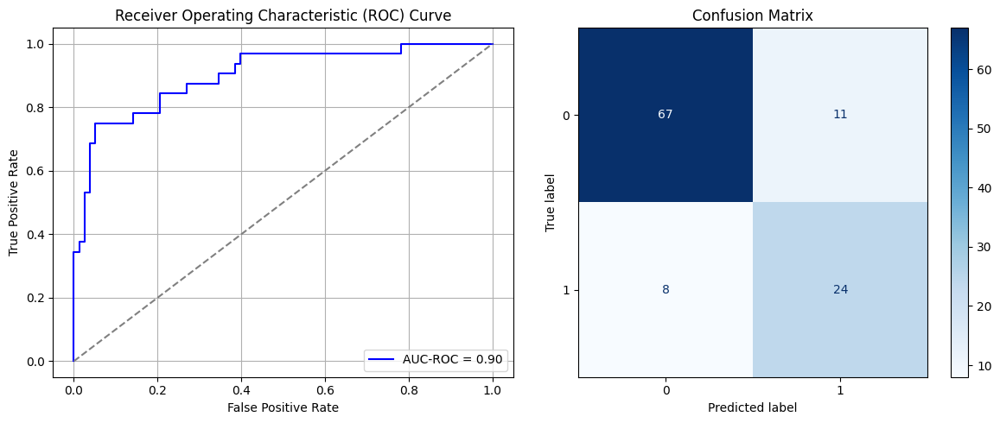

Best threshold based on F1-score: 0.7016127705574036
False Negative Rate: 0.25
Time elapsed (performance): 0.46571825699993497
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7736 - loss: 0.5534 - val_AUC: 0.8944 - val_loss: 0.3924
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8830 - loss: 0.3880 - val_AUC: 0.9108 - val_loss: 0.3533
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8923 - loss: 0.3696 - val_AUC: 0.9187 - val_loss: 0.3238
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9103 - loss: 0.3330 - val_AUC: 0.9249 - val_loss: 0.3152
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9015 - loss: 0.3453 - val_AUC: 0.9260 - val_loss: 0.3090
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9020 - loss: 0.3382 - val_AUC: 0.9283 - val_loss: 0.3021
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9008 - loss: 0.3330 - val_AUC: 0.9303 - val_loss: 0.2984
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9109 - loss: 0.3295 - val_AUC: 0.9272 - val_loss: 0.3052
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9094 - loss: 0.3286 - va

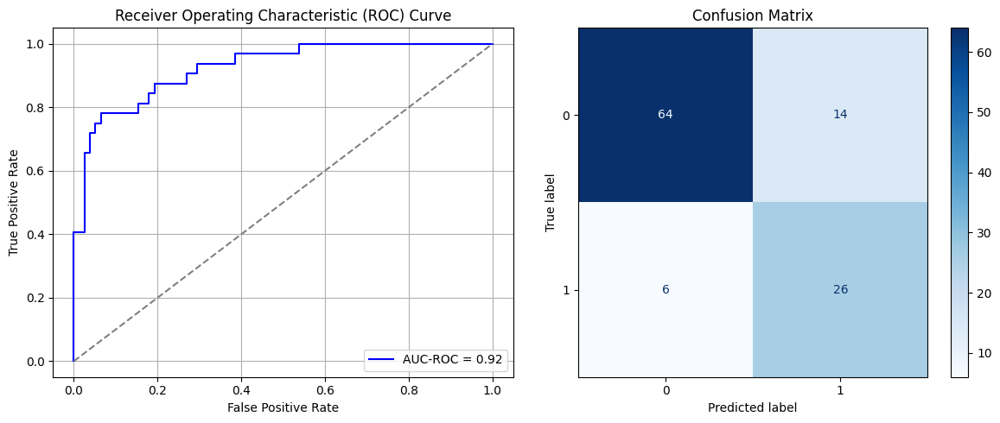

Best threshold based on F1-score: 0.7604588270187378
False Negative Rate: 0.1875
Time elapsed (performance): 0.49280565999993087
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7379 - loss: 0.5684 - val_AUC: 0.8839 - val_loss: 0.4335
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8705 - loss: 0.4184 - val_AUC: 0.9060 - val_loss: 0.3572
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8956 - loss: 0.3577 - val_AUC: 0.9190 - val_loss: 0.3295
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8990 - loss: 0.3541 - val_AUC: 0.9228 - val_loss: 0.3153
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9024 - loss: 0.3462 - val_AUC: 0.9296 - val_loss: 0.3037
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9148 - loss: 0.3186 - val_AUC: 0.9307 - val_loss: 0.3189
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9117 - loss: 0.3219 - val_AUC: 0.9305 - val_loss: 0.2986
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8999 - loss: 0.3372 - val_AUC: 0.9328 - val_loss: 0.2948
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9060 - loss: 0.3358 - va

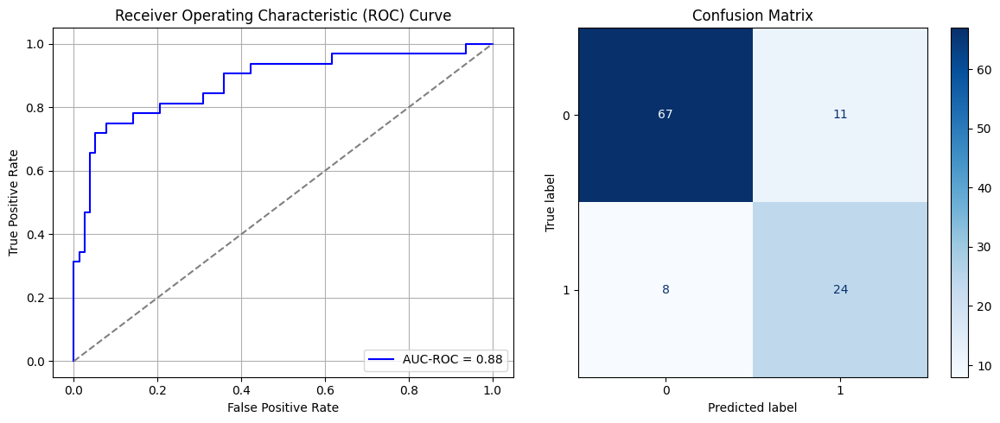

Best threshold based on F1-score: 0.7521726489067078
False Negative Rate: 0.25
Time elapsed (performance): 0.700428957999975
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7754 - loss: 0.5336 - val_AUC: 0.8962 - val_loss: 0.4008
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8762 - loss: 0.4094 - val_AUC: 0.9092 - val_loss: 0.3469
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8819 - loss: 0.3724 - val_AUC: 0.9178 - val_loss: 0.3398
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8931 - loss: 0.3613 - val_AUC: 0.9226 - val_loss: 0.3174
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9097 - loss: 0.3280 - val_AUC: 0.9258 - val_loss: 0.3079
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9006 - loss: 0.3478 - val_AUC: 0.9276 - val_loss: 0.3052
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9060 - loss: 0.3372 - val_AUC: 0.9293 - val_loss: 0.2994
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9027 - loss: 0.3481 - val_AUC: 0.9290 - val_loss: 0.2959
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9106 - loss: 0.3302 - va

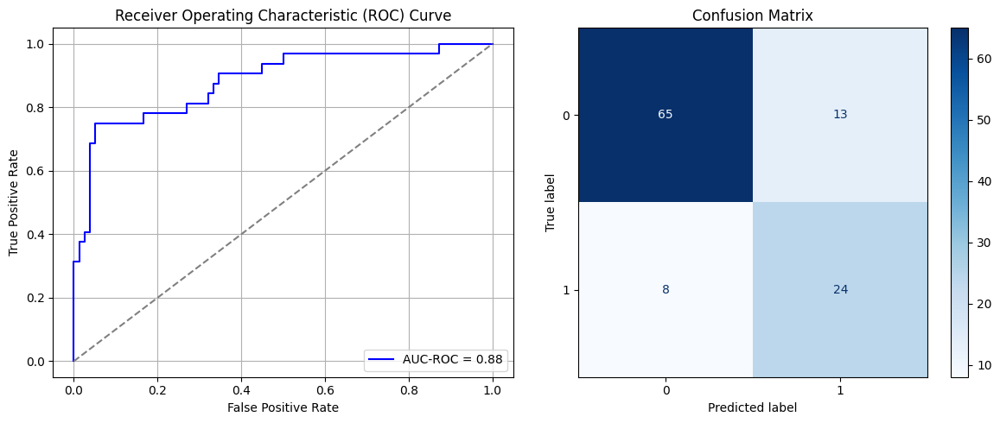

Best threshold based on F1-score: 0.847000241279602
False Negative Rate: 0.25
Time elapsed (performance): 0.473177048000025
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - AUC: 0.7241 - loss: 0.5764 - val_AUC: 0.8901 - val_loss: 0.4042
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8763 - loss: 0.4098 - val_AUC: 0.9053 - val_loss: 0.3569
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 - loss: 0.3703 - val_AUC: 0.9138 - val_loss: 0.3397
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8891 - loss: 0.3649 - val_AUC: 0.9168 - val_loss: 0.3316
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9016 - loss: 0.3351 - val_AUC: 0.9233 - val_loss: 0.3153
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9086 - loss: 0.3275 - val_AUC: 0.9271 - val_loss: 0.3085
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8970 - loss: 0.3515 - val_AUC: 0.9278 - val_loss: 0.3028
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9191 - loss: 0.3165 - val_AUC: 0.9304 - val_loss: 0.3063
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9162 - loss: 0.3133 - v

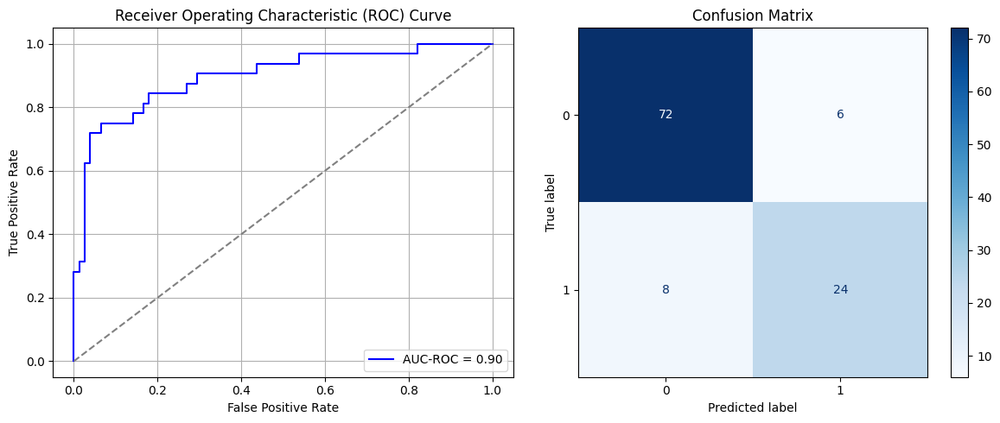

Best threshold based on F1-score: 0.7794163227081299
False Negative Rate: 0.25
Time elapsed (performance): 0.5084206420001465
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6702 - loss: 0.6003 - val_AUC: 0.8932 - val_loss: 0.3987
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8676 - loss: 0.4091 - val_AUC: 0.9105 - val_loss: 0.3590
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 - loss: 0.3691 - val_AUC: 0.9198 - val_loss: 0.3379
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8931 - loss: 0.3599 - val_AUC: 0.9241 - val_loss: 0.3161
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8990 - loss: 0.3405 - val_AUC: 0.9276 - val_loss: 0.3060
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9105 - loss: 0.3272 - val_AUC: 0.9308 - val_loss: 0.2992
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9171 - loss: 0.3148 - val_AUC: 0.9313 - val_loss: 0.3005
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9203 - loss: 0.3119 - val_AUC: 0.9314 - val_loss: 0.3033
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9081 - loss: 0.3286 - va

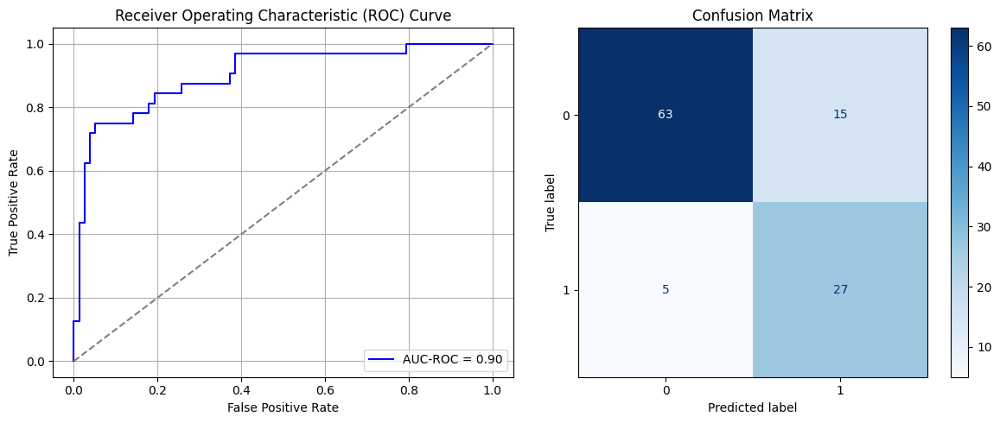

Best threshold based on F1-score: 0.7555151581764221
False Negative Rate: 0.15625
Time elapsed (performance): 0.4830476130000534
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7315 - loss: 0.5755 - val_AUC: 0.8890 - val_loss: 0.4099
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8710 - loss: 0.4101 - val_AUC: 0.9078 - val_loss: 0.3461
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8801 - loss: 0.3786 - val_AUC: 0.9152 - val_loss: 0.3411
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9094 - loss: 0.3398 - val_AUC: 0.9198 - val_loss: 0.3235
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9083 - loss: 0.3418 - val_AUC: 0.9232 - val_loss: 0.3127
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9076 - loss: 0.3347 - val_AUC: 0.9259 - val_loss: 0.3058
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9182 - loss: 0.3130 - val_AUC: 0.9288 - val_loss: 0.3163
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9151 - loss: 0.3215 - val_AUC: 0.9293 - val_loss: 0.3030
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9125 - loss: 0.3282 - va

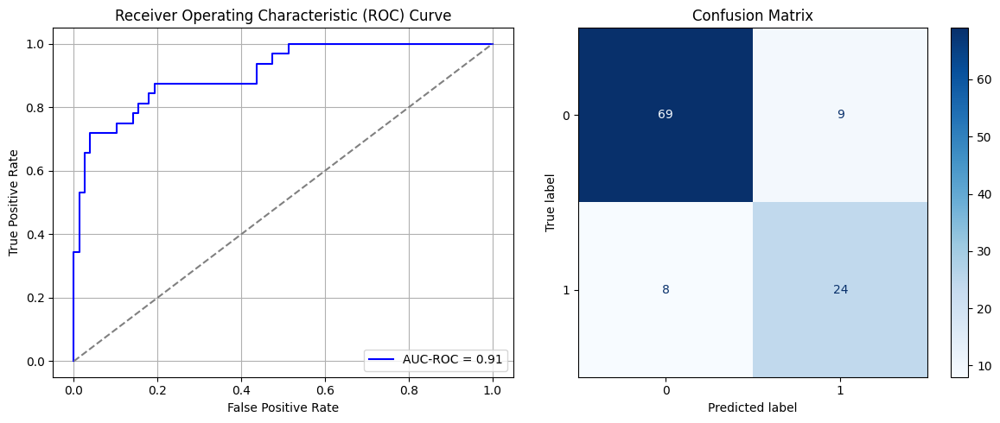

Best threshold based on F1-score: 0.8074086308479309
False Negative Rate: 0.25
Time elapsed (performance): 0.6754379159999644
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.7855 - loss: 0.5432 - val_AUC: 0.8960 - val_loss: 0.3814
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8638 - loss: 0.4065 - val_AUC: 0.9095 - val_loss: 0.3412
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8883 - loss: 0.3696 - val_AUC: 0.9192 - val_loss: 0.3299
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9038 - loss: 0.3478 - val_AUC: 0.9246 - val_loss: 0.3139
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9086 - loss: 0.3312 - val_AUC: 0.9269 - val_loss: 0.3103
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9061 - loss: 0.3320 - val_AUC: 0.9304 - val_loss: 0.3085
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9004 - loss: 0.3494 - val_AUC: 0.9312 - val_loss: 0.3023
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9093 - loss: 0.3296 - val_AUC: 0.9318 - val_loss: 0.2994
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9246 - loss: 0.3019 - va

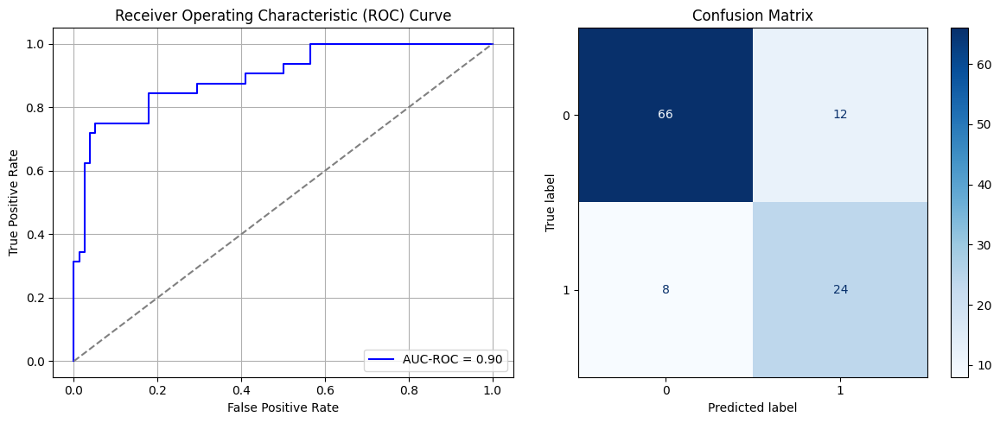

Best threshold based on F1-score: 0.6917077302932739
False Negative Rate: 0.25
Time elapsed (performance): 0.4841588919998685
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6558 - loss: 0.6122 - val_AUC: 0.8954 - val_loss: 0.4235
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8607 - loss: 0.4308 - val_AUC: 0.9094 - val_loss: 0.3495
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8867 - loss: 0.3630 - val_AUC: 0.9179 - val_loss: 0.3364
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9080 - loss: 0.3430 - val_AUC: 0.9229 - val_loss: 0.3215
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9048 - loss: 0.3471 - val_AUC: 0.9261 - val_loss: 0.3232
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9103 - loss: 0.3340 - val_AUC: 0.9285 - val_loss: 0.3065
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9135 - loss: 0.3318 - val_AUC: 0.9300 - val_loss: 0.3060
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9146 - loss: 0.3194 - val_AUC: 0.9291 - val_loss: 0.2990
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9159 - loss: 0.3180 - va

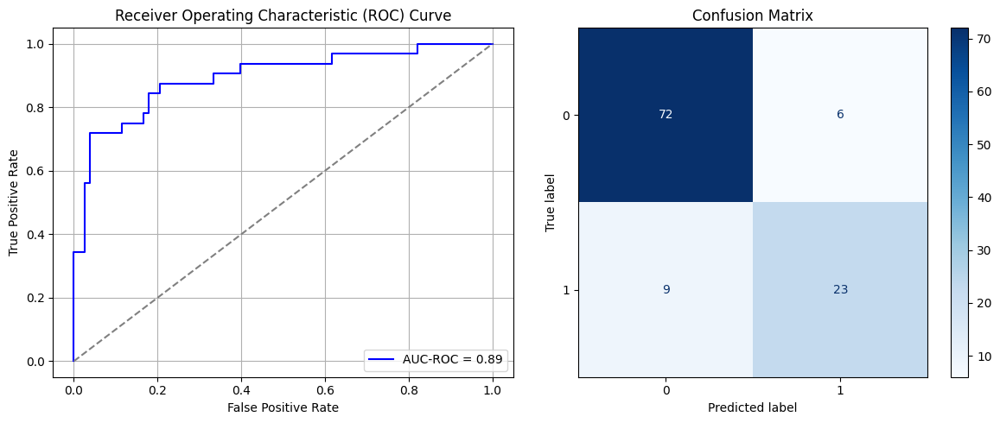

Best threshold based on F1-score: 0.675391674041748
False Negative Rate: 0.28125
Time elapsed (performance): 0.47413398500020776
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6812 - loss: 0.5868 - val_AUC: 0.8923 - val_loss: 0.3911
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8692 - loss: 0.4080 - val_AUC: 0.9089 - val_loss: 0.3443
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8851 - loss: 0.3731 - val_AUC: 0.9186 - val_loss: 0.3278
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9023 - loss: 0.3420 - val_AUC: 0.9250 - val_loss: 0.3165
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9152 - loss: 0.3210 - val_AUC: 0.9297 - val_loss: 0.3213
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9054 - loss: 0.3335 - val_AUC: 0.9291 - val_loss: 0.3074
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9128 - loss: 0.3243 - val_AUC: 0.9332 - val_loss: 0.2985
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9091 - loss: 0.3304 - val_AUC: 0.9345 - val_loss: 0.2991
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9162 - loss: 0.3165 - va

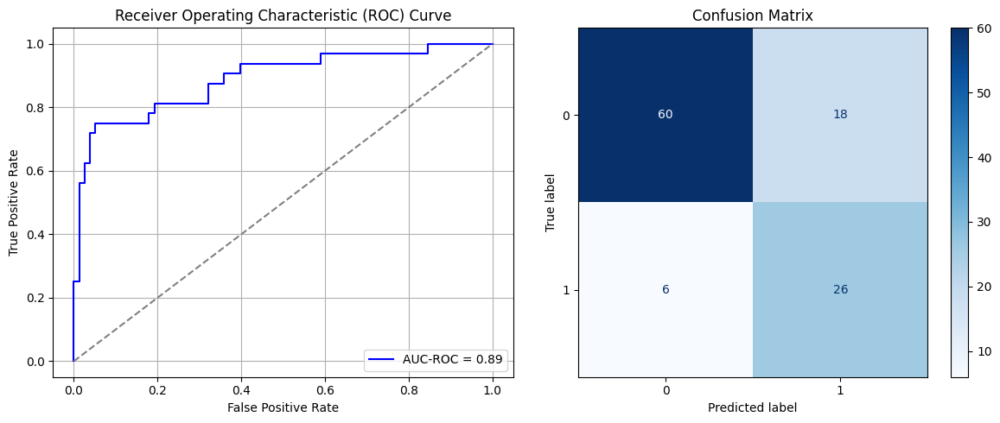

Best threshold based on F1-score: 0.75755375623703
False Negative Rate: 0.1875
Time elapsed (performance): 0.4896395550001671
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - AUC: 0.6559 - loss: 0.5882 - val_AUC: 0.8942 - val_loss: 0.4006
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8568 - loss: 0.4376 - val_AUC: 0.9101 - val_loss: 0.3442
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8869 - loss: 0.3763 - val_AUC: 0.9211 - val_loss: 0.3271
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8947 - loss: 0.3577 - val_AUC: 0.9256 - val_loss: 0.3118
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9083 - loss: 0.3355 - val_AUC: 0.9300 - val_loss: 0.3361
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9033 - loss: 0.3407 - val_AUC: 0.9272 - val_loss: 0.3150
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9078 - loss: 0.3307 - val_AUC: 0.9293 - val_loss: 0.2996
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9121 - loss: 0.3315 - val_AUC: 0.9291 - val_loss: 0.2989
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9104 - loss: 0.3300 - v

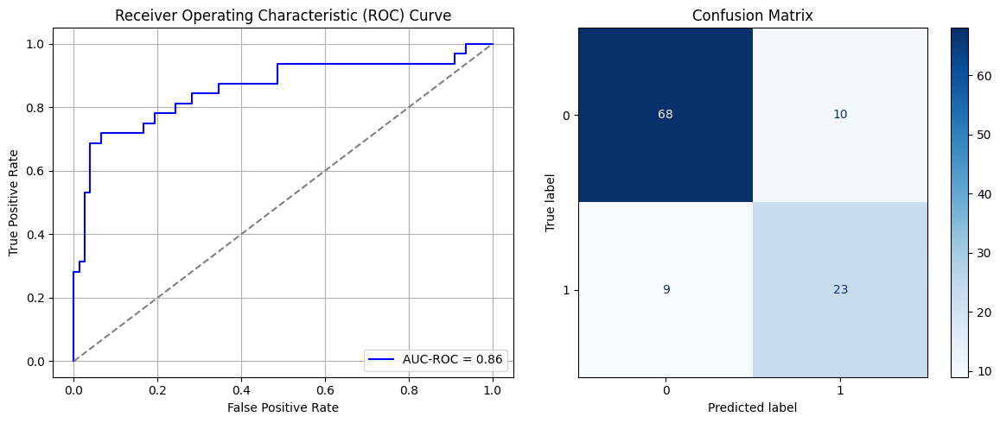

Best threshold based on F1-score: 0.7740172743797302
False Negative Rate: 0.28125
Time elapsed (performance): 0.5004343610000888
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7225 - loss: 0.5790 - val_AUC: 0.8943 - val_loss: 0.3966
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8505 - loss: 0.4205 - val_AUC: 0.9088 - val_loss: 0.3481
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8800 - loss: 0.3799 - val_AUC: 0.9173 - val_loss: 0.3303
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8974 - loss: 0.3440 - val_AUC: 0.9221 - val_loss: 0.3163
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9056 - loss: 0.3475 - val_AUC: 0.9236 - val_loss: 0.3113
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9018 - loss: 0.3414 - val_AUC: 0.9294 - val_loss: 0.3145
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9088 - loss: 0.3382 - val_AUC: 0.9283 - val_loss: 0.3009
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9149 - loss: 0.3232 - val_AUC: 0.9295 - val_loss: 0.2980
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9069 - loss: 0.3356 - va

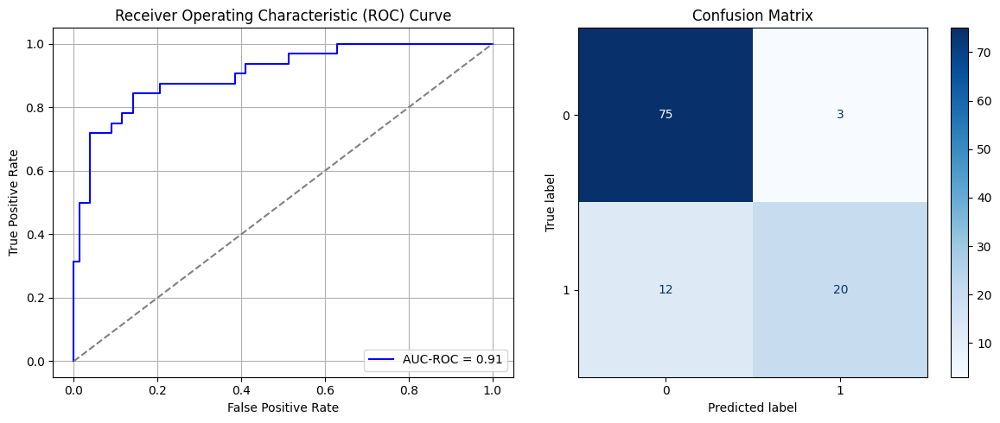

Best threshold based on F1-score: 0.4157591462135315
False Negative Rate: 0.375
Time elapsed (performance): 0.5167730839998512
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6614 - loss: 0.6111 - val_AUC: 0.8837 - val_loss: 0.4475
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8647 - loss: 0.4412 - val_AUC: 0.9072 - val_loss: 0.3498
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8987 - loss: 0.3562 - val_AUC: 0.9183 - val_loss: 0.3300
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8984 - loss: 0.3510 - val_AUC: 0.9254 - val_loss: 0.3126
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9141 - loss: 0.3233 - val_AUC: 0.9221 - val_loss: 0.3324
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9128 - loss: 0.3219 - val_AUC: 0.9276 - val_loss: 0.3066
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9106 - loss: 0.3308 - val_AUC: 0.9291 - val_loss: 0.3004
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9152 - loss: 0.3264 - val_AUC: 0.9318 - val_loss: 0.2983
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9106 - loss: 0.3260 - va

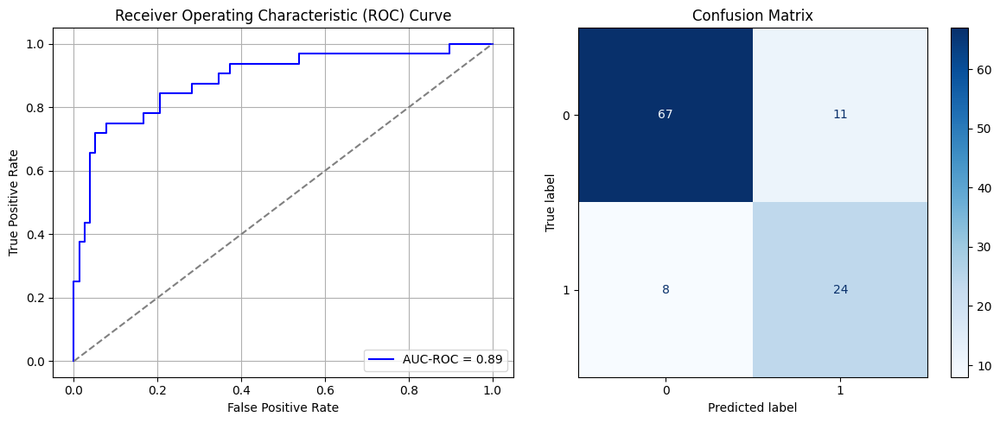

Best threshold based on F1-score: 0.7732003331184387
False Negative Rate: 0.25
Time elapsed (performance): 1.5374968099999933
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6166 - loss: 0.6182 - val_AUC: 0.8920 - val_loss: 0.4127
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8750 - loss: 0.4201 - val_AUC: 0.9092 - val_loss: 0.3569
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8850 - loss: 0.3776 - val_AUC: 0.9154 - val_loss: 0.3295
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8995 - loss: 0.3454 - val_AUC: 0.9215 - val_loss: 0.3145
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9005 - loss: 0.3399 - val_AUC: 0.9249 - val_loss: 0.3075
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9045 - loss: 0.3299 - val_AUC: 0.9258 - val_loss: 0.3058
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9029 - loss: 0.3429 - val_AUC: 0.9281 - val_loss: 0.3110
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9181 - loss: 0.3199 - val_AUC: 0.9243 - val_loss: 0.3328
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9142 - loss: 0.3291 - va

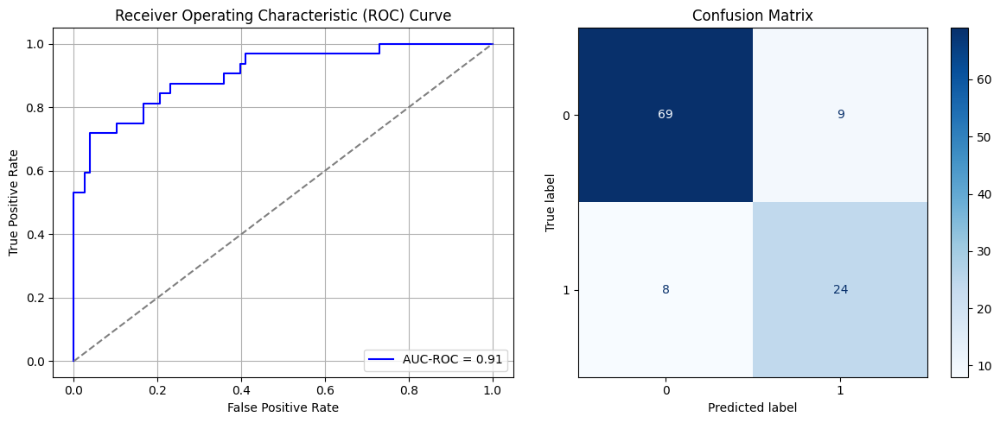

Best threshold based on F1-score: 0.6995391845703125
False Negative Rate: 0.25
Time elapsed (performance): 0.5314767410000059
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.7659 - loss: 0.5691 - val_AUC: 0.9027 - val_loss: 0.3873
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8850 - loss: 0.3847 - val_AUC: 0.9141 - val_loss: 0.3353
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8991 - loss: 0.3415 - val_AUC: 0.9211 - val_loss: 0.3172
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9027 - loss: 0.3383 - val_AUC: 0.9268 - val_loss: 0.3136
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8982 - loss: 0.3485 - val_AUC: 0.9265 - val_loss: 0.3118
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9120 - loss: 0.3206 - val_AUC: 0.9315 - val_loss: 0.3020
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9108 - loss: 0.3275 - val_AUC: 0.9313 - val_loss: 0.2965
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9128 - loss: 0.3220 - val_AUC: 0.9328 - val_loss: 0.2919
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9126 - loss: 0.3253 - va

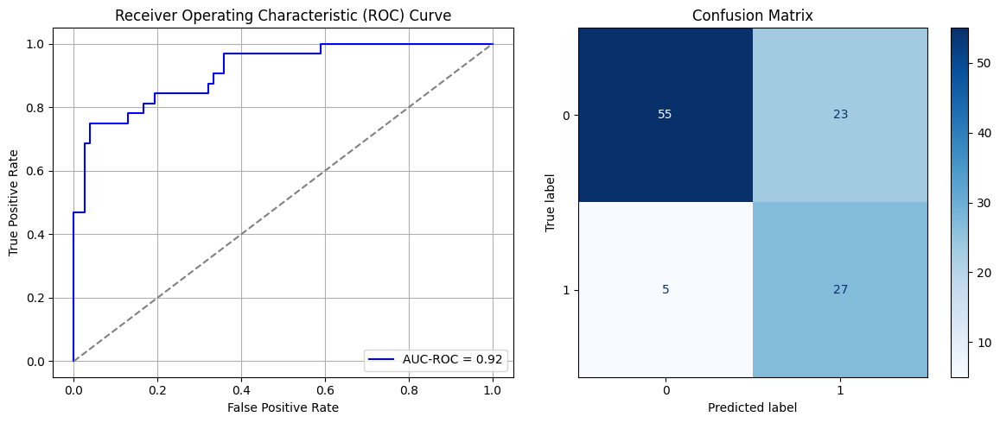

Best threshold based on F1-score: 0.8677400350570679
False Negative Rate: 0.15625
Time elapsed (performance): 0.525411560000066
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.6126 - loss: 0.5984 - val_AUC: 0.8933 - val_loss: 0.4071
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8676 - loss: 0.4135 - val_AUC: 0.9115 - val_loss: 0.3384
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8823 - loss: 0.3756 - val_AUC: 0.9174 - val_loss: 0.3216
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8871 - loss: 0.3654 - val_AUC: 0.9215 - val_loss: 0.3140
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9028 - loss: 0.3332 - val_AUC: 0.9244 - val_loss: 0.3094
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9102 - loss: 0.3319 - val_AUC: 0.9283 - val_loss: 0.3417
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9108 - loss: 0.3376 - val_AUC: 0.9275 - val_loss: 0.3004
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9168 - loss: 0.3140 - val_AUC: 0.9290 - val_loss: 0.3020
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9216 - loss: 0.3038 - va

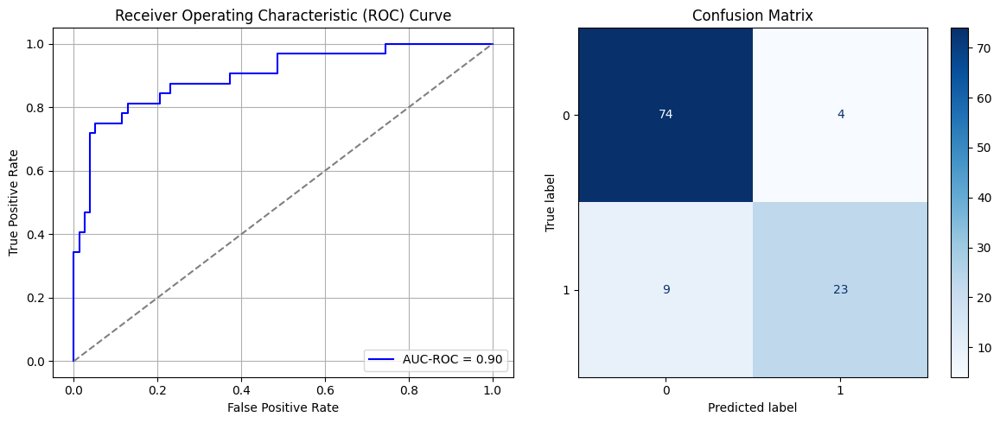

Best threshold based on F1-score: 0.4809122085571289
False Negative Rate: 0.28125
Time elapsed (performance): 0.7749762579996968
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.7172 - loss: 0.5846 - val_AUC: 0.8946 - val_loss: 0.4055
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8673 - loss: 0.4095 - val_AUC: 0.9118 - val_loss: 0.3417
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8882 - loss: 0.3734 - val_AUC: 0.9190 - val_loss: 0.3284
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8992 - loss: 0.3460 - val_AUC: 0.9240 - val_loss: 0.3171
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8983 - loss: 0.3607 - val_AUC: 0.9264 - val_loss: 0.3113
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8926 - loss: 0.3683 - val_AUC: 0.9300 - val_loss: 0.3135
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9081 - loss: 0.3355 - val_AUC: 0.9299 - val_loss: 0.3041
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9026 - loss: 0.3413 - val_AUC: 0.9298 - val_loss: 0.2982
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9110 - loss: 0.3285 - va

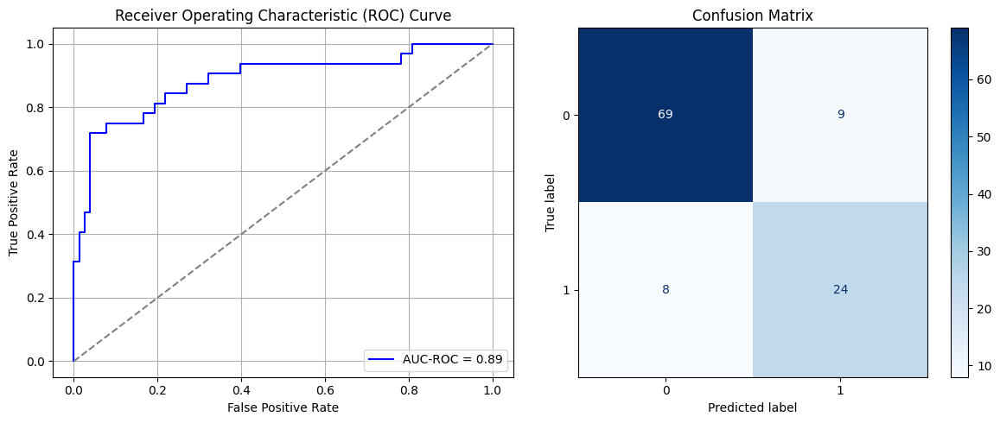

Best threshold based on F1-score: 0.7498988509178162
False Negative Rate: 0.25
Time elapsed (performance): 0.4885478689998308
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.7150 - loss: 0.5833 - val_AUC: 0.8964 - val_loss: 0.3959
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8637 - loss: 0.3938 - val_AUC: 0.9114 - val_loss: 0.3416
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8934 - loss: 0.3557 - val_AUC: 0.9203 - val_loss: 0.3288
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8977 - loss: 0.3483 - val_AUC: 0.9258 - val_loss: 0.3129
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9062 - loss: 0.3393 - val_AUC: 0.9256 - val_loss: 0.3126
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9100 - loss: 0.3272 - val_AUC: 0.9294 - val_loss: 0.3074
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9056 - loss: 0.3450 - val_AUC: 0.9296 - val_loss: 0.3015
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9220 - loss: 0.3114 - val_AUC: 0.9334 - val_loss: 0.3029
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9133 - loss: 0.3333 - va

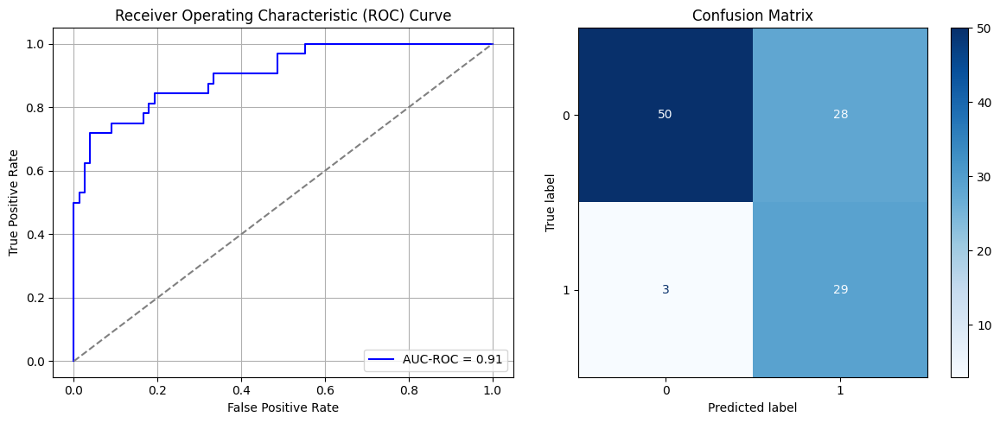

Best threshold based on F1-score: 0.9107601642608643
False Negative Rate: 0.09375
Time elapsed (performance): 0.5248267609999857
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6845 - loss: 0.5964 - val_AUC: 0.8875 - val_loss: 0.4257
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8625 - loss: 0.4236 - val_AUC: 0.9077 - val_loss: 0.3467
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8867 - loss: 0.3776 - val_AUC: 0.9161 - val_loss: 0.3271
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8908 - loss: 0.3596 - val_AUC: 0.9201 - val_loss: 0.3156
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9039 - loss: 0.3338 - val_AUC: 0.9234 - val_loss: 0.3156
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9159 - loss: 0.3102 - val_AUC: 0.9280 - val_loss: 0.3076
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9112 - loss: 0.3255 - val_AUC: 0.9292 - val_loss: 0.3149
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9076 - loss: 0.3354 - val_AUC: 0.9303 - val_loss: 0.2988
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9062 - loss: 0.3371 - va

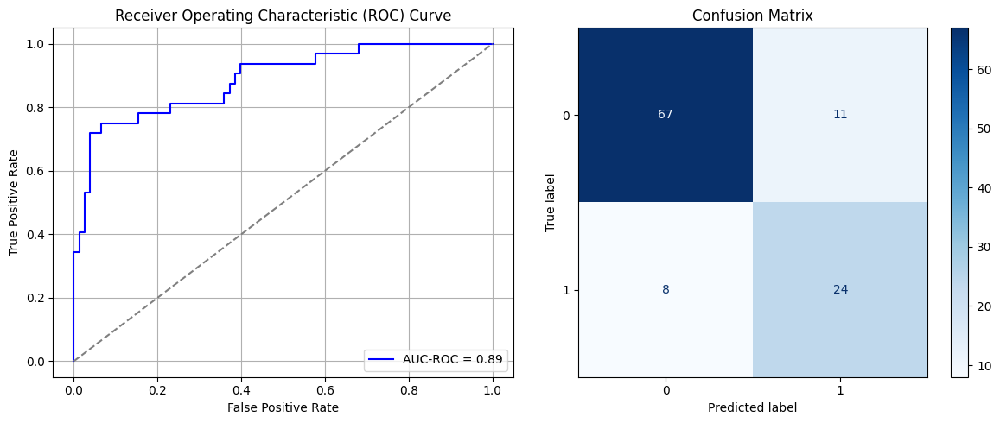

Best threshold based on F1-score: 0.7283201813697815
False Negative Rate: 0.25
Time elapsed (performance): 0.8554160310000043
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6571 - loss: 0.6008 - val_AUC: 0.8853 - val_loss: 0.4249
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8699 - loss: 0.4215 - val_AUC: 0.9044 - val_loss: 0.3563
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8898 - loss: 0.3691 - val_AUC: 0.9143 - val_loss: 0.3333
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9018 - loss: 0.3474 - val_AUC: 0.9198 - val_loss: 0.3234
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8831 - loss: 0.3758 - val_AUC: 0.9208 - val_loss: 0.3149
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8921 - loss: 0.3619 - val_AUC: 0.9218 - val_loss: 0.3127
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9038 - loss: 0.3436 - val_AUC: 0.9241 - val_loss: 0.3125
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9271 - loss: 0.3049 - val_AUC: 0.9260 - val_loss: 0.3058
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9146 - loss: 0.3204 - va

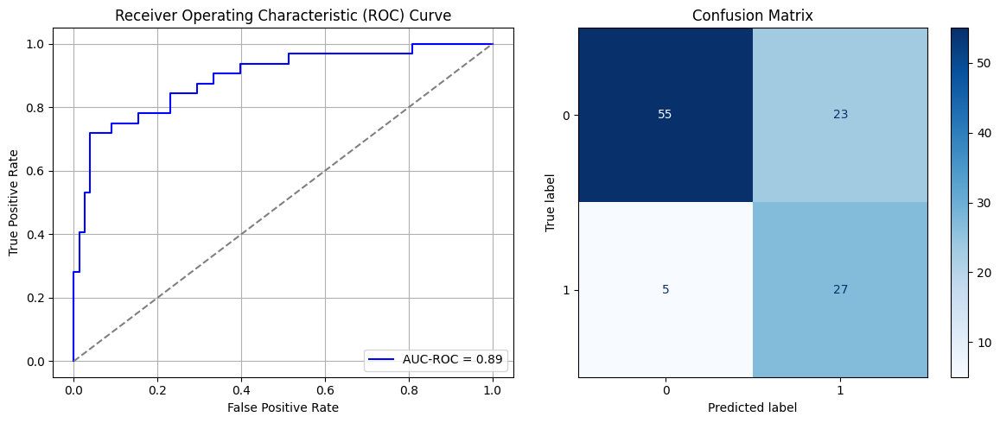

Best threshold based on F1-score: 0.9084658622741699
False Negative Rate: 0.15625
Time elapsed (performance): 0.5149431480003841
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - AUC: 0.7464 - loss: 0.5637 - val_AUC: 0.9008 - val_loss: 0.4065
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8737 - loss: 0.4119 - val_AUC: 0.9109 - val_loss: 0.3438
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8922 - loss: 0.3715 - val_AUC: 0.9184 - val_loss: 0.3321
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8935 - loss: 0.3489 - val_AUC: 0.9203 - val_loss: 0.3182
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8884 - loss: 0.3650 - val_AUC: 0.9250 - val_loss: 0.3121
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9037 - loss: 0.3480 - val_AUC: 0.9252 - val_loss: 0.3057
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9103 - loss: 0.3358 - val_AUC: 0.9258 - val_loss: 0.3062
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9106 - loss: 0.3285 - val_AUC: 0.9295 - val_loss: 0.3043
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9180 - loss: 0.3135 - v

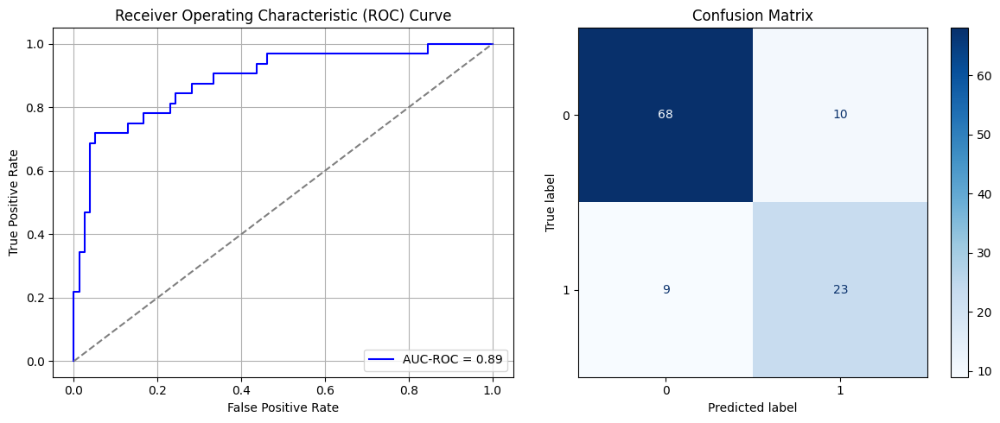

Best threshold based on F1-score: 0.7656370997428894
False Negative Rate: 0.28125
Time elapsed (performance): 0.5151381150003544
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6415 - loss: 0.6131 - val_AUC: 0.8864 - val_loss: 0.4056
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8784 - loss: 0.4001 - val_AUC: 0.9124 - val_loss: 0.3508
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8891 - loss: 0.3698 - val_AUC: 0.9228 - val_loss: 0.3243
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9055 - loss: 0.3331 - val_AUC: 0.9230 - val_loss: 0.3171
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8970 - loss: 0.3603 - val_AUC: 0.9269 - val_loss: 0.3080
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9022 - loss: 0.3380 - val_AUC: 0.9284 - val_loss: 0.3093
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9119 - loss: 0.3264 - val_AUC: 0.9296 - val_loss: 0.3028
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9154 - loss: 0.3185 - val_AUC: 0.9334 - val_loss: 0.2940
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9159 - loss: 0.3248 - va

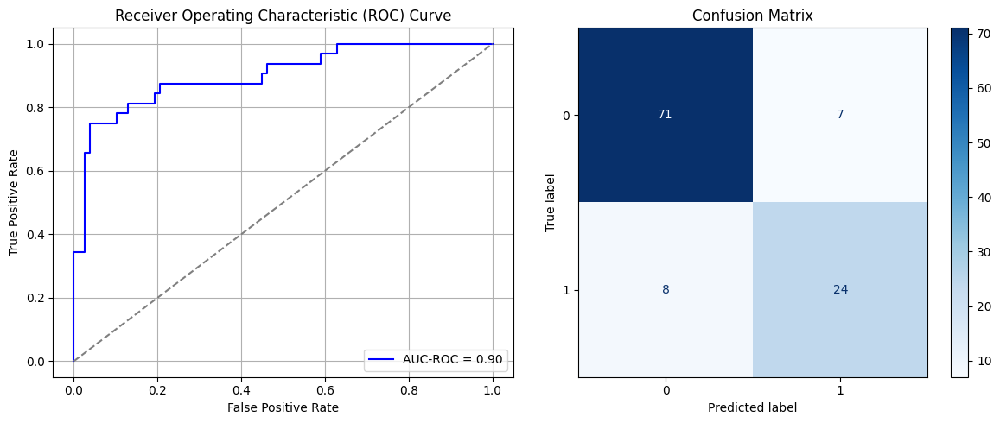

Best threshold based on F1-score: 0.5693262815475464
False Negative Rate: 0.25
Time elapsed (performance): 0.5230856289999792
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6943 - loss: 0.5818 - val_AUC: 0.8935 - val_loss: 0.3881
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8730 - loss: 0.4032 - val_AUC: 0.9133 - val_loss: 0.3411
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9033 - loss: 0.3497 - val_AUC: 0.9217 - val_loss: 0.3206
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8955 - loss: 0.3577 - val_AUC: 0.9266 - val_loss: 0.3123
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9092 - loss: 0.3331 - val_AUC: 0.9278 - val_loss: 0.3099
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9017 - loss: 0.3486 - val_AUC: 0.9269 - val_loss: 0.3157
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9243 - loss: 0.3097 - val_AUC: 0.9320 - val_loss: 0.3019
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9165 - loss: 0.3186 - val_AUC: 0.9326 - val_loss: 0.2949
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9123 - loss: 0.3155 - va

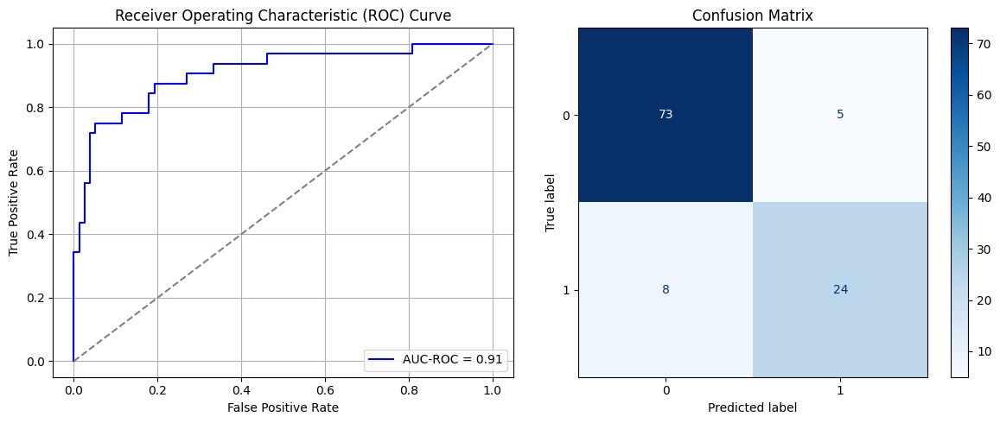

Best threshold based on F1-score: 0.5350179672241211
False Negative Rate: 0.25
Time elapsed (performance): 1.8156505910001215
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6695 - loss: 0.5853 - val_AUC: 0.8950 - val_loss: 0.3948
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8803 - loss: 0.3967 - val_AUC: 0.9170 - val_loss: 0.3433
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8952 - loss: 0.3572 - val_AUC: 0.9245 - val_loss: 0.3393
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8930 - loss: 0.3572 - val_AUC: 0.9279 - val_loss: 0.3075
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9091 - loss: 0.3301 - val_AUC: 0.9292 - val_loss: 0.3050
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9131 - loss: 0.3182 - val_AUC: 0.9313 - val_loss: 0.3025
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9164 - loss: 0.3201 - val_AUC: 0.9293 - val_loss: 0.3190
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9032 - loss: 0.3470 - val_AUC: 0.9285 - val_loss: 0.3196
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9158 - loss: 0.3145 - va

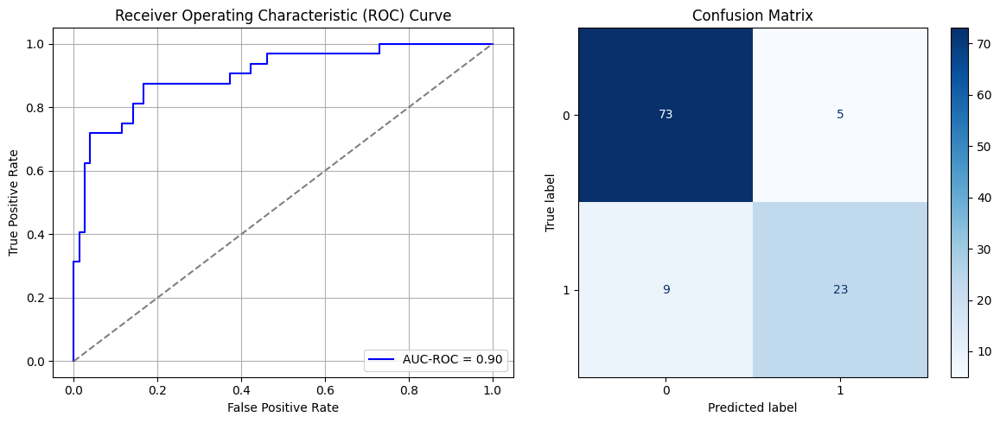

Best threshold based on F1-score: 0.7145746946334839
False Negative Rate: 0.28125
Time elapsed (performance): 0.5528809769998588
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - AUC: 0.7072 - loss: 0.5746 - val_AUC: 0.8916 - val_loss: 0.3890
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8784 - loss: 0.3887 - val_AUC: 0.9090 - val_loss: 0.3447
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8852 - loss: 0.3683 - val_AUC: 0.9200 - val_loss: 0.3266
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8957 - loss: 0.3528 - val_AUC: 0.9274 - val_loss: 0.3353
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9099 - loss: 0.3380 - val_AUC: 0.9292 - val_loss: 0.3078
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9005 - loss: 0.3502 - val_AUC: 0.9295 - val_loss: 0.3056
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9107 - loss: 0.3344 - val_AUC: 0.9341 - val_loss: 0.2969
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9133 - loss: 0.3235 - val_AUC: 0.9356 - val_loss: 0.3034
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9095 - loss: 0.3380 - v

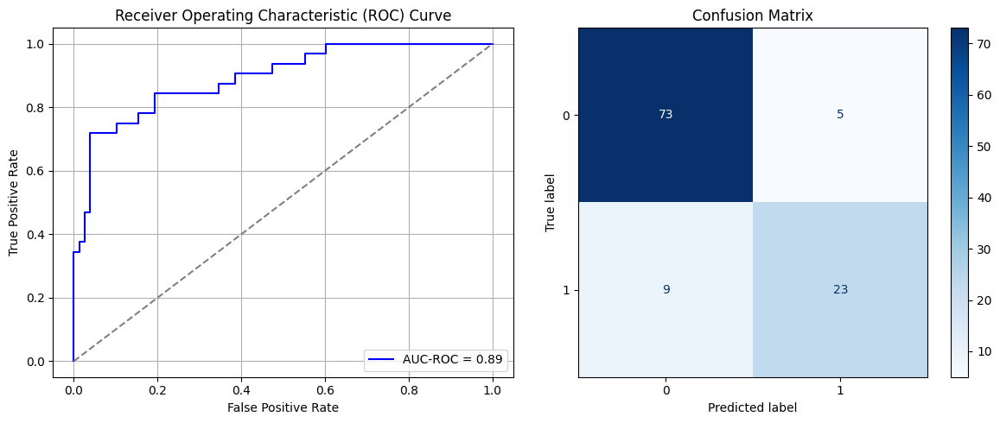

Best threshold based on F1-score: 0.6092566251754761
False Negative Rate: 0.28125
Time elapsed (performance): 0.5439183079997747
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.5894 - loss: 0.6536 - val_AUC: 0.8847 - val_loss: 0.4369
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8623 - loss: 0.4388 - val_AUC: 0.9046 - val_loss: 0.3584
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8863 - loss: 0.3741 - val_AUC: 0.9158 - val_loss: 0.3326
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8960 - loss: 0.3560 - val_AUC: 0.9198 - val_loss: 0.3274
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9081 - loss: 0.3364 - val_AUC: 0.9238 - val_loss: 0.3171
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9059 - loss: 0.3364 - val_AUC: 0.9242 - val_loss: 0.3127
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9153 - loss: 0.3169 - val_AUC: 0.9280 - val_loss: 0.3065
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9135 - loss: 0.3229 - val_AUC: 0.9265 - val_loss: 0.3067
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9177 - loss: 0.3202 - va

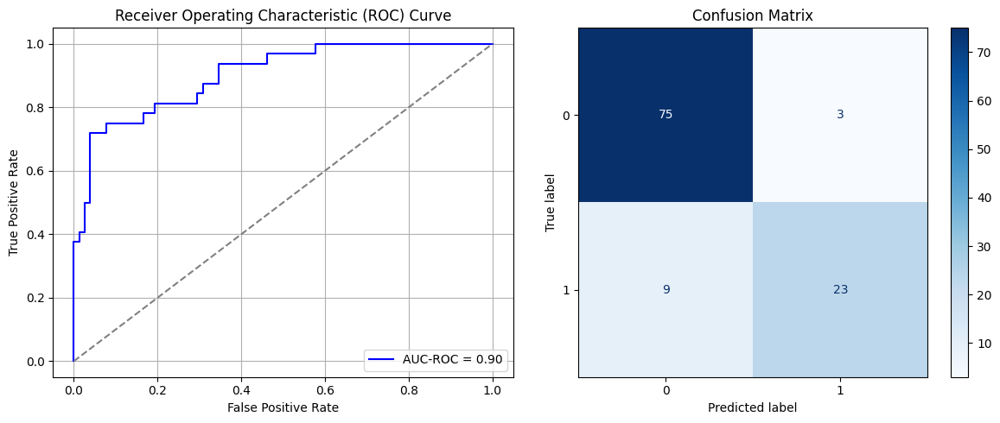

Best threshold based on F1-score: 0.543783962726593
False Negative Rate: 0.28125
Time elapsed (performance): 0.5119079210003292
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6165 - loss: 0.6194 - val_AUC: 0.8934 - val_loss: 0.4290
Epoch 2/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8741 - loss: 0.4120 - val_AUC: 0.9119 - val_loss: 0.3475
Epoch 3/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8908 - loss: 0.3668 - val_AUC: 0.9181 - val_loss: 0.3346
Epoch 4/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8926 - loss: 0.3497 - val_AUC: 0.9230 - val_loss: 0.3134
Epoch 5/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9083 - loss: 0.3377 - val_AUC: 0.9235 - val_loss: 0.3105
Epoch 6/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9135 - loss: 0.3243 - val_AUC: 0.9262 - val_loss: 0.3044
Epoch 7/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9151 - loss: 0.3318 - val_AUC: 0.9299 - val_loss: 0.3021
Epoch 8/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9229 - loss: 0.3118 - val_AUC: 0.9294 - val_loss: 0.3040
Epoch 9/10
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9186 - loss: 0.3208 - va

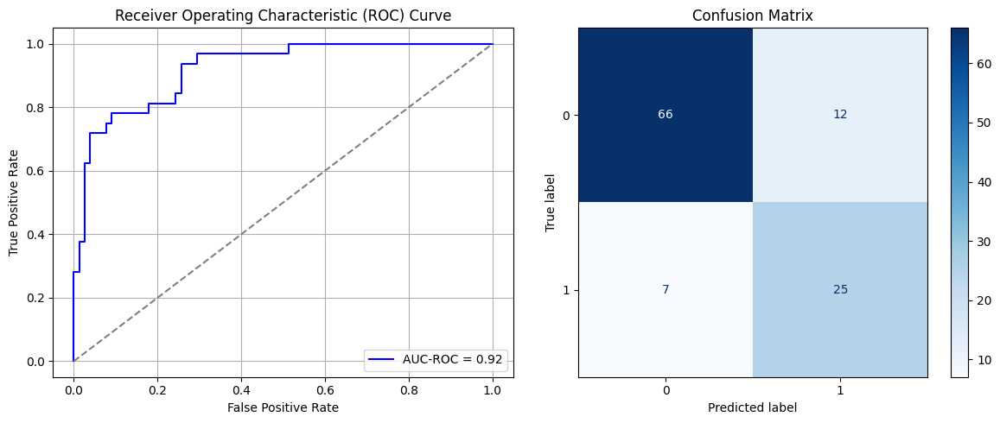

Best threshold based on F1-score: 0.790241003036499
False Negative Rate: 0.21875
Time elapsed (performance): 0.7075965690000885


In [53]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)
    model_source = create_dnn_model(X_S_train.shape[1])
    result_imbalanced = train_and_evaluate(model_source, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_imbalanced = Transductive_TL(model_source, X_T_full, y_T_full, "Target")

    Training_time.append(result_imbalanced)
    FPR.append(result_TL_imbalanced[0])
    TNR.append(result_TL_imbalanced[1])
    FNR.append(result_TL_imbalanced[2])
    TPR.append(result_TL_imbalanced[3])
    TL_time.append(result_TL_imbalanced[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [54]:
print(ParamFit)
ParamFit.to_csv('Imbalanced.csv')

## Remember that TPR is actually TNR and TNR is actually TPR!!!

    Source time       FPR       TPR      FNR      TNR  Target time
0      6.170659  0.102564  0.897436  0.25000  0.75000     0.433826
1      6.379155  0.179487  0.820513  0.21875  0.78125     0.438348
2      6.289048  0.128205  0.871795  0.25000  0.75000     0.445208
3      7.055670  0.153846  0.846154  0.18750  0.81250     0.483958
4      6.456253  0.423077  0.576923  0.06250  0.93750     0.665403
5      6.730172  0.076923  0.923077  0.28125  0.71875     0.474386
6      8.736516  0.141026  0.858974  0.25000  0.75000     0.468446
7      7.451061  0.076923  0.923077  0.25000  0.75000     0.642572
8      7.602596  0.179487  0.820513  0.18750  0.81250     0.479739
9      6.794852  0.205128  0.794872  0.18750  0.81250     0.489622
10     7.809194  0.089744  0.910256  0.28125  0.71875     0.687496
11     7.448205  0.179487  0.820513  0.21875  0.78125     0.461637
12     7.999698  0.192308  0.807692  0.21875  0.78125     0.487434
13     7.432886  0.076923  0.923077  0.25000  0.75000     0.43

# Random Undersampling (RUS) to balance Dataset:

## SRS Sample without Replacement:

In [55]:
data_S

,0,1,2,3,4,5,6,7,8,9,...,27,28,29,30,31,32,33,34,35,Y
0,0.0,0.285714,0.555556,0.013858,1.0,0.000000,0.284211,0.0,0.418605,0.255814,...,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.372093,0.488889,0.766182,1
1,0.0,0.250000,0.111111,0.925989,1.0,0.000000,0.684211,0.0,0.000000,0.046512,...,0.000000,0.260870,0.181818,0.30,0.735897,0.000000,0.732558,0.111111,0.640687,0
2,0.0,0.000000,0.555556,0.907512,1.0,0.000000,0.284211,0.0,0.837209,0.837209,...,0.000000,0.260870,0.000000,0.00,0.000000,0.000000,0.372093,0.488889,0.766182,1
3,0.0,0.285714,0.222222,0.978108,1.0,0.000000,0.284211,0.0,0.860465,0.837209,...,0.000000,0.260870,0.303030,0.25,0.667692,0.000000,0.209302,0.000000,0.124174,0
4,0.2,0.678571,0.111111,0.801466,0.0,0.000000,0.052632,0.0,0.837209,0.860465,...,0.000000,0.260870,0.181818,0.30,0.700000,0.000000,0.732558,0.111111,0.640687,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4309,0.0,0.000000,0.111111,0.907512,1.0,0.000000,0.389474,0.0,0.000000,0.000000,...,0.000000,0.260870,0.181818,0.30,0.726923,0.000000,1.000000,0.244444,0.414795,0
4310,0.0,0.767857,0.111111,0.907512,1.0,0.904762,0.263158,0.0,0.046512,0.860465,...,0.263158,0.391304,0.303030,0.35,0.707692,0.083333,1.000000,0.244444,0.414795,0
4311,0.0,0.000000,0.666667,0.978108,1.0,0.000000,0.315789,0.0,0.000000,0.000000,...,0.000000,0.260870,0.242424,0.25,0.682051,0.000000,0.918605,0.800000,0.000000,0
4312,0.0,0.000000,0.111111,0.950693,1.0,0.000000,0.621053,0.0,0.837209,0.837209,...,0.000000,0.347826,0.272727,0.05,0.726923,0.000000,0.732558,0.111111,0.640687,1


In [56]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

1389
2925


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 26ms/step - AUC: 0.6953 - loss: 0.6540 - val_AUC: 0.8723 - val_loss: 0.5146
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - AUC: 0.8588 - loss: 0.4935 - val_AUC: 0.8881 - val_loss: 0.4305
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - AUC: 0.8931 - loss: 0.4122 - val_AUC: 0.9012 - val_loss: 0.4137
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8957 - loss: 0.4035 - val_AUC: 0.9094 - val_loss: 0.3822
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9027 - loss: 0.3888 - val_AUC: 0.9161 - val_loss: 0.3691
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9123 - loss: 0.3702 - val_AUC: 0.9199 - val_loss: 0.3604
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9046 - loss: 0.3800 - val_AUC: 0.9216 - val_loss: 0.3548
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9135 - loss: 0.3619 - val_AUC: 0.9200 - val_loss: 0.3570
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9165 - los

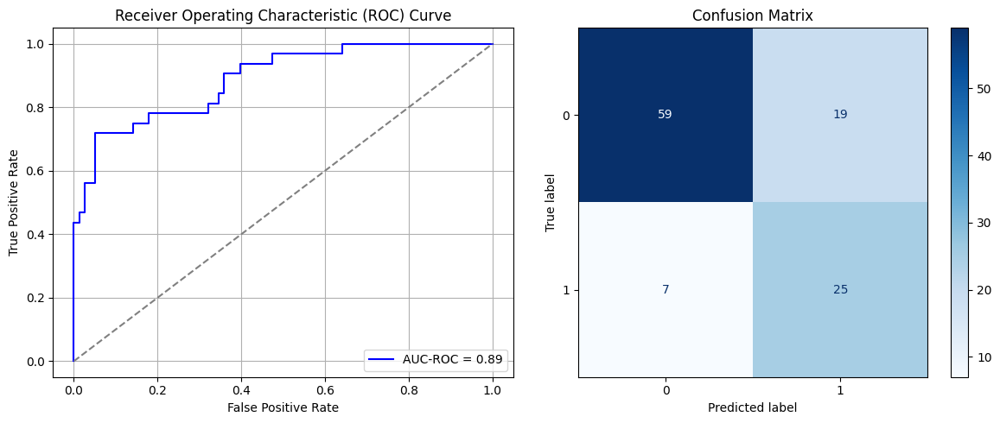

Best threshold based on F1-score: 0.8736830949783325
False Negative Rate: 0.21875
Time elapsed (performance): 0.4496844410000449
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7041 - loss: 0.6587 - val_AUC: 0.8851 - val_loss: 0.5263
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8703 - loss: 0.4958 - val_AUC: 0.9024 - val_loss: 0.4145
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8801 - loss: 0.4313 - val_AUC: 0.9121 - val_loss: 0.3861
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9040 - loss: 0.3868 - val_AUC: 0.9173 - val_loss: 0.3737
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9009 - loss: 0.3905 - val_AUC: 0.9221 - val_loss: 0.3605
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9086 - loss: 0.3759 - val_AUC: 0.9247 - val_loss: 0.3528
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9170 - loss: 0.3561 - val_AUC: 0.9231 - val_loss: 0.3658
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9125 - loss: 0.3599 - val_AUC: 0.9270 - val_loss: 0.3504
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9180 - loss: 0.3501 - va

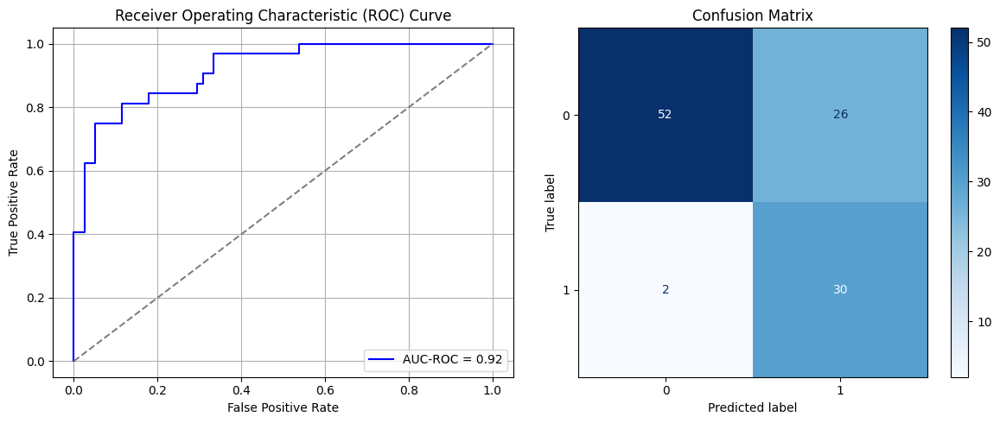

Best threshold based on F1-score: 0.9018241167068481
False Negative Rate: 0.0625
Time elapsed (performance): 0.46668473099998664
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7209 - loss: 0.6542 - val_AUC: 0.8611 - val_loss: 0.5288
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8596 - loss: 0.5015 - val_AUC: 0.8968 - val_loss: 0.4202
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8879 - loss: 0.4218 - val_AUC: 0.9130 - val_loss: 0.3916
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8988 - loss: 0.3929 - val_AUC: 0.9155 - val_loss: 0.3773
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9179 - loss: 0.3508 - val_AUC: 0.9192 - val_loss: 0.3696
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9087 - loss: 0.3686 - val_AUC: 0.9201 - val_loss: 0.3734
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9126 - loss: 0.3627 - val_AUC: 0.9198 - val_loss: 0.3664
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9267 - loss: 0.3353 - val_AUC: 0.9217 - val_loss: 0.3656
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9180 - loss: 0.3535 - va

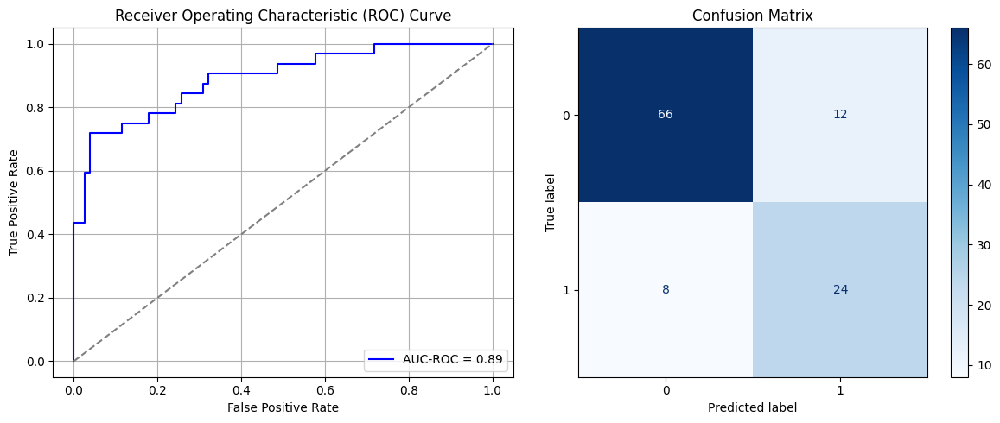

Best threshold based on F1-score: 0.7908205986022949
False Negative Rate: 0.25
Time elapsed (performance): 0.45909856100024626
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.7430 - loss: 0.6384 - val_AUC: 0.8663 - val_loss: 0.5137
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8640 - loss: 0.4847 - val_AUC: 0.8916 - val_loss: 0.4278
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8820 - loss: 0.4279 - val_AUC: 0.9013 - val_loss: 0.4025
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9016 - loss: 0.3955 - val_AUC: 0.9073 - val_loss: 0.3983
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9002 - loss: 0.3905 - val_AUC: 0.9113 - val_loss: 0.3968
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8975 - loss: 0.3981 - val_AUC: 0.9103 - val_loss: 0.3808
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9084 - loss: 0.3765 - val_AUC: 0.9132 - val_loss: 0.3725
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9032 - loss: 0.3824 - val_AUC: 0.9140 - val_loss: 0.3676
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9165 - loss: 0.3597 - va

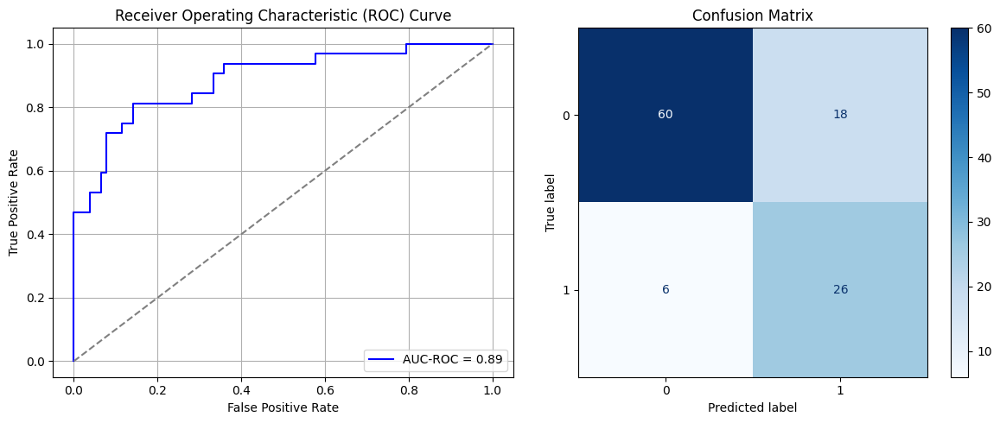

Best threshold based on F1-score: 0.7536143064498901
False Negative Rate: 0.1875
Time elapsed (performance): 0.4562628189996758
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - AUC: 0.7322 - loss: 0.6406 - val_AUC: 0.8848 - val_loss: 0.5012
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8725 - loss: 0.4759 - val_AUC: 0.9016 - val_loss: 0.4308
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8842 - loss: 0.4251 - val_AUC: 0.9100 - val_loss: 0.3962
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8994 - loss: 0.3961 - val_AUC: 0.9142 - val_loss: 0.3821
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8971 - loss: 0.3975 - val_AUC: 0.9170 - val_loss: 0.3714
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9021 - loss: 0.3879 - val_AUC: 0.9187 - val_loss: 0.3734
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9109 - loss: 0.3737 - val_AUC: 0.9204 - val_loss: 0.3587
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9189 - loss: 0.3507 - val_AUC: 0.9209 - val_loss: 0.3755
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9196 - loss: 0.3503 - v

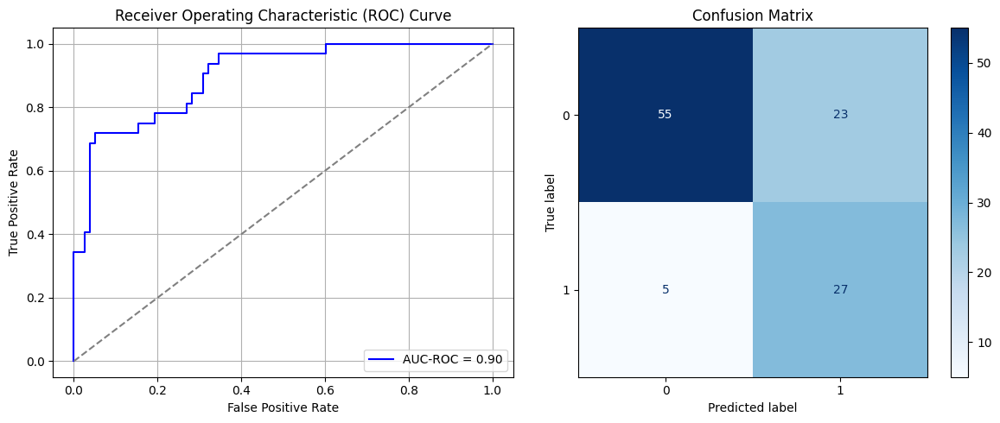

Best threshold based on F1-score: 0.9243515729904175
False Negative Rate: 0.15625
Time elapsed (performance): 0.45947486000022764
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7006 - loss: 0.6587 - val_AUC: 0.8634 - val_loss: 0.5247
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8488 - loss: 0.5128 - val_AUC: 0.9063 - val_loss: 0.4254
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8736 - loss: 0.4433 - val_AUC: 0.9160 - val_loss: 0.3810
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9020 - loss: 0.3923 - val_AUC: 0.9188 - val_loss: 0.3727
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9097 - loss: 0.3713 - val_AUC: 0.9205 - val_loss: 0.3674
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9103 - loss: 0.3700 - val_AUC: 0.9224 - val_loss: 0.3664
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9124 - loss: 0.3687 - val_AUC: 0.9248 - val_loss: 0.3561
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9220 - loss: 0.3534 - val_AUC: 0.9237 - val_loss: 0.3547
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9247 - loss: 0.3385 - va

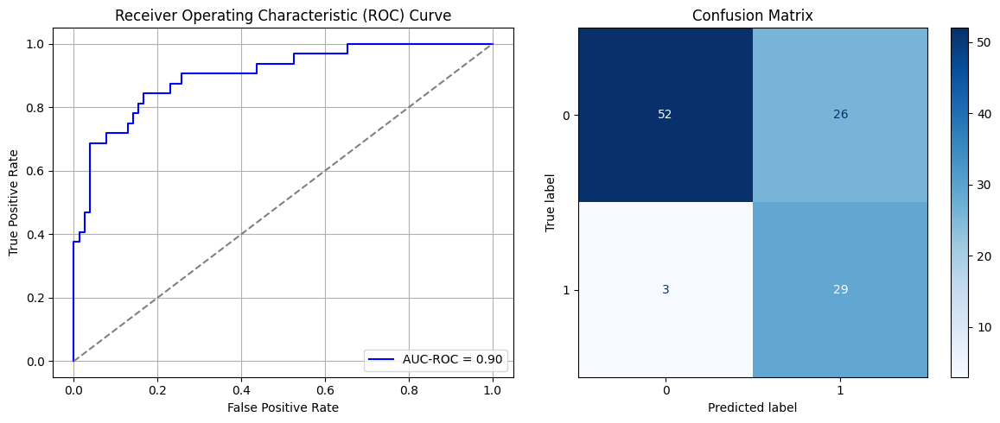

Best threshold based on F1-score: 0.9429188966751099
False Negative Rate: 0.09375
Time elapsed (performance): 0.4924691900000653
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7181 - loss: 0.6462 - val_AUC: 0.8774 - val_loss: 0.4934
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8491 - loss: 0.4948 - val_AUC: 0.8986 - val_loss: 0.4193
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8825 - loss: 0.4294 - val_AUC: 0.9100 - val_loss: 0.3899
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9039 - loss: 0.3945 - val_AUC: 0.9126 - val_loss: 0.4042
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9045 - loss: 0.3854 - val_AUC: 0.9144 - val_loss: 0.3761
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9017 - loss: 0.3882 - val_AUC: 0.9167 - val_loss: 0.3859
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9157 - loss: 0.3586 - val_AUC: 0.9185 - val_loss: 0.3707
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8995 - loss: 0.3893 - val_AUC: 0.9181 - val_loss: 0.3671
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9273 - loss: 0.3325 - va

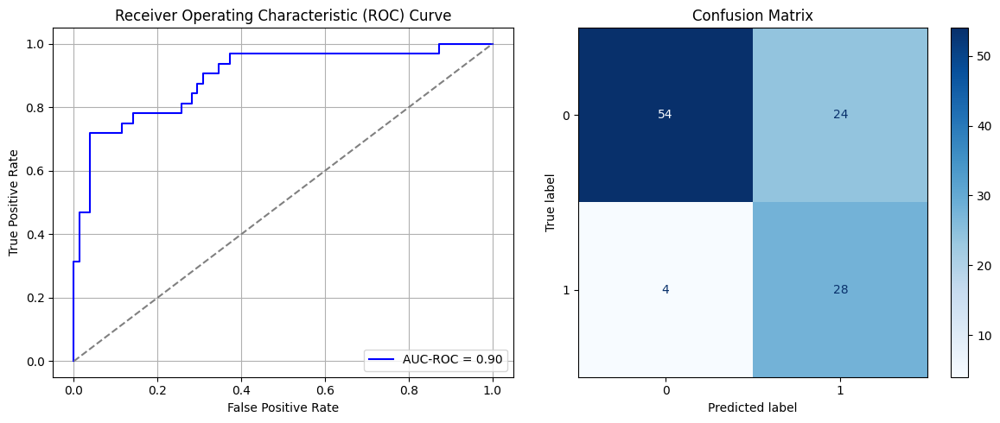

Best threshold based on F1-score: 0.9024695158004761
False Negative Rate: 0.125
Time elapsed (performance): 0.48421015699977943
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7055 - loss: 0.6600 - val_AUC: 0.8744 - val_loss: 0.5342
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8565 - loss: 0.5065 - val_AUC: 0.8974 - val_loss: 0.4303
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8806 - loss: 0.4260 - val_AUC: 0.9068 - val_loss: 0.4133
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8867 - loss: 0.4152 - val_AUC: 0.9109 - val_loss: 0.3917
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9033 - loss: 0.3850 - val_AUC: 0.9139 - val_loss: 0.3834
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9091 - loss: 0.3756 - val_AUC: 0.9161 - val_loss: 0.3783
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9089 - loss: 0.3707 - val_AUC: 0.9162 - val_loss: 0.3756
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9153 - loss: 0.3582 - val_AUC: 0.9164 - val_loss: 0.3804
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9203 - loss: 0.3569 - va

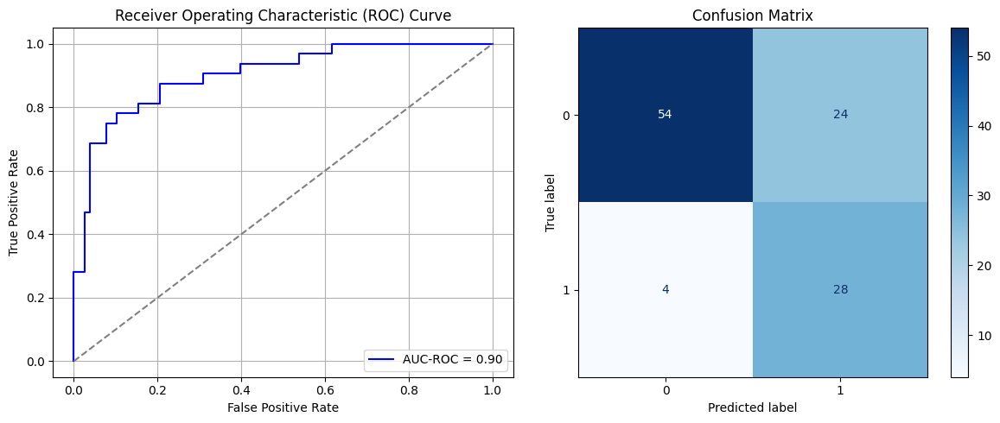

Best threshold based on F1-score: 0.8086259365081787
False Negative Rate: 0.125
Time elapsed (performance): 0.4707595360000596
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7072 - loss: 0.6495 - val_AUC: 0.8947 - val_loss: 0.4750
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8711 - loss: 0.4641 - val_AUC: 0.9099 - val_loss: 0.3956
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8866 - loss: 0.4175 - val_AUC: 0.9140 - val_loss: 0.3809
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9034 - loss: 0.3832 - val_AUC: 0.9157 - val_loss: 0.3911
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.9022 - loss: 0.3887 - val_AUC: 0.9192 - val_loss: 0.3716
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.9086 - loss: 0.3750 - val_AUC: 0.9187 - val_loss: 0.3700
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9139 - loss: 0.3689 - val_AUC: 0.9198 - val_loss: 0.3697
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9182 - loss: 0.3503 - val_AUC: 0.9197 - val_loss: 0.4309
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9093 - loss: 0.3857 - va

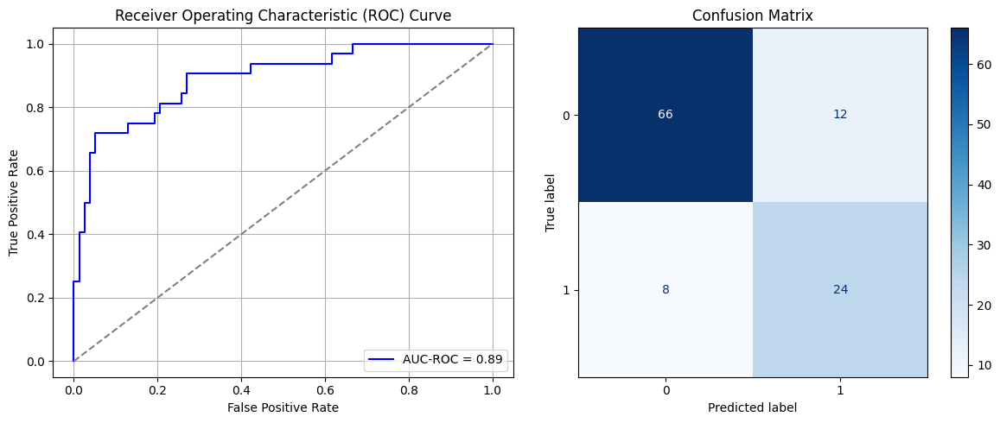

Best threshold based on F1-score: 0.8178917765617371
False Negative Rate: 0.25
Time elapsed (performance): 0.4677697709998938
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6734 - loss: 0.6563 - val_AUC: 0.8811 - val_loss: 0.5151
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8612 - loss: 0.5033 - val_AUC: 0.9180 - val_loss: 0.3995
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8877 - loss: 0.4235 - val_AUC: 0.9248 - val_loss: 0.3696
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8987 - loss: 0.3959 - val_AUC: 0.9268 - val_loss: 0.3605
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9059 - loss: 0.3811 - val_AUC: 0.9271 - val_loss: 0.3525
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9236 - loss: 0.3465 - val_AUC: 0.9271 - val_loss: 0.3524
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9202 - loss: 0.3509 - val_AUC: 0.9276 - val_loss: 0.3579
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9125 - loss: 0.3545 - val_AUC: 0.9294 - val_loss: 0.3495
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9250 - loss: 0.3364 - va

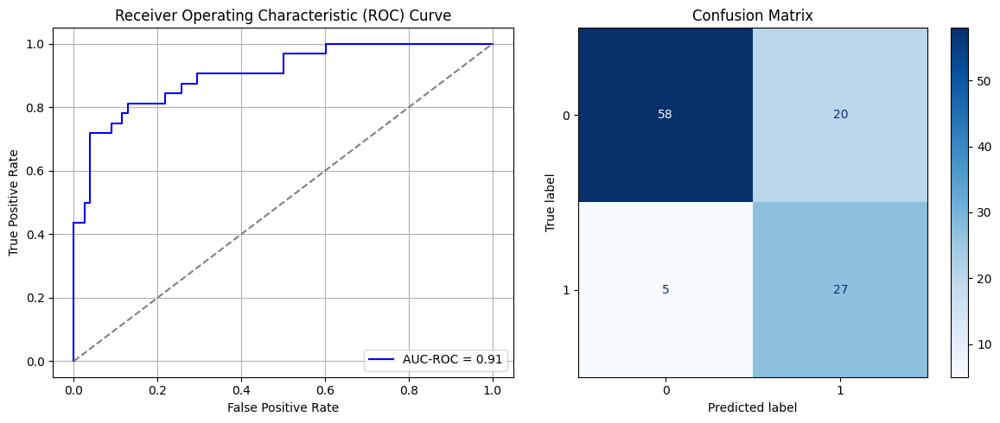

Best threshold based on F1-score: 0.8813555240631104
False Negative Rate: 0.15625
Time elapsed (performance): 0.46218237299990506
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6843 - loss: 0.6527 - val_AUC: 0.8848 - val_loss: 0.5178
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8877 - loss: 0.4721 - val_AUC: 0.9031 - val_loss: 0.4090
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8926 - loss: 0.4131 - val_AUC: 0.9131 - val_loss: 0.3800
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8995 - loss: 0.3890 - val_AUC: 0.9177 - val_loss: 0.3708
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9003 - loss: 0.3920 - val_AUC: 0.9201 - val_loss: 0.3692
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9109 - loss: 0.3692 - val_AUC: 0.9228 - val_loss: 0.3554
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9119 - loss: 0.3651 - val_AUC: 0.9232 - val_loss: 0.3534
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9164 - loss: 0.3557 - val_AUC: 0.9241 - val_loss: 0.3523
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9107 - loss: 0.3618 - va

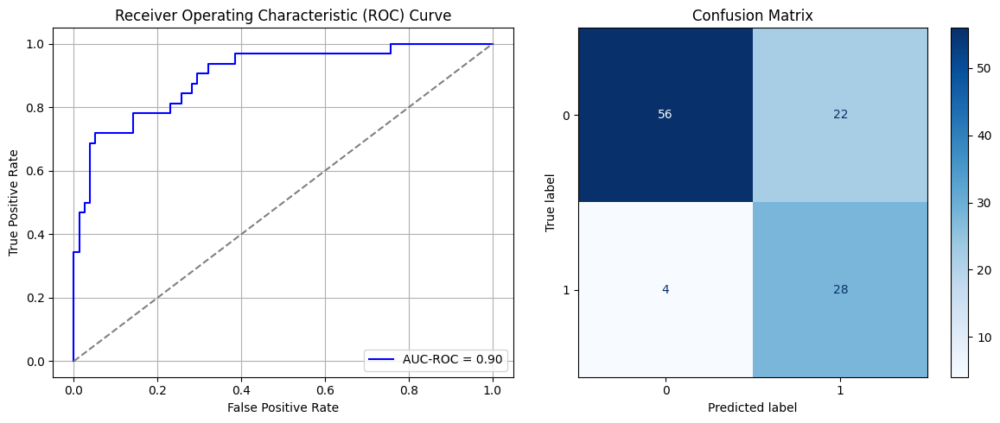

Best threshold based on F1-score: 0.8999732136726379
False Negative Rate: 0.125
Time elapsed (performance): 0.4567151520000152
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7029 - loss: 0.6598 - val_AUC: 0.8740 - val_loss: 0.5321
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8636 - loss: 0.5058 - val_AUC: 0.9055 - val_loss: 0.4212
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8818 - loss: 0.4348 - val_AUC: 0.9151 - val_loss: 0.3825
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8856 - loss: 0.4193 - val_AUC: 0.9196 - val_loss: 0.3666
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8980 - loss: 0.3965 - val_AUC: 0.9208 - val_loss: 0.3664
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9106 - loss: 0.3727 - val_AUC: 0.9213 - val_loss: 0.3649
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9099 - loss: 0.3755 - val_AUC: 0.9234 - val_loss: 0.3609
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9026 - loss: 0.3832 - val_AUC: 0.9223 - val_loss: 0.3508
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9253 - loss: 0.3427 - va

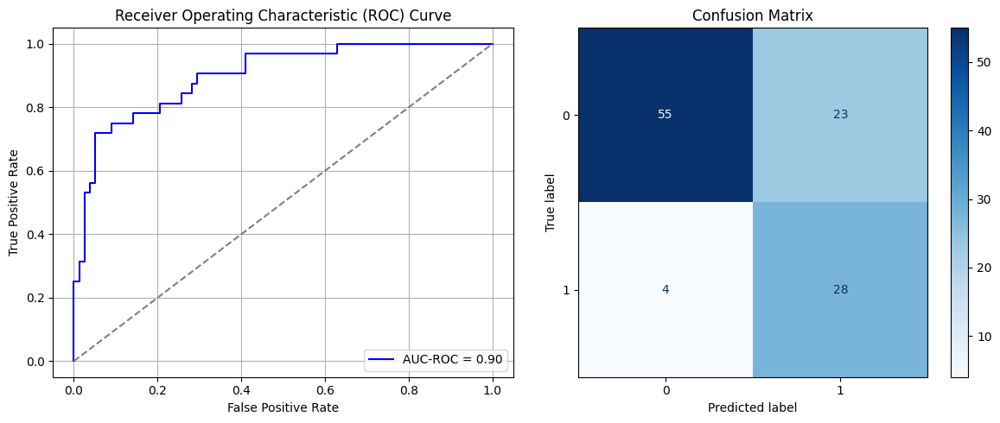

Best threshold based on F1-score: 0.9115702509880066
False Negative Rate: 0.125
Time elapsed (performance): 0.47894860600035827
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7423 - loss: 0.6379 - val_AUC: 0.8754 - val_loss: 0.5034
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8646 - loss: 0.4869 - val_AUC: 0.9048 - val_loss: 0.4055
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.8897 - loss: 0.4107 - val_AUC: 0.9130 - val_loss: 0.3803
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9031 - loss: 0.3782 - val_AUC: 0.9160 - val_loss: 0.3731
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8992 - loss: 0.3918 - val_AUC: 0.9198 - val_loss: 0.3590
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.9042 - loss: 0.3815 - val_AUC: 0.9203 - val_loss: 0.3626
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9211 - loss: 0.3543 - val_AUC: 0.9234 - val_loss: 0.3548
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9140 - loss: 0.3649 - val_AUC: 0.9254 - val_loss: 0.3510
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9143 - loss: 0.3622 - va

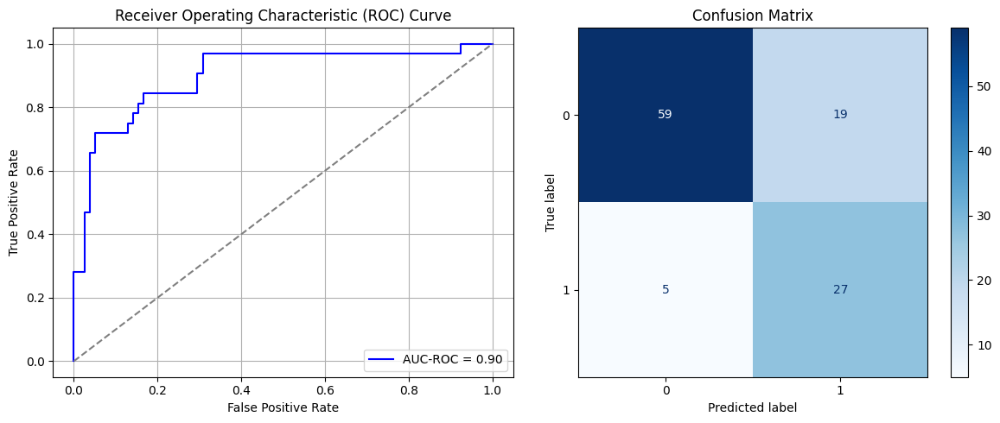

Best threshold based on F1-score: 0.8279834389686584
False Negative Rate: 0.15625
Time elapsed (performance): 0.46715816999994786
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7594 - loss: 0.6384 - val_AUC: 0.8626 - val_loss: 0.5190
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8637 - loss: 0.4847 - val_AUC: 0.8773 - val_loss: 0.4597
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8810 - loss: 0.4329 - val_AUC: 0.8865 - val_loss: 0.4365
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9087 - loss: 0.3783 - val_AUC: 0.8919 - val_loss: 0.4241
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8942 - loss: 0.3932 - val_AUC: 0.8956 - val_loss: 0.4161
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9182 - loss: 0.3567 - val_AUC: 0.8994 - val_loss: 0.4121
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9048 - loss: 0.3851 - val_AUC: 0.9011 - val_loss: 0.4209
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9179 - loss: 0.3534 - val_AUC: 0.9031 - val_loss: 0.4049
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9165 - loss: 0.3551 - v

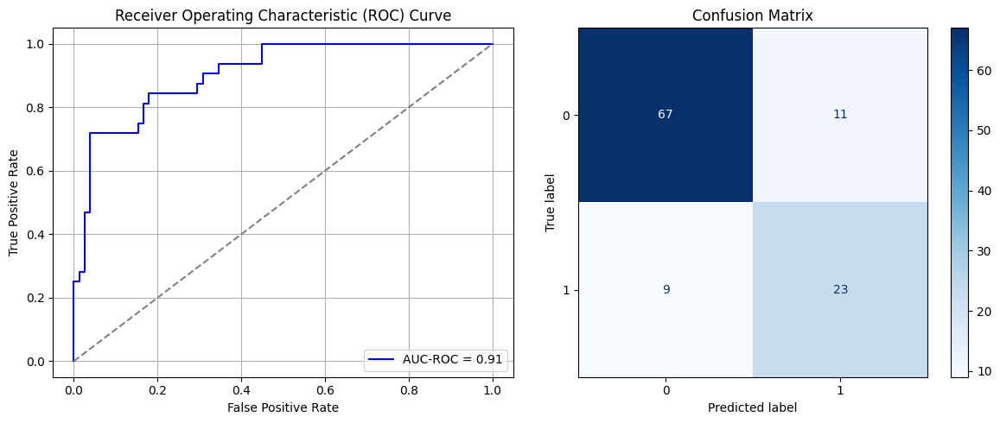

Best threshold based on F1-score: 0.8341277837753296
False Negative Rate: 0.28125
Time elapsed (performance): 0.4773595829997248
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7354 - loss: 0.6514 - val_AUC: 0.8741 - val_loss: 0.5333
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8613 - loss: 0.5092 - val_AUC: 0.9025 - val_loss: 0.4183
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8732 - loss: 0.4411 - val_AUC: 0.9130 - val_loss: 0.3797
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8960 - loss: 0.3930 - val_AUC: 0.9177 - val_loss: 0.3653
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9104 - loss: 0.3672 - val_AUC: 0.9201 - val_loss: 0.3590
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9192 - loss: 0.3481 - val_AUC: 0.9203 - val_loss: 0.3555
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9093 - loss: 0.3589 - val_AUC: 0.9233 - val_loss: 0.3494
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9303 - loss: 0.3269 - val_AUC: 0.9235 - val_loss: 0.3492
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9281 - loss: 0.3352 - va

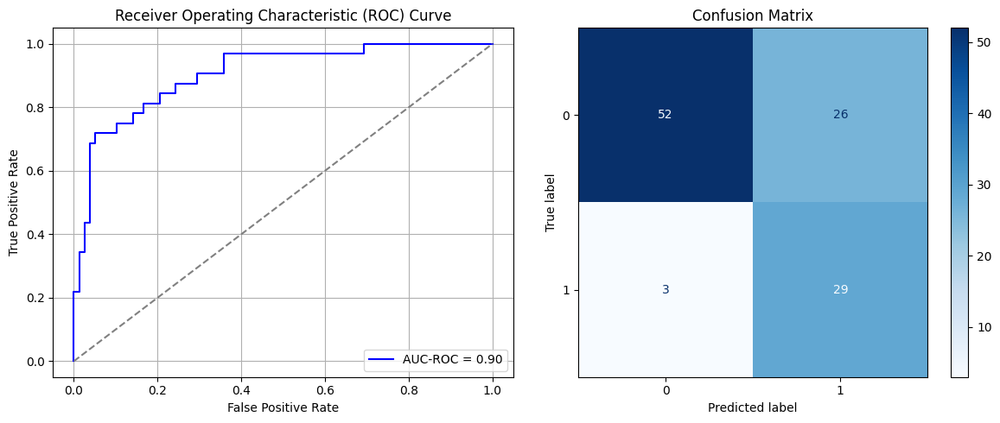

Best threshold based on F1-score: 0.9356239438056946
False Negative Rate: 0.09375
Time elapsed (performance): 0.4633137590003571
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6297 - loss: 0.6705 - val_AUC: 0.8432 - val_loss: 0.5591
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8665 - loss: 0.5095 - val_AUC: 0.8766 - val_loss: 0.4562
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8867 - loss: 0.4265 - val_AUC: 0.8878 - val_loss: 0.4293
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9034 - loss: 0.3964 - val_AUC: 0.8956 - val_loss: 0.4318
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8978 - loss: 0.3988 - val_AUC: 0.9018 - val_loss: 0.4001
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9166 - loss: 0.3619 - val_AUC: 0.9038 - val_loss: 0.3990
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8999 - loss: 0.3905 - val_AUC: 0.9077 - val_loss: 0.3861
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9195 - loss: 0.3542 - val_AUC: 0.9076 - val_loss: 0.4023
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9141 - loss: 0.3606 - va

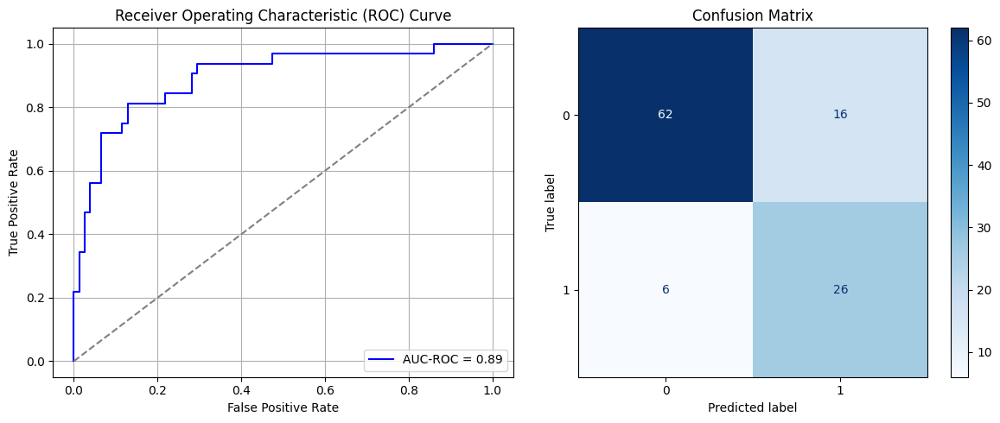

Best threshold based on F1-score: 0.8398317694664001
False Negative Rate: 0.1875
Time elapsed (performance): 0.45200535000003583
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6950 - loss: 0.6491 - val_AUC: 0.8786 - val_loss: 0.4966
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8699 - loss: 0.4702 - val_AUC: 0.9154 - val_loss: 0.3996
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8900 - loss: 0.4137 - val_AUC: 0.9297 - val_loss: 0.3502
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8993 - loss: 0.3958 - val_AUC: 0.9357 - val_loss: 0.3312
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.9108 - loss: 0.3689 - val_AUC: 0.9375 - val_loss: 0.3232
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9165 - loss: 0.3580 - val_AUC: 0.9389 - val_loss: 0.3202
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9130 - loss: 0.3600 - val_AUC: 0.9401 - val_loss: 0.3157
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9172 - loss: 0.3496 - val_AUC: 0.9401 - val_loss: 0.3147
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9157 - loss: 0.3504 - va

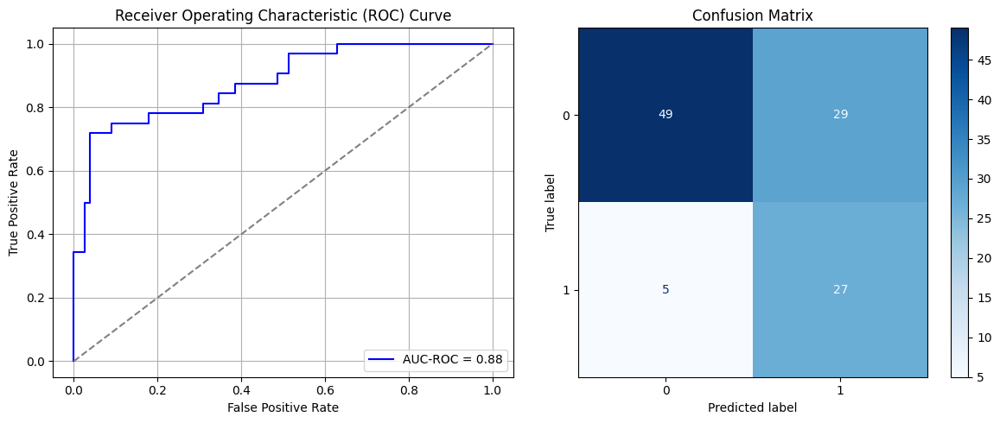

Best threshold based on F1-score: 0.9165728688240051
False Negative Rate: 0.15625
Time elapsed (performance): 1.668506324000191
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - AUC: 0.7635 - loss: 0.6460 - val_AUC: 0.8909 - val_loss: 0.5127
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8732 - loss: 0.4891 - val_AUC: 0.9103 - val_loss: 0.4133
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8759 - loss: 0.4404 - val_AUC: 0.9192 - val_loss: 0.3979
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8982 - loss: 0.4005 - val_AUC: 0.9236 - val_loss: 0.3579
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9094 - loss: 0.3766 - val_AUC: 0.9260 - val_loss: 0.3497
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9066 - loss: 0.3751 - val_AUC: 0.9259 - val_loss: 0.3526
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9131 - loss: 0.3626 - val_AUC: 0.9272 - val_loss: 0.3410
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9192 - loss: 0.3484 - val_AUC: 0.9292 - val_loss: 0.3425
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9153 - loss: 0.3647 - v

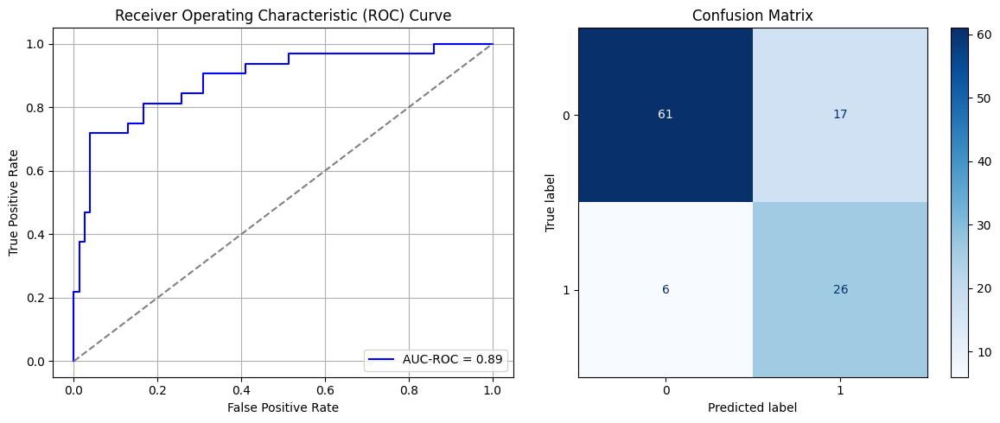

Best threshold based on F1-score: 0.860670268535614
False Negative Rate: 0.1875
Time elapsed (performance): 0.473739698999907
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - AUC: 0.7083 - loss: 0.6449 - val_AUC: 0.8853 - val_loss: 0.5065
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8571 - loss: 0.4948 - val_AUC: 0.9090 - val_loss: 0.4020
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8745 - loss: 0.4345 - val_AUC: 0.9176 - val_loss: 0.3745
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8950 - loss: 0.3956 - val_AUC: 0.9184 - val_loss: 0.3708
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8828 - loss: 0.4073 - val_AUC: 0.9213 - val_loss: 0.3550
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8983 - loss: 0.3823 - val_AUC: 0.9250 - val_loss: 0.3448
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - AUC: 0.9216 - loss: 0.3494 - val_AUC: 0.9251 - val_loss: 0.3666
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9196 - loss: 0.3471 - val_AUC: 0.9282 - val_loss: 0.3360
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9248 - loss: 0.3368 - 

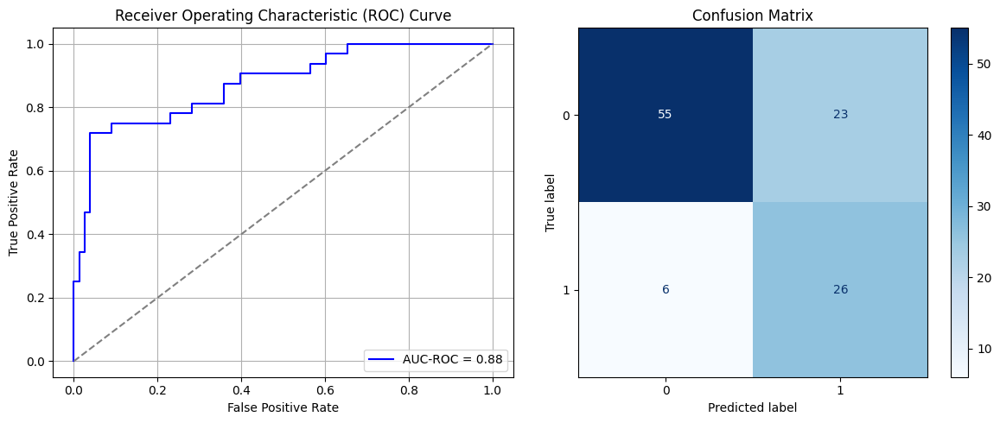

Best threshold based on F1-score: 0.9054705500602722
False Negative Rate: 0.1875
Time elapsed (performance): 0.49539563000007547
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6882 - loss: 0.6565 - val_AUC: 0.8839 - val_loss: 0.5135
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8547 - loss: 0.4987 - val_AUC: 0.9059 - val_loss: 0.4111
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8979 - loss: 0.3985 - val_AUC: 0.9110 - val_loss: 0.3966
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8909 - loss: 0.4113 - val_AUC: 0.9136 - val_loss: 0.3927
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9011 - loss: 0.3849 - val_AUC: 0.9171 - val_loss: 0.3706
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9137 - loss: 0.3610 - val_AUC: 0.9172 - val_loss: 0.3739
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9119 - loss: 0.3622 - val_AUC: 0.9186 - val_loss: 0.3665
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9198 - loss: 0.3532 - val_AUC: 0.9208 - val_loss: 0.3713
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9125 - loss: 0.3559 - va

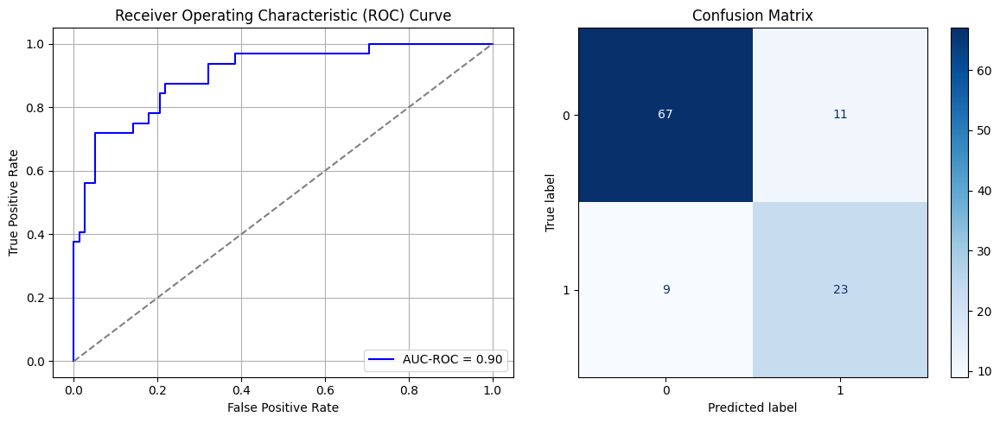

Best threshold based on F1-score: 0.759905219078064
False Negative Rate: 0.28125
Time elapsed (performance): 0.5067513760000111
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - AUC: 0.6795 - loss: 0.6637 - val_AUC: 0.8831 - val_loss: 0.5193
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8565 - loss: 0.4980 - val_AUC: 0.9069 - val_loss: 0.4046
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8730 - loss: 0.4385 - val_AUC: 0.9160 - val_loss: 0.3881
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8878 - loss: 0.4168 - val_AUC: 0.9196 - val_loss: 0.3746
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8781 - loss: 0.4292 - val_AUC: 0.9228 - val_loss: 0.3564
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8816 - loss: 0.4192 - val_AUC: 0.9239 - val_loss: 0.3554
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9012 - loss: 0.3894 - val_AUC: 0.9263 - val_loss: 0.3519
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9223 - loss: 0.3475 - val_AUC: 0.9267 - val_loss: 0.3513
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9082 - loss: 0.3728 - v

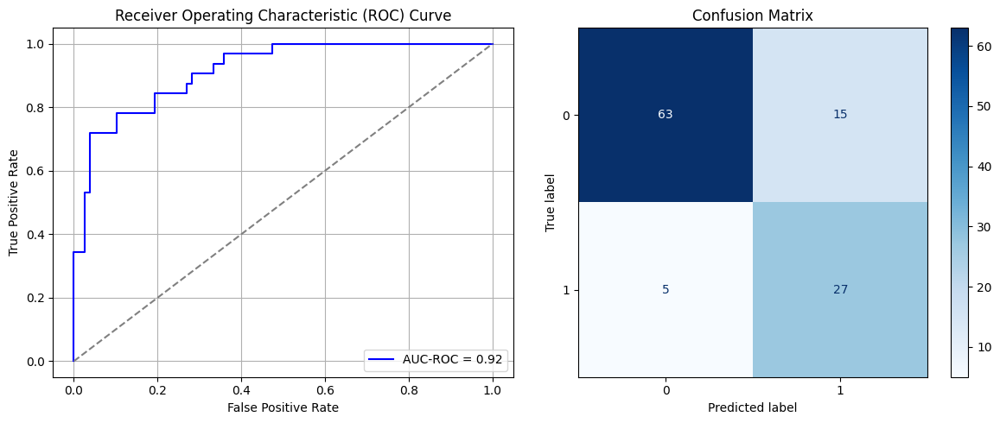

Best threshold based on F1-score: 0.7909708023071289
False Negative Rate: 0.15625
Time elapsed (performance): 0.4963840860000346
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7290 - loss: 0.6453 - val_AUC: 0.8925 - val_loss: 0.4842
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8589 - loss: 0.4858 - val_AUC: 0.9115 - val_loss: 0.4102
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8802 - loss: 0.4267 - val_AUC: 0.9207 - val_loss: 0.3749
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9041 - loss: 0.3811 - val_AUC: 0.9259 - val_loss: 0.3582
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9060 - loss: 0.3847 - val_AUC: 0.9299 - val_loss: 0.3493
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9030 - loss: 0.3837 - val_AUC: 0.9317 - val_loss: 0.3486
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9138 - loss: 0.3630 - val_AUC: 0.9324 - val_loss: 0.3539
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9229 - loss: 0.3467 - val_AUC: 0.9349 - val_loss: 0.3310
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9073 - loss: 0.3775 - va

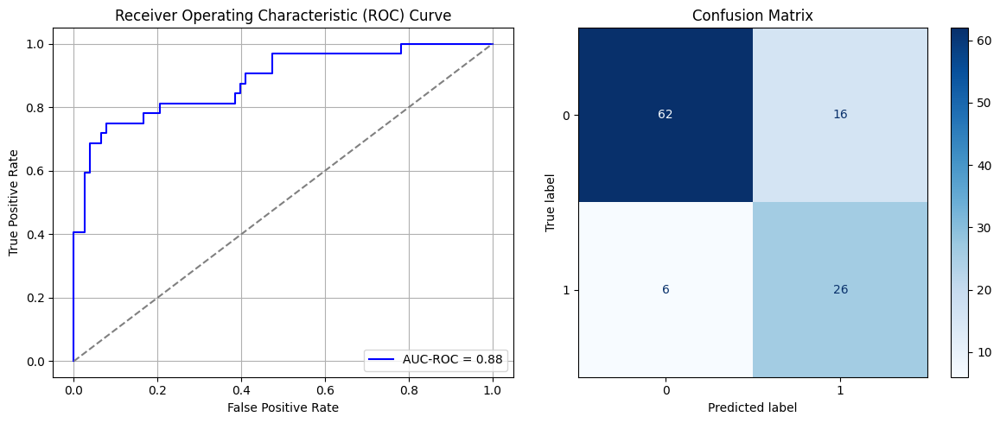

Best threshold based on F1-score: 0.6752928495407104
False Negative Rate: 0.1875
Time elapsed (performance): 0.4846708159998343
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.7305 - loss: 0.6387 - val_AUC: 0.8809 - val_loss: 0.4901
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8672 - loss: 0.4772 - val_AUC: 0.9084 - val_loss: 0.4179
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8680 - loss: 0.4546 - val_AUC: 0.9177 - val_loss: 0.3928
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8918 - loss: 0.4120 - val_AUC: 0.9232 - val_loss: 0.3662
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9143 - loss: 0.3729 - val_AUC: 0.9275 - val_loss: 0.3647
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9040 - loss: 0.3895 - val_AUC: 0.9274 - val_loss: 0.3472
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8999 - loss: 0.3969 - val_AUC: 0.9282 - val_loss: 0.3442
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9169 - loss: 0.3632 - val_AUC: 0.9299 - val_loss: 0.3403
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9226 - loss: 0.3517 - v

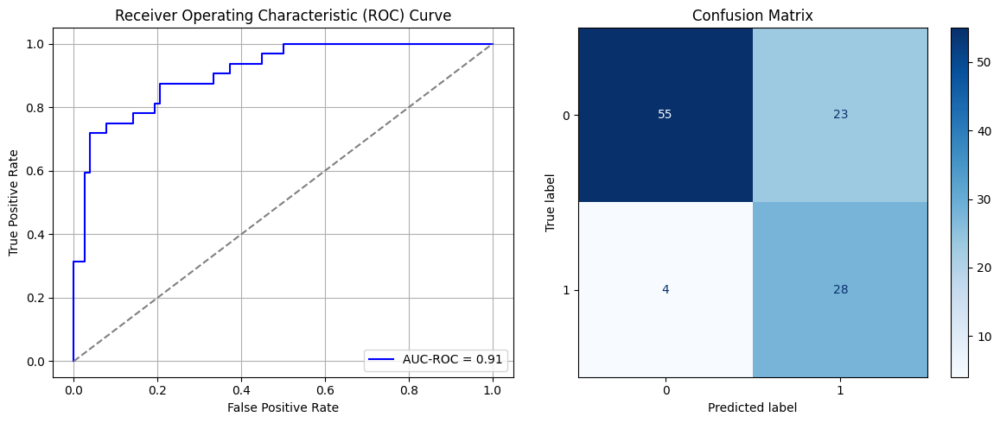

Best threshold based on F1-score: 0.8986015915870667
False Negative Rate: 0.125
Time elapsed (performance): 0.4890314449999096
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7109 - loss: 0.6419 - val_AUC: 0.8911 - val_loss: 0.4911
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8731 - loss: 0.4727 - val_AUC: 0.9094 - val_loss: 0.3986
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8884 - loss: 0.4172 - val_AUC: 0.9148 - val_loss: 0.3725
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8939 - loss: 0.3945 - val_AUC: 0.9191 - val_loss: 0.3599
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9073 - loss: 0.3768 - val_AUC: 0.9211 - val_loss: 0.3769
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9081 - loss: 0.3785 - val_AUC: 0.9247 - val_loss: 0.3481
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9102 - loss: 0.3624 - val_AUC: 0.9258 - val_loss: 0.3483
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9209 - loss: 0.3460 - val_AUC: 0.9266 - val_loss: 0.3394
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9231 - loss: 0.3469 - va

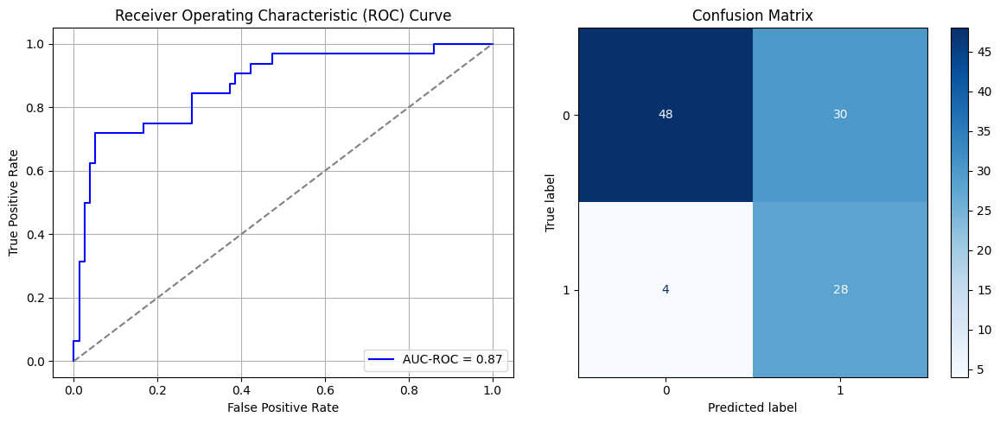

Best threshold based on F1-score: 0.9309285879135132
False Negative Rate: 0.125
Time elapsed (performance): 0.5123342599999887
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.7090 - loss: 0.6546 - val_AUC: 0.8797 - val_loss: 0.5056
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8691 - loss: 0.4848 - val_AUC: 0.9065 - val_loss: 0.4078
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8775 - loss: 0.4335 - val_AUC: 0.9166 - val_loss: 0.3797
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9144 - loss: 0.3710 - val_AUC: 0.9230 - val_loss: 0.3711
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9027 - loss: 0.3898 - val_AUC: 0.9251 - val_loss: 0.3581
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8974 - loss: 0.3881 - val_AUC: 0.9269 - val_loss: 0.3512
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9019 - loss: 0.3852 - val_AUC: 0.9275 - val_loss: 0.3477
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9223 - loss: 0.3452 - val_AUC: 0.9293 - val_loss: 0.3453
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9250 - loss: 0.3357 - v

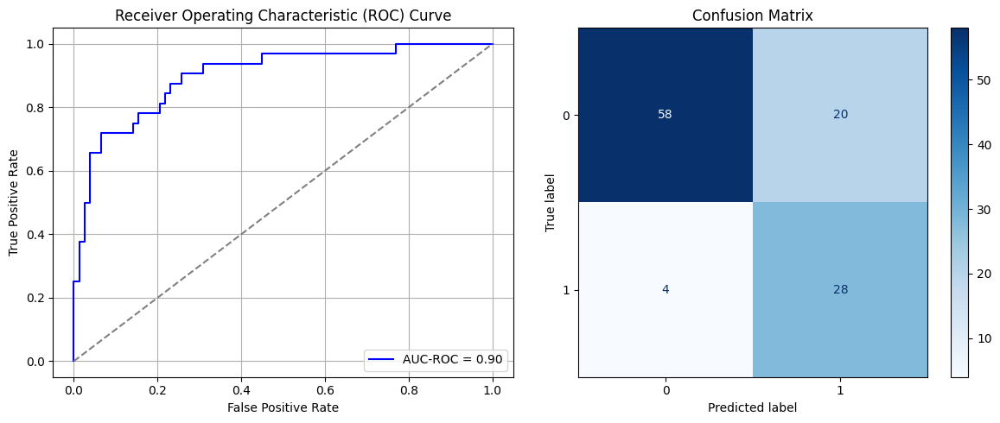

Best threshold based on F1-score: 0.9074214696884155
False Negative Rate: 0.125
Time elapsed (performance): 0.46579750000000786
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6354 - loss: 0.6695 - val_AUC: 0.8666 - val_loss: 0.5291
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8533 - loss: 0.5045 - val_AUC: 0.9001 - val_loss: 0.4153
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8708 - loss: 0.4432 - val_AUC: 0.9155 - val_loss: 0.3812
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8982 - loss: 0.4002 - val_AUC: 0.9235 - val_loss: 0.3662
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8988 - loss: 0.3902 - val_AUC: 0.9305 - val_loss: 0.3472
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9075 - loss: 0.3760 - val_AUC: 0.9332 - val_loss: 0.3372
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9023 - loss: 0.3801 - val_AUC: 0.9340 - val_loss: 0.3352
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9000 - loss: 0.3842 - val_AUC: 0.9336 - val_loss: 0.3388
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9142 - loss: 0.3661 - va

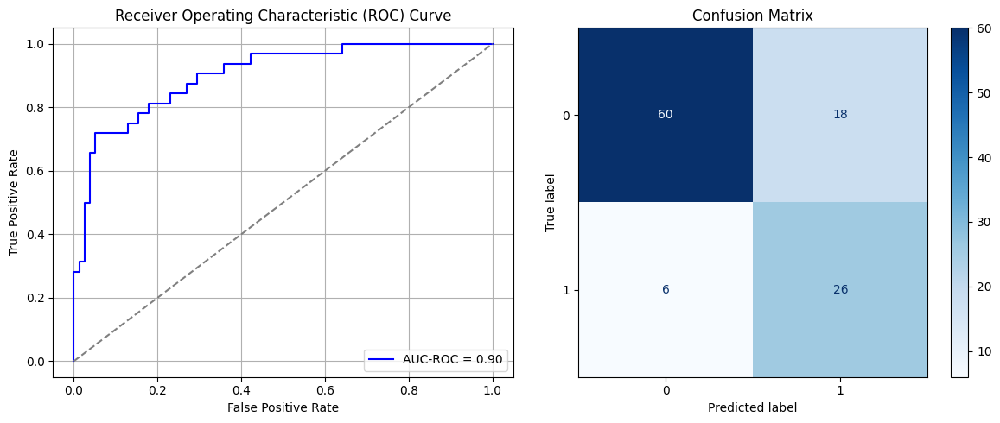

Best threshold based on F1-score: 0.8671922087669373
False Negative Rate: 0.1875
Time elapsed (performance): 0.45496138400039854
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.7293 - loss: 0.6587 - val_AUC: 0.8834 - val_loss: 0.5205
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8625 - loss: 0.4968 - val_AUC: 0.9055 - val_loss: 0.4061
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8787 - loss: 0.4254 - val_AUC: 0.9159 - val_loss: 0.3810
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8939 - loss: 0.3958 - val_AUC: 0.9200 - val_loss: 0.3761
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8985 - loss: 0.3912 - val_AUC: 0.9223 - val_loss: 0.3617
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9056 - loss: 0.3655 - val_AUC: 0.9236 - val_loss: 0.3620
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9105 - loss: 0.3659 - val_AUC: 0.9212 - val_loss: 0.3625
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9096 - loss: 0.3773 - val_AUC: 0.9221 - val_loss: 0.3577
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9160 - loss: 0.3597 - v

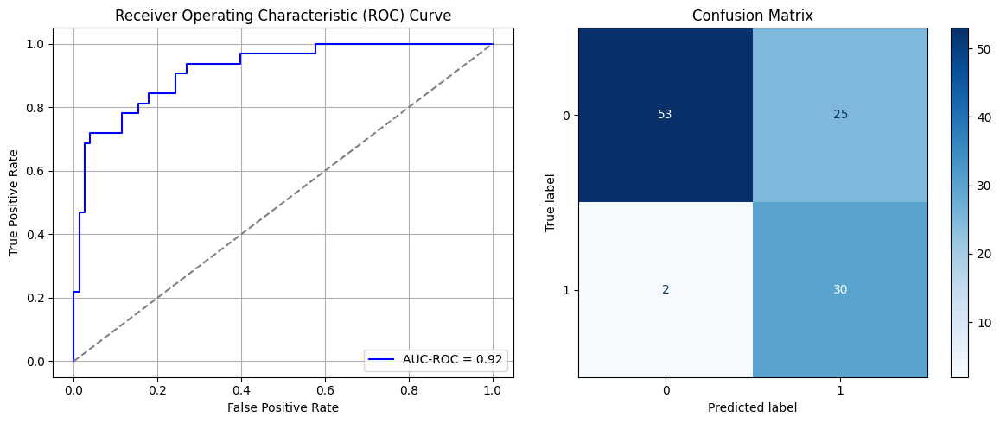

Best threshold based on F1-score: 0.9304806590080261
False Negative Rate: 0.0625
Time elapsed (performance): 0.4503517959997225
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7456 - loss: 0.6332 - val_AUC: 0.8794 - val_loss: 0.5059
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8489 - loss: 0.4971 - val_AUC: 0.9086 - val_loss: 0.4002
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8914 - loss: 0.4080 - val_AUC: 0.9185 - val_loss: 0.3852
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8924 - loss: 0.4077 - val_AUC: 0.9236 - val_loss: 0.3631
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9084 - loss: 0.3783 - val_AUC: 0.9265 - val_loss: 0.3498
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9123 - loss: 0.3672 - val_AUC: 0.9299 - val_loss: 0.3400
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9186 - loss: 0.3447 - val_AUC: 0.9289 - val_loss: 0.3377
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9179 - loss: 0.3510 - val_AUC: 0.9297 - val_loss: 0.3339
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9273 - loss: 0.3355 - va

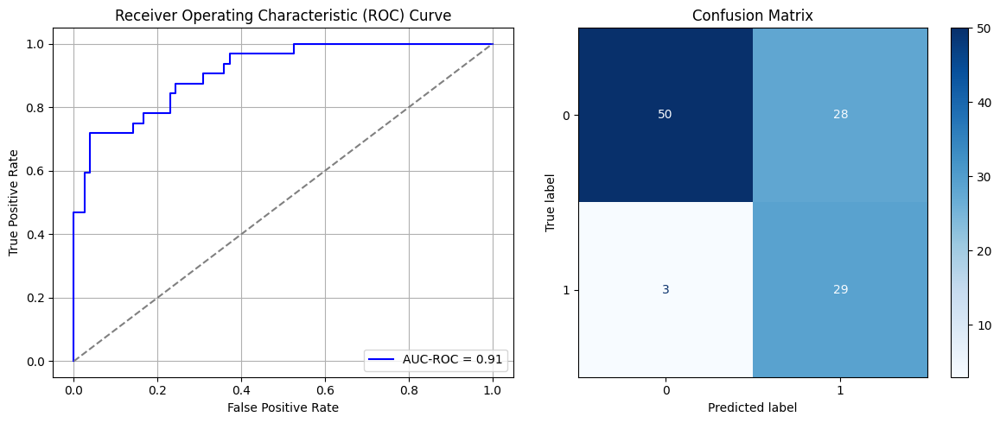

Best threshold based on F1-score: 0.9371103048324585
False Negative Rate: 0.09375
Time elapsed (performance): 0.46803295700010494
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.7345 - loss: 0.6294 - val_AUC: 0.9108 - val_loss: 0.4637
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8522 - loss: 0.4863 - val_AUC: 0.9242 - val_loss: 0.3793
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8809 - loss: 0.4248 - val_AUC: 0.9310 - val_loss: 0.3604
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8995 - loss: 0.3935 - val_AUC: 0.9324 - val_loss: 0.3510
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9003 - loss: 0.3878 - val_AUC: 0.9331 - val_loss: 0.3494
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9018 - loss: 0.3867 - val_AUC: 0.9356 - val_loss: 0.3382
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9081 - loss: 0.3751 - val_AUC: 0.9336 - val_loss: 0.3409
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9038 - loss: 0.3800 - val_AUC: 0.9360 - val_loss: 0.3398
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9122 - loss: 0.3654 - v

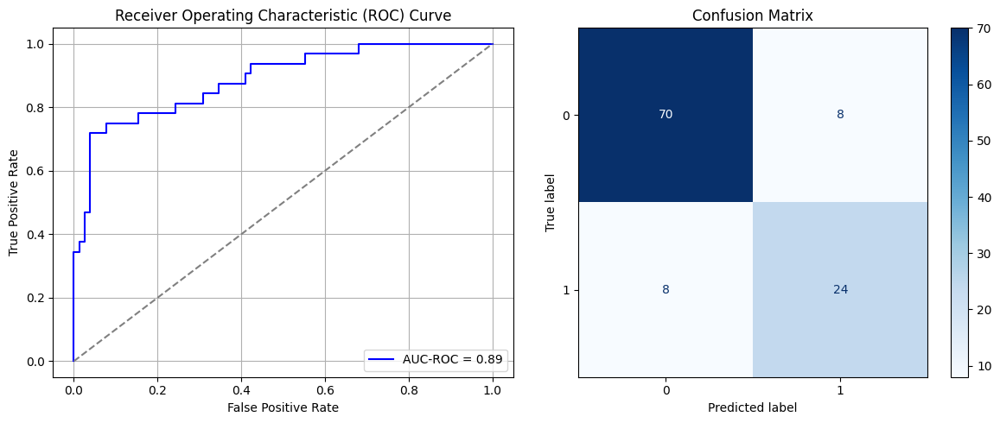

Best threshold based on F1-score: 0.7523478865623474
False Negative Rate: 0.25
Time elapsed (performance): 0.4912873920002312
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7222 - loss: 0.6497 - val_AUC: 0.9086 - val_loss: 0.4786
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8762 - loss: 0.4699 - val_AUC: 0.9179 - val_loss: 0.3820
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8934 - loss: 0.4090 - val_AUC: 0.9243 - val_loss: 0.3660
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9009 - loss: 0.3855 - val_AUC: 0.9265 - val_loss: 0.3513
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9038 - loss: 0.3821 - val_AUC: 0.9300 - val_loss: 0.3422
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9176 - loss: 0.3556 - val_AUC: 0.9295 - val_loss: 0.3383
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9141 - loss: 0.3628 - val_AUC: 0.9300 - val_loss: 0.3613
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9194 - loss: 0.3549 - val_AUC: 0.9303 - val_loss: 0.3363
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9204 - loss: 0.3514 - v

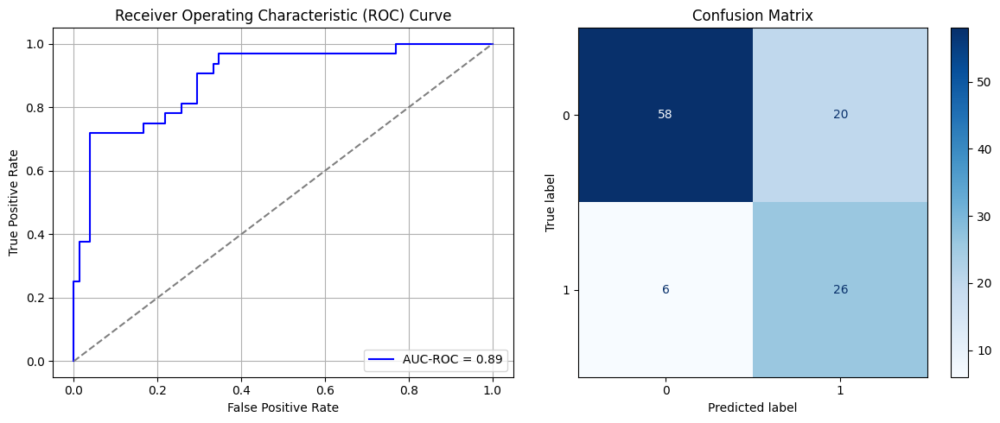

Best threshold based on F1-score: 0.8957768082618713
False Negative Rate: 0.1875
Time elapsed (performance): 0.4765218949996779
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - AUC: 0.6993 - loss: 0.6494 - val_AUC: 0.8883 - val_loss: 0.5079
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8539 - loss: 0.4989 - val_AUC: 0.9122 - val_loss: 0.4002
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8932 - loss: 0.4120 - val_AUC: 0.9230 - val_loss: 0.3656
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8833 - loss: 0.4231 - val_AUC: 0.9260 - val_loss: 0.3619
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9085 - loss: 0.3811 - val_AUC: 0.9286 - val_loss: 0.3474
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9139 - loss: 0.3678 - val_AUC: 0.9299 - val_loss: 0.3494
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9131 - loss: 0.3683 - val_AUC: 0.9297 - val_loss: 0.3393
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9133 - loss: 0.3580 - val_AUC: 0.9315 - val_loss: 0.3344
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9099 - loss: 0.3702 - v

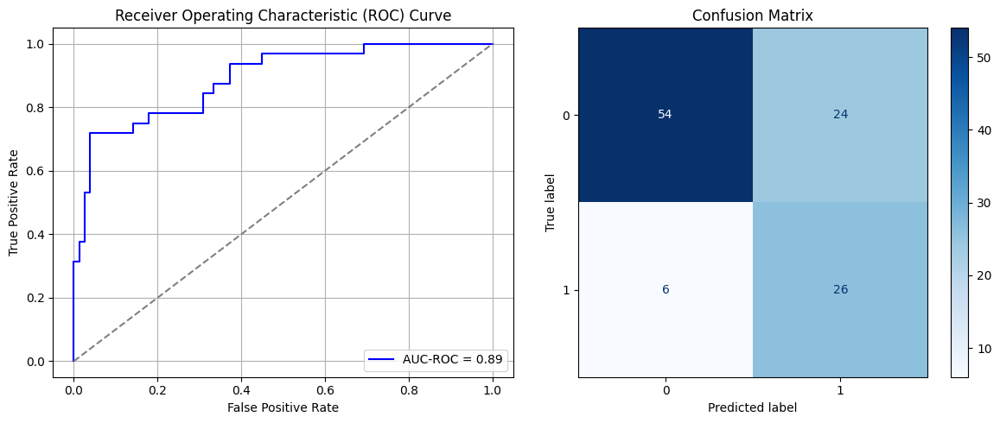

Best threshold based on F1-score: 0.9086729884147644
False Negative Rate: 0.1875
Time elapsed (performance): 0.5271060770000986
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6362 - loss: 0.6664 - val_AUC: 0.8942 - val_loss: 0.4940
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8765 - loss: 0.4727 - val_AUC: 0.9122 - val_loss: 0.4094
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8943 - loss: 0.4165 - val_AUC: 0.9194 - val_loss: 0.3842
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8934 - loss: 0.4054 - val_AUC: 0.9230 - val_loss: 0.3625
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9024 - loss: 0.3932 - val_AUC: 0.9261 - val_loss: 0.3509
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9102 - loss: 0.3715 - val_AUC: 0.9275 - val_loss: 0.3616
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9136 - loss: 0.3628 - val_AUC: 0.9297 - val_loss: 0.3420
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9121 - loss: 0.3647 - val_AUC: 0.9314 - val_loss: 0.3376
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9146 - loss: 0.3608 - v

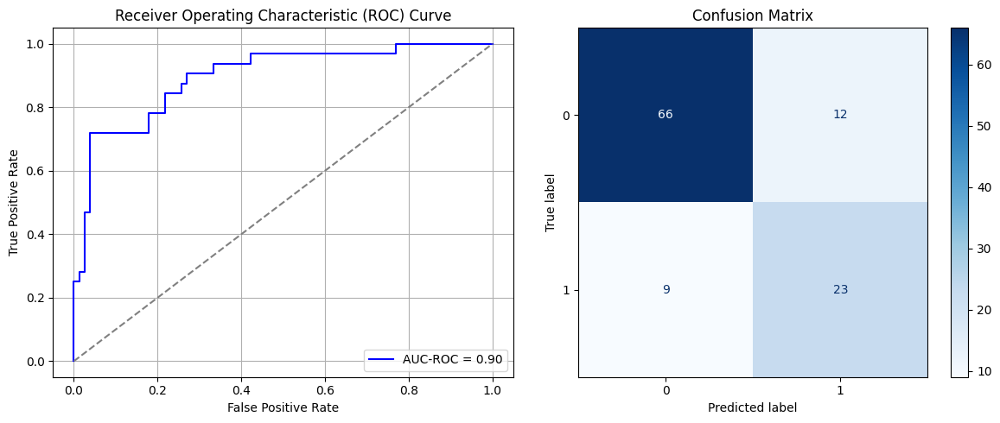

Best threshold based on F1-score: 0.8314028978347778
False Negative Rate: 0.28125
Time elapsed (performance): 0.5082192479999321
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6815 - loss: 0.6518 - val_AUC: 0.8632 - val_loss: 0.5115
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8697 - loss: 0.4758 - val_AUC: 0.8871 - val_loss: 0.4390
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8835 - loss: 0.4277 - val_AUC: 0.8948 - val_loss: 0.4194
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8966 - loss: 0.3971 - val_AUC: 0.8998 - val_loss: 0.4152
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9023 - loss: 0.3893 - val_AUC: 0.9053 - val_loss: 0.4078
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9012 - loss: 0.3910 - val_AUC: 0.9069 - val_loss: 0.4020
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9105 - loss: 0.3717 - val_AUC: 0.9107 - val_loss: 0.3971
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9175 - loss: 0.3582 - val_AUC: 0.9098 - val_loss: 0.3867
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9136 - loss: 0.3695 - v

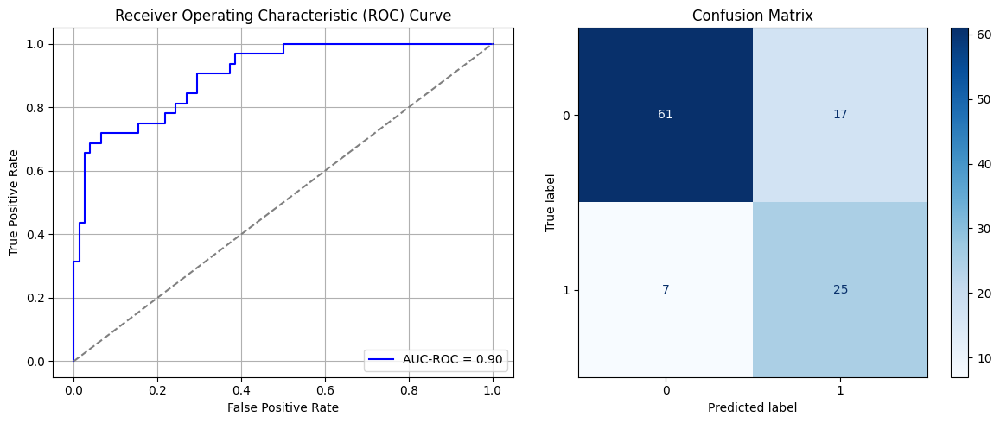

Best threshold based on F1-score: 0.8684859275817871
False Negative Rate: 0.21875
Time elapsed (performance): 0.5402376209999602
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - AUC: 0.6317 - loss: 0.6628 - val_AUC: 0.8911 - val_loss: 0.5038
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8765 - loss: 0.4719 - val_AUC: 0.9090 - val_loss: 0.4104
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8991 - loss: 0.4048 - val_AUC: 0.9172 - val_loss: 0.3854
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9048 - loss: 0.3812 - val_AUC: 0.9204 - val_loss: 0.3725
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9011 - loss: 0.3770 - val_AUC: 0.9253 - val_loss: 0.3643
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9040 - loss: 0.3835 - val_AUC: 0.9260 - val_loss: 0.3553
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9199 - loss: 0.3435 - val_AUC: 0.9275 - val_loss: 0.3524
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9155 - loss: 0.3594 - val_AUC: 0.9263 - val_loss: 0.3564
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9207 - loss: 0.3494 - v

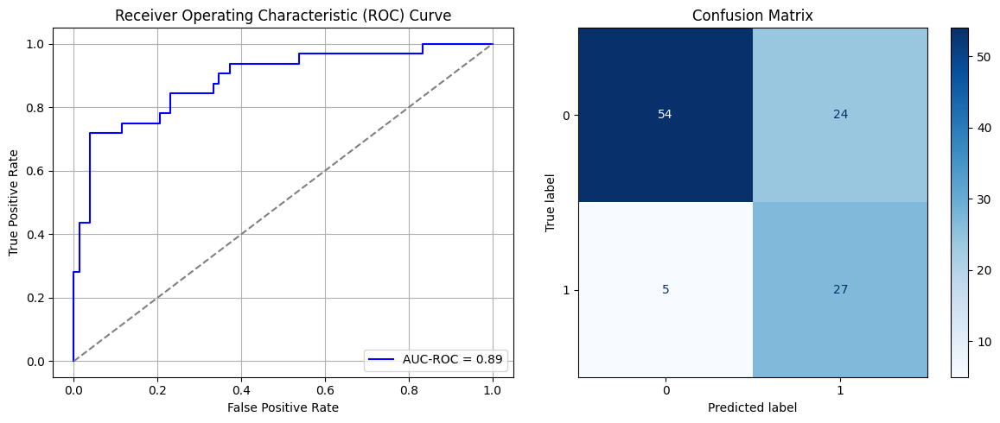

Best threshold based on F1-score: 0.8968603610992432
False Negative Rate: 0.15625
Time elapsed (performance): 0.516492761000336
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7115 - loss: 0.6512 - val_AUC: 0.8855 - val_loss: 0.5082
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8839 - loss: 0.4792 - val_AUC: 0.9057 - val_loss: 0.4132
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8903 - loss: 0.4165 - val_AUC: 0.9137 - val_loss: 0.3841
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8921 - loss: 0.4060 - val_AUC: 0.9170 - val_loss: 0.3835
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9041 - loss: 0.3834 - val_AUC: 0.9193 - val_loss: 0.3647
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9071 - loss: 0.3726 - val_AUC: 0.9200 - val_loss: 0.3800
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9060 - loss: 0.3786 - val_AUC: 0.9204 - val_loss: 0.3587
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9176 - loss: 0.3503 - val_AUC: 0.9211 - val_loss: 0.3581
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9134 - loss: 0.3552 - v

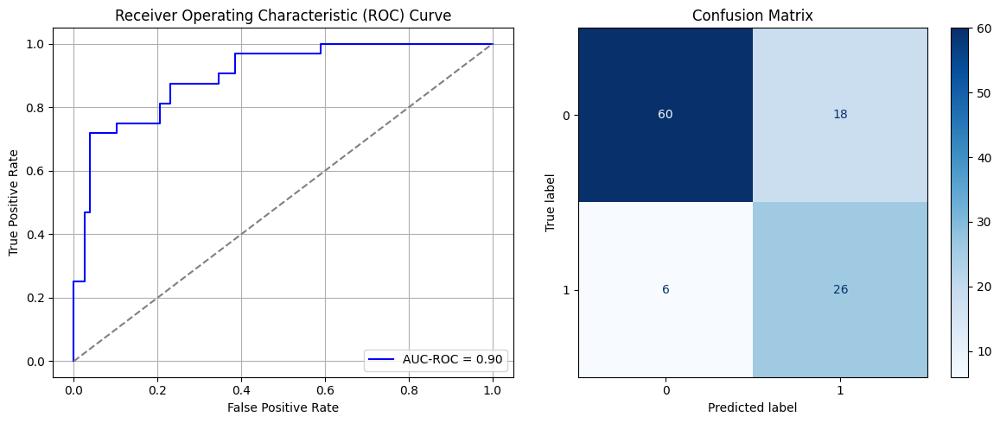

Best threshold based on F1-score: 0.8773229122161865
False Negative Rate: 0.1875
Time elapsed (performance): 0.7049937980000323
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7504 - loss: 0.6387 - val_AUC: 0.8681 - val_loss: 0.5062
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8478 - loss: 0.5011 - val_AUC: 0.8981 - val_loss: 0.4229
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8750 - loss: 0.4419 - val_AUC: 0.9103 - val_loss: 0.4045
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9113 - loss: 0.3780 - val_AUC: 0.9160 - val_loss: 0.3808
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8975 - loss: 0.3956 - val_AUC: 0.9183 - val_loss: 0.3730
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9102 - loss: 0.3721 - val_AUC: 0.9198 - val_loss: 0.3714
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9125 - loss: 0.3678 - val_AUC: 0.9240 - val_loss: 0.3579
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9117 - loss: 0.3634 - val_AUC: 0.9234 - val_loss: 0.3541
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9150 - loss: 0.3583 - v

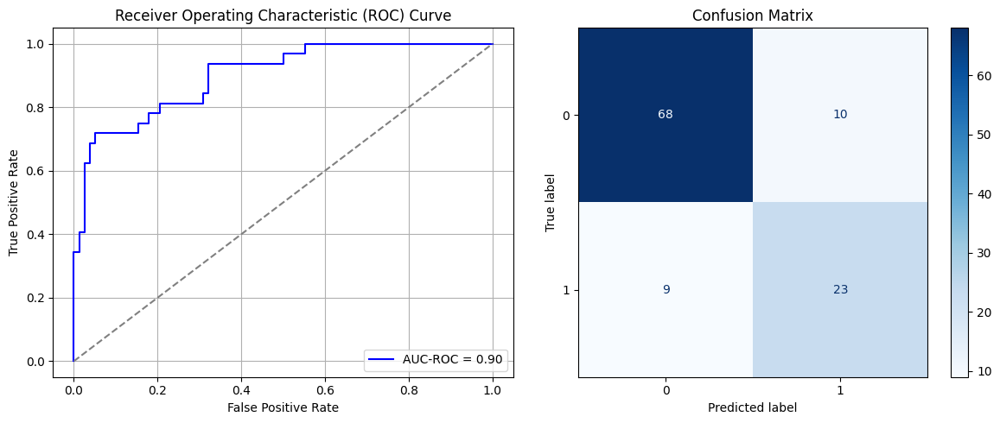

Best threshold based on F1-score: 0.7524667382240295
False Negative Rate: 0.28125
Time elapsed (performance): 0.49208263500031535
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6384 - loss: 0.6720 - val_AUC: 0.8660 - val_loss: 0.5405
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8482 - loss: 0.5244 - val_AUC: 0.9007 - val_loss: 0.4219
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8938 - loss: 0.4185 - val_AUC: 0.9144 - val_loss: 0.3834
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9056 - loss: 0.3869 - val_AUC: 0.9194 - val_loss: 0.3863
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9000 - loss: 0.3943 - val_AUC: 0.9204 - val_loss: 0.3638
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8992 - loss: 0.3852 - val_AUC: 0.9228 - val_loss: 0.3655
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9057 - loss: 0.3787 - val_AUC: 0.9245 - val_loss: 0.3582
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.9188 - loss: 0.3526 - val_AUC: 0.9252 - val_loss: 0.3568
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9309 - loss: 0.3296 - va

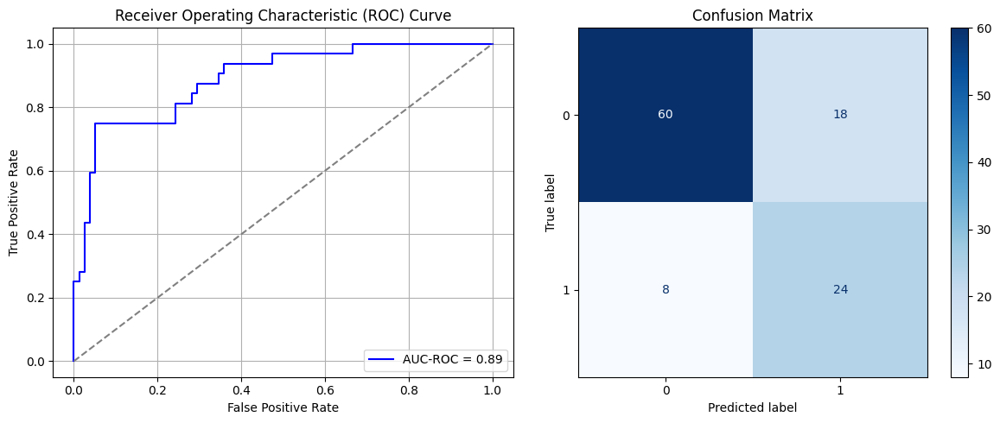

Best threshold based on F1-score: 0.7858806252479553
False Negative Rate: 0.25
Time elapsed (performance): 0.6388545220002015
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7076 - loss: 0.6496 - val_AUC: 0.8903 - val_loss: 0.5128
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8821 - loss: 0.4839 - val_AUC: 0.9073 - val_loss: 0.4241
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8800 - loss: 0.4402 - val_AUC: 0.9182 - val_loss: 0.3806
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8931 - loss: 0.4138 - val_AUC: 0.9224 - val_loss: 0.3669
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9009 - loss: 0.3919 - val_AUC: 0.9263 - val_loss: 0.3545
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9039 - loss: 0.3832 - val_AUC: 0.9300 - val_loss: 0.3510
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9101 - loss: 0.3744 - val_AUC: 0.9320 - val_loss: 0.3398
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8978 - loss: 0.3970 - val_AUC: 0.9330 - val_loss: 0.3324
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9047 - loss: 0.3802 - v

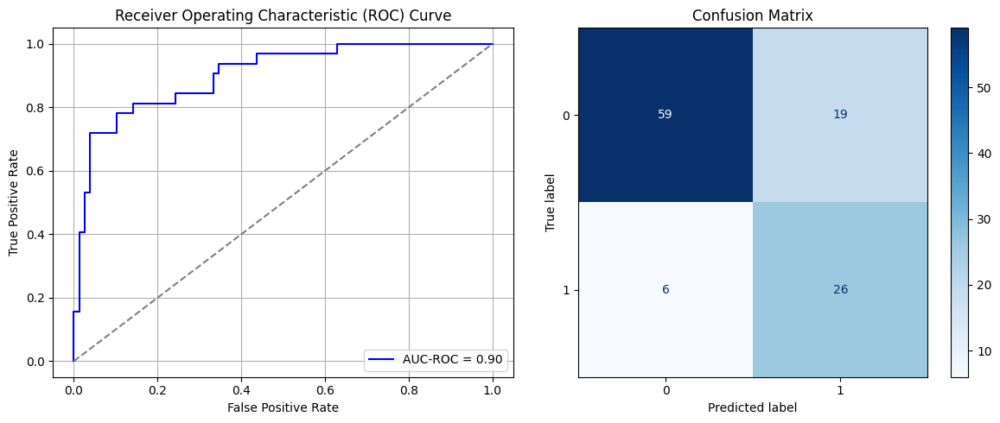

Best threshold based on F1-score: 0.8175681233406067
False Negative Rate: 0.1875
Time elapsed (performance): 0.4657763690001957
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7582 - loss: 0.6420 - val_AUC: 0.8780 - val_loss: 0.5108
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8505 - loss: 0.4990 - val_AUC: 0.8914 - val_loss: 0.4305
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8833 - loss: 0.4297 - val_AUC: 0.9022 - val_loss: 0.4103
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8698 - loss: 0.4441 - val_AUC: 0.9077 - val_loss: 0.3988
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.9094 - loss: 0.3797 - val_AUC: 0.9097 - val_loss: 0.3893
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9051 - loss: 0.3872 - val_AUC: 0.9096 - val_loss: 0.3937
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9004 - loss: 0.3923 - val_AUC: 0.9112 - val_loss: 0.3874
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9067 - loss: 0.3774 - val_AUC: 0.9140 - val_loss: 0.3752
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9259 - loss: 0.3421 - va

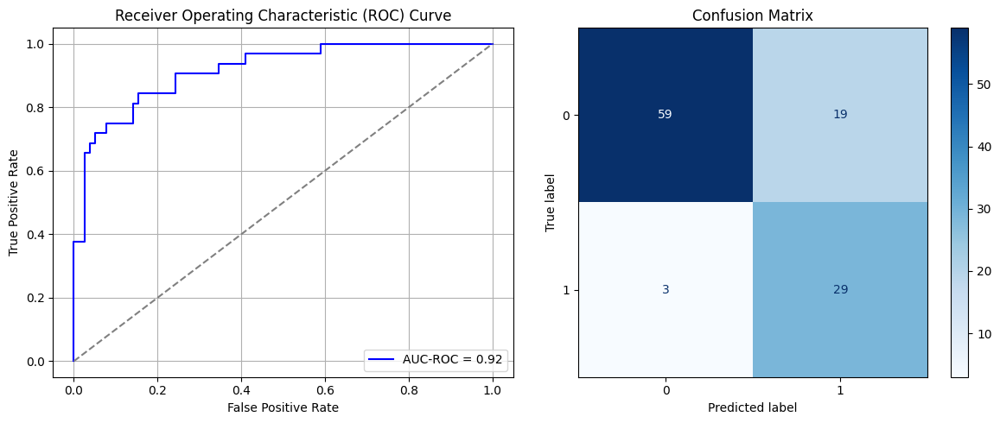

Best threshold based on F1-score: 0.8085240125656128
False Negative Rate: 0.09375
Time elapsed (performance): 0.48202255999967747
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6947 - loss: 0.6642 - val_AUC: 0.8832 - val_loss: 0.5344
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8604 - loss: 0.5002 - val_AUC: 0.9043 - val_loss: 0.4066
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8865 - loss: 0.4132 - val_AUC: 0.9128 - val_loss: 0.3996
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8884 - loss: 0.4100 - val_AUC: 0.9182 - val_loss: 0.3731
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9072 - loss: 0.3786 - val_AUC: 0.9192 - val_loss: 0.3782
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9091 - loss: 0.3753 - val_AUC: 0.9205 - val_loss: 0.3877
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8933 - loss: 0.3984 - val_AUC: 0.9222 - val_loss: 0.3738
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9030 - loss: 0.3763 - val_AUC: 0.9241 - val_loss: 0.3715
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9189 - loss: 0.3508 - va

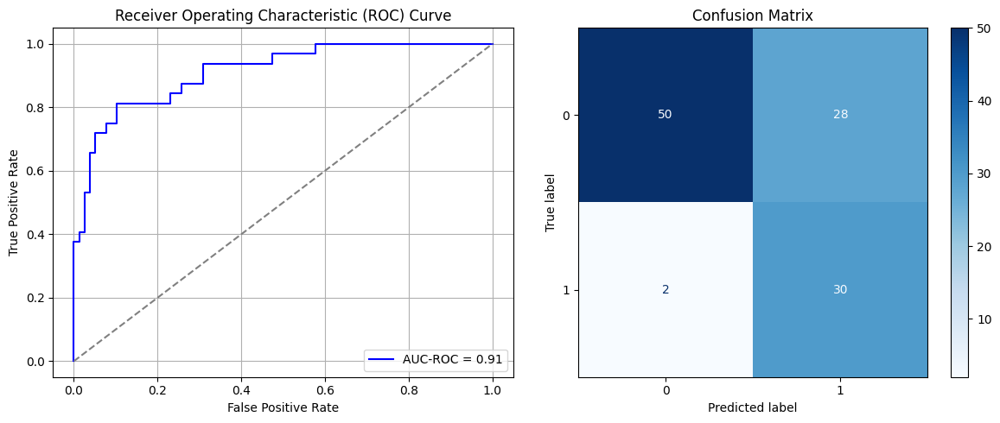

Best threshold based on F1-score: 0.8025316596031189
False Negative Rate: 0.0625
Time elapsed (performance): 0.49405905699995856
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6877 - loss: 0.6574 - val_AUC: 0.8770 - val_loss: 0.5245
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8778 - loss: 0.4824 - val_AUC: 0.8983 - val_loss: 0.4249
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8891 - loss: 0.4178 - val_AUC: 0.9092 - val_loss: 0.3946
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9026 - loss: 0.3870 - val_AUC: 0.9158 - val_loss: 0.3781
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.9117 - loss: 0.3751 - val_AUC: 0.9181 - val_loss: 0.3693
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9073 - loss: 0.3788 - val_AUC: 0.9204 - val_loss: 0.3636
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9039 - loss: 0.3833 - val_AUC: 0.9210 - val_loss: 0.3609
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9087 - loss: 0.3717 - val_AUC: 0.9225 - val_loss: 0.3649
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9210 - loss: 0.3472 - v

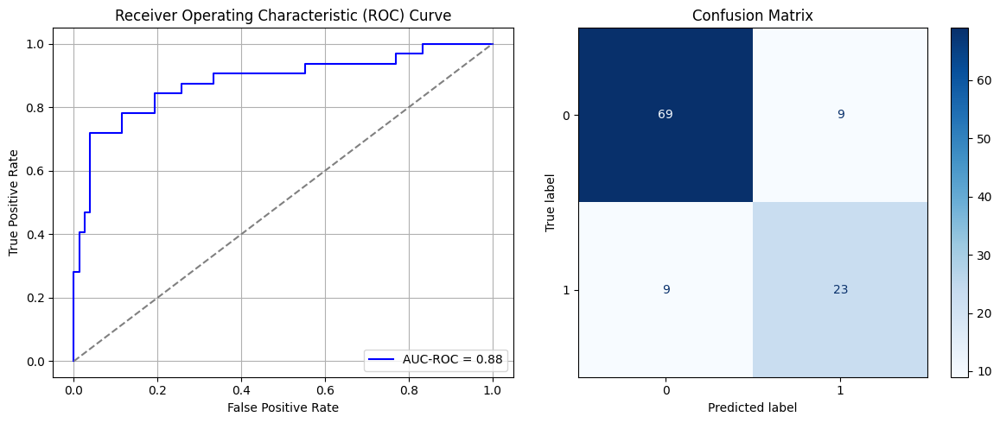

Best threshold based on F1-score: 0.8356467485427856
False Negative Rate: 0.28125
Time elapsed (performance): 0.515976197999862
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6600 - loss: 0.6552 - val_AUC: 0.8590 - val_loss: 0.5139
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8402 - loss: 0.5068 - val_AUC: 0.8971 - val_loss: 0.4234
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8883 - loss: 0.4212 - val_AUC: 0.9090 - val_loss: 0.3956
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8981 - loss: 0.3915 - val_AUC: 0.9147 - val_loss: 0.3723
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8999 - loss: 0.3902 - val_AUC: 0.9154 - val_loss: 0.3633
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9104 - loss: 0.3639 - val_AUC: 0.9193 - val_loss: 0.3575
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9102 - loss: 0.3671 - val_AUC: 0.9200 - val_loss: 0.3590
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9146 - loss: 0.3566 - val_AUC: 0.9222 - val_loss: 0.3521
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9107 - loss: 0.3708 - v

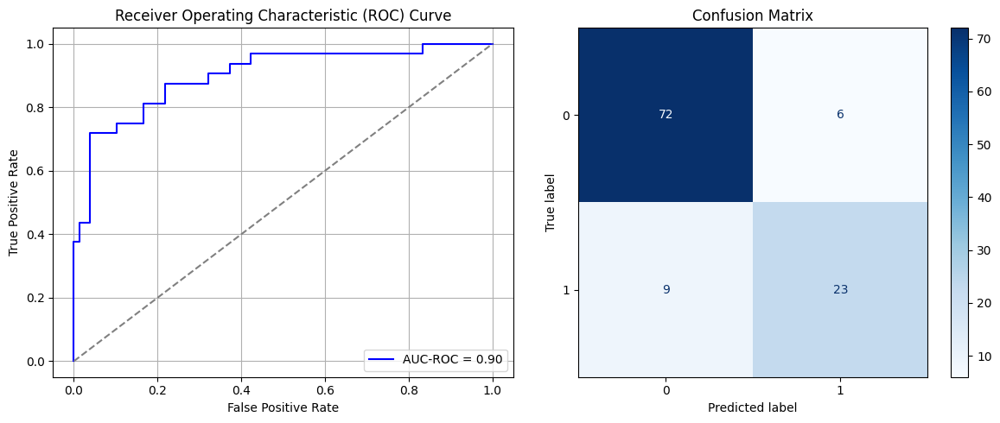

Best threshold based on F1-score: 0.7269120812416077
False Negative Rate: 0.28125
Time elapsed (performance): 0.5311127440004384
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - AUC: 0.6156 - loss: 0.6717 - val_AUC: 0.8943 - val_loss: 0.5345
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8764 - loss: 0.5028 - val_AUC: 0.9033 - val_loss: 0.4105
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8800 - loss: 0.4329 - val_AUC: 0.9107 - val_loss: 0.3907
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9039 - loss: 0.3894 - val_AUC: 0.9194 - val_loss: 0.3706
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8908 - loss: 0.4064 - val_AUC: 0.9213 - val_loss: 0.3626
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9068 - loss: 0.3821 - val_AUC: 0.9228 - val_loss: 0.3613
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9131 - loss: 0.3629 - val_AUC: 0.9271 - val_loss: 0.3497
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9070 - loss: 0.3825 - val_AUC: 0.9271 - val_loss: 0.3550
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9131 - loss: 0.3634 - v

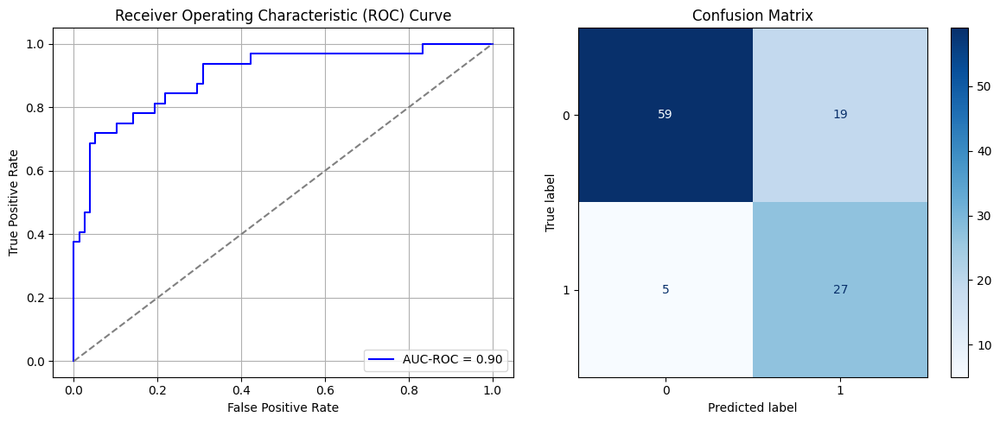

Best threshold based on F1-score: 0.8510606288909912
False Negative Rate: 0.15625
Time elapsed (performance): 0.5199120410002251
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7367 - loss: 0.6612 - val_AUC: 0.8794 - val_loss: 0.5684
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8540 - loss: 0.5326 - val_AUC: 0.8969 - val_loss: 0.4356
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8728 - loss: 0.4495 - val_AUC: 0.9097 - val_loss: 0.3961
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8897 - loss: 0.4126 - val_AUC: 0.9141 - val_loss: 0.3845
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8941 - loss: 0.4017 - val_AUC: 0.9178 - val_loss: 0.3693
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9072 - loss: 0.3741 - val_AUC: 0.9207 - val_loss: 0.3603
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9141 - loss: 0.3567 - val_AUC: 0.9218 - val_loss: 0.3560
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9080 - loss: 0.3666 - val_AUC: 0.9231 - val_loss: 0.3550
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9054 - loss: 0.3784 - v

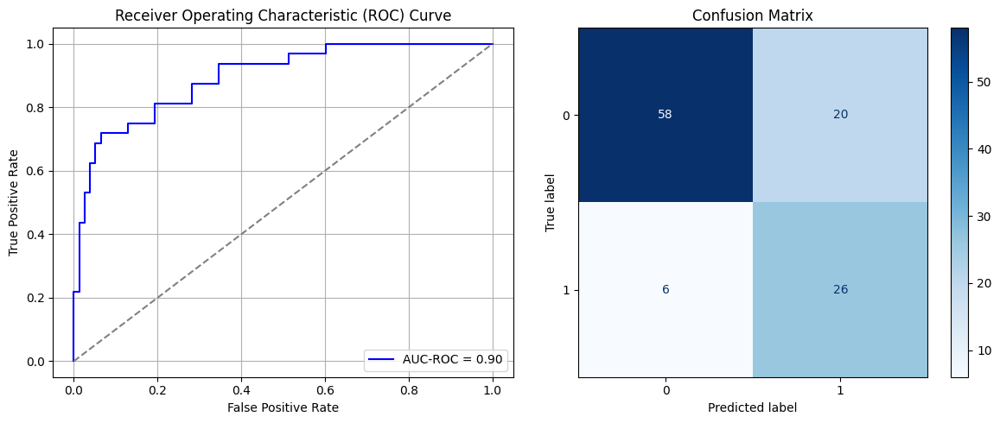

Best threshold based on F1-score: 0.869033932685852
False Negative Rate: 0.1875
Time elapsed (performance): 0.6545042759998978
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - AUC: 0.7375 - loss: 0.6466 - val_AUC: 0.8870 - val_loss: 0.5068
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8757 - loss: 0.4785 - val_AUC: 0.8980 - val_loss: 0.4171
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8929 - loss: 0.4065 - val_AUC: 0.9055 - val_loss: 0.3969
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9080 - loss: 0.3781 - val_AUC: 0.9069 - val_loss: 0.3907
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9139 - loss: 0.3648 - val_AUC: 0.9093 - val_loss: 0.3877
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9191 - loss: 0.3516 - val_AUC: 0.9102 - val_loss: 0.3856
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9180 - loss: 0.3454 - val_AUC: 0.9131 - val_loss: 0.3909
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9248 - loss: 0.3403 - val_AUC: 0.9118 - val_loss: 0.3843
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9232 - loss: 0.3393 - v

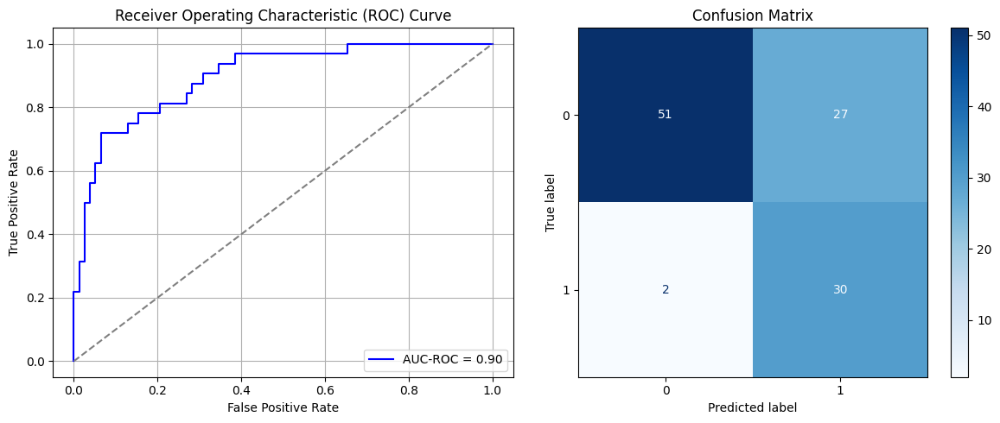

Best threshold based on F1-score: 0.8919339776039124
False Negative Rate: 0.0625
Time elapsed (performance): 0.5069076249997124
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6793 - loss: 0.6587 - val_AUC: 0.8956 - val_loss: 0.5227
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8656 - loss: 0.5071 - val_AUC: 0.9084 - val_loss: 0.4145
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8782 - loss: 0.4379 - val_AUC: 0.9145 - val_loss: 0.4189
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8950 - loss: 0.4056 - val_AUC: 0.9167 - val_loss: 0.3823
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9066 - loss: 0.3808 - val_AUC: 0.9179 - val_loss: 0.3740
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.8981 - loss: 0.3872 - val_AUC: 0.9212 - val_loss: 0.3681
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8972 - loss: 0.3981 - val_AUC: 0.9213 - val_loss: 0.3622
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9083 - loss: 0.3762 - val_AUC: 0.9221 - val_loss: 0.3634
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9084 - loss: 0.3749 - v

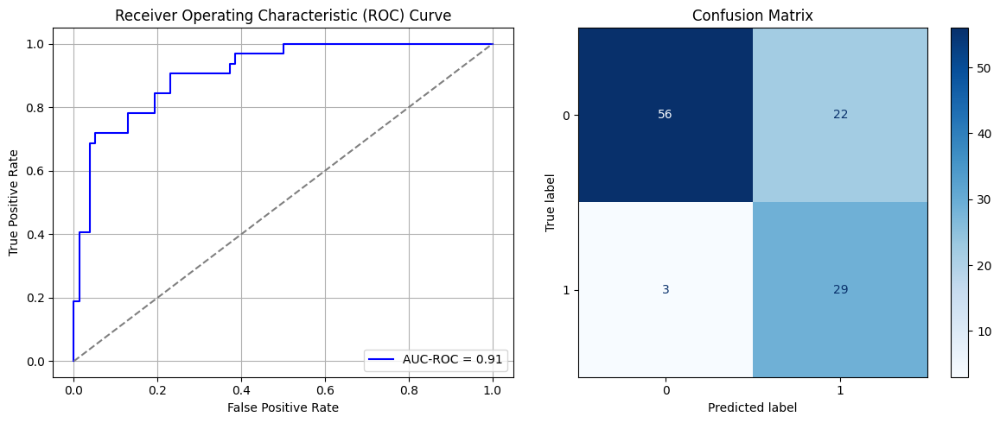

Best threshold based on F1-score: 0.8871394395828247
False Negative Rate: 0.09375
Time elapsed (performance): 0.5324638870001763
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - AUC: 0.7705 - loss: 0.6357 - val_AUC: 0.8716 - val_loss: 0.5164
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8679 - loss: 0.4883 - val_AUC: 0.8940 - val_loss: 0.4361
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8898 - loss: 0.4239 - val_AUC: 0.9049 - val_loss: 0.3971
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8895 - loss: 0.4086 - val_AUC: 0.9123 - val_loss: 0.3826
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9018 - loss: 0.3877 - val_AUC: 0.9147 - val_loss: 0.3801
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8923 - loss: 0.4095 - val_AUC: 0.9193 - val_loss: 0.3716
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9111 - loss: 0.3755 - val_AUC: 0.9184 - val_loss: 0.3729
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9035 - loss: 0.3889 - val_AUC: 0.9214 - val_loss: 0.3567
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9249 - loss: 0.3432 - v

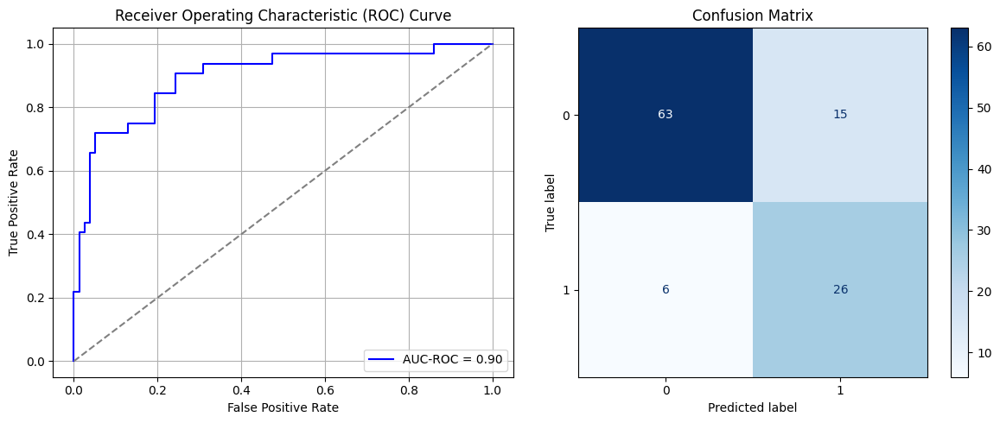

Best threshold based on F1-score: 0.8008859157562256
False Negative Rate: 0.1875
Time elapsed (performance): 0.7072412160000567
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - AUC: 0.8021 - loss: 0.6282 - val_AUC: 0.8800 - val_loss: 0.4995
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8641 - loss: 0.4808 - val_AUC: 0.8972 - val_loss: 0.4222
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8882 - loss: 0.4239 - val_AUC: 0.9086 - val_loss: 0.3948
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8905 - loss: 0.4119 - val_AUC: 0.9137 - val_loss: 0.3792
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9119 - loss: 0.3718 - val_AUC: 0.9183 - val_loss: 0.3700
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9165 - loss: 0.3577 - val_AUC: 0.9209 - val_loss: 0.3667
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9134 - loss: 0.3629 - val_AUC: 0.9228 - val_loss: 0.3593
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9186 - loss: 0.3494 - val_AUC: 0.9252 - val_loss: 0.3506
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9224 - loss: 0.3457 - v

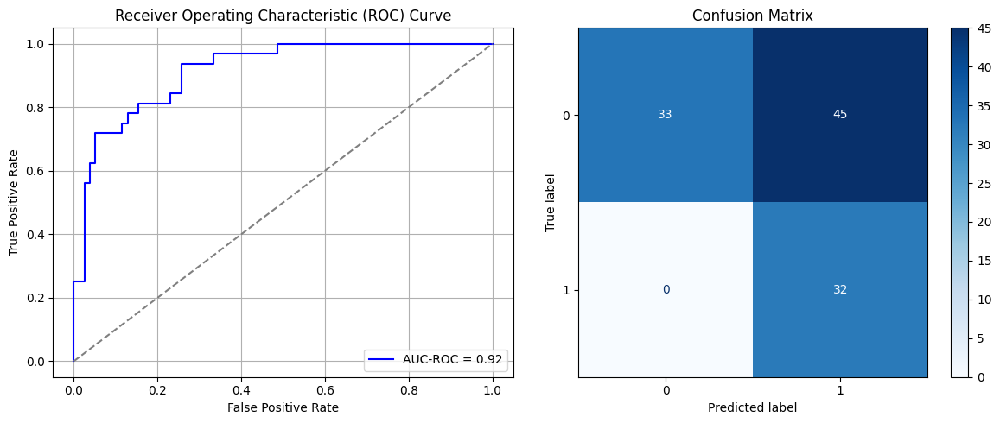

Best threshold based on F1-score: 0.9500377774238586
False Negative Rate: 0.0
Time elapsed (performance): 0.5467257330001303
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - AUC: 0.5189 - loss: 0.6989 - val_AUC: 0.8831 - val_loss: 0.5639
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8459 - loss: 0.5332 - val_AUC: 0.8954 - val_loss: 0.4259
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - AUC: 0.8920 - loss: 0.4101 - val_AUC: 0.9061 - val_loss: 0.3948
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8899 - loss: 0.4063 - val_AUC: 0.9089 - val_loss: 0.4050
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8929 - loss: 0.4044 - val_AUC: 0.9129 - val_loss: 0.3780
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9044 - loss: 0.3795 - val_AUC: 0.9147 - val_loss: 0.3741
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9148 - loss: 0.3650 - val_AUC: 0.9158 - val_loss: 0.3720
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9092 - loss: 0.3739 - val_AUC: 0.9160 - val_loss: 0.3926
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9228 - loss: 0.3457 - 

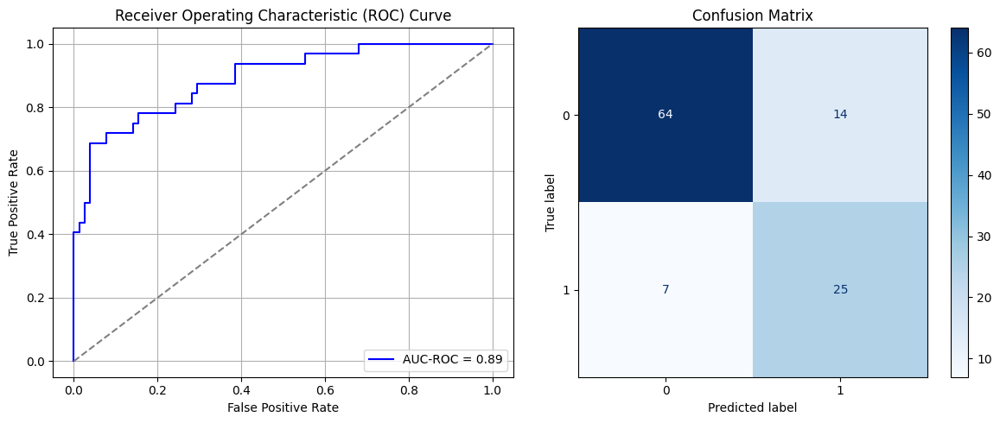

Best threshold based on F1-score: 0.7672655582427979
False Negative Rate: 0.21875
Time elapsed (performance): 0.7077308449997872
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6172 - loss: 0.6715 - val_AUC: 0.8824 - val_loss: 0.5269
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8663 - loss: 0.4942 - val_AUC: 0.8973 - val_loss: 0.4289
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8836 - loss: 0.4327 - val_AUC: 0.9048 - val_loss: 0.4025
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8849 - loss: 0.4211 - val_AUC: 0.9082 - val_loss: 0.3918
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8957 - loss: 0.4089 - val_AUC: 0.9137 - val_loss: 0.3823
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9134 - loss: 0.3653 - val_AUC: 0.9154 - val_loss: 0.3754
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9069 - loss: 0.3766 - val_AUC: 0.9165 - val_loss: 0.3709
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9064 - loss: 0.3770 - val_AUC: 0.9173 - val_loss: 0.3686
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9017 - loss: 0.3856 - va

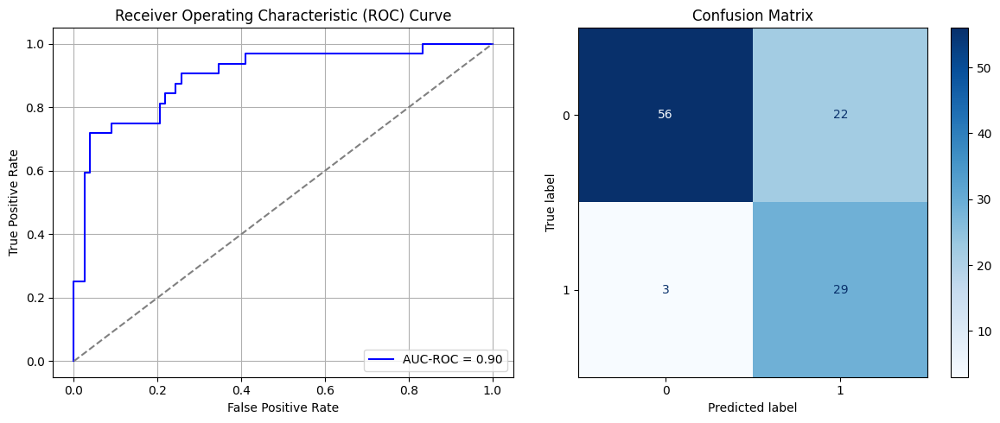

Best threshold based on F1-score: 0.9145758152008057
False Negative Rate: 0.09375
Time elapsed (performance): 0.7287059340001178


In [59]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=False)
    data_S_SRS_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRS = data_S_SRS_RUS.iloc[:, :-1]
    y_S_SRS = data_S_SRS_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS, y_S_SRS, test_size=0.20, random_state=0)
    model_SRS = create_dnn_model(X_S_train.shape[1])
    result_SRS = train_and_evaluate(model_SRS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS = Transductive_TL(model_SRS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS)
    FPR.append(result_TL_SRS[0])
    TNR.append(result_TL_SRS[1])
    FNR.append(result_TL_SRS[2])
    TPR.append(result_TL_SRS[3])
    TL_time.append(result_TL_SRS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [60]:
print(ParamFit)
ParamFit.to_csv('SRS_RUS.csv')

    Source time       FPR       TPR      FNR      TNR  Target time
0     11.642986  0.243590  0.756410  0.21875  0.78125     0.449684
1      4.604826  0.333333  0.666667  0.06250  0.93750     0.466685
2      6.014912  0.153846  0.846154  0.25000  0.75000     0.459099
3      4.753169  0.230769  0.769231  0.18750  0.81250     0.456263
4      7.275260  0.294872  0.705128  0.15625  0.84375     0.459475
5      4.886761  0.333333  0.666667  0.09375  0.90625     0.492469
6      6.201861  0.307692  0.692308  0.12500  0.87500     0.484210
7      4.902824  0.307692  0.692308  0.12500  0.87500     0.470760
8      6.081712  0.153846  0.846154  0.25000  0.75000     0.467770
9      5.975915  0.256410  0.743590  0.15625  0.84375     0.462182
10     6.090795  0.282051  0.717949  0.12500  0.87500     0.456715
11     4.844306  0.294872  0.705128  0.12500  0.87500     0.478949
12     6.287459  0.243590  0.756410  0.15625  0.84375     0.467158
13     4.806896  0.141026  0.858974  0.28125  0.71875     0.47

## Simple Random Sampling with Replacement:

In [61]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

1389
2925


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.7182 - loss: 0.6486 - val_AUC: 0.8877 - val_loss: 0.5071
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8700 - loss: 0.4802 - val_AUC: 0.9039 - val_loss: 0.4136
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8723 - loss: 0.4467 - val_AUC: 0.9114 - val_loss: 0.4097
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8896 - loss: 0.4083 - val_AUC: 0.9173 - val_loss: 0.3777
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8989 - loss: 0.3930 - val_AUC: 0.9210 - val_loss: 0.3636
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9141 - loss: 0.3644 - val_AUC: 0.9231 - val_loss: 0.3630
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9122 - loss: 0.3652 - val_AUC: 0.9235 - val_loss: 0.3568
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9195 - loss: 0.3505 - val_AUC: 0.9245 - val_loss: 0.3496
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9053 - loss: 

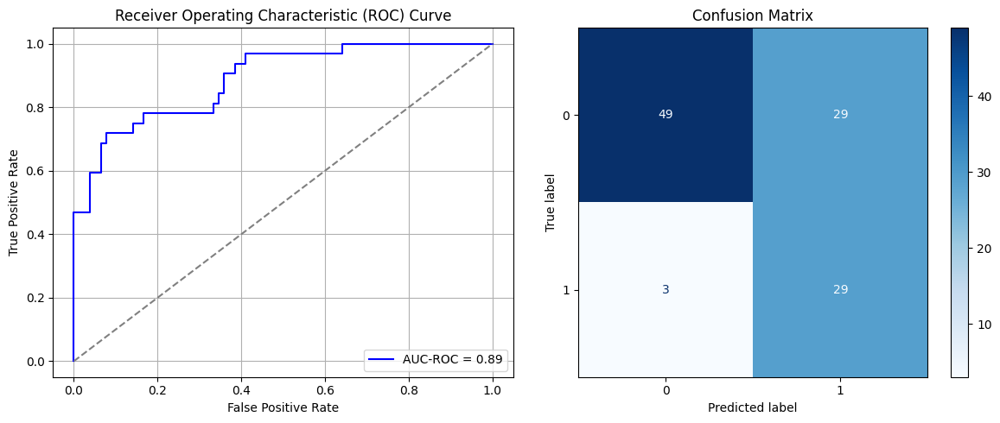

Best threshold based on F1-score: 0.8858301043510437
False Negative Rate: 0.09375
Time elapsed (performance): 0.42023704699977316
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7919 - loss: 0.6325 - val_AUC: 0.8913 - val_loss: 0.4820
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8600 - loss: 0.4842 - val_AUC: 0.9088 - val_loss: 0.4053
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8816 - loss: 0.4304 - val_AUC: 0.9175 - val_loss: 0.3757
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9032 - loss: 0.3852 - val_AUC: 0.9215 - val_loss: 0.3677
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9100 - loss: 0.3750 - val_AUC: 0.9233 - val_loss: 0.3577
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8980 - loss: 0.3931 - val_AUC: 0.9258 - val_loss: 0.3522
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9082 - loss: 0.3734 - val_AUC: 0.9272 - val_loss: 0.3448
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9131 - loss: 0.3649 - val_AUC: 0.9269 - val_loss: 0.3469
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9231 - loss: 0.3436 - va

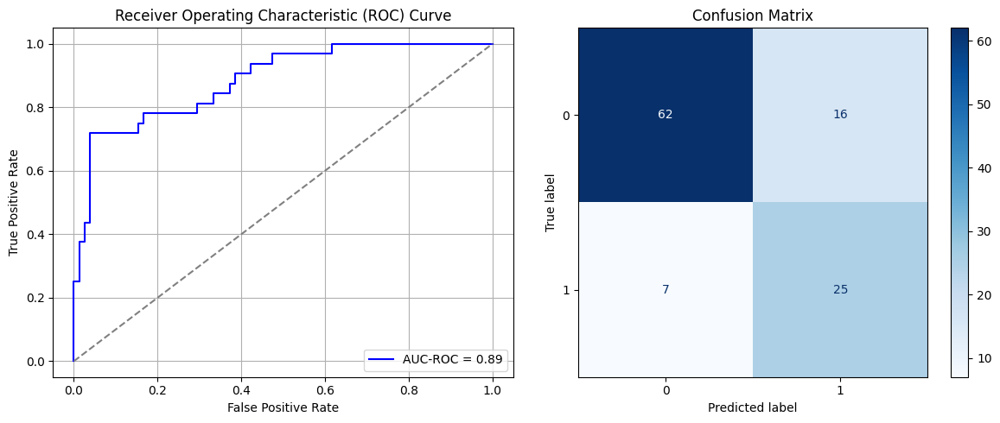

Best threshold based on F1-score: 0.8983511924743652
False Negative Rate: 0.21875
Time elapsed (performance): 0.6579241479998927
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.7266 - loss: 0.6476 - val_AUC: 0.8856 - val_loss: 0.4966
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8726 - loss: 0.4770 - val_AUC: 0.8981 - val_loss: 0.4171
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8742 - loss: 0.4363 - val_AUC: 0.9018 - val_loss: 0.4033
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8940 - loss: 0.3964 - val_AUC: 0.9032 - val_loss: 0.3991
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9164 - loss: 0.3596 - val_AUC: 0.9051 - val_loss: 0.3973
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9041 - loss: 0.3779 - val_AUC: 0.9060 - val_loss: 0.4207
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9087 - loss: 0.3725 - val_AUC: 0.9056 - val_loss: 0.3947
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9151 - loss: 0.3561 - val_AUC: 0.9067 - val_loss: 0.3910
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9138 - loss: 0.3652 - va

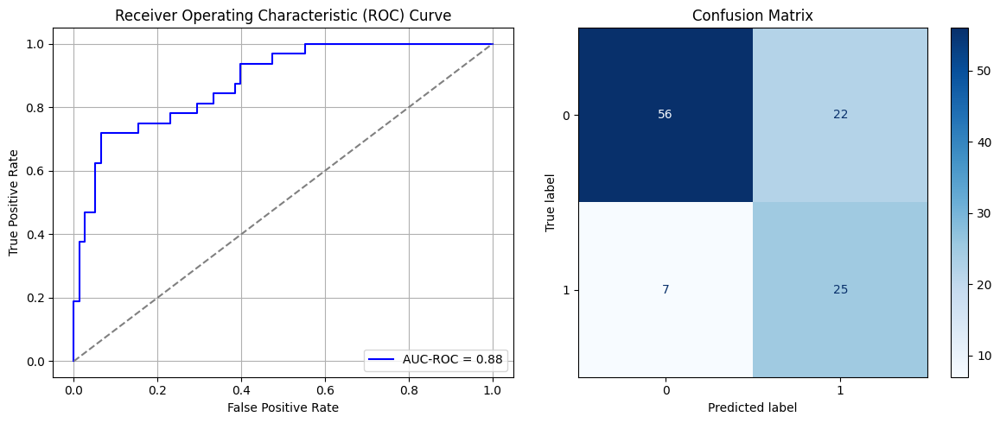

Best threshold based on F1-score: 0.894609272480011
False Negative Rate: 0.21875
Time elapsed (performance): 0.4294979420001255
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6363 - loss: 0.6627 - val_AUC: 0.8964 - val_loss: 0.5098
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8827 - loss: 0.4779 - val_AUC: 0.9134 - val_loss: 0.4000
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8932 - loss: 0.4146 - val_AUC: 0.9206 - val_loss: 0.3729
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9158 - loss: 0.3644 - val_AUC: 0.9230 - val_loss: 0.3665
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9147 - loss: 0.3675 - val_AUC: 0.9270 - val_loss: 0.3507
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9120 - loss: 0.3713 - val_AUC: 0.9276 - val_loss: 0.3452
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9027 - loss: 0.3858 - val_AUC: 0.9280 - val_loss: 0.3425
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9226 - loss: 0.3475 - val_AUC: 0.9300 - val_loss: 0.3365
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9317 - loss: 0.3279 - va

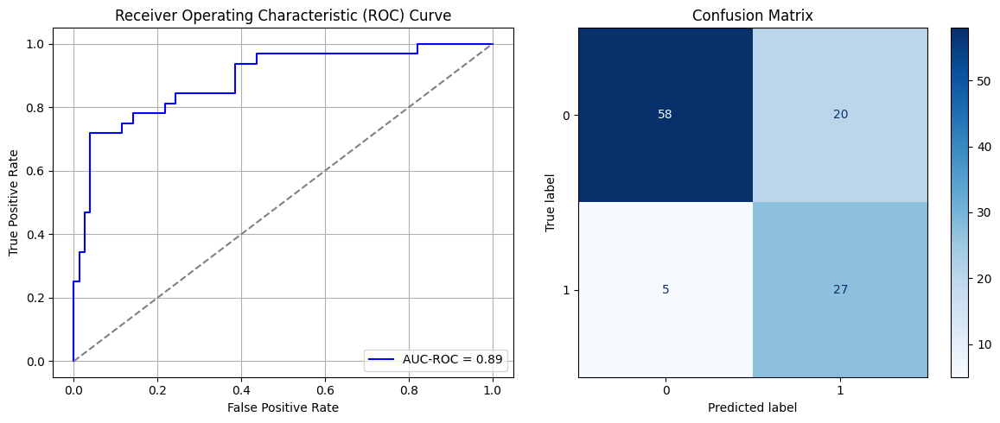

Best threshold based on F1-score: 0.8531804084777832
False Negative Rate: 0.15625
Time elapsed (performance): 0.6597913269997662
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6557 - loss: 0.6618 - val_AUC: 0.8575 - val_loss: 0.5256
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8777 - loss: 0.4764 - val_AUC: 0.8901 - val_loss: 0.4330
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8881 - loss: 0.4170 - val_AUC: 0.9023 - val_loss: 0.4059
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8986 - loss: 0.4011 - val_AUC: 0.9061 - val_loss: 0.4065
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9126 - loss: 0.3703 - val_AUC: 0.9099 - val_loss: 0.3879
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9185 - loss: 0.3611 - val_AUC: 0.9102 - val_loss: 0.3842
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9031 - loss: 0.3838 - val_AUC: 0.9119 - val_loss: 0.3796
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9098 - loss: 0.3707 - val_AUC: 0.9141 - val_loss: 0.3756
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9155 - loss: 0.3622 - va

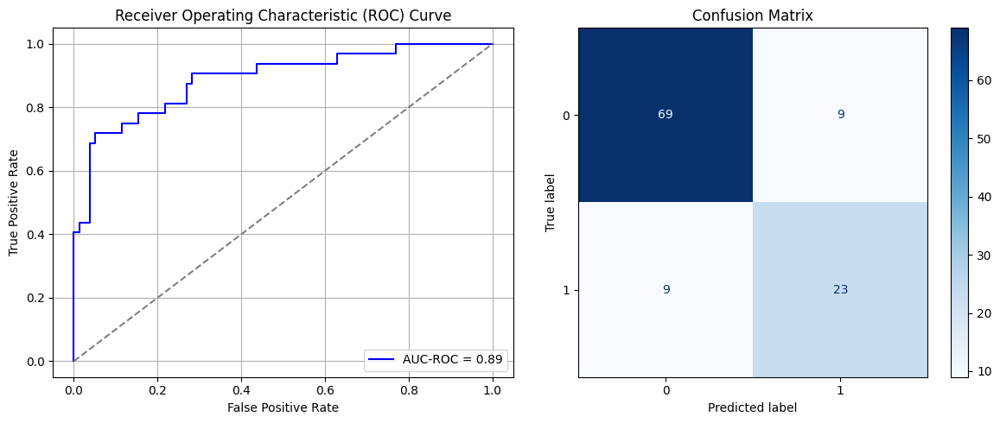

Best threshold based on F1-score: 0.6988183856010437
False Negative Rate: 0.28125
Time elapsed (performance): 0.4544405149999875
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7215 - loss: 0.6464 - val_AUC: 0.8515 - val_loss: 0.5091
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8862 - loss: 0.4519 - val_AUC: 0.8910 - val_loss: 0.4275
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8908 - loss: 0.4154 - val_AUC: 0.9032 - val_loss: 0.4004
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9058 - loss: 0.3828 - val_AUC: 0.9099 - val_loss: 0.3841
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9200 - loss: 0.3539 - val_AUC: 0.9128 - val_loss: 0.3903
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9065 - loss: 0.3715 - val_AUC: 0.9142 - val_loss: 0.3777
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9200 - loss: 0.3520 - val_AUC: 0.9177 - val_loss: 0.3663
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9188 - loss: 0.3581 - val_AUC: 0.9191 - val_loss: 0.3618
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9266 - loss: 0.3371 - va

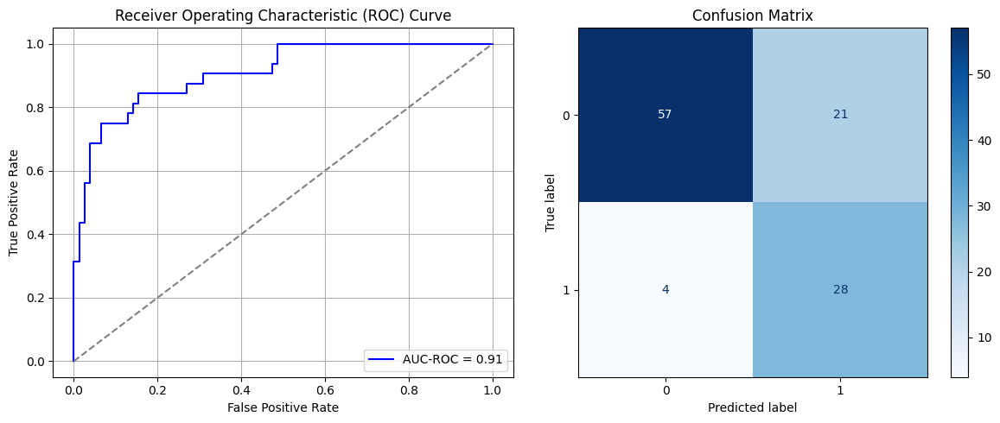

Best threshold based on F1-score: 0.8238561749458313
False Negative Rate: 0.125
Time elapsed (performance): 0.4766816560004372
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - AUC: 0.6023 - loss: 0.6682 - val_AUC: 0.8820 - val_loss: 0.4958
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8552 - loss: 0.4922 - val_AUC: 0.9092 - val_loss: 0.4046
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8862 - loss: 0.4219 - val_AUC: 0.9163 - val_loss: 0.3788
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9098 - loss: 0.3739 - val_AUC: 0.9191 - val_loss: 0.3704
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9110 - loss: 0.3704 - val_AUC: 0.9195 - val_loss: 0.3700
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9176 - loss: 0.3559 - val_AUC: 0.9211 - val_loss: 0.3641
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9247 - loss: 0.3362 - val_AUC: 0.9204 - val_loss: 0.3662
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9224 - loss: 0.3478 - val_AUC: 0.9211 - val_loss: 0.3600
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9291 - loss: 0.3300 - v

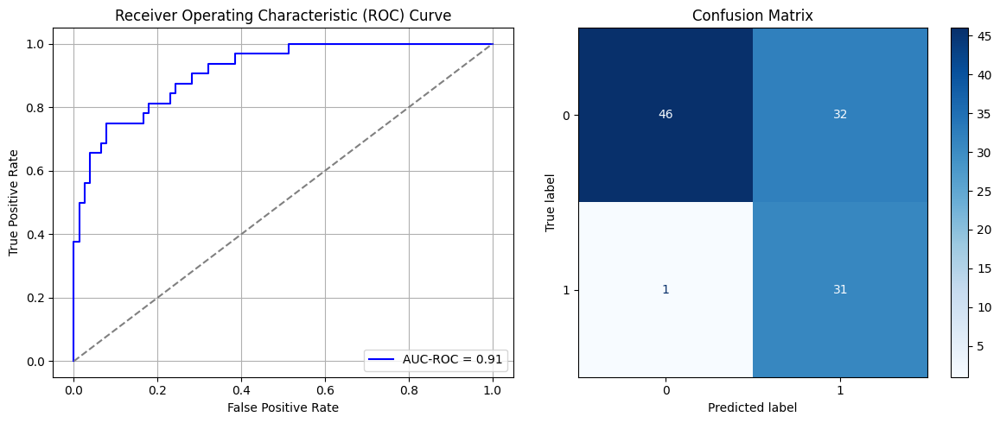

Best threshold based on F1-score: 0.906387209892273
False Negative Rate: 0.03125
Time elapsed (performance): 0.48619123599974046
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7547 - loss: 0.6384 - val_AUC: 0.8697 - val_loss: 0.5198
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8632 - loss: 0.4991 - val_AUC: 0.8892 - val_loss: 0.4321
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8840 - loss: 0.4341 - val_AUC: 0.8996 - val_loss: 0.4097
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8985 - loss: 0.4074 - val_AUC: 0.9069 - val_loss: 0.3892
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8924 - loss: 0.4112 - val_AUC: 0.9109 - val_loss: 0.3825
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8950 - loss: 0.4038 - val_AUC: 0.9165 - val_loss: 0.3715
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9070 - loss: 0.3846 - val_AUC: 0.9156 - val_loss: 0.3713
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8941 - loss: 0.3959 - val_AUC: 0.9203 - val_loss: 0.3549
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9035 - loss: 0.3821 - va

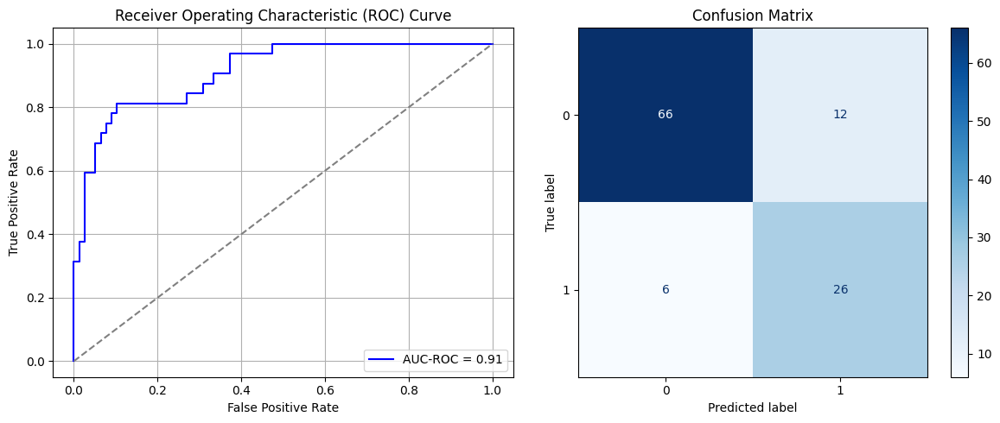

Best threshold based on F1-score: 0.5828537940979004
False Negative Rate: 0.1875
Time elapsed (performance): 0.4699190780002027
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - AUC: 0.6902 - loss: 0.6528 - val_AUC: 0.8886 - val_loss: 0.5207
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8651 - loss: 0.5033 - val_AUC: 0.9135 - val_loss: 0.4065
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8790 - loss: 0.4365 - val_AUC: 0.9216 - val_loss: 0.3752
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8911 - loss: 0.4119 - val_AUC: 0.9245 - val_loss: 0.3715
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9090 - loss: 0.3770 - val_AUC: 0.9254 - val_loss: 0.3545
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9133 - loss: 0.3633 - val_AUC: 0.9258 - val_loss: 0.3492
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9313 - loss: 0.3285 - val_AUC: 0.9262 - val_loss: 0.3474
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9236 - loss: 0.3491 - val_AUC: 0.9263 - val_loss: 0.3467
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9199 - loss: 0.3477 - v

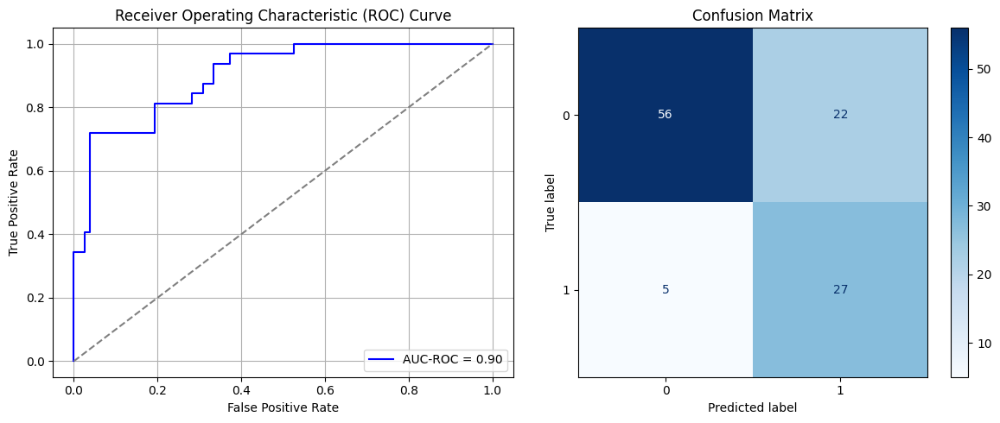

Best threshold based on F1-score: 0.9263059496879578
False Negative Rate: 0.15625
Time elapsed (performance): 0.4658859690002828
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7160 - loss: 0.6404 - val_AUC: 0.8787 - val_loss: 0.4946
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8643 - loss: 0.4822 - val_AUC: 0.9026 - val_loss: 0.4144
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8901 - loss: 0.4131 - val_AUC: 0.9144 - val_loss: 0.3846
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8940 - loss: 0.4034 - val_AUC: 0.9208 - val_loss: 0.3679
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9019 - loss: 0.3922 - val_AUC: 0.9263 - val_loss: 0.3520
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9032 - loss: 0.3820 - val_AUC: 0.9301 - val_loss: 0.3449
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9167 - loss: 0.3604 - val_AUC: 0.9317 - val_loss: 0.3410
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9164 - loss: 0.3622 - val_AUC: 0.9343 - val_loss: 0.3411
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9105 - loss: 0.3622 - va

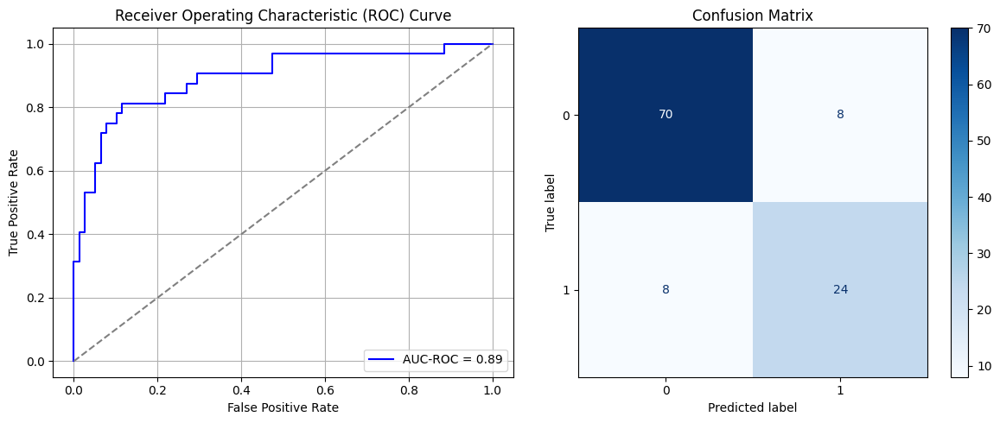

Best threshold based on F1-score: 0.47023919224739075
False Negative Rate: 0.25
Time elapsed (performance): 0.47585618199991586
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - AUC: 0.6757 - loss: 0.6561 - val_AUC: 0.8465 - val_loss: 0.5394
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8671 - loss: 0.4930 - val_AUC: 0.8768 - val_loss: 0.4524
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8842 - loss: 0.4277 - val_AUC: 0.8951 - val_loss: 0.4160
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9025 - loss: 0.3877 - val_AUC: 0.8998 - val_loss: 0.4025
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9059 - loss: 0.3760 - val_AUC: 0.9051 - val_loss: 0.3958
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8987 - loss: 0.3906 - val_AUC: 0.9086 - val_loss: 0.3824
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9031 - loss: 0.3797 - val_AUC: 0.9088 - val_loss: 0.4056
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9063 - loss: 0.3789 - val_AUC: 0.9097 - val_loss: 0.3794
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9074 - loss: 0.3741 - v

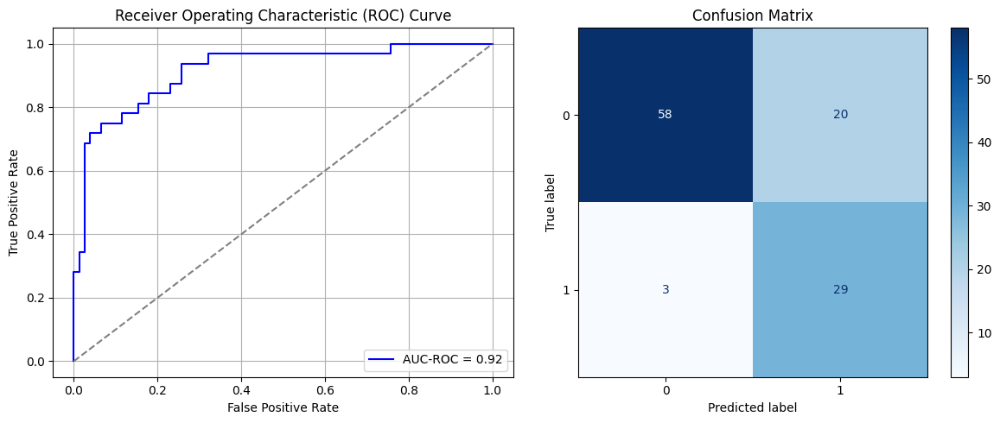

Best threshold based on F1-score: 0.8531877398490906
False Negative Rate: 0.09375
Time elapsed (performance): 0.4700481640002181
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6961 - loss: 0.6604 - val_AUC: 0.8500 - val_loss: 0.5385
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8695 - loss: 0.4915 - val_AUC: 0.8790 - val_loss: 0.4564
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8677 - loss: 0.4538 - val_AUC: 0.8920 - val_loss: 0.4177
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9027 - loss: 0.3947 - val_AUC: 0.8986 - val_loss: 0.4105
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9087 - loss: 0.3842 - val_AUC: 0.9023 - val_loss: 0.3977
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9035 - loss: 0.3873 - val_AUC: 0.9069 - val_loss: 0.3882
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9104 - loss: 0.3698 - val_AUC: 0.9091 - val_loss: 0.3929
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9234 - loss: 0.3474 - val_AUC: 0.9111 - val_loss: 0.3778
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9038 - loss: 0.3826 - va

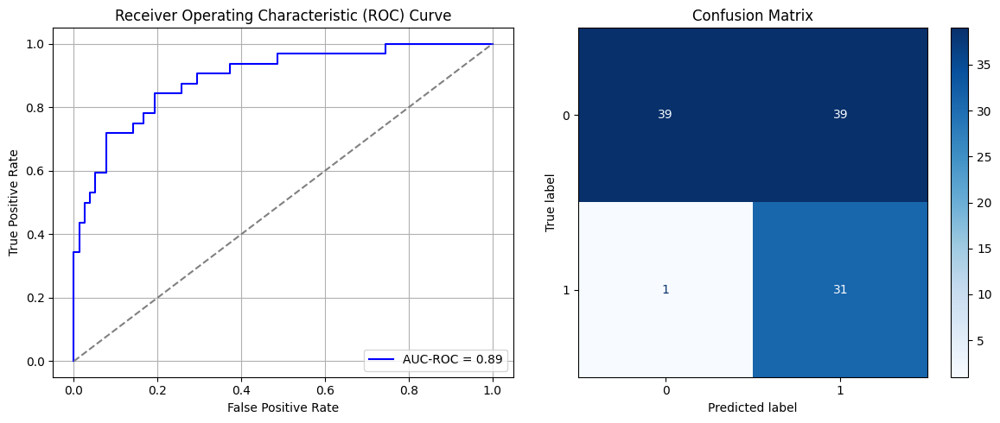

Best threshold based on F1-score: 0.918304443359375
False Negative Rate: 0.03125
Time elapsed (performance): 0.4747145480000654
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.7238 - loss: 0.6492 - val_AUC: 0.8808 - val_loss: 0.5176
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8574 - loss: 0.5019 - val_AUC: 0.9011 - val_loss: 0.4205
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8887 - loss: 0.4182 - val_AUC: 0.9120 - val_loss: 0.4154
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8862 - loss: 0.4146 - val_AUC: 0.9158 - val_loss: 0.3789
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8924 - loss: 0.4078 - val_AUC: 0.9184 - val_loss: 0.3764
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8977 - loss: 0.3896 - val_AUC: 0.9238 - val_loss: 0.3685
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9074 - loss: 0.3783 - val_AUC: 0.9253 - val_loss: 0.3530
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9120 - loss: 0.3687 - val_AUC: 0.9287 - val_loss: 0.3474
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9149 - loss: 0.3656 - v

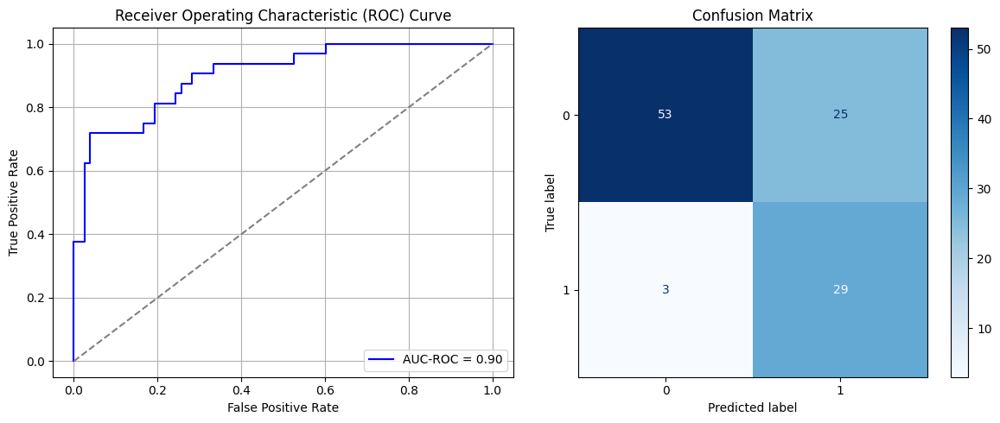

Best threshold based on F1-score: 0.8866034150123596
False Negative Rate: 0.09375
Time elapsed (performance): 0.46905722299970876
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7604 - loss: 0.6349 - val_AUC: 0.8700 - val_loss: 0.5140
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8421 - loss: 0.5126 - val_AUC: 0.8923 - val_loss: 0.4352
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8780 - loss: 0.4369 - val_AUC: 0.9041 - val_loss: 0.3998
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8884 - loss: 0.4167 - val_AUC: 0.9134 - val_loss: 0.3759
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8945 - loss: 0.4020 - val_AUC: 0.9164 - val_loss: 0.3916
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9020 - loss: 0.3929 - val_AUC: 0.9189 - val_loss: 0.3587
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9010 - loss: 0.3926 - val_AUC: 0.9207 - val_loss: 0.3542
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8981 - loss: 0.3904 - val_AUC: 0.9230 - val_loss: 0.3511
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9202 - loss: 0.3580 - v

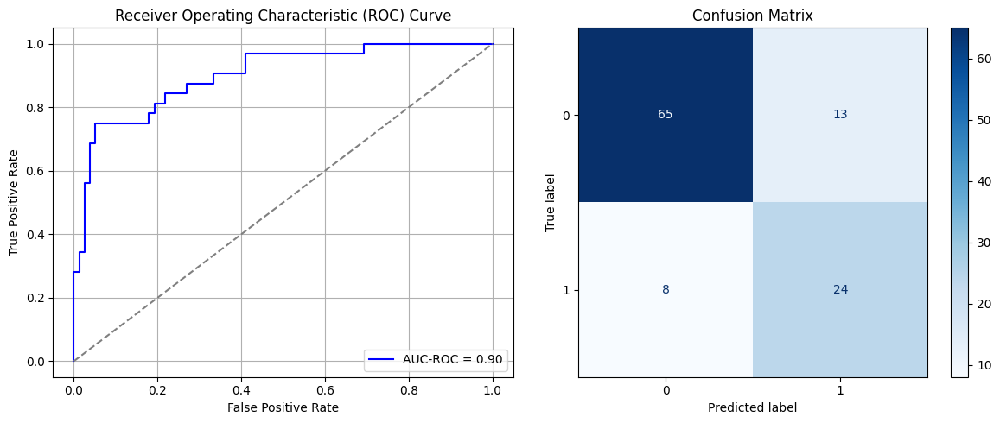

Best threshold based on F1-score: 0.7160031199455261
False Negative Rate: 0.25
Time elapsed (performance): 0.4739004369998838
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - AUC: 0.6853 - loss: 0.6576 - val_AUC: 0.8665 - val_loss: 0.5314
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8613 - loss: 0.4983 - val_AUC: 0.8782 - val_loss: 0.4464
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8882 - loss: 0.4211 - val_AUC: 0.8865 - val_loss: 0.4288
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8998 - loss: 0.3973 - val_AUC: 0.8908 - val_loss: 0.4240
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9033 - loss: 0.3947 - val_AUC: 0.8959 - val_loss: 0.4109
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9005 - loss: 0.3899 - val_AUC: 0.8985 - val_loss: 0.4052
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9131 - loss: 0.3618 - val_AUC: 0.8998 - val_loss: 0.4028
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9079 - loss: 0.3766 - val_AUC: 0.9034 - val_loss: 0.4187
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9100 - loss: 0.3695 - v

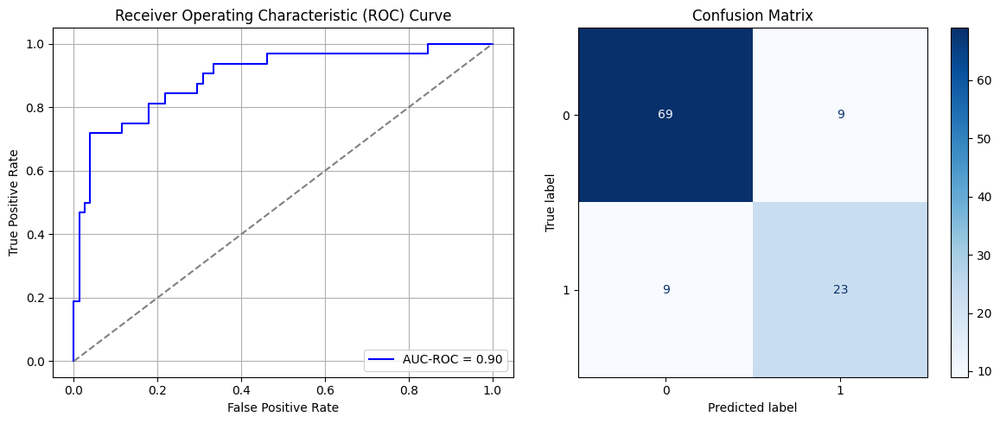

Best threshold based on F1-score: 0.7535473704338074
False Negative Rate: 0.28125
Time elapsed (performance): 0.4486601650000921
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7580 - loss: 0.6453 - val_AUC: 0.8764 - val_loss: 0.5007
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8636 - loss: 0.4804 - val_AUC: 0.8982 - val_loss: 0.4105
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8790 - loss: 0.4278 - val_AUC: 0.9062 - val_loss: 0.3941
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8828 - loss: 0.4199 - val_AUC: 0.9120 - val_loss: 0.3767
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8901 - loss: 0.4011 - val_AUC: 0.9148 - val_loss: 0.3693
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9009 - loss: 0.3863 - val_AUC: 0.9170 - val_loss: 0.3684
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9120 - loss: 0.3614 - val_AUC: 0.9161 - val_loss: 0.3967
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9106 - loss: 0.3663 - val_AUC: 0.9178 - val_loss: 0.3665
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9310 - loss: 0.3248 - va

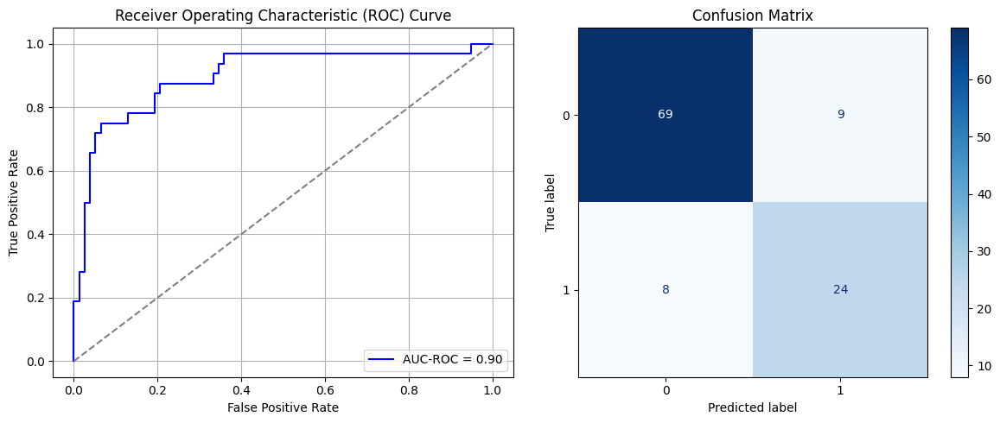

Best threshold based on F1-score: 0.6434142589569092
False Negative Rate: 0.25
Time elapsed (performance): 0.49724932099979924
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.7450 - loss: 0.6478 - val_AUC: 0.8763 - val_loss: 0.4985
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8697 - loss: 0.4785 - val_AUC: 0.9030 - val_loss: 0.4146
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8904 - loss: 0.4219 - val_AUC: 0.9134 - val_loss: 0.3860
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8914 - loss: 0.4078 - val_AUC: 0.9218 - val_loss: 0.3715
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9145 - loss: 0.3703 - val_AUC: 0.9268 - val_loss: 0.3568
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9103 - loss: 0.3707 - val_AUC: 0.9298 - val_loss: 0.3602
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9041 - loss: 0.3866 - val_AUC: 0.9323 - val_loss: 0.3407
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9132 - loss: 0.3655 - val_AUC: 0.9338 - val_loss: 0.3356
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9188 - loss: 0.3509 - v

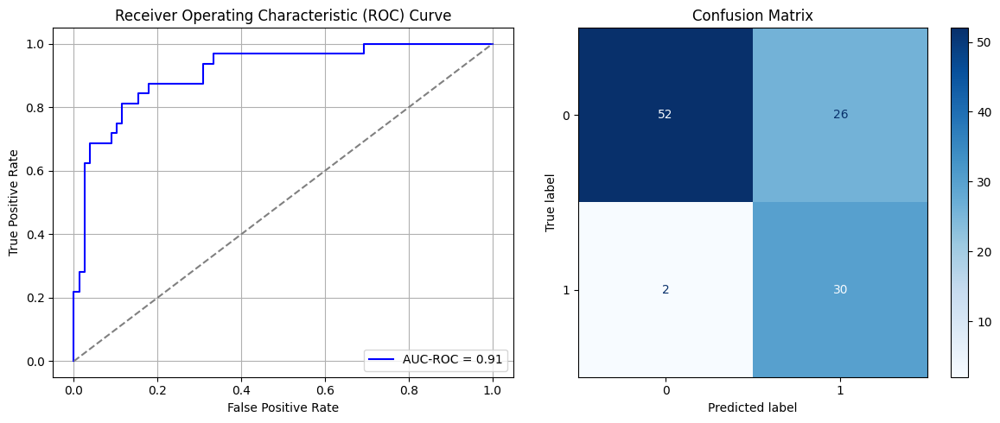

Best threshold based on F1-score: 0.7858306765556335
False Negative Rate: 0.0625
Time elapsed (performance): 0.48345884499985914
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6795 - loss: 0.6606 - val_AUC: 0.8906 - val_loss: 0.5051
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8732 - loss: 0.4807 - val_AUC: 0.9147 - val_loss: 0.4210
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8932 - loss: 0.4114 - val_AUC: 0.9179 - val_loss: 0.3754
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8892 - loss: 0.4057 - val_AUC: 0.9236 - val_loss: 0.3621
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9088 - loss: 0.3763 - val_AUC: 0.9271 - val_loss: 0.3679
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8940 - loss: 0.3951 - val_AUC: 0.9277 - val_loss: 0.3519
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9211 - loss: 0.3462 - val_AUC: 0.9298 - val_loss: 0.3618
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9125 - loss: 0.3608 - val_AUC: 0.9283 - val_loss: 0.3500
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9221 - loss: 0.3494 - va

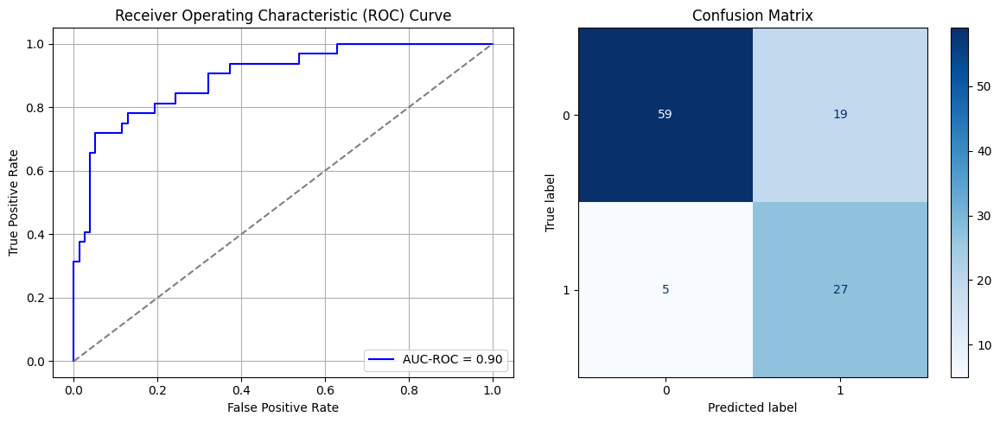

Best threshold based on F1-score: 0.8356854319572449
False Negative Rate: 0.15625
Time elapsed (performance): 0.4520895890000247
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - AUC: 0.7383 - loss: 0.6426 - val_AUC: 0.8558 - val_loss: 0.5076
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8702 - loss: 0.4632 - val_AUC: 0.8904 - val_loss: 0.4263
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8909 - loss: 0.4125 - val_AUC: 0.9002 - val_loss: 0.4009
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9028 - loss: 0.3841 - val_AUC: 0.9072 - val_loss: 0.3920
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9072 - loss: 0.3737 - val_AUC: 0.9078 - val_loss: 0.3878
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9082 - loss: 0.3690 - val_AUC: 0.9114 - val_loss: 0.3809
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9072 - loss: 0.3733 - val_AUC: 0.9143 - val_loss: 0.3812
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9233 - loss: 0.3423 - val_AUC: 0.9129 - val_loss: 0.3790
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9336 - loss: 0.3160 - v

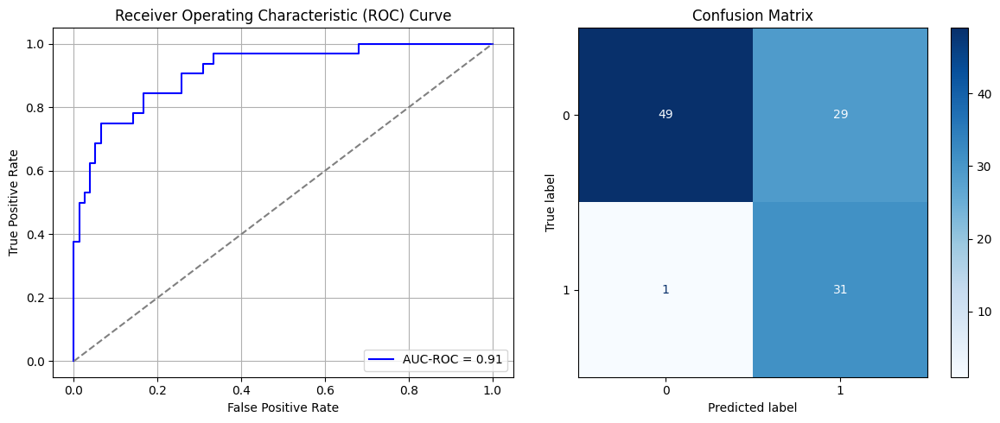

Best threshold based on F1-score: 0.9063801169395447
False Negative Rate: 0.03125
Time elapsed (performance): 0.47049038300019674
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6735 - loss: 0.6661 - val_AUC: 0.8856 - val_loss: 0.5176
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8657 - loss: 0.4904 - val_AUC: 0.9165 - val_loss: 0.3947
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8871 - loss: 0.4238 - val_AUC: 0.9241 - val_loss: 0.3667
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8885 - loss: 0.4142 - val_AUC: 0.9251 - val_loss: 0.3617
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8960 - loss: 0.4042 - val_AUC: 0.9276 - val_loss: 0.3481
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9037 - loss: 0.3867 - val_AUC: 0.9263 - val_loss: 0.3530
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9032 - loss: 0.3832 - val_AUC: 0.9258 - val_loss: 0.3571
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9217 - loss: 0.3547 - val_AUC: 0.9276 - val_loss: 0.3463
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9139 - loss: 0.3682 - va

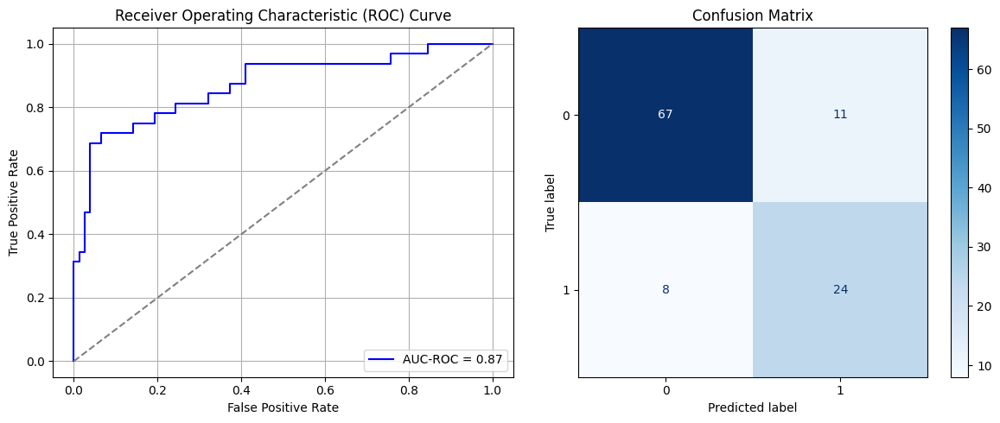

Best threshold based on F1-score: 0.7561761736869812
False Negative Rate: 0.25
Time elapsed (performance): 0.46579253599975345
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - AUC: 0.6833 - loss: 0.6479 - val_AUC: 0.8903 - val_loss: 0.4855
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8742 - loss: 0.4714 - val_AUC: 0.9163 - val_loss: 0.3924
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8993 - loss: 0.3999 - val_AUC: 0.9241 - val_loss: 0.3572
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9171 - loss: 0.3604 - val_AUC: 0.9298 - val_loss: 0.3448
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9080 - loss: 0.3727 - val_AUC: 0.9325 - val_loss: 0.3380
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9150 - loss: 0.3611 - val_AUC: 0.9329 - val_loss: 0.3310
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9134 - loss: 0.3603 - val_AUC: 0.9323 - val_loss: 0.3320
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9287 - loss: 0.3340 - val_AUC: 0.9326 - val_loss: 0.3286
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9172 - loss: 0.3518 - v

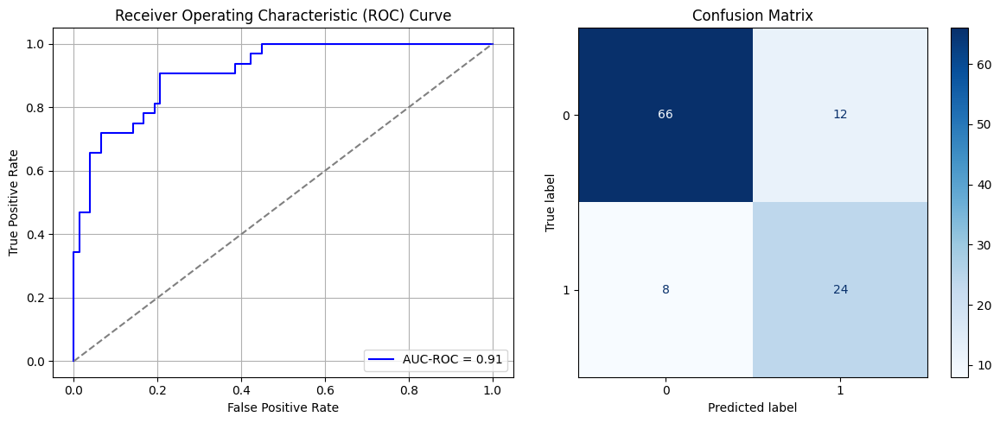

Best threshold based on F1-score: 0.7400644421577454
False Negative Rate: 0.25
Time elapsed (performance): 0.4497157649998371
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6860 - loss: 0.6538 - val_AUC: 0.8858 - val_loss: 0.5039
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8611 - loss: 0.4880 - val_AUC: 0.9083 - val_loss: 0.4006
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8851 - loss: 0.4222 - val_AUC: 0.9194 - val_loss: 0.3744
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8975 - loss: 0.4055 - val_AUC: 0.9220 - val_loss: 0.3663
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9079 - loss: 0.3743 - val_AUC: 0.9239 - val_loss: 0.3624
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9126 - loss: 0.3631 - val_AUC: 0.9272 - val_loss: 0.3439
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9197 - loss: 0.3514 - val_AUC: 0.9303 - val_loss: 0.3352
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9186 - loss: 0.3546 - val_AUC: 0.9282 - val_loss: 0.3430
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9131 - loss: 0.3654 - va

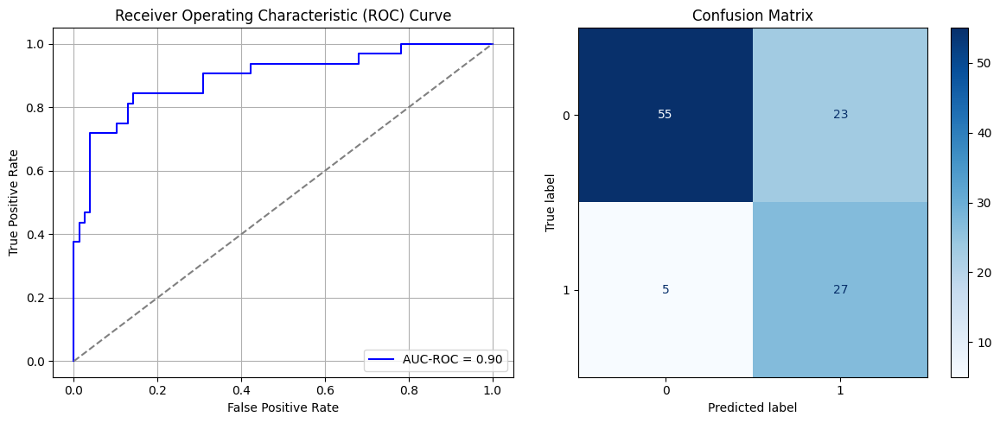

Best threshold based on F1-score: 0.8981568217277527
False Negative Rate: 0.15625
Time elapsed (performance): 0.49210904400024447
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7213 - loss: 0.6561 - val_AUC: 0.8909 - val_loss: 0.5098
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8600 - loss: 0.4909 - val_AUC: 0.9136 - val_loss: 0.3924
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8917 - loss: 0.4131 - val_AUC: 0.9190 - val_loss: 0.3700
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9036 - loss: 0.3886 - val_AUC: 0.9191 - val_loss: 0.3634
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9104 - loss: 0.3705 - val_AUC: 0.9209 - val_loss: 0.3591
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9041 - loss: 0.3771 - val_AUC: 0.9237 - val_loss: 0.3690
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8976 - loss: 0.3926 - val_AUC: 0.9238 - val_loss: 0.3494
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9113 - loss: 0.3660 - val_AUC: 0.9252 - val_loss: 0.3445
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9170 - loss: 0.3565 - va

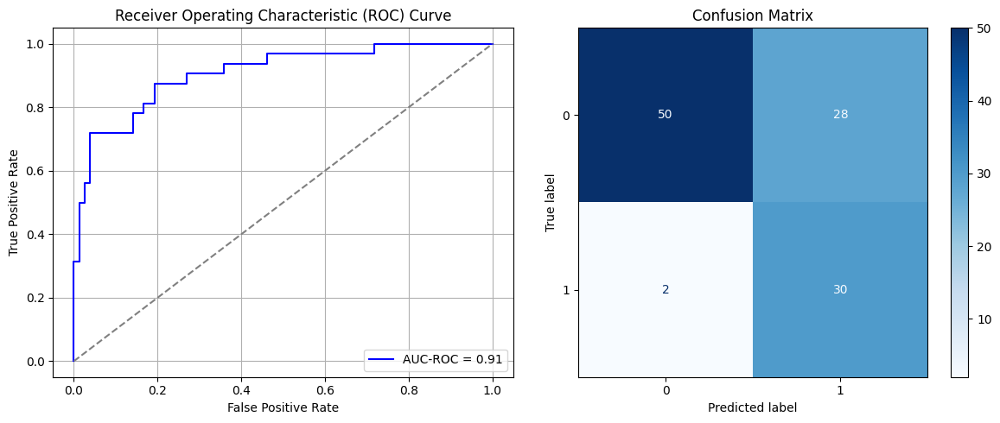

Best threshold based on F1-score: 0.9213692545890808
False Negative Rate: 0.0625
Time elapsed (performance): 0.4367809139998826
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6761 - loss: 0.6571 - val_AUC: 0.8889 - val_loss: 0.5211
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8606 - loss: 0.5076 - val_AUC: 0.9171 - val_loss: 0.3970
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8772 - loss: 0.4328 - val_AUC: 0.9252 - val_loss: 0.3627
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8939 - loss: 0.4026 - val_AUC: 0.9267 - val_loss: 0.3517
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8901 - loss: 0.4074 - val_AUC: 0.9293 - val_loss: 0.3473
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9068 - loss: 0.3789 - val_AUC: 0.9316 - val_loss: 0.3429
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9050 - loss: 0.3794 - val_AUC: 0.9315 - val_loss: 0.3359
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9019 - loss: 0.3841 - val_AUC: 0.9333 - val_loss: 0.3503
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9020 - loss: 0.3890 - va

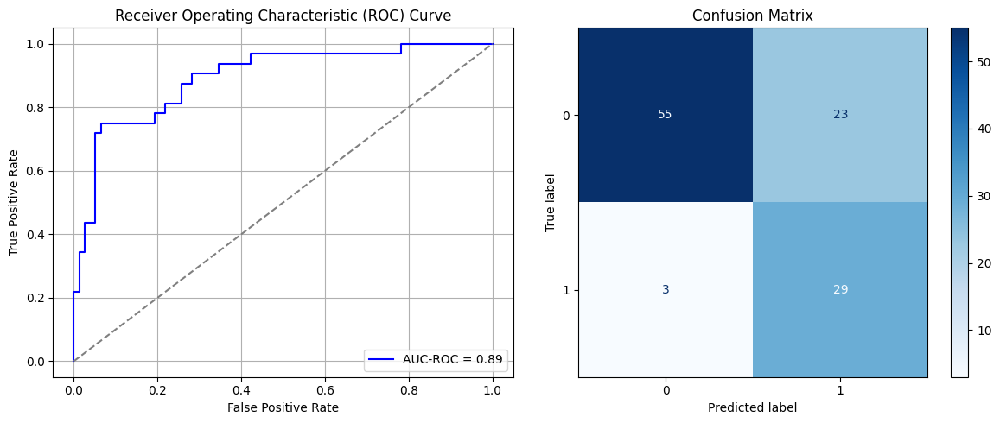

Best threshold based on F1-score: 0.8554938435554504
False Negative Rate: 0.09375
Time elapsed (performance): 0.5051523160000215
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6739 - loss: 0.6630 - val_AUC: 0.8771 - val_loss: 0.5359
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8507 - loss: 0.5103 - val_AUC: 0.9076 - val_loss: 0.4129
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8757 - loss: 0.4417 - val_AUC: 0.9176 - val_loss: 0.3807
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8858 - loss: 0.4205 - val_AUC: 0.9241 - val_loss: 0.3592
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9095 - loss: 0.3806 - val_AUC: 0.9276 - val_loss: 0.3672
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9210 - loss: 0.3566 - val_AUC: 0.9305 - val_loss: 0.3515
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9034 - loss: 0.3899 - val_AUC: 0.9321 - val_loss: 0.3381
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9147 - loss: 0.3596 - val_AUC: 0.9329 - val_loss: 0.3363
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9197 - loss: 0.3534 - va

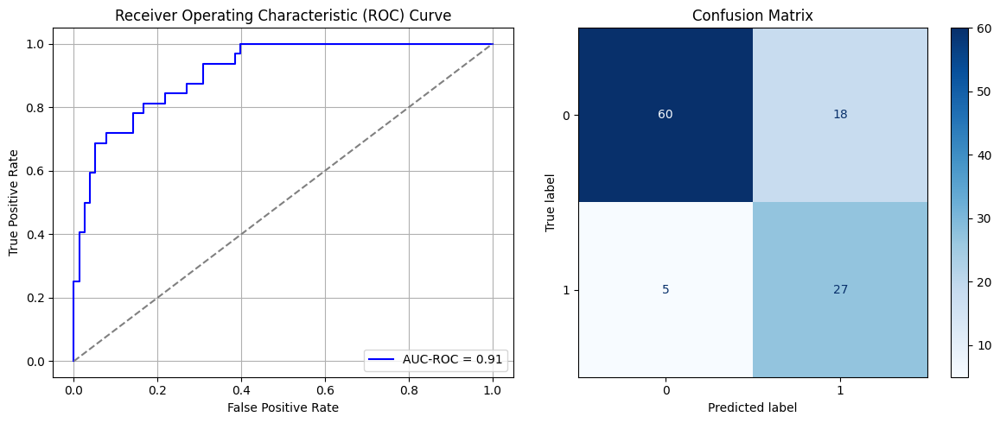

Best threshold based on F1-score: 0.8517643809318542
False Negative Rate: 0.15625
Time elapsed (performance): 0.5113024349998341
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7857 - loss: 0.6165 - val_AUC: 0.8842 - val_loss: 0.4745
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8743 - loss: 0.4574 - val_AUC: 0.9021 - val_loss: 0.4081
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8761 - loss: 0.4351 - val_AUC: 0.9096 - val_loss: 0.3847
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8982 - loss: 0.3962 - val_AUC: 0.9193 - val_loss: 0.3678
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9118 - loss: 0.3662 - val_AUC: 0.9207 - val_loss: 0.3665
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9131 - loss: 0.3656 - val_AUC: 0.9260 - val_loss: 0.3489
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9123 - loss: 0.3670 - val_AUC: 0.9255 - val_loss: 0.3470
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9209 - loss: 0.3481 - val_AUC: 0.9283 - val_loss: 0.3402
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9117 - loss: 0.3644 - va

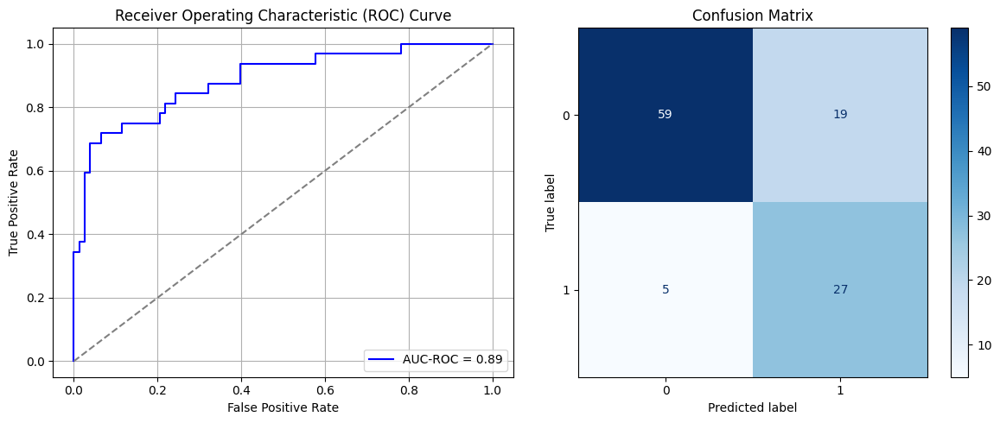

Best threshold based on F1-score: 0.8772009611129761
False Negative Rate: 0.15625
Time elapsed (performance): 0.5551180280003791
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - AUC: 0.8133 - loss: 0.6358 - val_AUC: 0.8944 - val_loss: 0.4809
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.8871 - loss: 0.4551 - val_AUC: 0.9122 - val_loss: 0.3992
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8925 - loss: 0.4096 - val_AUC: 0.9207 - val_loss: 0.3702
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9048 - loss: 0.3853 - val_AUC: 0.9269 - val_loss: 0.3556
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9073 - loss: 0.3757 - val_AUC: 0.9292 - val_loss: 0.3471
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9180 - loss: 0.3553 - val_AUC: 0.9316 - val_loss: 0.3413
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9176 - loss: 0.3555 - val_AUC: 0.9326 - val_loss: 0.3397
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9192 - loss: 0.3565 - val_AUC: 0.9323 - val_loss: 0.3424
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9130 - loss: 0.3578 - v

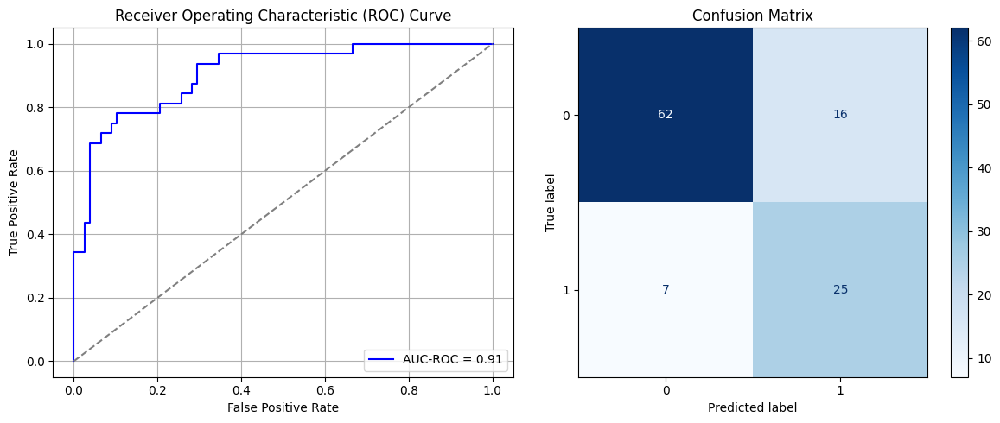

Best threshold based on F1-score: 0.8538820743560791
False Negative Rate: 0.21875
Time elapsed (performance): 0.4733508780000193
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6794 - loss: 0.6625 - val_AUC: 0.8626 - val_loss: 0.5478
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8460 - loss: 0.5272 - val_AUC: 0.8869 - val_loss: 0.4474
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8796 - loss: 0.4359 - val_AUC: 0.8980 - val_loss: 0.4139
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8976 - loss: 0.4016 - val_AUC: 0.9049 - val_loss: 0.4005
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8964 - loss: 0.4003 - val_AUC: 0.9068 - val_loss: 0.3881
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9106 - loss: 0.3753 - val_AUC: 0.9116 - val_loss: 0.3774
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9089 - loss: 0.3791 - val_AUC: 0.9124 - val_loss: 0.3735
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9196 - loss: 0.3519 - val_AUC: 0.9139 - val_loss: 0.3705
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9216 - loss: 0.3502 - va

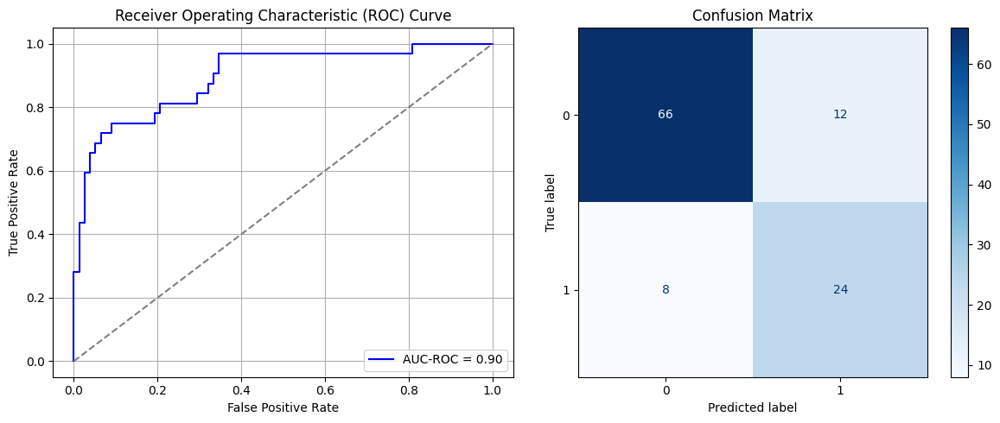

Best threshold based on F1-score: 0.6660361289978027
False Negative Rate: 0.25
Time elapsed (performance): 0.4687914669998463
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.6821 - loss: 0.6535 - val_AUC: 0.8775 - val_loss: 0.5104
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8590 - loss: 0.4898 - val_AUC: 0.9076 - val_loss: 0.4067
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8944 - loss: 0.4127 - val_AUC: 0.9181 - val_loss: 0.3896
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9051 - loss: 0.3861 - val_AUC: 0.9241 - val_loss: 0.3618
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8872 - loss: 0.4113 - val_AUC: 0.9275 - val_loss: 0.3484
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9157 - loss: 0.3645 - val_AUC: 0.9291 - val_loss: 0.3484
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9059 - loss: 0.3834 - val_AUC: 0.9307 - val_loss: 0.3391
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9243 - loss: 0.3486 - val_AUC: 0.9306 - val_loss: 0.3369
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9193 - loss: 0.3473 - v

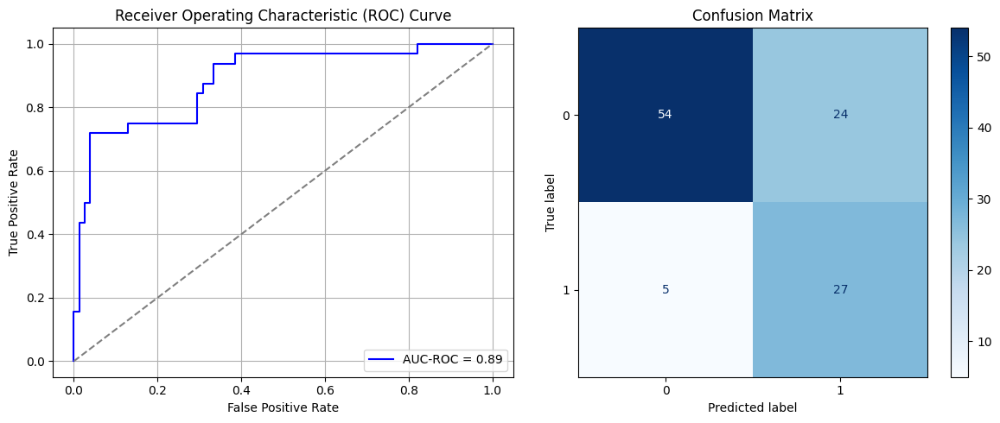

Best threshold based on F1-score: 0.9044925570487976
False Negative Rate: 0.15625
Time elapsed (performance): 0.4793915109999034
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - AUC: 0.6114 - loss: 0.6734 - val_AUC: 0.8904 - val_loss: 0.5164
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8640 - loss: 0.4966 - val_AUC: 0.9046 - val_loss: 0.4104
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8822 - loss: 0.4283 - val_AUC: 0.9110 - val_loss: 0.3864
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9019 - loss: 0.3907 - val_AUC: 0.9167 - val_loss: 0.3808
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9083 - loss: 0.3828 - val_AUC: 0.9170 - val_loss: 0.3804
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9115 - loss: 0.3704 - val_AUC: 0.9187 - val_loss: 0.3652
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9016 - loss: 0.3802 - val_AUC: 0.9213 - val_loss: 0.3575
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9168 - loss: 0.3560 - val_AUC: 0.9221 - val_loss: 0.3570
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9106 - loss: 0.3612 - v

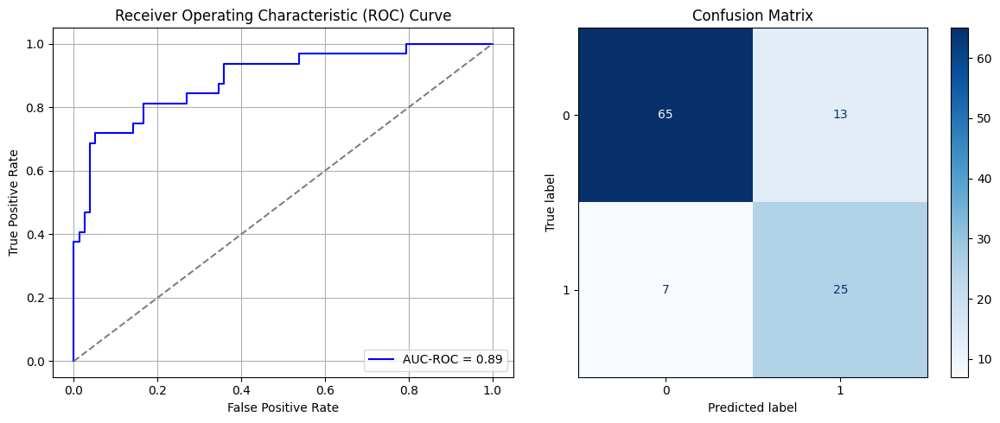

Best threshold based on F1-score: 0.7657893300056458
False Negative Rate: 0.21875
Time elapsed (performance): 0.48636140200005684
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6032 - loss: 0.6815 - val_AUC: 0.8766 - val_loss: 0.5328
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8527 - loss: 0.5102 - val_AUC: 0.9045 - val_loss: 0.4092
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8901 - loss: 0.4175 - val_AUC: 0.9186 - val_loss: 0.3739
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8945 - loss: 0.4013 - val_AUC: 0.9228 - val_loss: 0.3596
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8950 - loss: 0.3988 - val_AUC: 0.9266 - val_loss: 0.3552
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9073 - loss: 0.3797 - val_AUC: 0.9288 - val_loss: 0.3458
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9166 - loss: 0.3539 - val_AUC: 0.9297 - val_loss: 0.3429
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9226 - loss: 0.3530 - val_AUC: 0.9322 - val_loss: 0.3389
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9061 - loss: 0.3837 - v

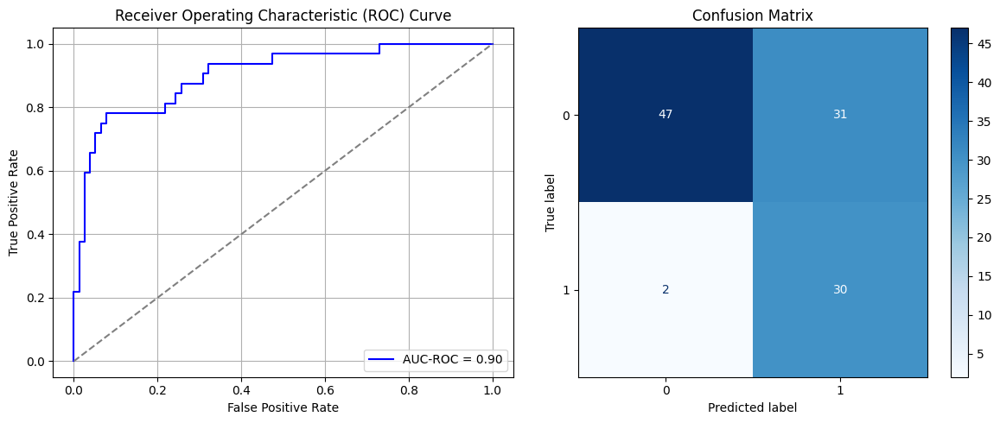

Best threshold based on F1-score: 0.8889493346214294
False Negative Rate: 0.0625
Time elapsed (performance): 0.5116555549998338
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - AUC: 0.7279 - loss: 0.6320 - val_AUC: 0.8667 - val_loss: 0.5097
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8666 - loss: 0.4745 - val_AUC: 0.9039 - val_loss: 0.4205
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8778 - loss: 0.4331 - val_AUC: 0.9160 - val_loss: 0.3842
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9010 - loss: 0.3943 - val_AUC: 0.9209 - val_loss: 0.3805
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8903 - loss: 0.4021 - val_AUC: 0.9246 - val_loss: 0.3579
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9030 - loss: 0.3866 - val_AUC: 0.9268 - val_loss: 0.3517
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9031 - loss: 0.3764 - val_AUC: 0.9273 - val_loss: 0.3479
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9054 - loss: 0.3762 - val_AUC: 0.9284 - val_loss: 0.3462
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9137 - loss: 0.3642 - v

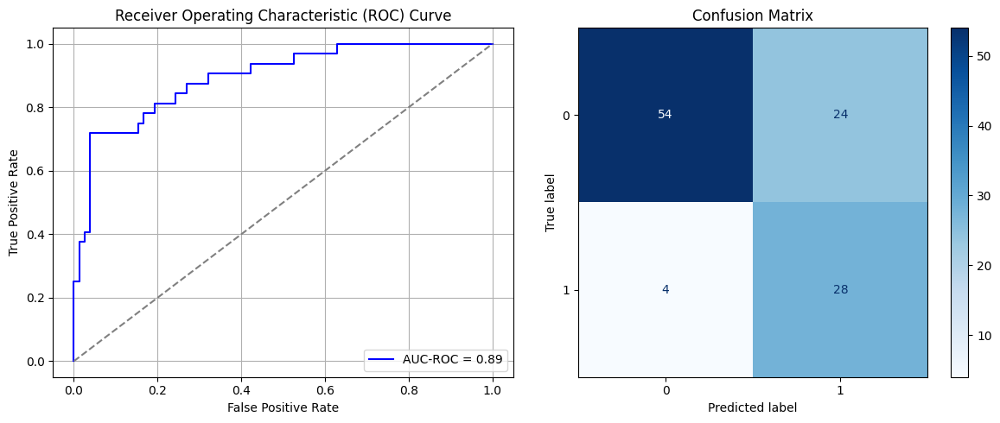

Best threshold based on F1-score: 0.9135016202926636
False Negative Rate: 0.125
Time elapsed (performance): 0.5144984730000033
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7312 - loss: 0.6365 - val_AUC: 0.8997 - val_loss: 0.4742
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8742 - loss: 0.4628 - val_AUC: 0.9168 - val_loss: 0.3846
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8865 - loss: 0.4109 - val_AUC: 0.9230 - val_loss: 0.3651
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9025 - loss: 0.3855 - val_AUC: 0.9258 - val_loss: 0.3501
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9126 - loss: 0.3654 - val_AUC: 0.9268 - val_loss: 0.3604
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8990 - loss: 0.3976 - val_AUC: 0.9272 - val_loss: 0.3370
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9089 - loss: 0.3775 - val_AUC: 0.9278 - val_loss: 0.3455
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9159 - loss: 0.3660 - val_AUC: 0.9282 - val_loss: 0.3363
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9241 - loss: 0.3452 - va

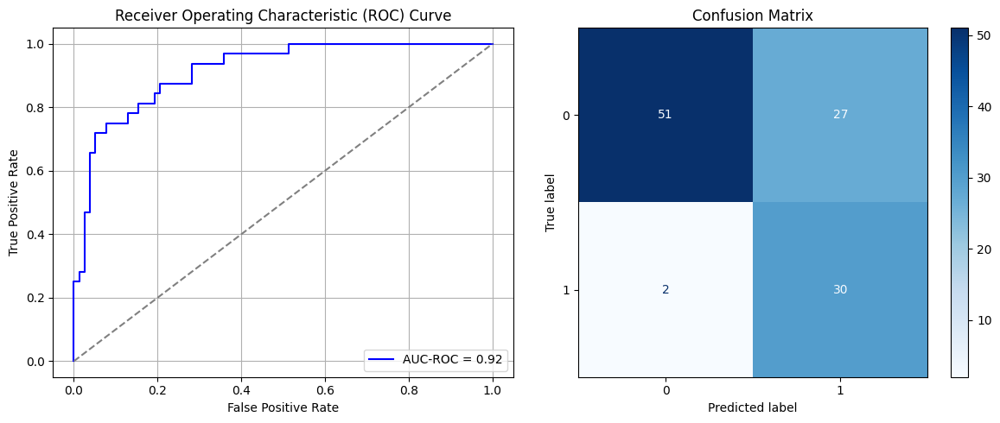

Best threshold based on F1-score: 0.9308093786239624
False Negative Rate: 0.0625
Time elapsed (performance): 0.6569176779998998
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.7183 - loss: 0.6553 - val_AUC: 0.8747 - val_loss: 0.5200
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8503 - loss: 0.5037 - val_AUC: 0.9093 - val_loss: 0.4256
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9005 - loss: 0.4053 - val_AUC: 0.9209 - val_loss: 0.3775
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8884 - loss: 0.4198 - val_AUC: 0.9253 - val_loss: 0.3844
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8891 - loss: 0.4087 - val_AUC: 0.9279 - val_loss: 0.3663
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8967 - loss: 0.4072 - val_AUC: 0.9298 - val_loss: 0.3458
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9130 - loss: 0.3760 - val_AUC: 0.9316 - val_loss: 0.3382
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9156 - loss: 0.3634 - val_AUC: 0.9312 - val_loss: 0.3540
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9264 - loss: 0.3417 - va

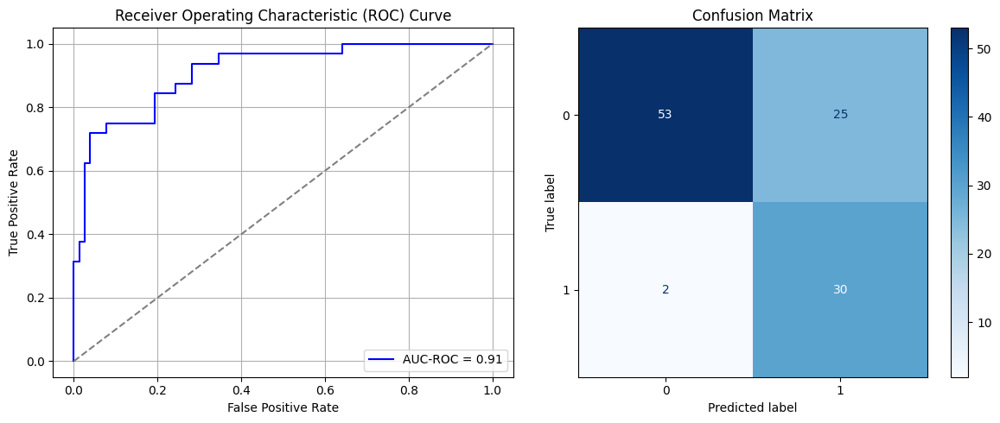

Best threshold based on F1-score: 0.9291285872459412
False Negative Rate: 0.0625
Time elapsed (performance): 0.5108322350001799
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7452 - loss: 0.6386 - val_AUC: 0.8969 - val_loss: 0.4810
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8780 - loss: 0.4654 - val_AUC: 0.9172 - val_loss: 0.4090
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8906 - loss: 0.4126 - val_AUC: 0.9245 - val_loss: 0.3597
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9078 - loss: 0.3735 - val_AUC: 0.9297 - val_loss: 0.3435
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9135 - loss: 0.3624 - val_AUC: 0.9342 - val_loss: 0.3348
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9227 - loss: 0.3435 - val_AUC: 0.9350 - val_loss: 0.3392
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9228 - loss: 0.3451 - val_AUC: 0.9372 - val_loss: 0.3262
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.9201 - loss: 0.3448 - val_AUC: 0.9392 - val_loss: 0.3237
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.9168 - loss: 0.3501 - v

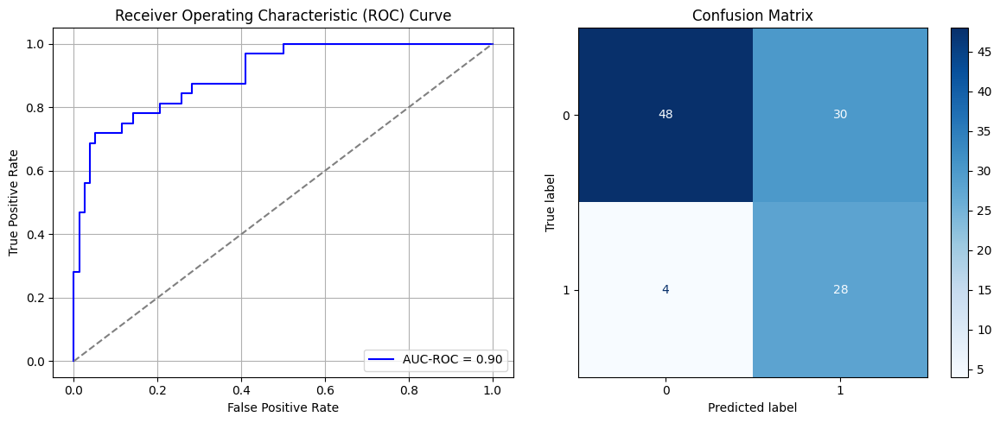

Best threshold based on F1-score: 0.94349604845047
False Negative Rate: 0.125
Time elapsed (performance): 0.5398042030001307
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6621 - loss: 0.6660 - val_AUC: 0.8606 - val_loss: 0.5405
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8582 - loss: 0.5080 - val_AUC: 0.8828 - val_loss: 0.4589
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8840 - loss: 0.4363 - val_AUC: 0.8942 - val_loss: 0.4247
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8927 - loss: 0.4033 - val_AUC: 0.8985 - val_loss: 0.4271
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9109 - loss: 0.3702 - val_AUC: 0.9023 - val_loss: 0.4124
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9004 - loss: 0.3907 - val_AUC: 0.9046 - val_loss: 0.4025
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9133 - loss: 0.3655 - val_AUC: 0.9068 - val_loss: 0.4055
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9252 - loss: 0.3425 - val_AUC: 0.9078 - val_loss: 0.3935
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9181 - loss: 0.3570 - v

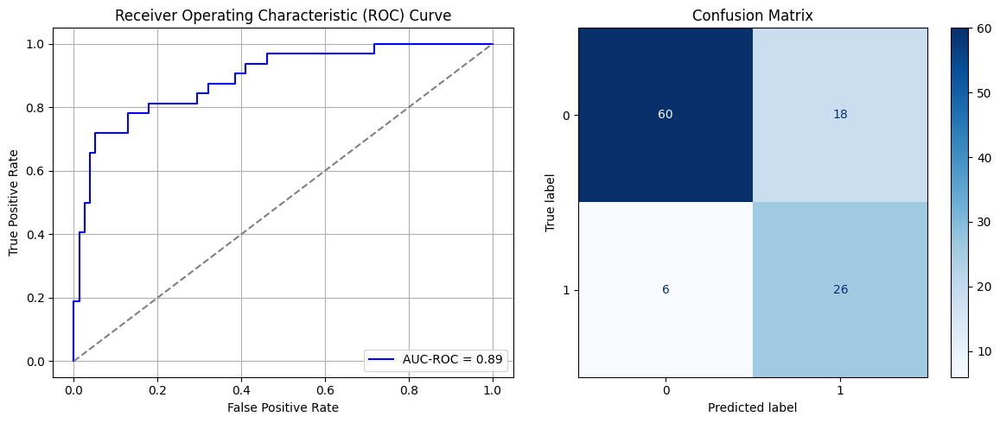

Best threshold based on F1-score: 0.8415963053703308
False Negative Rate: 0.1875
Time elapsed (performance): 0.4876110720001634
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7355 - loss: 0.6408 - val_AUC: 0.8908 - val_loss: 0.4961
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.8679 - loss: 0.4828 - val_AUC: 0.9025 - val_loss: 0.4061
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.8938 - loss: 0.3964 - val_AUC: 0.9067 - val_loss: 0.3994
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8930 - loss: 0.3936 - val_AUC: 0.9087 - val_loss: 0.3855
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9018 - loss: 0.3839 - val_AUC: 0.9103 - val_loss: 0.3887
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9171 - loss: 0.3563 - val_AUC: 0.9155 - val_loss: 0.3736
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9027 - loss: 0.3797 - val_AUC: 0.9154 - val_loss: 0.3856
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9229 - loss: 0.3387 - val_AUC: 0.9162 - val_loss: 0.3724
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9217 - loss: 0.3448 - v

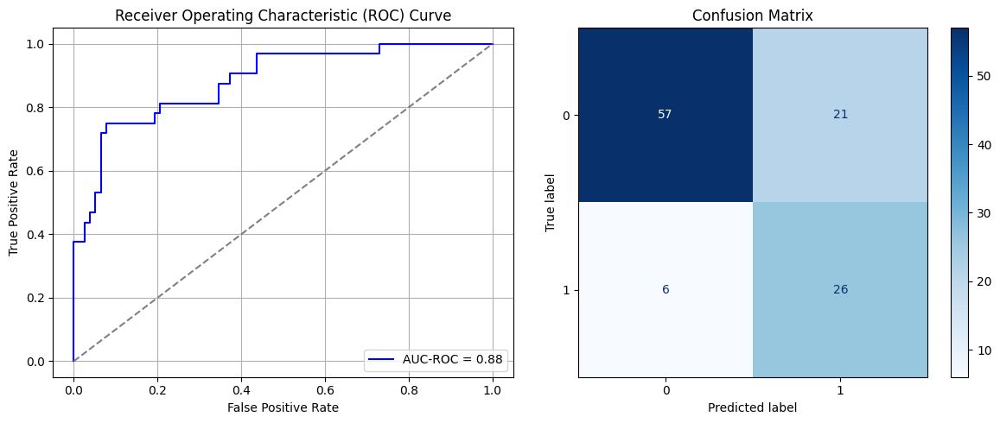

Best threshold based on F1-score: 0.7424435615539551
False Negative Rate: 0.1875
Time elapsed (performance): 0.4885674080001081
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7030 - loss: 0.6588 - val_AUC: 0.8992 - val_loss: 0.5144
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8702 - loss: 0.4983 - val_AUC: 0.9158 - val_loss: 0.3964
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8774 - loss: 0.4333 - val_AUC: 0.9233 - val_loss: 0.3837
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8984 - loss: 0.3986 - val_AUC: 0.9278 - val_loss: 0.3600
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8944 - loss: 0.3978 - val_AUC: 0.9286 - val_loss: 0.3488
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9010 - loss: 0.3921 - val_AUC: 0.9299 - val_loss: 0.3451
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9132 - loss: 0.3633 - val_AUC: 0.9300 - val_loss: 0.3555
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9144 - loss: 0.3590 - val_AUC: 0.9309 - val_loss: 0.3542
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9144 - loss: 0.3596 - v

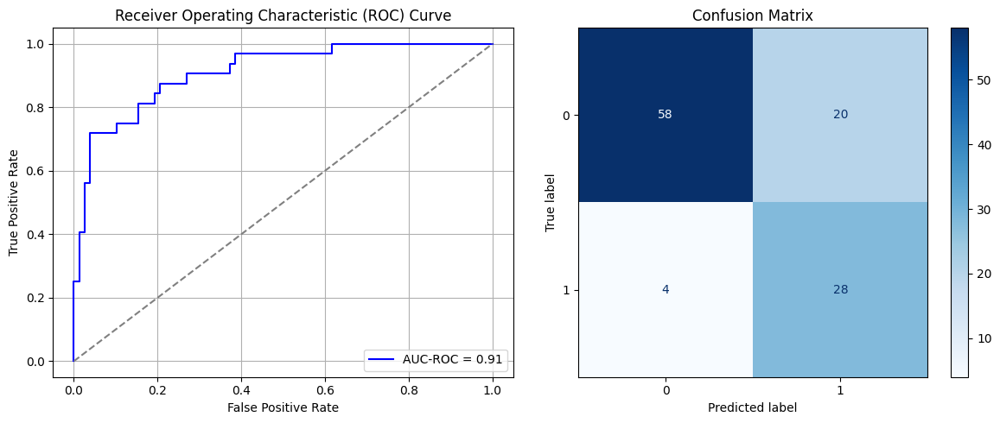

Best threshold based on F1-score: 0.9080133438110352
False Negative Rate: 0.125
Time elapsed (performance): 0.5138341570000193
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - AUC: 0.6367 - loss: 0.6753 - val_AUC: 0.8555 - val_loss: 0.5488
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8656 - loss: 0.5095 - val_AUC: 0.8774 - val_loss: 0.4548
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8887 - loss: 0.4273 - val_AUC: 0.8891 - val_loss: 0.4311
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8873 - loss: 0.4174 - val_AUC: 0.8964 - val_loss: 0.4123
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8872 - loss: 0.4100 - val_AUC: 0.8998 - val_loss: 0.3989
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9081 - loss: 0.3768 - val_AUC: 0.9023 - val_loss: 0.3975
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9212 - loss: 0.3503 - val_AUC: 0.9042 - val_loss: 0.3893
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9116 - loss: 0.3741 - val_AUC: 0.9051 - val_loss: 0.3873
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9195 - loss: 0.3486 - v

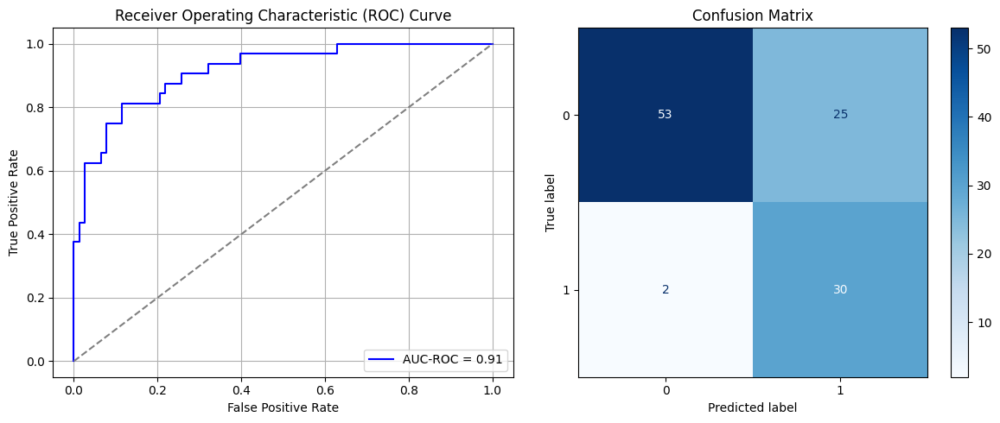

Best threshold based on F1-score: 0.7873619794845581
False Negative Rate: 0.0625
Time elapsed (performance): 0.5158574629999748
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6608 - loss: 0.6603 - val_AUC: 0.8822 - val_loss: 0.5187
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8734 - loss: 0.4871 - val_AUC: 0.9066 - val_loss: 0.3982
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8924 - loss: 0.4060 - val_AUC: 0.9138 - val_loss: 0.4009
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8964 - loss: 0.4062 - val_AUC: 0.9183 - val_loss: 0.3740
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9011 - loss: 0.3901 - val_AUC: 0.9202 - val_loss: 0.3716
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8943 - loss: 0.3991 - val_AUC: 0.9213 - val_loss: 0.3860
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9078 - loss: 0.3823 - val_AUC: 0.9237 - val_loss: 0.3619
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9126 - loss: 0.3727 - val_AUC: 0.9231 - val_loss: 0.3565
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9131 - loss: 0.3665 - v

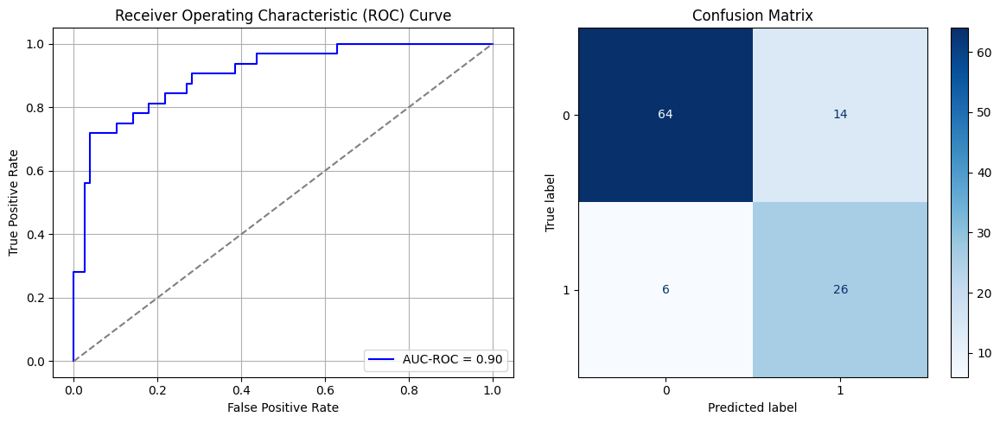

Best threshold based on F1-score: 0.785841703414917
False Negative Rate: 0.1875
Time elapsed (performance): 0.6890885550001258
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.5139 - loss: 0.6924 - val_AUC: 0.8431 - val_loss: 0.5706
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8563 - loss: 0.5267 - val_AUC: 0.8778 - val_loss: 0.4542
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8992 - loss: 0.4085 - val_AUC: 0.8960 - val_loss: 0.4178
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8945 - loss: 0.4111 - val_AUC: 0.9042 - val_loss: 0.3980
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8981 - loss: 0.3930 - val_AUC: 0.9097 - val_loss: 0.3918
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9165 - loss: 0.3596 - val_AUC: 0.9136 - val_loss: 0.3986
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9155 - loss: 0.3700 - val_AUC: 0.9159 - val_loss: 0.3732
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9207 - loss: 0.3516 - val_AUC: 0.9193 - val_loss: 0.3689
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9185 - loss: 0.3538 - v

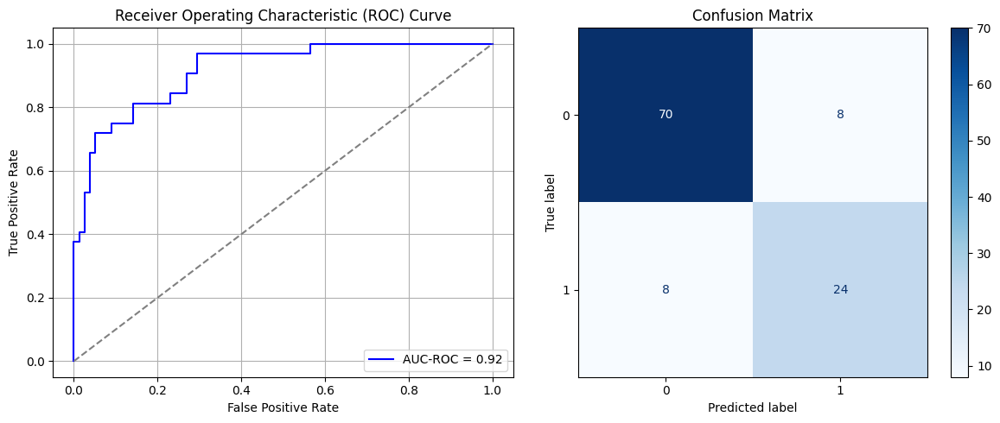

Best threshold based on F1-score: 0.7297402024269104
False Negative Rate: 0.25
Time elapsed (performance): 0.5093156180000733
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6668 - loss: 0.6606 - val_AUC: 0.8527 - val_loss: 0.5354
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8742 - loss: 0.4856 - val_AUC: 0.8782 - val_loss: 0.4501
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8755 - loss: 0.4406 - val_AUC: 0.8915 - val_loss: 0.4277
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8840 - loss: 0.4238 - val_AUC: 0.9005 - val_loss: 0.4005
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9012 - loss: 0.3965 - val_AUC: 0.9039 - val_loss: 0.3916
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9084 - loss: 0.3772 - val_AUC: 0.9097 - val_loss: 0.3833
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9031 - loss: 0.3888 - val_AUC: 0.9098 - val_loss: 0.3830
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9207 - loss: 0.3564 - val_AUC: 0.9117 - val_loss: 0.3747
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9156 - loss: 0.3631 - v

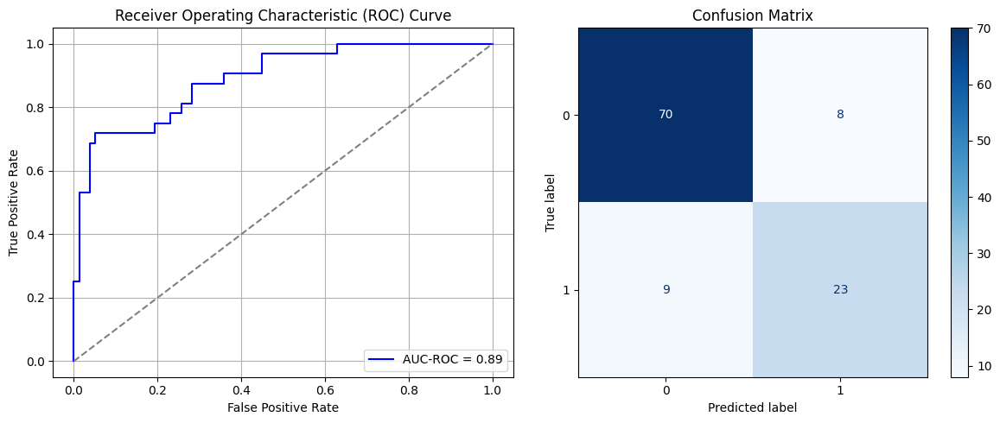

Best threshold based on F1-score: 0.720425546169281
False Negative Rate: 0.28125
Time elapsed (performance): 0.5078626889999214
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.5847 - loss: 0.6776 - val_AUC: 0.9030 - val_loss: 0.4712
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8520 - loss: 0.4947 - val_AUC: 0.9267 - val_loss: 0.3726
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8809 - loss: 0.4295 - val_AUC: 0.9310 - val_loss: 0.3505
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8993 - loss: 0.3921 - val_AUC: 0.9337 - val_loss: 0.3572
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8905 - loss: 0.4133 - val_AUC: 0.9360 - val_loss: 0.3351
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9039 - loss: 0.3839 - val_AUC: 0.9356 - val_loss: 0.3383
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9086 - loss: 0.3713 - val_AUC: 0.9374 - val_loss: 0.3337
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8979 - loss: 0.3898 - val_AUC: 0.9365 - val_loss: 0.3254
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9039 - loss: 0.3773 - v

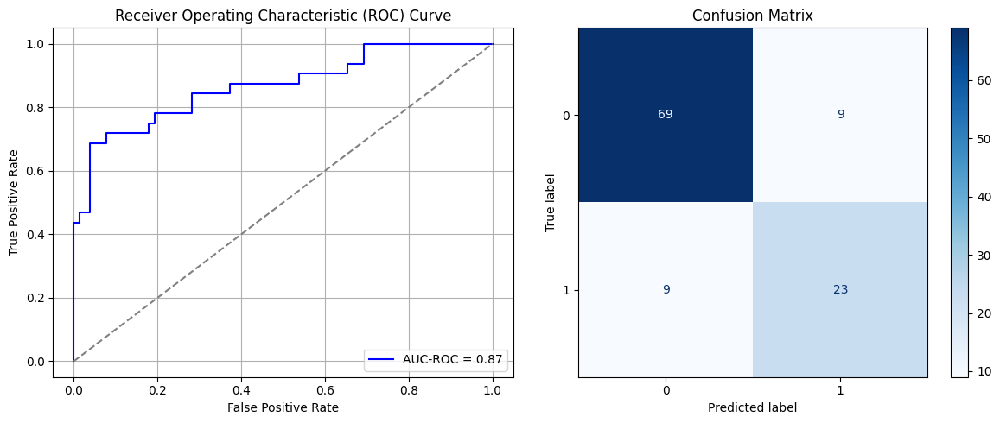

Best threshold based on F1-score: 0.7442179322242737
False Negative Rate: 0.28125
Time elapsed (performance): 0.5452071419999811
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - AUC: 0.5311 - loss: 0.6946 - val_AUC: 0.8859 - val_loss: 0.5266
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8661 - loss: 0.4981 - val_AUC: 0.9065 - val_loss: 0.4108
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8841 - loss: 0.4278 - val_AUC: 0.9125 - val_loss: 0.3834
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8977 - loss: 0.3915 - val_AUC: 0.9157 - val_loss: 0.3744
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8952 - loss: 0.4014 - val_AUC: 0.9176 - val_loss: 0.3694
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9103 - loss: 0.3704 - val_AUC: 0.9172 - val_loss: 0.3829
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9142 - loss: 0.3612 - val_AUC: 0.9211 - val_loss: 0.3590
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9224 - loss: 0.3468 - val_AUC: 0.9205 - val_loss: 0.3663
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9213 - loss: 0.3548 - v

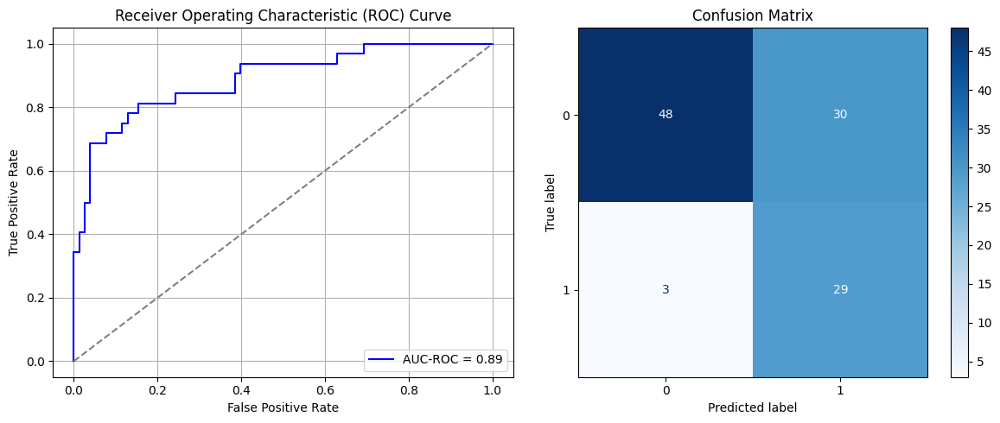

Best threshold based on F1-score: 0.9301994442939758
False Negative Rate: 0.09375
Time elapsed (performance): 0.568330283999785
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6167 - loss: 0.6721 - val_AUC: 0.8619 - val_loss: 0.5522
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8724 - loss: 0.5002 - val_AUC: 0.8878 - val_loss: 0.4299
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8947 - loss: 0.4033 - val_AUC: 0.8991 - val_loss: 0.4025
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9025 - loss: 0.3832 - val_AUC: 0.9051 - val_loss: 0.3867
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9112 - loss: 0.3723 - val_AUC: 0.9092 - val_loss: 0.3832
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9117 - loss: 0.3708 - val_AUC: 0.9103 - val_loss: 0.3715
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9219 - loss: 0.3458 - val_AUC: 0.9128 - val_loss: 0.3680
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9066 - loss: 0.3737 - val_AUC: 0.9148 - val_loss: 0.3625
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9133 - loss: 0.3628 - v

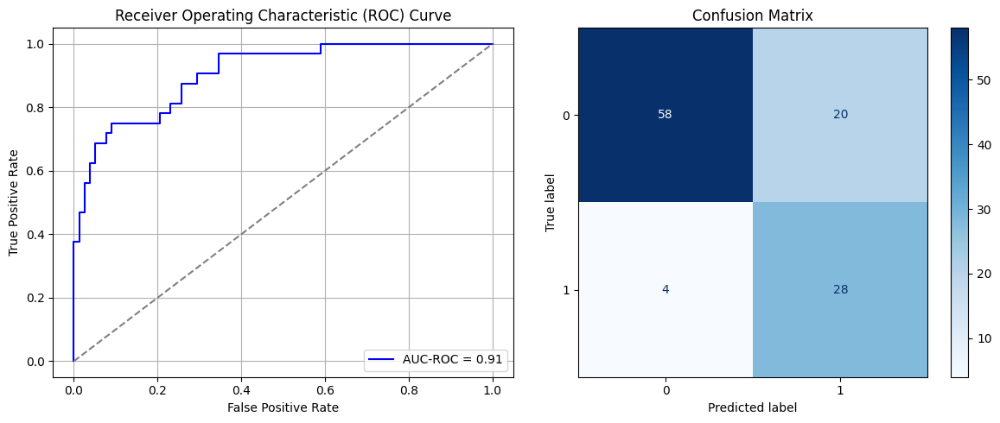

Best threshold based on F1-score: 0.7372184991836548
False Negative Rate: 0.125
Time elapsed (performance): 0.7286156879999908
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6705 - loss: 0.6618 - val_AUC: 0.8822 - val_loss: 0.5250
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8696 - loss: 0.4891 - val_AUC: 0.9031 - val_loss: 0.4079
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8982 - loss: 0.3984 - val_AUC: 0.9128 - val_loss: 0.3797
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9119 - loss: 0.3735 - val_AUC: 0.9174 - val_loss: 0.3669
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8996 - loss: 0.3860 - val_AUC: 0.9199 - val_loss: 0.3647
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8997 - loss: 0.3848 - val_AUC: 0.9215 - val_loss: 0.3559
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9225 - loss: 0.3432 - val_AUC: 0.9241 - val_loss: 0.3462
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9174 - loss: 0.3524 - val_AUC: 0.9246 - val_loss: 0.3443
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9286 - loss: 0.3223 - v

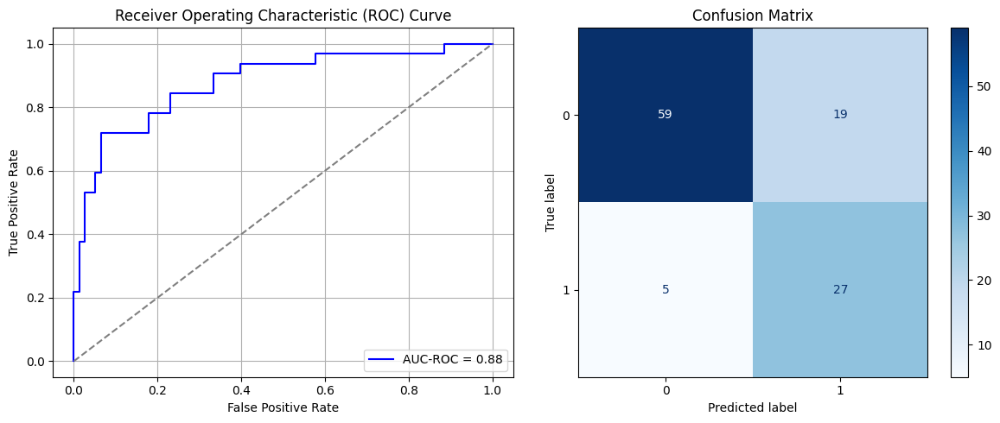

Best threshold based on F1-score: 0.8117834329605103
False Negative Rate: 0.15625
Time elapsed (performance): 0.5308456070001739
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6723 - loss: 0.6573 - val_AUC: 0.8761 - val_loss: 0.5200
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8560 - loss: 0.5078 - val_AUC: 0.9057 - val_loss: 0.4160
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8841 - loss: 0.4271 - val_AUC: 0.9178 - val_loss: 0.3799
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9029 - loss: 0.3871 - val_AUC: 0.9216 - val_loss: 0.3624
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9020 - loss: 0.3797 - val_AUC: 0.9255 - val_loss: 0.3521
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9152 - loss: 0.3593 - val_AUC: 0.9270 - val_loss: 0.3458
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9183 - loss: 0.3539 - val_AUC: 0.9280 - val_loss: 0.3465
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9106 - loss: 0.3616 - val_AUC: 0.9298 - val_loss: 0.3389
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9145 - loss: 0.3534 - v

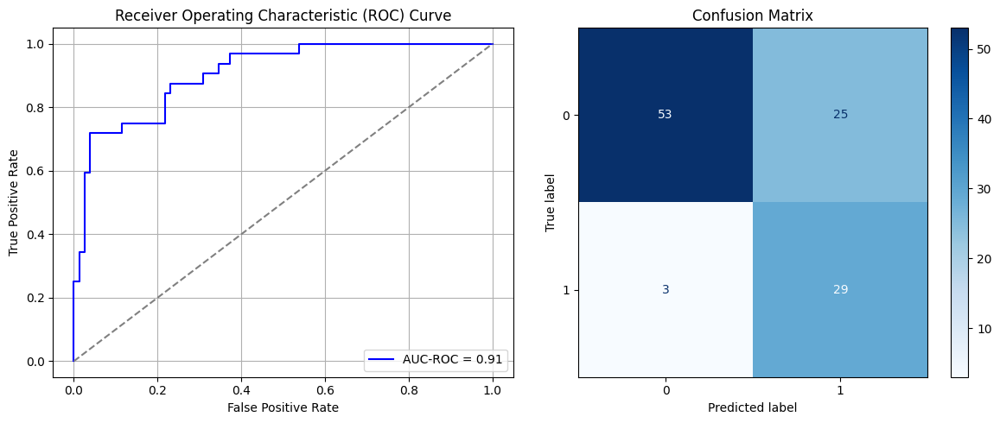

Best threshold based on F1-score: 0.9348315596580505
False Negative Rate: 0.09375
Time elapsed (performance): 0.4836114150002686
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7647 - loss: 0.6308 - val_AUC: 0.8909 - val_loss: 0.4906
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8702 - loss: 0.4742 - val_AUC: 0.9106 - val_loss: 0.3989
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8838 - loss: 0.4231 - val_AUC: 0.9233 - val_loss: 0.3691
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8949 - loss: 0.4008 - val_AUC: 0.9270 - val_loss: 0.3532
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8887 - loss: 0.4017 - val_AUC: 0.9286 - val_loss: 0.3474
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9070 - loss: 0.3800 - val_AUC: 0.9315 - val_loss: 0.3359
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9193 - loss: 0.3515 - val_AUC: 0.9320 - val_loss: 0.3350
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9187 - loss: 0.3536 - val_AUC: 0.9349 - val_loss: 0.3260
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9112 - loss: 0.3686 - v

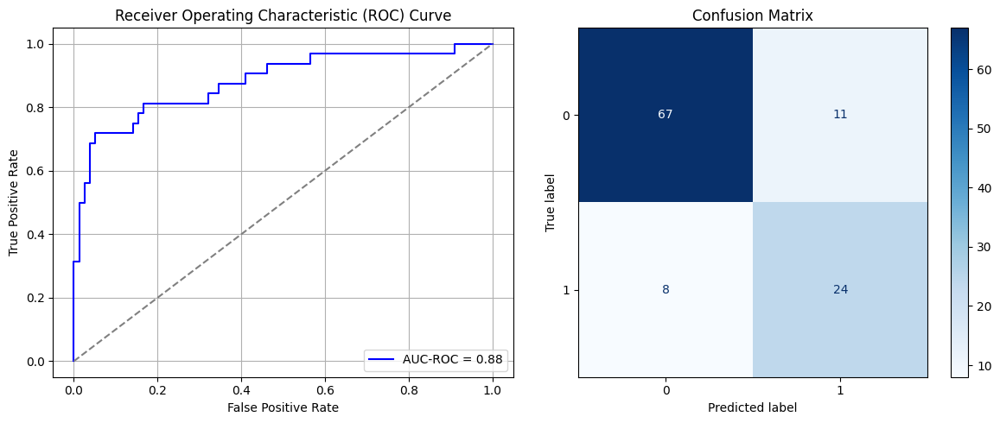

Best threshold based on F1-score: 0.7869786620140076
False Negative Rate: 0.25
Time elapsed (performance): 0.5048632450002515
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - AUC: 0.7536 - loss: 0.6263 - val_AUC: 0.8728 - val_loss: 0.4822
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8814 - loss: 0.4506 - val_AUC: 0.8967 - val_loss: 0.4152
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8961 - loss: 0.4006 - val_AUC: 0.9041 - val_loss: 0.3959
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8981 - loss: 0.3974 - val_AUC: 0.9087 - val_loss: 0.3849
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9053 - loss: 0.3849 - val_AUC: 0.9130 - val_loss: 0.3919
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9215 - loss: 0.3520 - val_AUC: 0.9152 - val_loss: 0.3700
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9204 - loss: 0.3496 - val_AUC: 0.9160 - val_loss: 0.3666
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9134 - loss: 0.3558 - val_AUC: 0.9184 - val_loss: 0.3623
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9235 - loss: 0.3425 - v

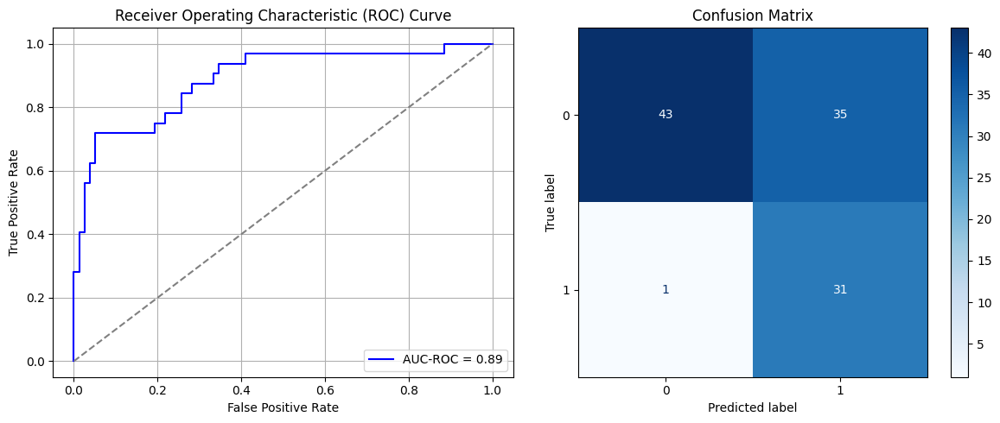

Best threshold based on F1-score: 0.9565035700798035
False Negative Rate: 0.03125
Time elapsed (performance): 0.5489914839999983
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7759 - loss: 0.6488 - val_AUC: 0.9079 - val_loss: 0.4942
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8786 - loss: 0.4818 - val_AUC: 0.9173 - val_loss: 0.4036
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8936 - loss: 0.4142 - val_AUC: 0.9258 - val_loss: 0.3655
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8932 - loss: 0.4063 - val_AUC: 0.9271 - val_loss: 0.3570
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8975 - loss: 0.3960 - val_AUC: 0.9288 - val_loss: 0.3500
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8989 - loss: 0.3900 - val_AUC: 0.9296 - val_loss: 0.3461
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8984 - loss: 0.3867 - val_AUC: 0.9302 - val_loss: 0.3448
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9131 - loss: 0.3686 - val_AUC: 0.9309 - val_loss: 0.3369
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9061 - loss: 0.3751 - v

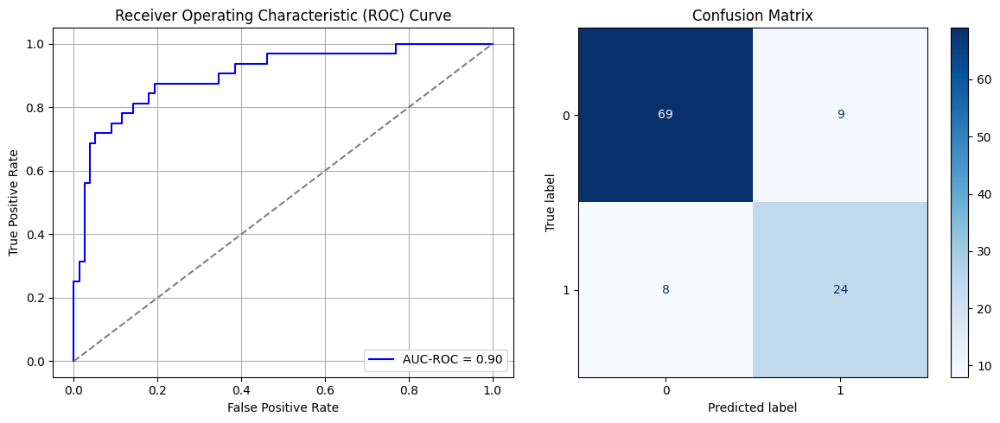

Best threshold based on F1-score: 0.5755568146705627
False Negative Rate: 0.25
Time elapsed (performance): 0.5223611470000833


In [63]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=True)
    data_S_SRSwR_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRSwR = data_S_SRSwR_RUS.iloc[:, :-1]
    y_S_SRSwR = data_S_SRSwR_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRSwR, y_S_SRSwR, test_size=0.20, random_state=0)
    model_SRSwR = create_dnn_model(X_S_train.shape[1])
    result_SRSwR = train_and_evaluate(model_SRSwR, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRSwR = Transductive_TL(model_SRSwR, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRSwR)
    FPR.append(result_TL_SRSwR[0])
    TNR.append(result_TL_SRSwR[1])
    FNR.append(result_TL_SRSwR[2])
    TPR.append(result_TL_SRSwR[3])
    TL_time.append(result_TL_SRSwR[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [64]:
print(ParamFit)
ParamFit.to_csv('SRSwR_RUS.csv')

    Source time       FPR       TNR      FNR      TPR  Target time
0      6.602260  0.371795  0.628205  0.09375  0.90625     0.420237
1      5.544936  0.205128  0.794872  0.21875  0.78125     0.657924
2      4.665178  0.282051  0.717949  0.21875  0.78125     0.429498
3      4.998373  0.256410  0.743590  0.15625  0.84375     0.659791
4      5.349015  0.115385  0.884615  0.28125  0.71875     0.454441
5      4.823616  0.269231  0.730769  0.12500  0.87500     0.476682
6      6.023848  0.410256  0.589744  0.03125  0.96875     0.486191
7      4.693970  0.153846  0.846154  0.18750  0.81250     0.469919
8      6.047474  0.282051  0.717949  0.15625  0.84375     0.465886
9      4.816142  0.102564  0.897436  0.25000  0.75000     0.475856
10     8.076695  0.256410  0.743590  0.09375  0.90625     0.470048
11     4.987140  0.500000  0.500000  0.03125  0.96875     0.474715
12     6.169348  0.320513  0.679487  0.09375  0.90625     0.469057
13     5.001726  0.166667  0.833333  0.25000  0.75000     0.47

## Systematic Sampling:

First, we select a single systematic sample from the majority class, in which $k = \frac{N_0}{N_1}$, where $N_0$ is the majority class size in the source domain and $N_1$ is the minority class in the source domain.

2.1058315334773217
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 4s 24ms/step - AUC: 0.5886 - loss: 0.6843 - val_AUC: 0.8544 - val_loss: 0.5384
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - AUC: 0.8646 - loss: 0.4910 - val_AUC: 0.8916 - val_loss: 0.4248
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - AUC: 0.8796 - loss: 0.4292 - val_AUC: 0.9049 - val_loss: 0.3938
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - AUC: 0.8949 - loss: 0.3984 - val_AUC: 0.9096 - val_loss: 0.3892
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8949 - loss: 0.3982 - val_AUC: 0.9153 - val_loss: 0.3719
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - AUC: 0.9065 - loss: 0.3807 - val_AUC: 0.9160 - val_loss: 0.3653
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - AUC: 0.9129 - loss: 0.3701 - val_AUC: 0.9183 - val_loss: 0.3653
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9007 - loss: 0.4012 - val_AUC: 0.9211 - val_loss: 0.3567
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9070 - loss: 0.381

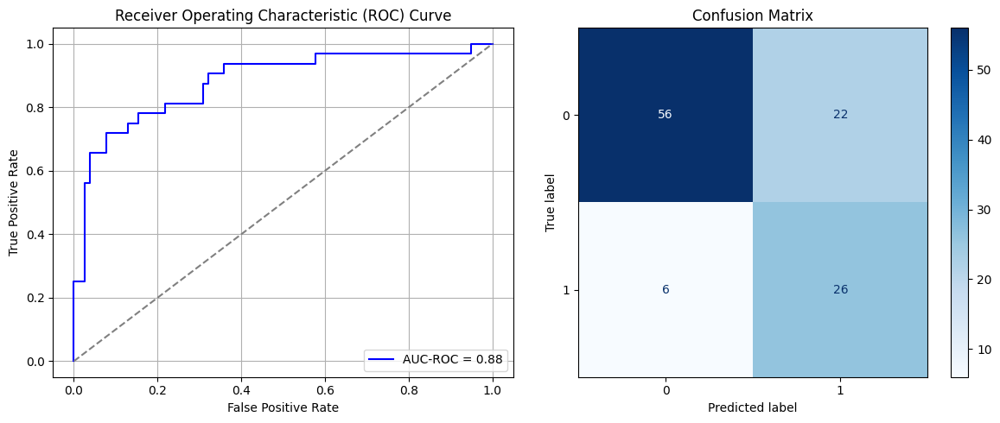

Best threshold based on F1-score: 0.8071586489677429
False Negative Rate: 0.1875
Time elapsed (performance): 1.2410609400003523
(np.float64(0.28205128205128205), np.float64(0.717948717948718))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 6s 28ms/step - AUC: 0.7668 - loss: 0.6309 - val_AUC: 0.8694 - val_loss: 0.4973
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8750 - loss: 0.4617 - val_AUC: 0.8882 - val_loss: 0.4329
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8957 - loss: 0.4061 - val_AUC: 0.8945 - val_loss: 0.4217
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8976 - loss: 0.3939 - val_AUC: 0.8985 - val_loss: 0.4287
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9023 - loss: 0.3858 - val_AUC: 0.9001 - val_loss: 0.4086
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9055 - loss: 0.3757 - val_AUC: 0.9019 - val_loss: 0.4173
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9174 - loss: 0.3593 - val_AUC: 0.9025 - val_loss: 0.4059
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9233 - loss: 0.3426 - val_AUC: 0.9034 - val_loss: 0.4084
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9226 - loss: 0.3423 - v

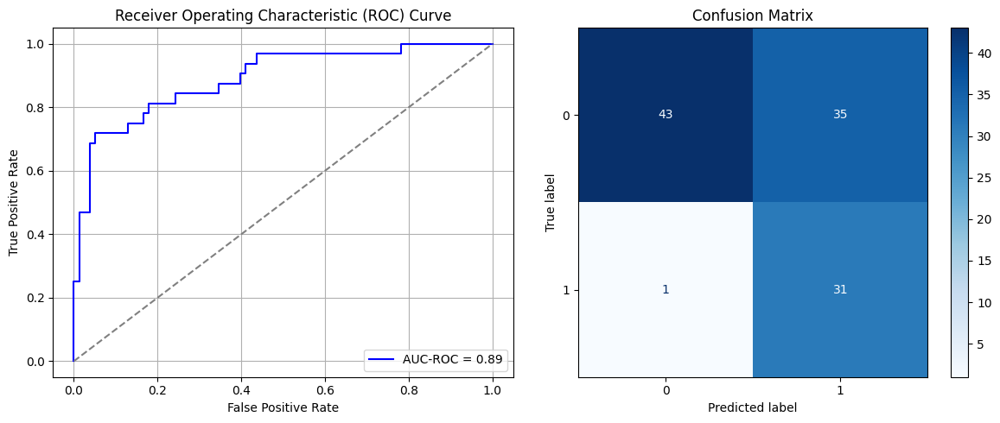

Best threshold based on F1-score: 0.9525074362754822
False Negative Rate: 0.03125
Time elapsed (performance): 0.4662619939999786
(np.float64(0.44871794871794873), np.float64(0.5512820512820513))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.5782 - loss: 0.6841 - val_AUC: 0.8540 - val_loss: 0.5583
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8704 - loss: 0.5072 - val_AUC: 0.8798 - val_loss: 0.4476
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8922 - loss: 0.4137 - val_AUC: 0.8934 - val_loss: 0.4203
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8910 - loss: 0.4056 - val_AUC: 0.9019 - val_loss: 0.4042
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9025 - loss: 0.3898 - val_AUC: 0.9019 - val_loss: 0.4068
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8996 - loss: 0.3827 - val_AUC: 0.9044 - val_loss: 0.4058
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9225 - loss: 0.3492 - val_AUC: 0.9038 - val_loss: 0.3993
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9151 - loss: 0.3616 - val_AUC: 0.9057 - val_loss: 0.3954
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9163 - loss: 0.3608 - va

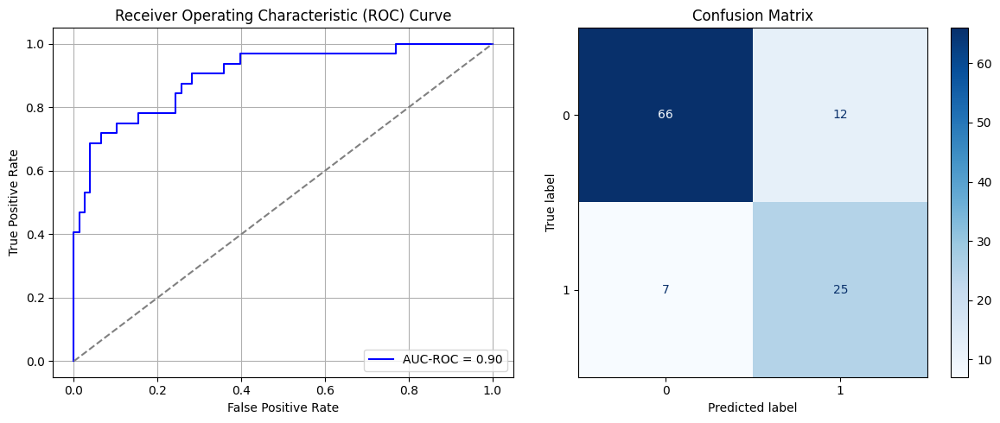

Best threshold based on F1-score: 0.8241751194000244
False Negative Rate: 0.21875
Time elapsed (performance): 0.4843499469998278
(np.float64(0.15384615384615385), np.float64(0.8461538461538461))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - AUC: 0.5982 - loss: 0.6709 - val_AUC: 0.8478 - val_loss: 0.5397
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8479 - loss: 0.5115 - val_AUC: 0.8800 - val_loss: 0.4459
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8810 - loss: 0.4336 - val_AUC: 0.8989 - val_loss: 0.4058
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9075 - loss: 0.3881 - val_AUC: 0.9064 - val_loss: 0.4027
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8984 - loss: 0.3961 - val_AUC: 0.9098 - val_loss: 0.3791
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8989 - loss: 0.3954 - val_AUC: 0.9157 - val_loss: 0.3755
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8990 - loss: 0.3942 - val_AUC: 0.9150 - val_loss: 0.3696
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8961 - loss: 0.4073 - val_AUC: 0.9169 - val_loss: 0.3688
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9240 - loss: 0.3481 - v

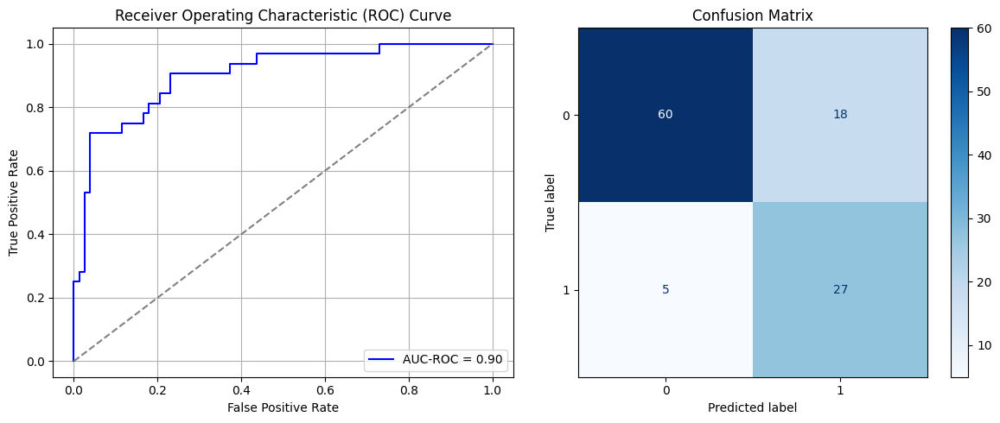

Best threshold based on F1-score: 0.7897840142250061
False Negative Rate: 0.15625
Time elapsed (performance): 0.4970790349998424
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - AUC: 0.6971 - loss: 0.6532 - val_AUC: 0.8590 - val_loss: 0.5184
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8640 - loss: 0.4828 - val_AUC: 0.8837 - val_loss: 0.4427
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8836 - loss: 0.4213 - val_AUC: 0.8951 - val_loss: 0.4164
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8991 - loss: 0.3925 - val_AUC: 0.8971 - val_loss: 0.4109
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9010 - loss: 0.3865 - val_AUC: 0.9005 - val_loss: 0.4043
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9070 - loss: 0.3711 - val_AUC: 0.9028 - val_loss: 0.4241
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9171 - loss: 0.3576 - val_AUC: 0.9041 - val_loss: 0.4102
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9049 - loss: 0.3750 - val_AUC: 0.9037 - val_loss: 0.3976
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9221 - loss: 0.3377 - v

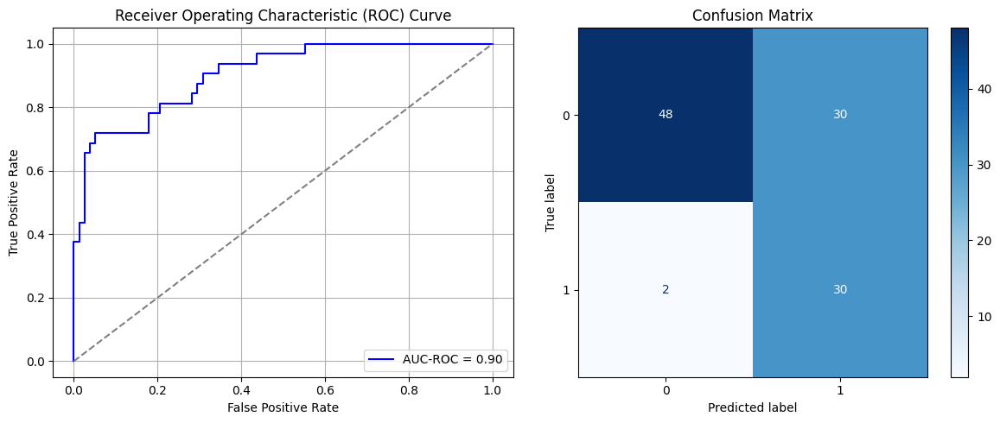

Best threshold based on F1-score: 0.9406956434249878
False Negative Rate: 0.0625
Time elapsed (performance): 0.46829742599948077
(np.float64(0.38461538461538464), np.float64(0.6153846153846154))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - AUC: 0.5981 - loss: 0.6841 - val_AUC: 0.8470 - val_loss: 0.5577
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8421 - loss: 0.5279 - val_AUC: 0.8717 - val_loss: 0.4591
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8906 - loss: 0.4230 - val_AUC: 0.8858 - val_loss: 0.4391
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8954 - loss: 0.4011 - val_AUC: 0.8932 - val_loss: 0.4187
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9010 - loss: 0.3905 - val_AUC: 0.8962 - val_loss: 0.4166
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8949 - loss: 0.3996 - val_AUC: 0.9001 - val_loss: 0.4045
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9216 - loss: 0.3469 - val_AUC: 0.9015 - val_loss: 0.4079
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9058 - loss: 0.3733 - val_AUC: 0.9037 - val_loss: 0.3971
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9113 - loss: 0.3650 - v

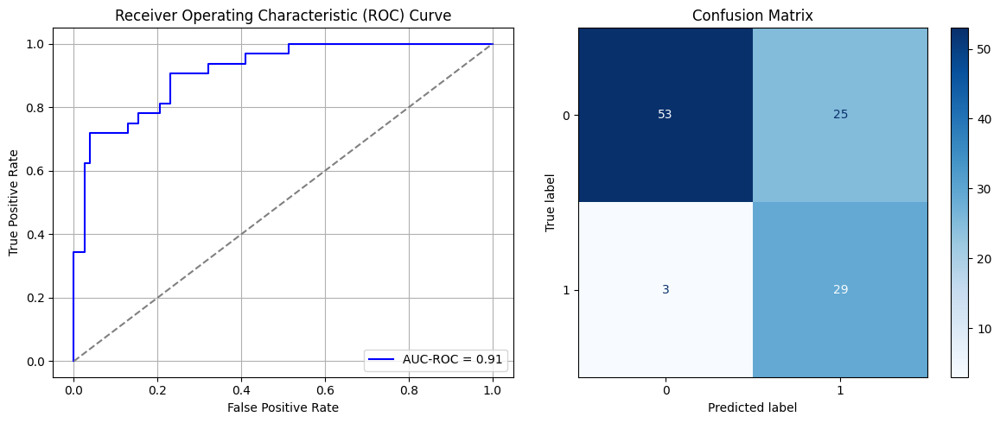

Best threshold based on F1-score: 0.9306763410568237
False Negative Rate: 0.09375
Time elapsed (performance): 0.4721712939999634
(np.float64(0.32051282051282054), np.float64(0.6794871794871795))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7659 - loss: 0.6404 - val_AUC: 0.8750 - val_loss: 0.5173
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8613 - loss: 0.4943 - val_AUC: 0.8938 - val_loss: 0.4479
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8792 - loss: 0.4370 - val_AUC: 0.9049 - val_loss: 0.4009
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8927 - loss: 0.4079 - val_AUC: 0.9107 - val_loss: 0.4095
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8811 - loss: 0.4217 - val_AUC: 0.9160 - val_loss: 0.3696
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8905 - loss: 0.4089 - val_AUC: 0.9205 - val_loss: 0.3621
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9082 - loss: 0.3760 - val_AUC: 0.9229 - val_loss: 0.3569
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9100 - loss: 0.3695 - val_AUC: 0.9230 - val_loss: 0.3500
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9162 - loss: 0.3637 - va

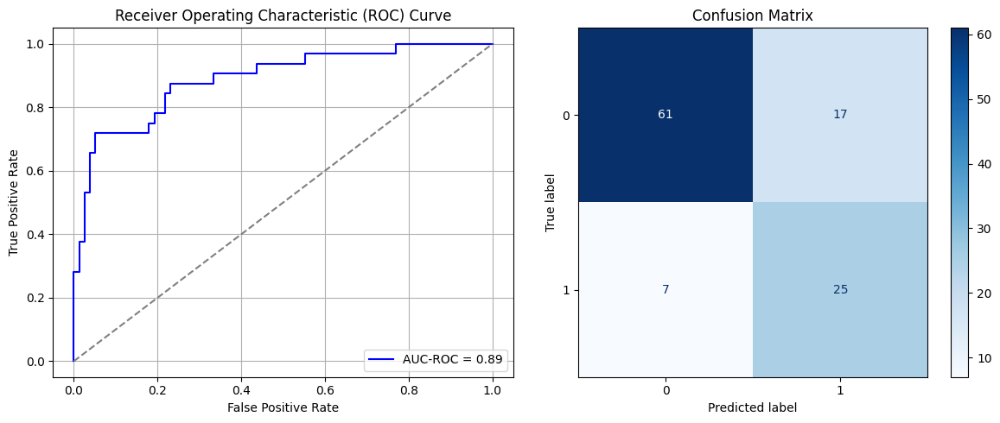

Best threshold based on F1-score: 0.845130205154419
False Negative Rate: 0.21875
Time elapsed (performance): 0.49720425000032265
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.7535 - loss: 0.6278 - val_AUC: 0.8711 - val_loss: 0.4910
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8760 - loss: 0.4646 - val_AUC: 0.8949 - val_loss: 0.4251
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8906 - loss: 0.4170 - val_AUC: 0.9001 - val_loss: 0.4103
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9044 - loss: 0.3883 - val_AUC: 0.9032 - val_loss: 0.4004
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9157 - loss: 0.3611 - val_AUC: 0.9059 - val_loss: 0.4019
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9066 - loss: 0.3728 - val_AUC: 0.9061 - val_loss: 0.3910
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9102 - loss: 0.3634 - val_AUC: 0.9069 - val_loss: 0.4039
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9127 - loss: 0.3598 - val_AUC: 0.9082 - val_loss: 0.3870
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9126 - loss: 0.3583 - v

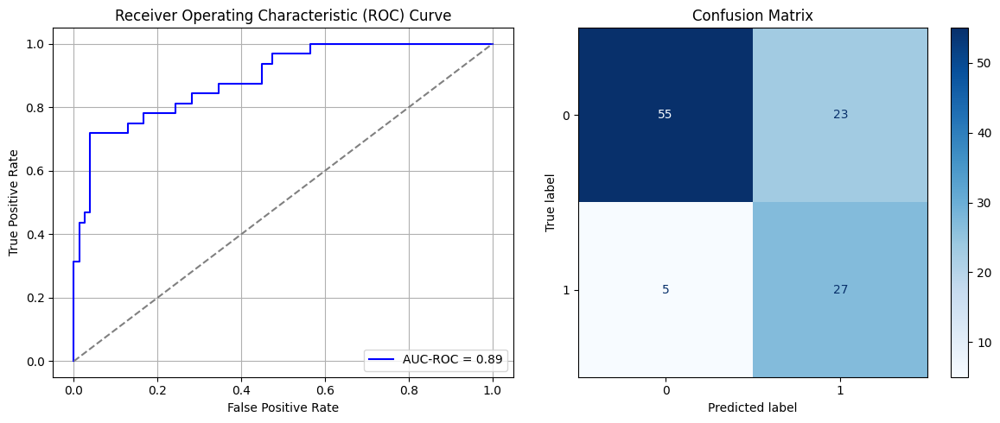

Best threshold based on F1-score: 0.9173704385757446
False Negative Rate: 0.15625
Time elapsed (performance): 0.4664939099993717
(np.float64(0.2948717948717949), np.float64(0.7051282051282051))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7661 - loss: 0.6280 - val_AUC: 0.8588 - val_loss: 0.4927
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8656 - loss: 0.4601 - val_AUC: 0.8902 - val_loss: 0.4284
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8786 - loss: 0.4316 - val_AUC: 0.8990 - val_loss: 0.4079
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8954 - loss: 0.3992 - val_AUC: 0.9022 - val_loss: 0.4026
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9036 - loss: 0.3777 - val_AUC: 0.9043 - val_loss: 0.4002
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9082 - loss: 0.3683 - val_AUC: 0.9075 - val_loss: 0.3952
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9077 - loss: 0.3674 - val_AUC: 0.9068 - val_loss: 0.3997
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9198 - loss: 0.3459 - val_AUC: 0.9078 - val_loss: 0.3960
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9172 - loss: 0.3507 - va

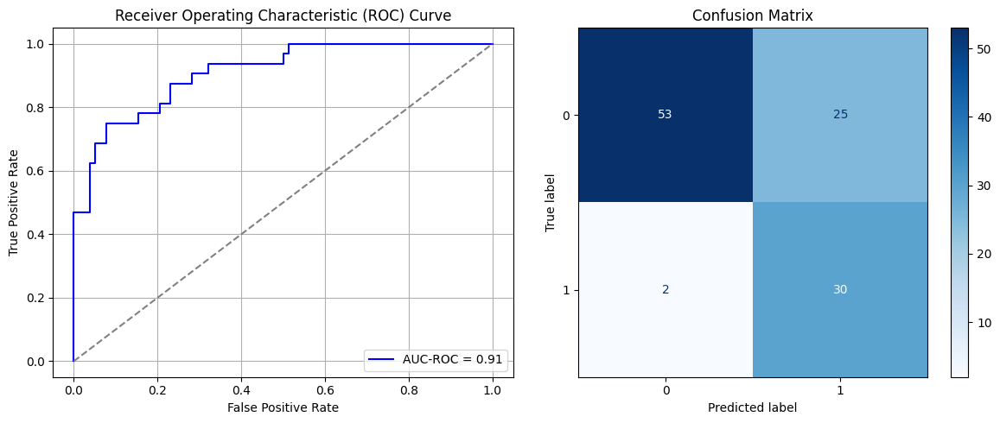

Best threshold based on F1-score: 0.8390783071517944
False Negative Rate: 0.0625
Time elapsed (performance): 0.4905098010003712
(np.float64(0.32051282051282054), np.float64(0.6794871794871795))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - AUC: 0.6637 - loss: 0.6540 - val_AUC: 0.8421 - val_loss: 0.5200
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8526 - loss: 0.4936 - val_AUC: 0.8794 - val_loss: 0.4518
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8954 - loss: 0.4138 - val_AUC: 0.8926 - val_loss: 0.4220
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8950 - loss: 0.3975 - val_AUC: 0.8980 - val_loss: 0.4126
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9125 - loss: 0.3670 - val_AUC: 0.9023 - val_loss: 0.4039
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9048 - loss: 0.3739 - val_AUC: 0.9035 - val_loss: 0.4014
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9018 - loss: 0.3801 - val_AUC: 0.9040 - val_loss: 0.4353
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9089 - loss: 0.3684 - val_AUC: 0.9041 - val_loss: 0.4001
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9136 - loss: 0.3497 - v

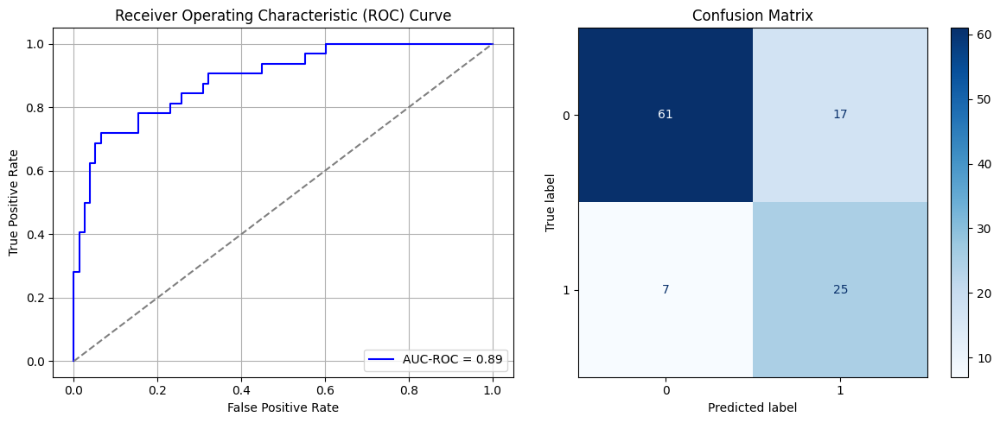

Best threshold based on F1-score: 0.8144082427024841
False Negative Rate: 0.21875
Time elapsed (performance): 0.48782643400045345
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7168 - loss: 0.6365 - val_AUC: 0.8678 - val_loss: 0.4940
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8734 - loss: 0.4609 - val_AUC: 0.8883 - val_loss: 0.4545
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8934 - loss: 0.4097 - val_AUC: 0.8949 - val_loss: 0.4214
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8940 - loss: 0.3988 - val_AUC: 0.8997 - val_loss: 0.4123
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9155 - loss: 0.3592 - val_AUC: 0.9001 - val_loss: 0.4162
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9126 - loss: 0.3663 - val_AUC: 0.9023 - val_loss: 0.4072
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9186 - loss: 0.3554 - val_AUC: 0.9018 - val_loss: 0.4053
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9173 - loss: 0.3516 - val_AUC: 0.9040 - val_loss: 0.4105
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9122 - loss: 0.3658 - va

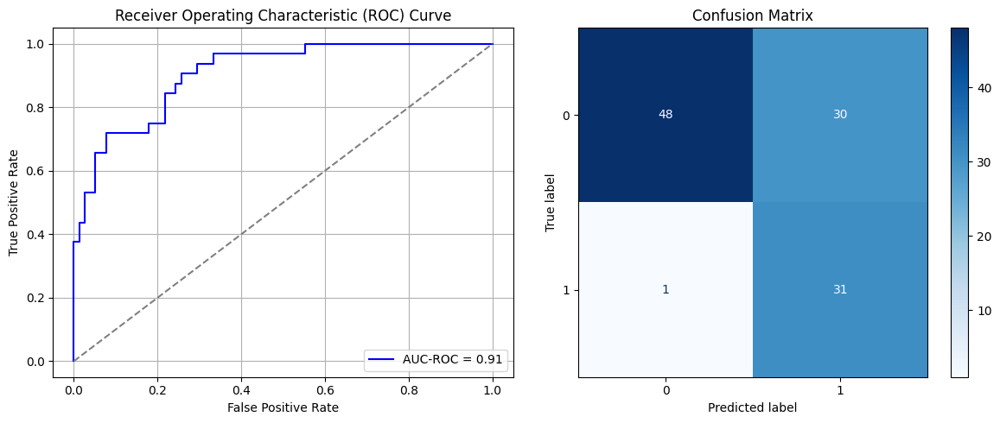

Best threshold based on F1-score: 0.8869653940200806
False Negative Rate: 0.03125
Time elapsed (performance): 0.46224136799992266
(np.float64(0.38461538461538464), np.float64(0.6153846153846154))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.6330 - loss: 0.6566 - val_AUC: 0.8522 - val_loss: 0.5202
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8764 - loss: 0.4669 - val_AUC: 0.8856 - val_loss: 0.4384
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8918 - loss: 0.4072 - val_AUC: 0.8964 - val_loss: 0.4228
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9027 - loss: 0.3849 - val_AUC: 0.9004 - val_loss: 0.4063
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9026 - loss: 0.3823 - val_AUC: 0.9008 - val_loss: 0.4188
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9141 - loss: 0.3616 - val_AUC: 0.9035 - val_loss: 0.4019
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9092 - loss: 0.3672 - val_AUC: 0.9050 - val_loss: 0.4065
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9111 - loss: 0.3649 - val_AUC: 0.9059 - val_loss: 0.4172
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9269 - loss: 0.3347 - va

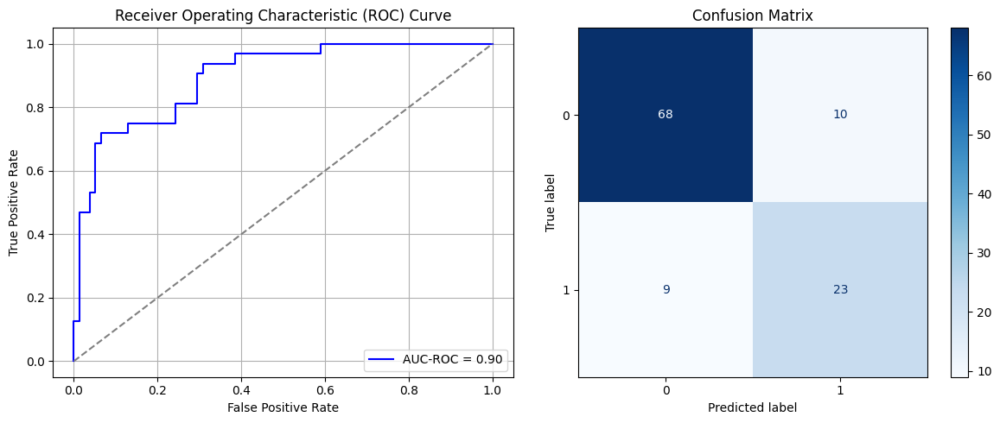

Best threshold based on F1-score: 0.6751812100410461
False Negative Rate: 0.28125
Time elapsed (performance): 0.48264121300053375
(np.float64(0.1282051282051282), np.float64(0.8717948717948718))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7455 - loss: 0.6356 - val_AUC: 0.8554 - val_loss: 0.5127
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8564 - loss: 0.4869 - val_AUC: 0.8786 - val_loss: 0.4420
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8702 - loss: 0.4407 - val_AUC: 0.8946 - val_loss: 0.4201
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8895 - loss: 0.4091 - val_AUC: 0.8979 - val_loss: 0.4225
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9108 - loss: 0.3709 - val_AUC: 0.9010 - val_loss: 0.4095
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9136 - loss: 0.3642 - val_AUC: 0.9034 - val_loss: 0.4043
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9140 - loss: 0.3620 - val_AUC: 0.9027 - val_loss: 0.4070
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9196 - loss: 0.3480 - val_AUC: 0.9028 - val_loss: 0.4161
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9218 - loss: 0.3427 - va

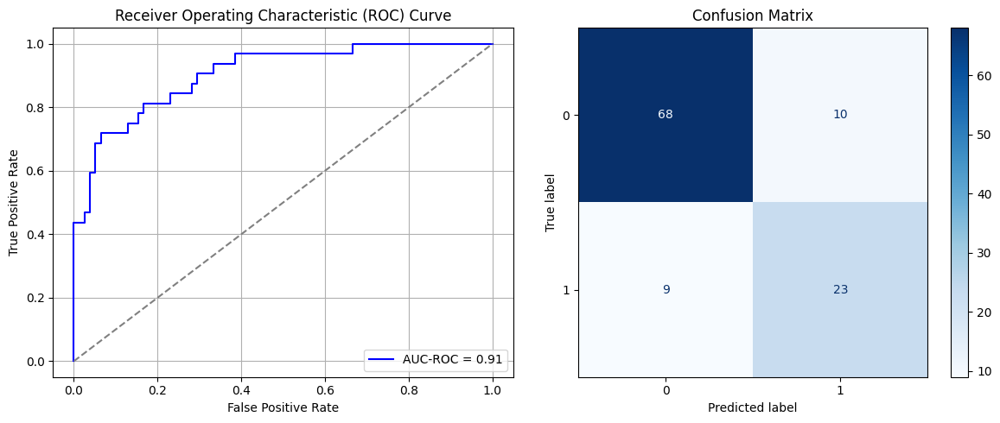

Best threshold based on F1-score: 0.666601300239563
False Negative Rate: 0.28125
Time elapsed (performance): 0.4738593000001856
(np.float64(0.1282051282051282), np.float64(0.8717948717948718))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6832 - loss: 0.6532 - val_AUC: 0.8462 - val_loss: 0.5287
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8789 - loss: 0.4766 - val_AUC: 0.8807 - val_loss: 0.4393
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9056 - loss: 0.3877 - val_AUC: 0.8932 - val_loss: 0.4171
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8998 - loss: 0.3879 - val_AUC: 0.8950 - val_loss: 0.4140
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9090 - loss: 0.3696 - val_AUC: 0.8981 - val_loss: 0.4193
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9103 - loss: 0.3573 - val_AUC: 0.9019 - val_loss: 0.4058
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9207 - loss: 0.3448 - val_AUC: 0.9038 - val_loss: 0.4017
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9238 - loss: 0.3346 - val_AUC: 0.9041 - val_loss: 0.4117
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9282 - loss: 0.3346 - va

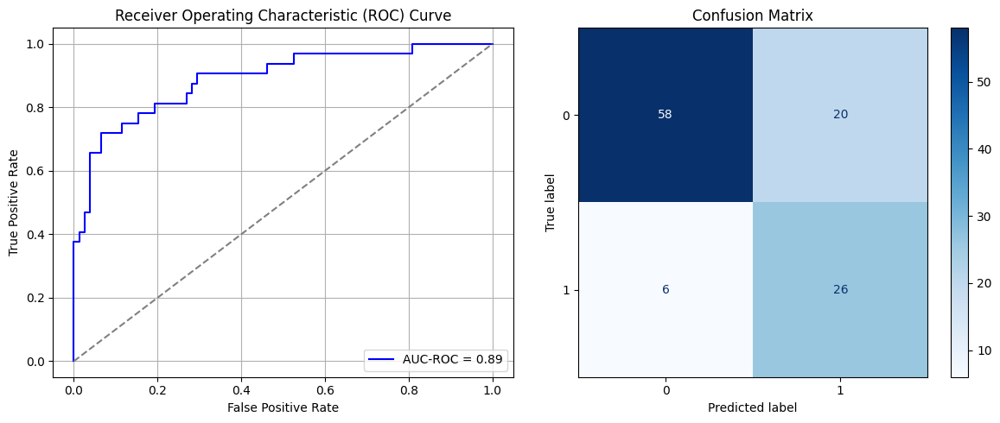

Best threshold based on F1-score: 0.8305854797363281
False Negative Rate: 0.1875
Time elapsed (performance): 0.4791048260003663
(np.float64(0.2564102564102564), np.float64(0.7435897435897436))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7194 - loss: 0.6700 - val_AUC: 0.8576 - val_loss: 0.5590
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8722 - loss: 0.5101 - val_AUC: 0.8819 - val_loss: 0.4452
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8968 - loss: 0.4131 - val_AUC: 0.8934 - val_loss: 0.4180
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8993 - loss: 0.3969 - val_AUC: 0.8976 - val_loss: 0.4175
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9072 - loss: 0.3803 - val_AUC: 0.9003 - val_loss: 0.4022
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9058 - loss: 0.3748 - val_AUC: 0.9021 - val_loss: 0.3995
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9254 - loss: 0.3426 - val_AUC: 0.9046 - val_loss: 0.3956
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9194 - loss: 0.3521 - val_AUC: 0.9050 - val_loss: 0.3947
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9238 - loss: 0.3402 - va

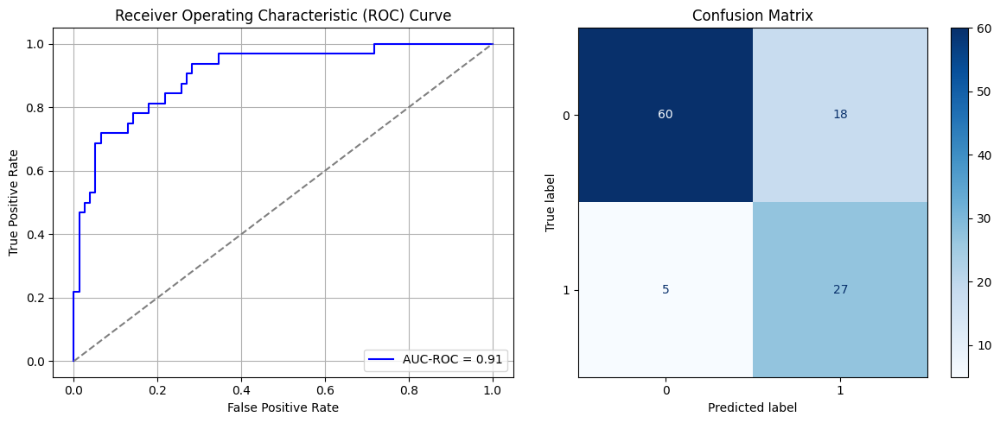

Best threshold based on F1-score: 0.8270677924156189
False Negative Rate: 0.15625
Time elapsed (performance): 0.44741796999915096
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6593 - loss: 0.6687 - val_AUC: 0.8508 - val_loss: 0.5511
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8664 - loss: 0.5057 - val_AUC: 0.8927 - val_loss: 0.4304
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8836 - loss: 0.4285 - val_AUC: 0.9089 - val_loss: 0.3887
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8912 - loss: 0.4115 - val_AUC: 0.9144 - val_loss: 0.3734
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9020 - loss: 0.3890 - val_AUC: 0.9170 - val_loss: 0.3696
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8929 - loss: 0.4023 - val_AUC: 0.9190 - val_loss: 0.3640
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9083 - loss: 0.3719 - val_AUC: 0.9210 - val_loss: 0.3633
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9068 - loss: 0.3785 - val_AUC: 0.9222 - val_loss: 0.3770
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9005 - loss: 0.3977 - va

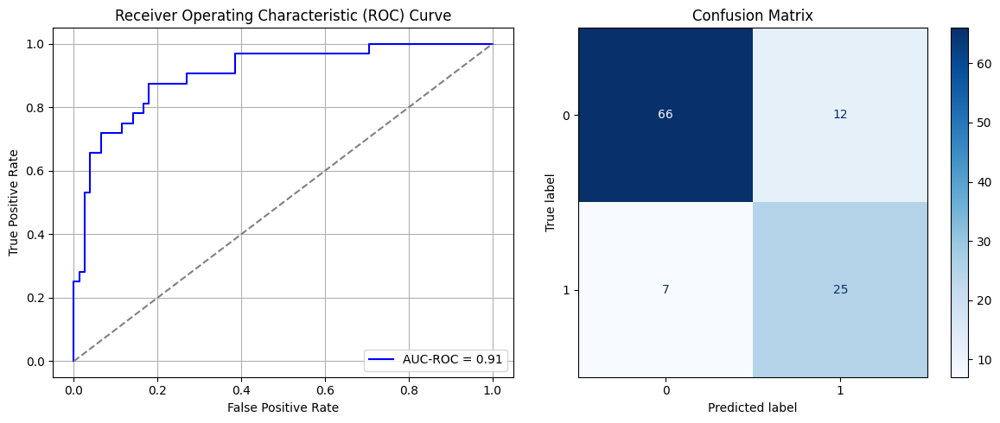

Best threshold based on F1-score: 0.7455009818077087
False Negative Rate: 0.21875
Time elapsed (performance): 0.4482118089999858
(np.float64(0.15384615384615385), np.float64(0.8461538461538461))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6759 - loss: 0.6589 - val_AUC: 0.8702 - val_loss: 0.5236
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8649 - loss: 0.4928 - val_AUC: 0.8885 - val_loss: 0.4334
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8847 - loss: 0.4171 - val_AUC: 0.8990 - val_loss: 0.4095
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8884 - loss: 0.4143 - val_AUC: 0.9033 - val_loss: 0.4013
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9159 - loss: 0.3663 - val_AUC: 0.9055 - val_loss: 0.3975
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9110 - loss: 0.3670 - val_AUC: 0.9049 - val_loss: 0.3995
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9137 - loss: 0.3575 - val_AUC: 0.9067 - val_loss: 0.3972
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9304 - loss: 0.3287 - val_AUC: 0.9070 - val_loss: 0.3943
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9147 - loss: 0.3556 - va

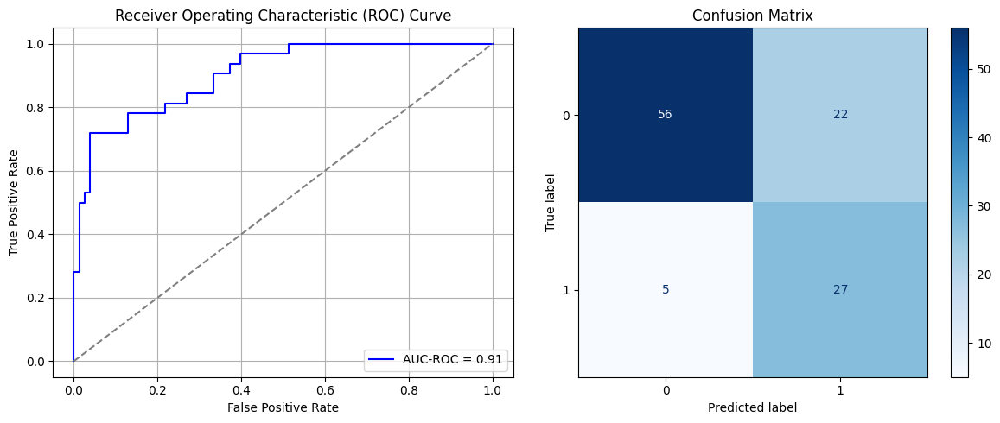

Best threshold based on F1-score: 0.9321618676185608
False Negative Rate: 0.15625
Time elapsed (performance): 0.44315131699931953
(np.float64(0.28205128205128205), np.float64(0.717948717948718))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7566 - loss: 0.6359 - val_AUC: 0.8400 - val_loss: 0.5205
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8577 - loss: 0.4833 - val_AUC: 0.8819 - val_loss: 0.4420
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8721 - loss: 0.4355 - val_AUC: 0.8955 - val_loss: 0.4148
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - AUC: 0.8980 - loss: 0.3980 - val_AUC: 0.8993 - val_loss: 0.4029
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - AUC: 0.9050 - loss: 0.3887 - val_AUC: 0.9082 - val_loss: 0.3822
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9026 - loss: 0.3830 - val_AUC: 0.9098 - val_loss: 0.3784
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9052 - loss: 0.3853 - val_AUC: 0.9137 - val_loss: 0.3717
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9124 - loss: 0.3674 - val_AUC: 0.9162 - val_loss: 0.3635
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9104 - loss: 0.3775 -

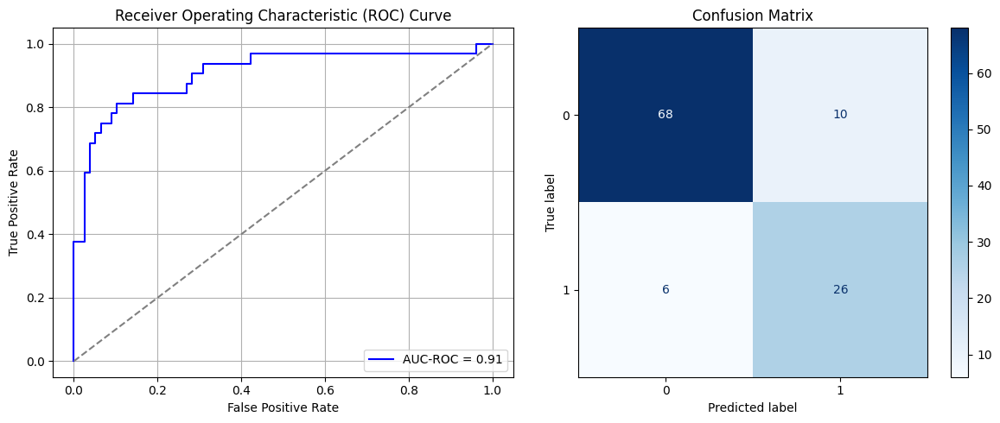

Best threshold based on F1-score: 0.5305217504501343
False Negative Rate: 0.1875
Time elapsed (performance): 0.47093391900034476
(np.float64(0.1282051282051282), np.float64(0.8717948717948718))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - AUC: 0.7057 - loss: 0.6457 - val_AUC: 0.8490 - val_loss: 0.5247
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8559 - loss: 0.4965 - val_AUC: 0.8789 - val_loss: 0.4487
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8805 - loss: 0.4298 - val_AUC: 0.8922 - val_loss: 0.4189
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8990 - loss: 0.3944 - val_AUC: 0.8966 - val_loss: 0.4154
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9075 - loss: 0.3822 - val_AUC: 0.9003 - val_loss: 0.4046
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9175 - loss: 0.3566 - val_AUC: 0.9030 - val_loss: 0.3981
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9164 - loss: 0.3632 - val_AUC: 0.9026 - val_loss: 0.4005
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9181 - loss: 0.3567 - val_AUC: 0.9044 - val_loss: 0.3938
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9186 - loss: 0.3564 - v

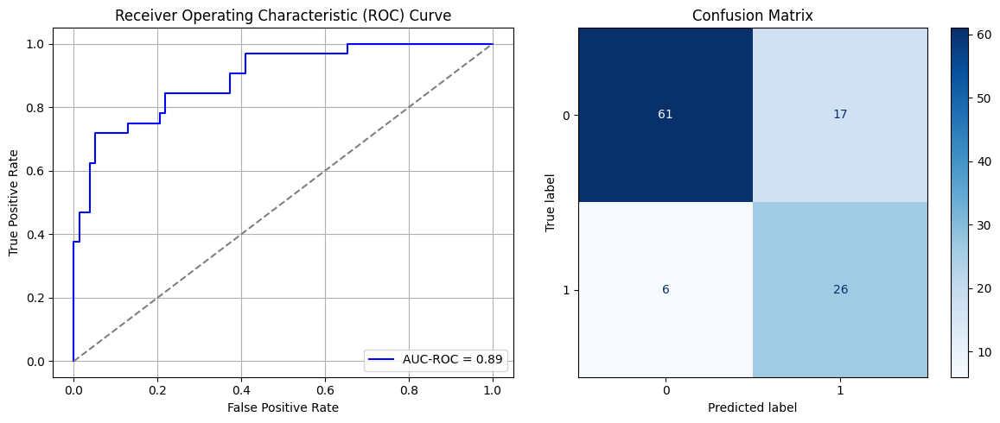

Best threshold based on F1-score: 0.8562344312667847
False Negative Rate: 0.1875
Time elapsed (performance): 0.4615512399996078
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - AUC: 0.6946 - loss: 0.6534 - val_AUC: 0.8438 - val_loss: 0.5278
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8607 - loss: 0.4872 - val_AUC: 0.8839 - val_loss: 0.4371
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8932 - loss: 0.4067 - val_AUC: 0.8973 - val_loss: 0.4126
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9051 - loss: 0.3780 - val_AUC: 0.9008 - val_loss: 0.4069
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9032 - loss: 0.3814 - val_AUC: 0.9037 - val_loss: 0.4027
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9058 - loss: 0.3763 - val_AUC: 0.9067 - val_loss: 0.3992
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9169 - loss: 0.3502 - val_AUC: 0.9076 - val_loss: 0.3968
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9213 - loss: 0.3437 - val_AUC: 0.9082 - val_loss: 0.3975
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9172 - loss: 0.3573 - v

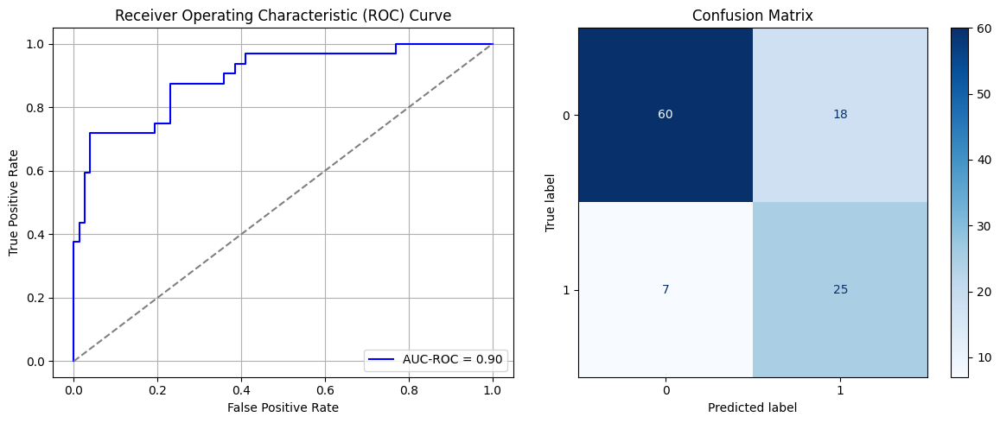

Best threshold based on F1-score: 0.8829952478408813
False Negative Rate: 0.21875
Time elapsed (performance): 0.486999384000228
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6788 - loss: 0.6533 - val_AUC: 0.8705 - val_loss: 0.5105
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8569 - loss: 0.4871 - val_AUC: 0.8947 - val_loss: 0.4170
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8899 - loss: 0.4160 - val_AUC: 0.9072 - val_loss: 0.4036
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8889 - loss: 0.4171 - val_AUC: 0.9102 - val_loss: 0.4061
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8773 - loss: 0.4380 - val_AUC: 0.9141 - val_loss: 0.3689
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9082 - loss: 0.3823 - val_AUC: 0.9190 - val_loss: 0.3658
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9008 - loss: 0.3955 - val_AUC: 0.9205 - val_loss: 0.3595
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9109 - loss: 0.3756 - val_AUC: 0.9222 - val_loss: 0.3535
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9081 - loss: 0.3758 - v

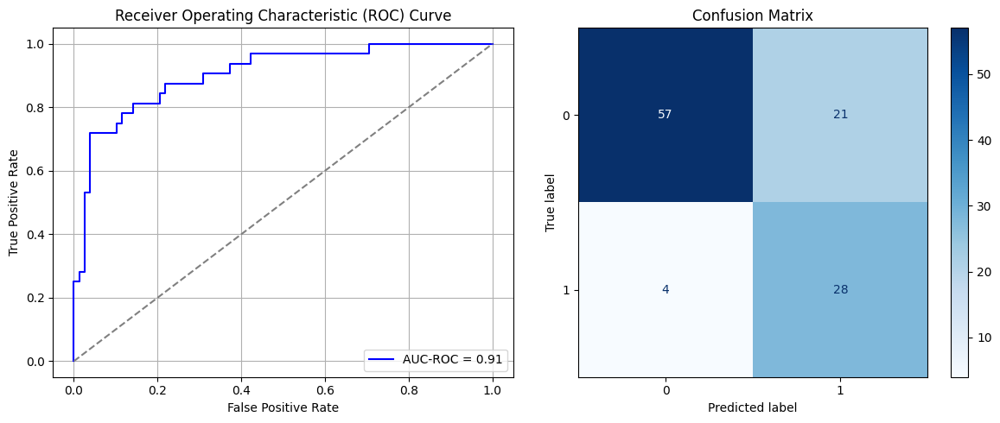

Best threshold based on F1-score: 0.8798808455467224
False Negative Rate: 0.125
Time elapsed (performance): 0.4701254890005657
(np.float64(0.2692307692307692), np.float64(0.7307692307692308))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.6038 - loss: 0.6742 - val_AUC: 0.8585 - val_loss: 0.5463
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8792 - loss: 0.4950 - val_AUC: 0.8836 - val_loss: 0.4453
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8827 - loss: 0.4301 - val_AUC: 0.8941 - val_loss: 0.4176
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9000 - loss: 0.3946 - val_AUC: 0.8986 - val_loss: 0.4077
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9105 - loss: 0.3719 - val_AUC: 0.9017 - val_loss: 0.4027
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9011 - loss: 0.3818 - val_AUC: 0.9029 - val_loss: 0.4211
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9180 - loss: 0.3605 - val_AUC: 0.9020 - val_loss: 0.4120
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9108 - loss: 0.3569 - val_AUC: 0.9031 - val_loss: 0.3990
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9128 - loss: 0.3639 - v

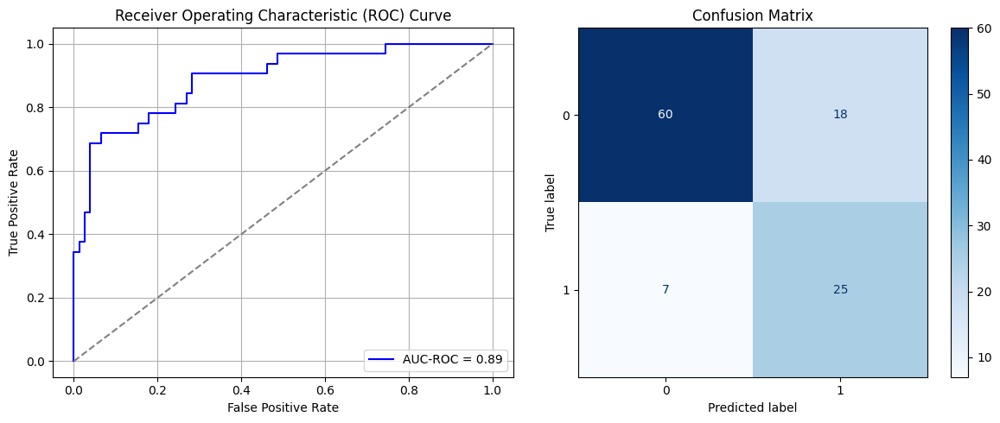

Best threshold based on F1-score: 0.9054633378982544
False Negative Rate: 0.21875
Time elapsed (performance): 0.4843477290005467
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6048 - loss: 0.6747 - val_AUC: 0.8561 - val_loss: 0.5448
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8481 - loss: 0.5202 - val_AUC: 0.8864 - val_loss: 0.4376
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8834 - loss: 0.4317 - val_AUC: 0.9012 - val_loss: 0.3999
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8858 - loss: 0.4237 - val_AUC: 0.9078 - val_loss: 0.3930
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9007 - loss: 0.3949 - val_AUC: 0.9127 - val_loss: 0.3735
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9044 - loss: 0.3840 - val_AUC: 0.9168 - val_loss: 0.3658
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9022 - loss: 0.3808 - val_AUC: 0.9192 - val_loss: 0.3725
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8939 - loss: 0.4001 - val_AUC: 0.9201 - val_loss: 0.3560
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9127 - loss: 0.3656 - va

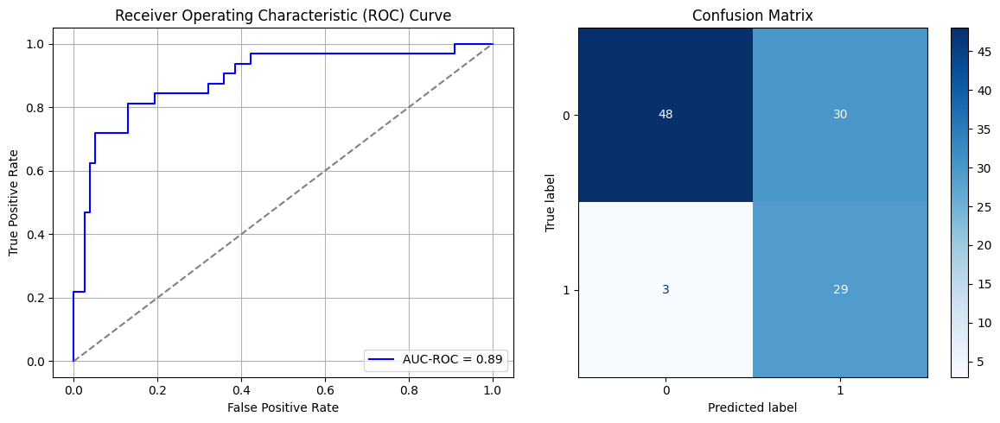

Best threshold based on F1-score: 0.9330981969833374
False Negative Rate: 0.09375
Time elapsed (performance): 0.46940827799971885
(np.float64(0.38461538461538464), np.float64(0.6153846153846154))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - AUC: 0.7421 - loss: 0.6386 - val_AUC: 0.8650 - val_loss: 0.5018
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8658 - loss: 0.4713 - val_AUC: 0.8882 - val_loss: 0.4274
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.9109 - loss: 0.3803 - val_AUC: 0.8971 - val_loss: 0.4223
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8992 - loss: 0.3888 - val_AUC: 0.8996 - val_loss: 0.4044
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9029 - loss: 0.3783 - val_AUC: 0.9010 - val_loss: 0.4067
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9070 - loss: 0.3674 - val_AUC: 0.9026 - val_loss: 0.4005
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9138 - loss: 0.3642 - val_AUC: 0.9046 - val_loss: 0.3974
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9243 - loss: 0.3440 - val_AUC: 0.9066 - val_loss: 0.4053
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9180 - loss: 0.3532 - v

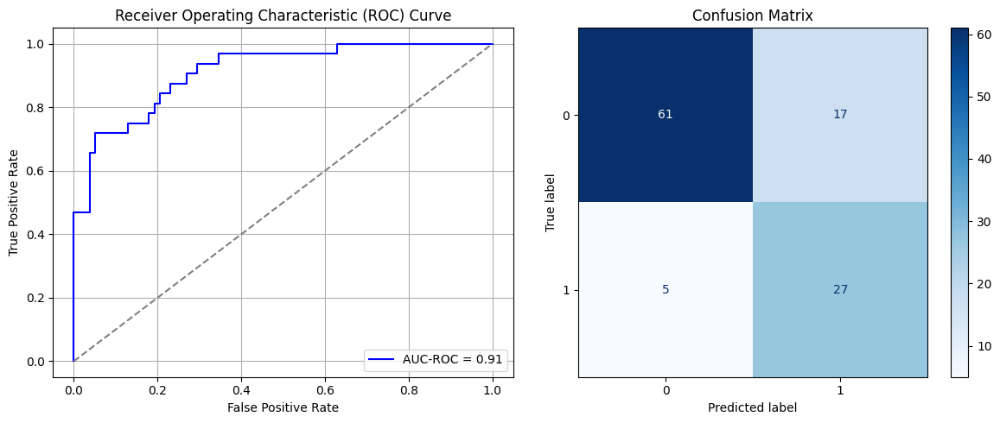

Best threshold based on F1-score: 0.820050060749054
False Negative Rate: 0.15625
Time elapsed (performance): 0.5015105239999684
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.5464 - loss: 0.6885 - val_AUC: 0.8420 - val_loss: 0.5595
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8542 - loss: 0.5190 - val_AUC: 0.8808 - val_loss: 0.4428
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8928 - loss: 0.4154 - val_AUC: 0.8948 - val_loss: 0.4227
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8908 - loss: 0.4032 - val_AUC: 0.8978 - val_loss: 0.4354
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9005 - loss: 0.3876 - val_AUC: 0.9002 - val_loss: 0.4046
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9136 - loss: 0.3704 - val_AUC: 0.9012 - val_loss: 0.4112
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9085 - loss: 0.3689 - val_AUC: 0.9035 - val_loss: 0.4019
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9148 - loss: 0.3569 - val_AUC: 0.9032 - val_loss: 0.4024
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9173 - loss: 0.3602 - va

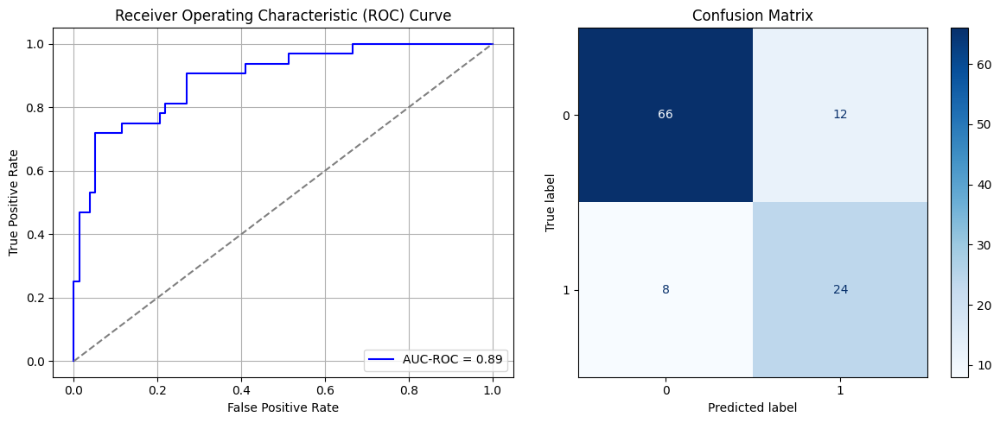

Best threshold based on F1-score: 0.718529462814331
False Negative Rate: 0.25
Time elapsed (performance): 0.48639655700026196
(np.float64(0.15384615384615385), np.float64(0.8461538461538461))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - AUC: 0.8186 - loss: 0.6144 - val_AUC: 0.8912 - val_loss: 0.4963
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8726 - loss: 0.4720 - val_AUC: 0.9026 - val_loss: 0.4129
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8952 - loss: 0.4132 - val_AUC: 0.9093 - val_loss: 0.3996
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8864 - loss: 0.4221 - val_AUC: 0.9117 - val_loss: 0.3793
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9028 - loss: 0.3860 - val_AUC: 0.9126 - val_loss: 0.3760
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8989 - loss: 0.3916 - val_AUC: 0.9171 - val_loss: 0.3678
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9128 - loss: 0.3761 - val_AUC: 0.9175 - val_loss: 0.3614
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9116 - loss: 0.3758 - val_AUC: 0.9205 - val_loss: 0.3546
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9165 - loss: 0.3594 - v

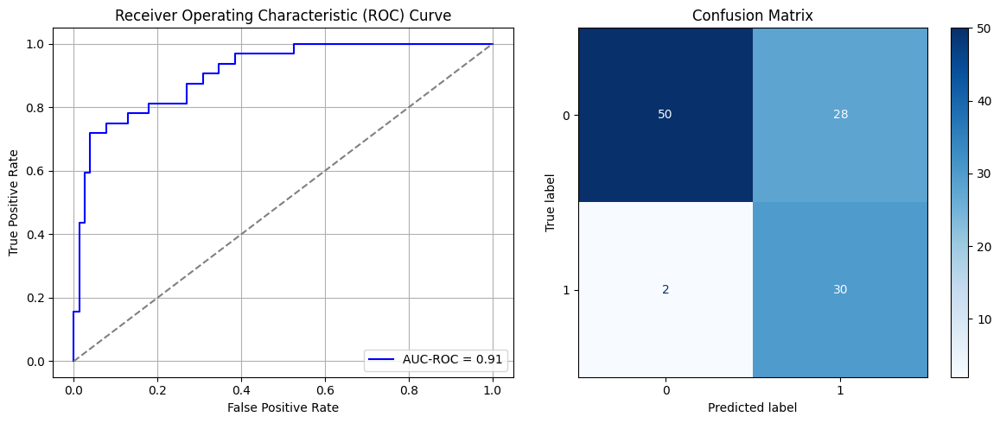

Best threshold based on F1-score: 0.9055792093276978
False Negative Rate: 0.0625
Time elapsed (performance): 0.46879657299996325
(np.float64(0.358974358974359), np.float64(0.641025641025641))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - AUC: 0.6896 - loss: 0.6520 - val_AUC: 0.8628 - val_loss: 0.5112
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8797 - loss: 0.4693 - val_AUC: 0.8795 - val_loss: 0.4532
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8929 - loss: 0.4185 - val_AUC: 0.8922 - val_loss: 0.4255
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9058 - loss: 0.3809 - val_AUC: 0.8969 - val_loss: 0.4209
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9078 - loss: 0.3725 - val_AUC: 0.8993 - val_loss: 0.4110
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9123 - loss: 0.3633 - val_AUC: 0.9011 - val_loss: 0.4094
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9164 - loss: 0.3525 - val_AUC: 0.9030 - val_loss: 0.4040
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9242 - loss: 0.3404 - val_AUC: 0.9034 - val_loss: 0.4117
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9194 - loss: 0.3504 - v

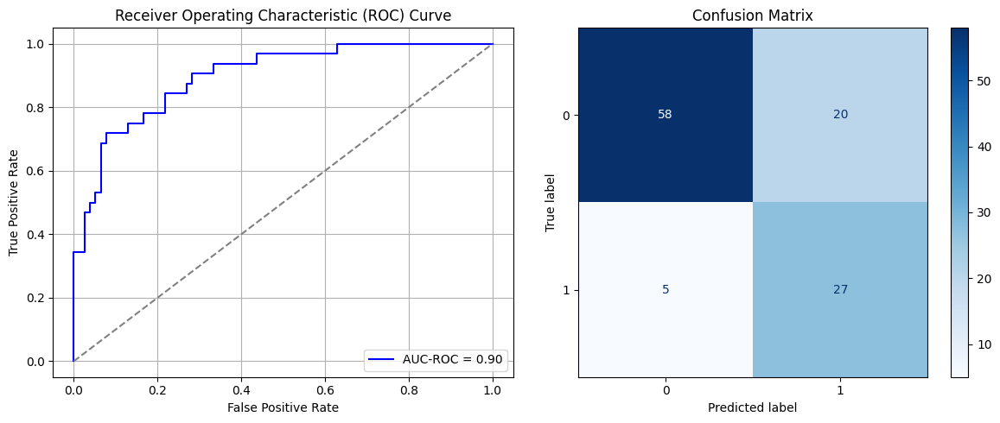

Best threshold based on F1-score: 0.7450950145721436
False Negative Rate: 0.15625
Time elapsed (performance): 0.5146972189995722
(np.float64(0.2564102564102564), np.float64(0.7435897435897436))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - AUC: 0.6837 - loss: 0.6462 - val_AUC: 0.8623 - val_loss: 0.4909
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8846 - loss: 0.4488 - val_AUC: 0.8894 - val_loss: 0.4302
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9074 - loss: 0.3880 - val_AUC: 0.8986 - val_loss: 0.4073
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9085 - loss: 0.3770 - val_AUC: 0.9010 - val_loss: 0.4140
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9129 - loss: 0.3675 - val_AUC: 0.9046 - val_loss: 0.3960
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9068 - loss: 0.3802 - val_AUC: 0.9036 - val_loss: 0.3978
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9127 - loss: 0.3664 - val_AUC: 0.9063 - val_loss: 0.3958
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9157 - loss: 0.3618 - val_AUC: 0.9072 - val_loss: 0.4009
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9124 - loss: 0.3675 - v

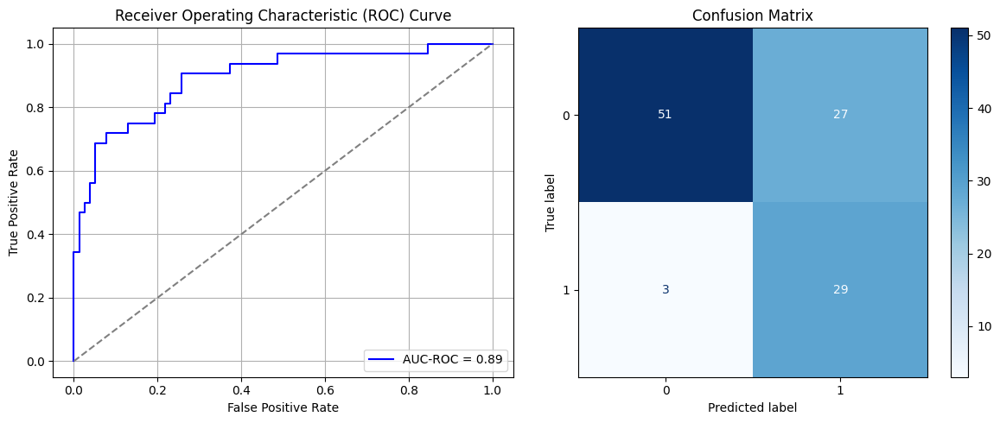

Best threshold based on F1-score: 0.9550173282623291
False Negative Rate: 0.09375
Time elapsed (performance): 0.5239299079994453
(np.float64(0.34615384615384615), np.float64(0.6538461538461539))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - AUC: 0.6397 - loss: 0.6652 - val_AUC: 0.8749 - val_loss: 0.5171
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8701 - loss: 0.4874 - val_AUC: 0.8939 - val_loss: 0.4271
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.8903 - loss: 0.4102 - val_AUC: 0.8996 - val_loss: 0.4101
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9070 - loss: 0.3813 - val_AUC: 0.9007 - val_loss: 0.4064
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9142 - loss: 0.3608 - val_AUC: 0.9023 - val_loss: 0.4039
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9102 - loss: 0.3640 - val_AUC: 0.9049 - val_loss: 0.4056
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9168 - loss: 0.3542 - val_AUC: 0.9003 - val_loss: 0.4243
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9199 - loss: 0.3546 - val_AUC: 0.9040 - val_loss: 0.4131
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9323 - loss: 0.3224 - v

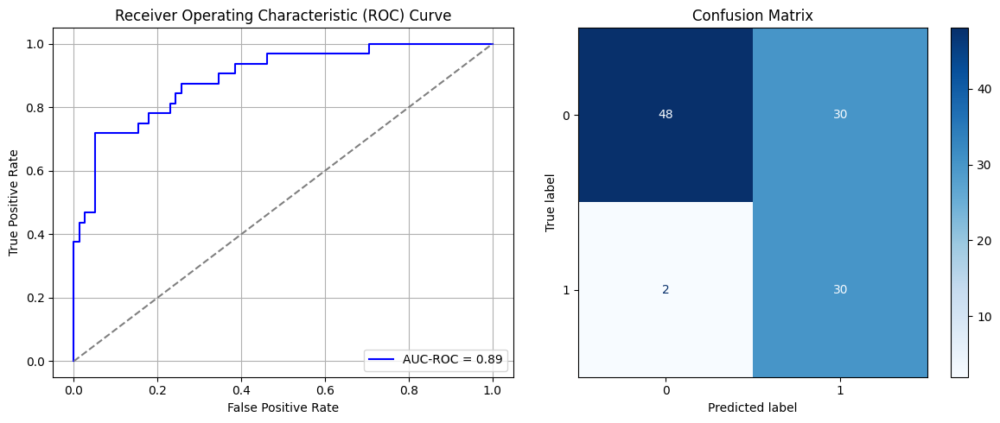

Best threshold based on F1-score: 0.9440343976020813
False Negative Rate: 0.0625
Time elapsed (performance): 0.49087093000071036
(np.float64(0.38461538461538464), np.float64(0.6153846153846154))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7587 - loss: 0.6382 - val_AUC: 0.8535 - val_loss: 0.5155
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8432 - loss: 0.5046 - val_AUC: 0.8918 - val_loss: 0.4294
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9003 - loss: 0.4006 - val_AUC: 0.9059 - val_loss: 0.3959
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8813 - loss: 0.4265 - val_AUC: 0.9095 - val_loss: 0.3809
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8884 - loss: 0.4140 - val_AUC: 0.9151 - val_loss: 0.3701
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9014 - loss: 0.3935 - val_AUC: 0.9168 - val_loss: 0.3658
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9030 - loss: 0.3823 - val_AUC: 0.9210 - val_loss: 0.3582
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9203 - loss: 0.3508 - val_AUC: 0.9209 - val_loss: 0.3565
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9133 - loss: 0.3685 - v

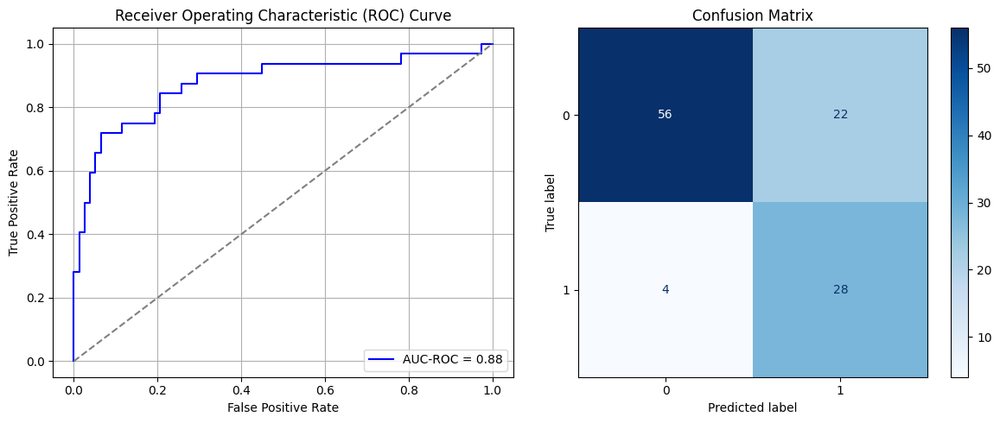

Best threshold based on F1-score: 0.8368095755577087
False Negative Rate: 0.125
Time elapsed (performance): 0.7518337179999435
(np.float64(0.28205128205128205), np.float64(0.717948717948718))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - AUC: 0.6798 - loss: 0.6596 - val_AUC: 0.8635 - val_loss: 0.5199
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8695 - loss: 0.4875 - val_AUC: 0.8902 - val_loss: 0.4349
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8687 - loss: 0.4481 - val_AUC: 0.9020 - val_loss: 0.4005
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8970 - loss: 0.4011 - val_AUC: 0.9103 - val_loss: 0.3828
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8944 - loss: 0.4004 - val_AUC: 0.9125 - val_loss: 0.3769
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9036 - loss: 0.3837 - val_AUC: 0.9151 - val_loss: 0.3757
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9023 - loss: 0.3891 - val_AUC: 0.9183 - val_loss: 0.3637
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9145 - loss: 0.3673 - val_AUC: 0.9192 - val_loss: 0.3690
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9145 - loss: 0.3677 - v

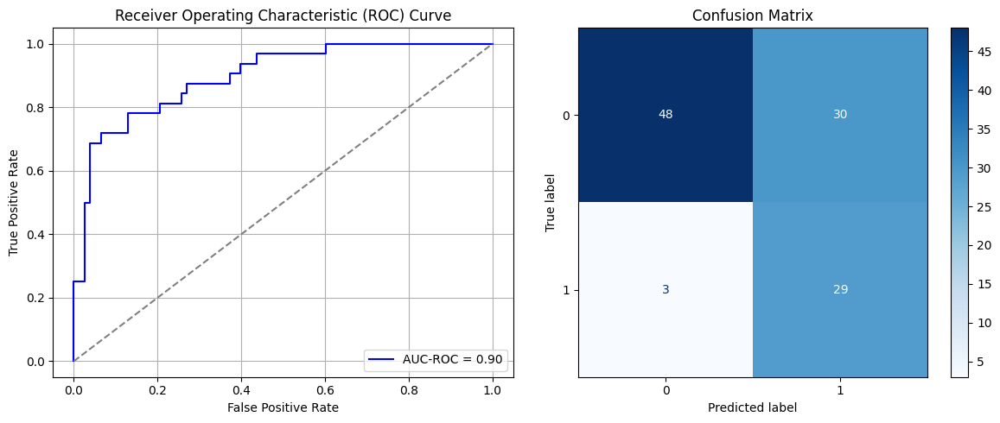

Best threshold based on F1-score: 0.9245523810386658
False Negative Rate: 0.09375
Time elapsed (performance): 0.5121351819998381
(np.float64(0.38461538461538464), np.float64(0.6153846153846154))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6412 - loss: 0.6665 - val_AUC: 0.8650 - val_loss: 0.5221
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8573 - loss: 0.4952 - val_AUC: 0.8930 - val_loss: 0.4174
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8885 - loss: 0.4163 - val_AUC: 0.9035 - val_loss: 0.3999
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8957 - loss: 0.3990 - val_AUC: 0.9118 - val_loss: 0.3921
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8937 - loss: 0.4046 - val_AUC: 0.9139 - val_loss: 0.3701
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9088 - loss: 0.3777 - val_AUC: 0.9165 - val_loss: 0.3641
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9052 - loss: 0.3882 - val_AUC: 0.9173 - val_loss: 0.3815
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9156 - loss: 0.3624 - val_AUC: 0.9200 - val_loss: 0.3576
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9138 - loss: 0.3612 - va

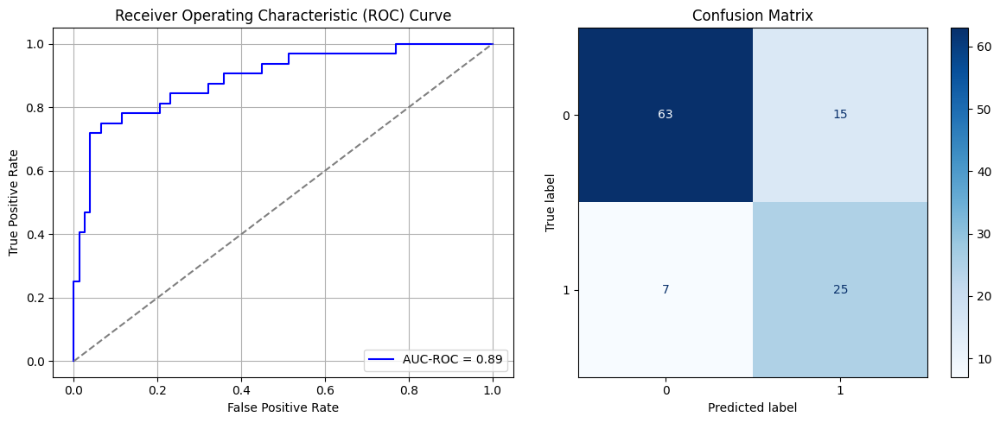

Best threshold based on F1-score: 0.8143379092216492
False Negative Rate: 0.21875
Time elapsed (performance): 0.5063743099999556
(np.float64(0.19230769230769232), np.float64(0.8076923076923077))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7963 - loss: 0.6263 - val_AUC: 0.8698 - val_loss: 0.4989
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8843 - loss: 0.4499 - val_AUC: 0.8903 - val_loss: 0.4241
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9020 - loss: 0.3894 - val_AUC: 0.8979 - val_loss: 0.4095
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9088 - loss: 0.3728 - val_AUC: 0.9031 - val_loss: 0.4015
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9034 - loss: 0.3774 - val_AUC: 0.9036 - val_loss: 0.4050
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9135 - loss: 0.3583 - val_AUC: 0.9061 - val_loss: 0.4026
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9119 - loss: 0.3583 - val_AUC: 0.9057 - val_loss: 0.4023
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9193 - loss: 0.3435 - val_AUC: 0.9073 - val_loss: 0.4037
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9224 - loss: 0.3447 - v

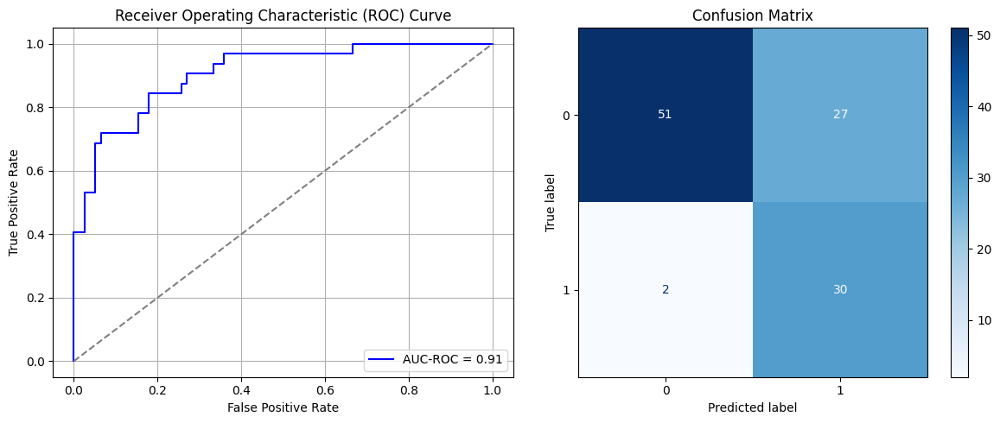

Best threshold based on F1-score: 0.9022870659828186
False Negative Rate: 0.0625
Time elapsed (performance): 0.5041424290002396
(np.float64(0.34615384615384615), np.float64(0.6538461538461539))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - AUC: 0.7963 - loss: 0.6207 - val_AUC: 0.8751 - val_loss: 0.4936
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8617 - loss: 0.4829 - val_AUC: 0.8953 - val_loss: 0.4243
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.8845 - loss: 0.4243 - val_AUC: 0.9015 - val_loss: 0.4137
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9010 - loss: 0.3924 - val_AUC: 0.9064 - val_loss: 0.3998
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9084 - loss: 0.3769 - val_AUC: 0.9072 - val_loss: 0.3918
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9192 - loss: 0.3549 - val_AUC: 0.9083 - val_loss: 0.3892
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9144 - loss: 0.3680 - val_AUC: 0.9091 - val_loss: 0.3914
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9129 - loss: 0.3620 - val_AUC: 0.9091 - val_loss: 0.3930
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9195 - loss: 0.3517 - v

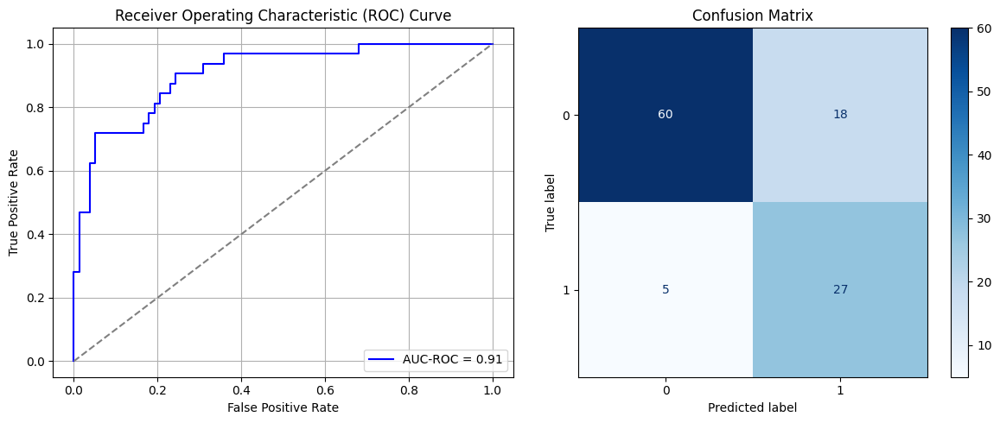

Best threshold based on F1-score: 0.8817134499549866
False Negative Rate: 0.15625
Time elapsed (performance): 0.49578108599962434
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6979 - loss: 0.6573 - val_AUC: 0.8676 - val_loss: 0.5194
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8559 - loss: 0.4957 - val_AUC: 0.8843 - val_loss: 0.4356
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8920 - loss: 0.4151 - val_AUC: 0.8966 - val_loss: 0.4254
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9031 - loss: 0.3881 - val_AUC: 0.9010 - val_loss: 0.4034
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9098 - loss: 0.3749 - val_AUC: 0.9056 - val_loss: 0.4004
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8911 - loss: 0.3995 - val_AUC: 0.9061 - val_loss: 0.3986
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9101 - loss: 0.3704 - val_AUC: 0.9065 - val_loss: 0.3986
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9088 - loss: 0.3700 - val_AUC: 0.9087 - val_loss: 0.3915
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9209 - loss: 0.3408 - v

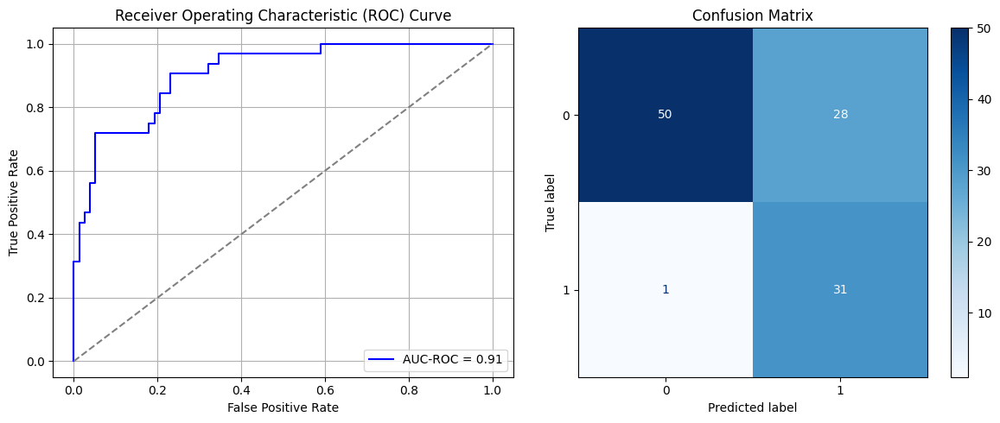

Best threshold based on F1-score: 0.9388737082481384
False Negative Rate: 0.03125
Time elapsed (performance): 0.688808333000452
(np.float64(0.358974358974359), np.float64(0.641025641025641))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6384 - loss: 0.6652 - val_AUC: 0.8592 - val_loss: 0.5316
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8554 - loss: 0.5068 - val_AUC: 0.8847 - val_loss: 0.4458
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8710 - loss: 0.4499 - val_AUC: 0.9007 - val_loss: 0.4053
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8825 - loss: 0.4311 - val_AUC: 0.9080 - val_loss: 0.4010
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8791 - loss: 0.4356 - val_AUC: 0.9130 - val_loss: 0.3793
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8911 - loss: 0.4084 - val_AUC: 0.9175 - val_loss: 0.3665
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8981 - loss: 0.3949 - val_AUC: 0.9199 - val_loss: 0.3616
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8961 - loss: 0.3936 - val_AUC: 0.9219 - val_loss: 0.3590
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9047 - loss: 0.3848 - v

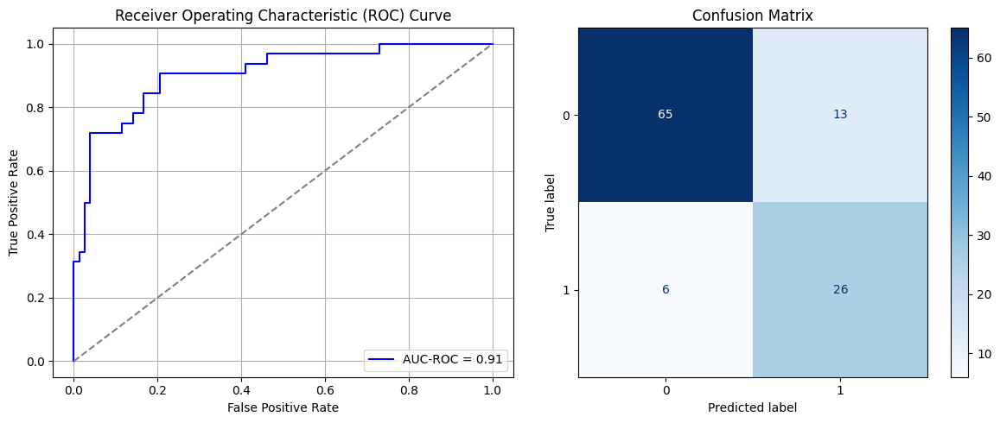

Best threshold based on F1-score: 0.8216983079910278
False Negative Rate: 0.1875
Time elapsed (performance): 0.5092627439998978
(np.float64(0.16666666666666666), np.float64(0.8333333333333334))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6831 - loss: 0.6531 - val_AUC: 0.8692 - val_loss: 0.5069
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8757 - loss: 0.4724 - val_AUC: 0.8889 - val_loss: 0.4278
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8913 - loss: 0.4055 - val_AUC: 0.8978 - val_loss: 0.4103
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8918 - loss: 0.4035 - val_AUC: 0.9005 - val_loss: 0.4033
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9118 - loss: 0.3646 - val_AUC: 0.9030 - val_loss: 0.4022
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9235 - loss: 0.3474 - val_AUC: 0.9045 - val_loss: 0.4031
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9189 - loss: 0.3545 - val_AUC: 0.9054 - val_loss: 0.3948
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9283 - loss: 0.3357 - val_AUC: 0.9062 - val_loss: 0.3937
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9285 - loss: 0.3262 - v

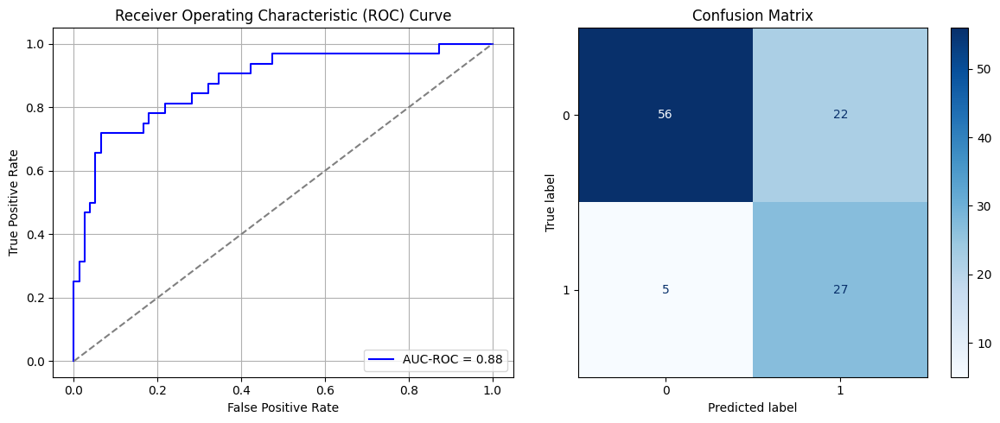

Best threshold based on F1-score: 0.9135327935218811
False Negative Rate: 0.15625
Time elapsed (performance): 0.4880588030000581
(np.float64(0.28205128205128205), np.float64(0.717948717948718))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7076 - loss: 0.6509 - val_AUC: 0.8710 - val_loss: 0.5084
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8676 - loss: 0.4832 - val_AUC: 0.9005 - val_loss: 0.4145
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8873 - loss: 0.4187 - val_AUC: 0.9088 - val_loss: 0.3898
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8936 - loss: 0.4089 - val_AUC: 0.9153 - val_loss: 0.3713
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8964 - loss: 0.4008 - val_AUC: 0.9161 - val_loss: 0.3708
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9046 - loss: 0.3832 - val_AUC: 0.9188 - val_loss: 0.3609
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9114 - loss: 0.3720 - val_AUC: 0.9188 - val_loss: 0.3579
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9114 - loss: 0.3717 - val_AUC: 0.9188 - val_loss: 0.4079
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9180 - loss: 0.3551 - v

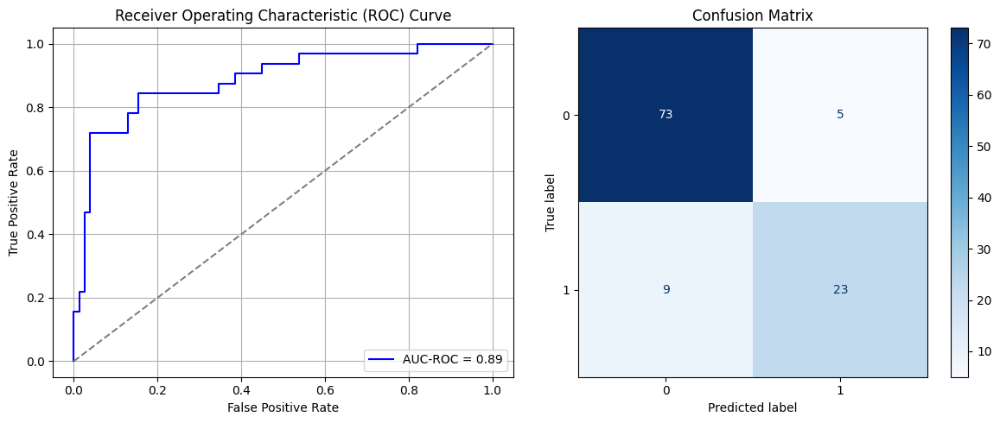

Best threshold based on F1-score: 0.5651233196258545
False Negative Rate: 0.28125
Time elapsed (performance): 0.4894991739993202
(np.float64(0.0641025641025641), np.float64(0.9358974358974359))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - AUC: 0.7804 - loss: 0.6299 - val_AUC: 0.8561 - val_loss: 0.5223
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8519 - loss: 0.5010 - val_AUC: 0.8772 - val_loss: 0.4495
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8741 - loss: 0.4421 - val_AUC: 0.8880 - val_loss: 0.4298
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9074 - loss: 0.3730 - val_AUC: 0.8952 - val_loss: 0.4155
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9044 - loss: 0.3791 - val_AUC: 0.8998 - val_loss: 0.4137
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9029 - loss: 0.3840 - val_AUC: 0.9025 - val_loss: 0.4127
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9090 - loss: 0.3671 - val_AUC: 0.9039 - val_loss: 0.4019
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9125 - loss: 0.3568 - val_AUC: 0.9057 - val_loss: 0.4283
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9139 - loss: 0.3617 - v

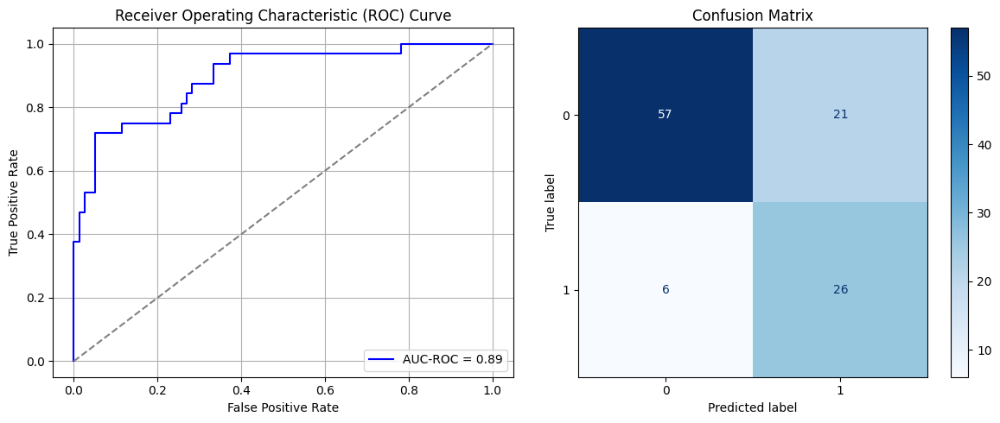

Best threshold based on F1-score: 0.8882225155830383
False Negative Rate: 0.1875
Time elapsed (performance): 0.512267318999875
(np.float64(0.2692307692307692), np.float64(0.7307692307692308))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6337 - loss: 0.6713 - val_AUC: 0.8568 - val_loss: 0.5530
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8524 - loss: 0.5181 - val_AUC: 0.8862 - val_loss: 0.4441
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8843 - loss: 0.4338 - val_AUC: 0.9005 - val_loss: 0.4109
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8938 - loss: 0.4102 - val_AUC: 0.9099 - val_loss: 0.3888
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9045 - loss: 0.3888 - val_AUC: 0.9131 - val_loss: 0.3756
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8969 - loss: 0.3983 - val_AUC: 0.9142 - val_loss: 0.3694
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8963 - loss: 0.3963 - val_AUC: 0.9181 - val_loss: 0.3626
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8982 - loss: 0.3996 - val_AUC: 0.9168 - val_loss: 0.3625
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9154 - loss: 0.3635 - v

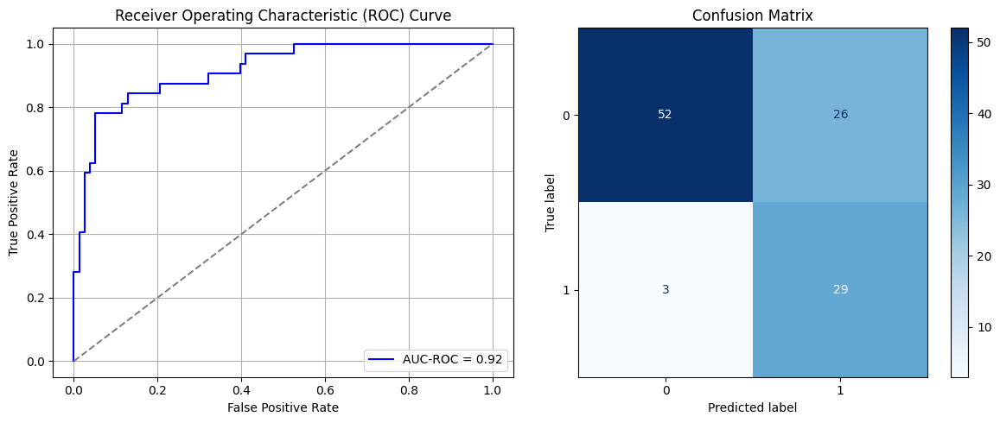

Best threshold based on F1-score: 0.8274030089378357
False Negative Rate: 0.09375
Time elapsed (performance): 0.5508545700004106
(np.float64(0.3333333333333333), np.float64(0.6666666666666667))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - AUC: 0.5611 - loss: 0.6781 - val_AUC: 0.8430 - val_loss: 0.5555
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8642 - loss: 0.5064 - val_AUC: 0.8792 - val_loss: 0.4465
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8972 - loss: 0.4095 - val_AUC: 0.8900 - val_loss: 0.4226
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9082 - loss: 0.3794 - val_AUC: 0.8943 - val_loss: 0.4205
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8925 - loss: 0.4071 - val_AUC: 0.8976 - val_loss: 0.4083
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9135 - loss: 0.3661 - val_AUC: 0.8992 - val_loss: 0.4074
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9109 - loss: 0.3643 - val_AUC: 0.9011 - val_loss: 0.4051
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9093 - loss: 0.3637 - val_AUC: 0.9019 - val_loss: 0.4019
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9124 - loss: 0.3627 - v

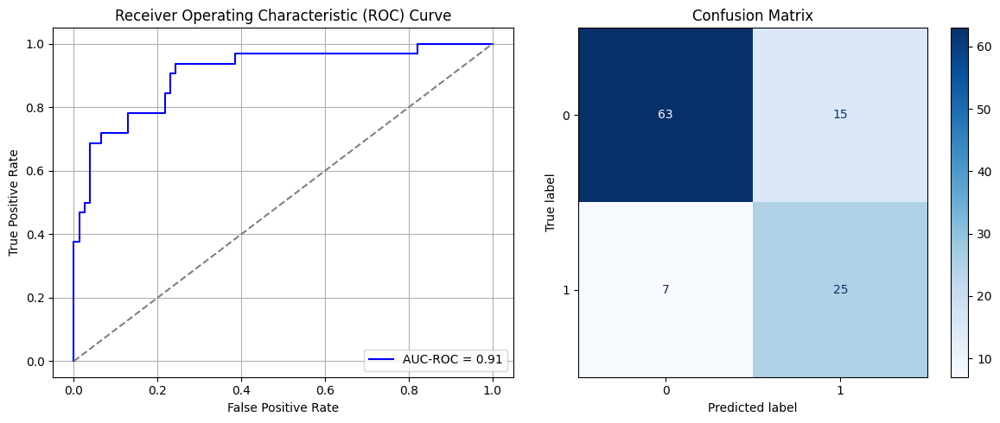

Best threshold based on F1-score: 0.8633494973182678
False Negative Rate: 0.21875
Time elapsed (performance): 0.5121020289998341
(np.float64(0.19230769230769232), np.float64(0.8076923076923077))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7215 - loss: 0.6562 - val_AUC: 0.8511 - val_loss: 0.5312
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8676 - loss: 0.4862 - val_AUC: 0.8833 - val_loss: 0.4472
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8809 - loss: 0.4293 - val_AUC: 0.8924 - val_loss: 0.4166
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9056 - loss: 0.3832 - val_AUC: 0.8975 - val_loss: 0.4100
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8902 - loss: 0.3902 - val_AUC: 0.9003 - val_loss: 0.4060
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9109 - loss: 0.3664 - val_AUC: 0.9021 - val_loss: 0.4050
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.9005 - loss: 0.3735 - val_AUC: 0.9027 - val_loss: 0.4049
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9111 - loss: 0.3667 - val_AUC: 0.9037 - val_loss: 0.4032
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.9235 - loss: 0.3456 - va

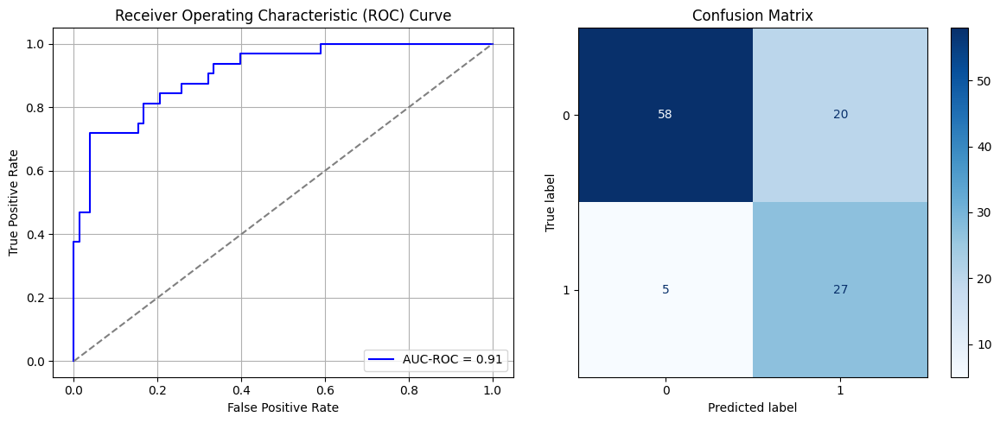

Best threshold based on F1-score: 0.8926753401756287
False Negative Rate: 0.15625
Time elapsed (performance): 0.4873830159995123
(np.float64(0.2564102564102564), np.float64(0.7435897435897436))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6805 - loss: 0.6540 - val_AUC: 0.8668 - val_loss: 0.5227
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8829 - loss: 0.4749 - val_AUC: 0.8958 - val_loss: 0.4251
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8903 - loss: 0.4185 - val_AUC: 0.9047 - val_loss: 0.3993
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8811 - loss: 0.4256 - val_AUC: 0.9109 - val_loss: 0.3839
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9014 - loss: 0.3926 - val_AUC: 0.9155 - val_loss: 0.3717
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9065 - loss: 0.3813 - val_AUC: 0.9170 - val_loss: 0.3755
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9121 - loss: 0.3652 - val_AUC: 0.9169 - val_loss: 0.3776
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9047 - loss: 0.3867 - val_AUC: 0.9200 - val_loss: 0.3569
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9109 - loss: 0.3668 - v

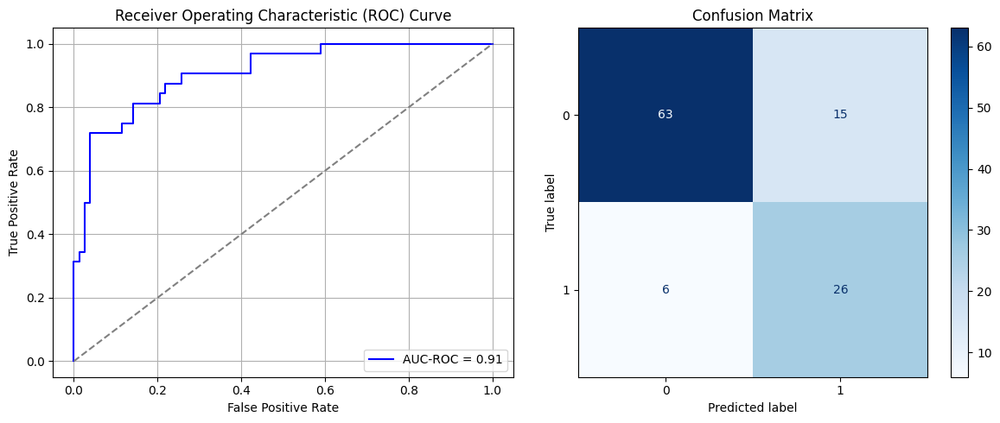

Best threshold based on F1-score: 0.845022439956665
False Negative Rate: 0.1875
Time elapsed (performance): 0.5190059579999797
(np.float64(0.19230769230769232), np.float64(0.8076923076923077))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - AUC: 0.5520 - loss: 0.6812 - val_AUC: 0.8597 - val_loss: 0.5409
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8427 - loss: 0.5187 - val_AUC: 0.8832 - val_loss: 0.4404
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8860 - loss: 0.4227 - val_AUC: 0.8975 - val_loss: 0.4128
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9079 - loss: 0.3793 - val_AUC: 0.9009 - val_loss: 0.4051
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9080 - loss: 0.3751 - val_AUC: 0.9025 - val_loss: 0.4057
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9170 - loss: 0.3564 - val_AUC: 0.9041 - val_loss: 0.4002
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9183 - loss: 0.3509 - val_AUC: 0.9055 - val_loss: 0.3959
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9002 - loss: 0.3877 - val_AUC: 0.9061 - val_loss: 0.3963
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9093 - loss: 0.3665 - v

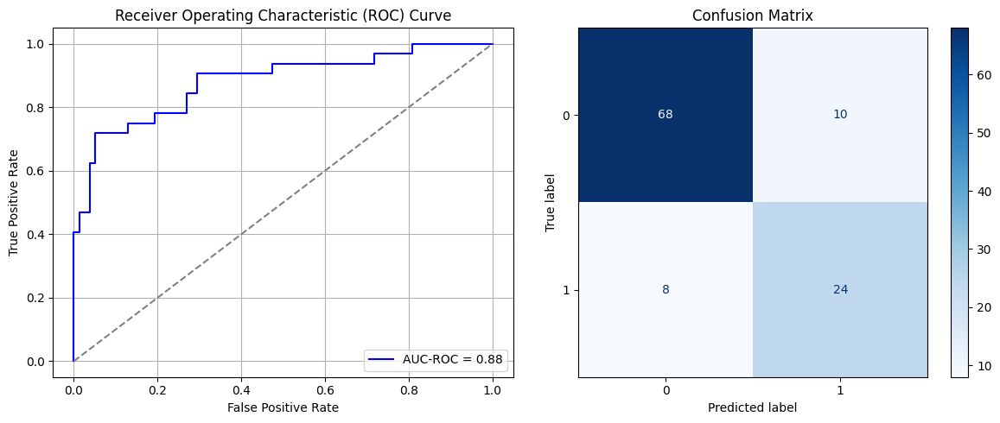

Best threshold based on F1-score: 0.772502064704895
False Negative Rate: 0.25
Time elapsed (performance): 0.5232227300002705
(np.float64(0.1282051282051282), np.float64(0.8717948717948718))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6998 - loss: 0.6508 - val_AUC: 0.8592 - val_loss: 0.5318
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8674 - loss: 0.4779 - val_AUC: 0.8837 - val_loss: 0.4416
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8944 - loss: 0.4004 - val_AUC: 0.8927 - val_loss: 0.4199
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8994 - loss: 0.3917 - val_AUC: 0.8974 - val_loss: 0.4158
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8977 - loss: 0.3923 - val_AUC: 0.8988 - val_loss: 0.4078
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9192 - loss: 0.3543 - val_AUC: 0.9021 - val_loss: 0.4092
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9161 - loss: 0.3558 - val_AUC: 0.9022 - val_loss: 0.4039
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9031 - loss: 0.3760 - val_AUC: 0.9030 - val_loss: 0.4092
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9150 - loss: 0.3594 - v

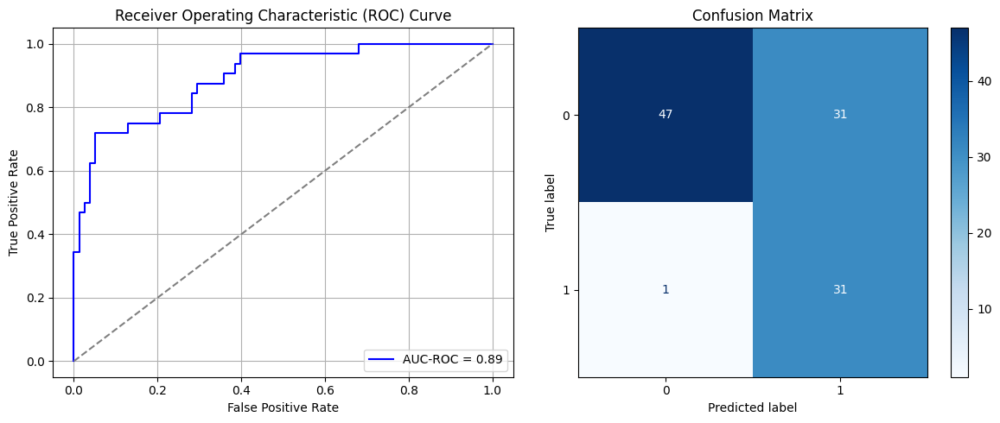

Best threshold based on F1-score: 0.9410315752029419
False Negative Rate: 0.03125
Time elapsed (performance): 0.6931371790005869
(np.float64(0.3974358974358974), np.float64(0.6025641025641026))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - AUC: 0.6566 - loss: 0.6666 - val_AUC: 0.8412 - val_loss: 0.5587
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8430 - loss: 0.5221 - val_AUC: 0.8838 - val_loss: 0.4409
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8818 - loss: 0.4340 - val_AUC: 0.9037 - val_loss: 0.3977
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9048 - loss: 0.3911 - val_AUC: 0.9104 - val_loss: 0.3820
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8976 - loss: 0.3968 - val_AUC: 0.9148 - val_loss: 0.3700
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9011 - loss: 0.3915 - val_AUC: 0.9168 - val_loss: 0.3632
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9141 - loss: 0.3648 - val_AUC: 0.9190 - val_loss: 0.3760
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9049 - loss: 0.3884 - val_AUC: 0.9206 - val_loss: 0.3575
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9134 - loss: 0.3636 - v

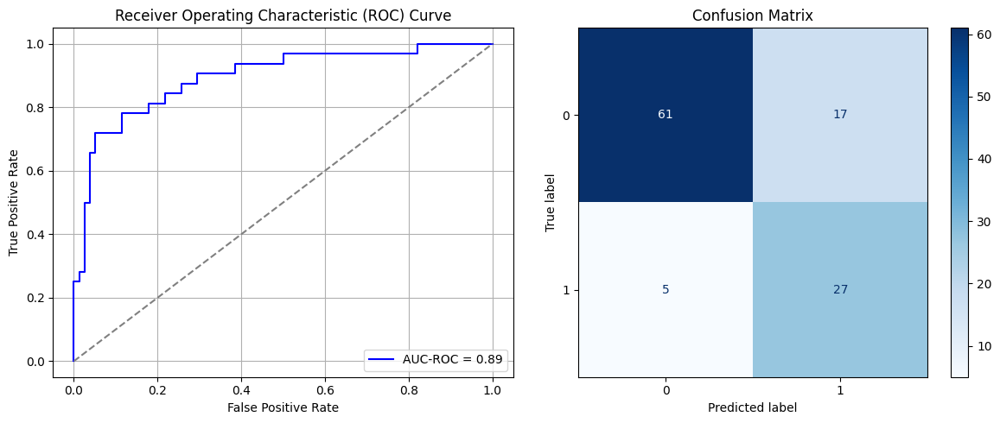

Best threshold based on F1-score: 0.8412819504737854
False Negative Rate: 0.15625
Time elapsed (performance): 0.5110106029997041
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6947 - loss: 0.6508 - val_AUC: 0.8605 - val_loss: 0.5130
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8735 - loss: 0.4737 - val_AUC: 0.8935 - val_loss: 0.4256
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8969 - loss: 0.4066 - val_AUC: 0.9082 - val_loss: 0.3937
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8884 - loss: 0.4142 - val_AUC: 0.9106 - val_loss: 0.3813
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8889 - loss: 0.4126 - val_AUC: 0.9139 - val_loss: 0.3772
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9033 - loss: 0.3867 - val_AUC: 0.9171 - val_loss: 0.3653
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8975 - loss: 0.3928 - val_AUC: 0.9194 - val_loss: 0.3666
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9058 - loss: 0.3878 - val_AUC: 0.9204 - val_loss: 0.3610
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9121 - loss: 0.3674 - v

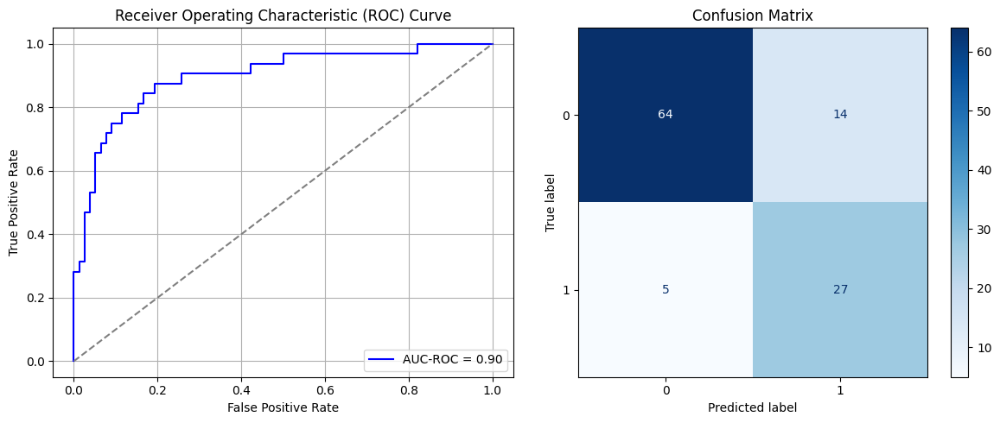

Best threshold based on F1-score: 0.630282461643219
False Negative Rate: 0.15625
Time elapsed (performance): 0.5680101509997257
(np.float64(0.1794871794871795), np.float64(0.8205128205128205))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6946 - loss: 0.6610 - val_AUC: 0.8416 - val_loss: 0.5527
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8558 - loss: 0.5105 - val_AUC: 0.8867 - val_loss: 0.4325
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8679 - loss: 0.4502 - val_AUC: 0.9043 - val_loss: 0.3961
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8814 - loss: 0.4275 - val_AUC: 0.9092 - val_loss: 0.3806
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8780 - loss: 0.4259 - val_AUC: 0.9125 - val_loss: 0.3739
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8826 - loss: 0.4238 - val_AUC: 0.9163 - val_loss: 0.3681
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8962 - loss: 0.3987 - val_AUC: 0.9189 - val_loss: 0.3596
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9116 - loss: 0.3730 - val_AUC: 0.9191 - val_loss: 0.3836
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9134 - loss: 0.3764 - v

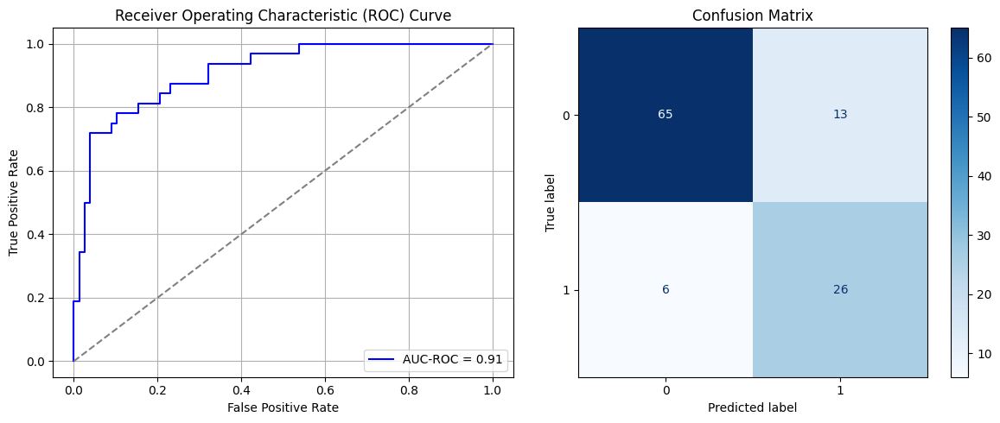

Best threshold based on F1-score: 0.7886240482330322
False Negative Rate: 0.1875
Time elapsed (performance): 0.5424740299995392
(np.float64(0.16666666666666666), np.float64(0.8333333333333334))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - AUC: 0.6491 - loss: 0.6674 - val_AUC: 0.8385 - val_loss: 0.5541
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8769 - loss: 0.4940 - val_AUC: 0.8796 - val_loss: 0.4549
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9029 - loss: 0.4036 - val_AUC: 0.8958 - val_loss: 0.4177
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8974 - loss: 0.3937 - val_AUC: 0.8978 - val_loss: 0.4084
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9026 - loss: 0.3806 - val_AUC: 0.9015 - val_loss: 0.4079
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9152 - loss: 0.3605 - val_AUC: 0.9026 - val_loss: 0.4019
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9147 - loss: 0.3616 - val_AUC: 0.9053 - val_loss: 0.3999
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9256 - loss: 0.3443 - val_AUC: 0.9045 - val_loss: 0.4038
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9137 - loss: 0.3574 - v

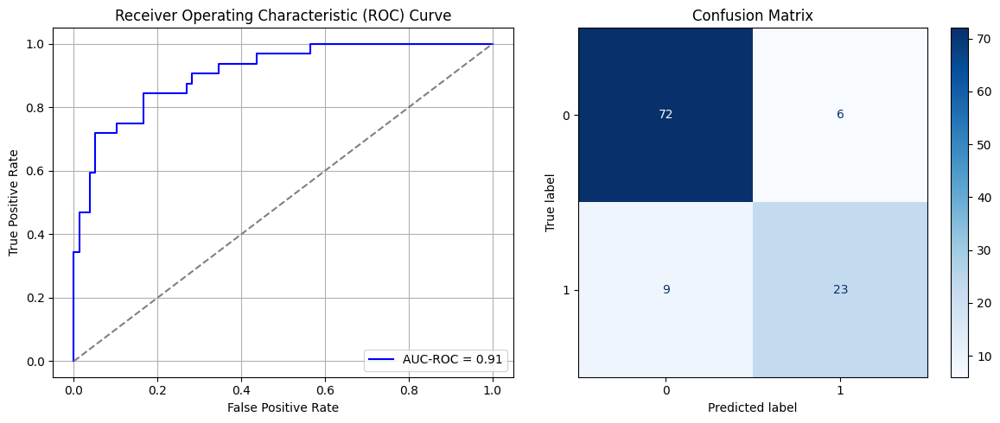

Best threshold based on F1-score: 0.6311995387077332
False Negative Rate: 0.28125
Time elapsed (performance): 0.5116083729999445
(np.float64(0.07692307692307693), np.float64(0.9230769230769231))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6532 - loss: 0.6620 - val_AUC: 0.8727 - val_loss: 0.5179
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8686 - loss: 0.4863 - val_AUC: 0.8936 - val_loss: 0.4215
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8785 - loss: 0.4311 - val_AUC: 0.9057 - val_loss: 0.3975
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8841 - loss: 0.4194 - val_AUC: 0.9127 - val_loss: 0.3730
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8960 - loss: 0.3958 - val_AUC: 0.9176 - val_loss: 0.3664
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9031 - loss: 0.3886 - val_AUC: 0.9177 - val_loss: 0.3696
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9102 - loss: 0.3794 - val_AUC: 0.9216 - val_loss: 0.3586
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8902 - loss: 0.4082 - val_AUC: 0.9203 - val_loss: 0.3702
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9182 - loss: 0.3544 - v

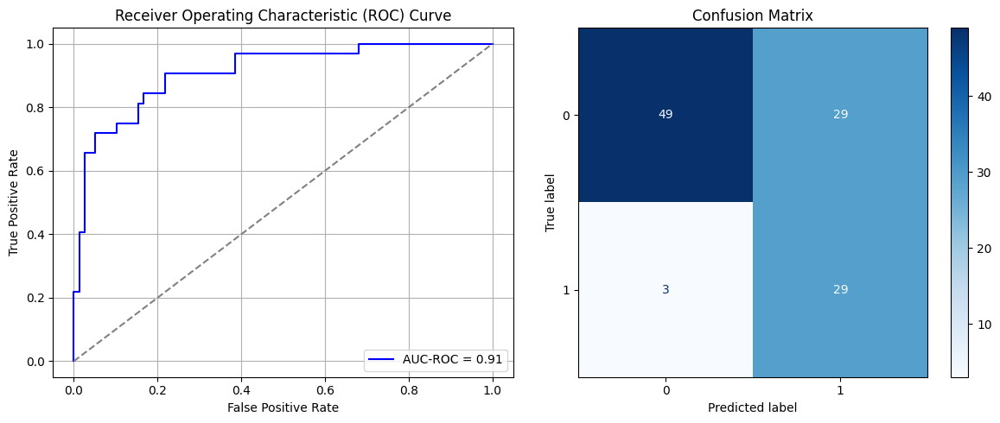

Best threshold based on F1-score: 0.9100797772407532
False Negative Rate: 0.09375
Time elapsed (performance): 0.722930582999652
(np.float64(0.3717948717948718), np.float64(0.6282051282051282))
    Source time       FPR       TNR      FNR      TPR  Target time
0     12.723941  0.282051  0.717949  0.18750  0.81250     1.241061
1     10.092753  0.448718  0.551282  0.03125  0.96875     0.466262
2      4.924795  0.153846  0.846154  0.21875  0.78125     0.484350
3      6.103898  0.230769  0.769231  0.15625  0.84375     0.497079
4      5.328894  0.384615  0.615385  0.06250  0.93750     0.468297
5      5.722342  0.320513  0.679487  0.09375  0.90625     0.472171
6      5.058467  0.217949  0.782051  0.21875  0.78125     0.497204
7      5.804777  0.294872  0.705128  0.15625  0.84375     0.466494
8      4.980927  0.320513  0.679487  0.06250  0.93750     0.490510
9      6.069792  0.217949  0.782051  0.21875  0.78125     0.487826
10     4.816380  0.384615  0.615385  0.03125  0.96875     0.462241
11 

In [67]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = oversample_size/undersample_size
print(k)

# np.random.seed(123)

for i in range(times):
    start = random.randint(1, int(k))
    # print(start)

    Row = []

    for j in range(undersample_size):
      row = start+int(k*j)-1
      Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)


In [68]:
print(ParamFit)
ParamFit.to_csv('Sy_RUS.csv')

    Source time       FPR       TNR      FNR      TPR  Target time
0     12.723941  0.282051  0.717949  0.18750  0.81250     1.241061
1     10.092753  0.448718  0.551282  0.03125  0.96875     0.466262
2      4.924795  0.153846  0.846154  0.21875  0.78125     0.484350
3      6.103898  0.230769  0.769231  0.15625  0.84375     0.497079
4      5.328894  0.384615  0.615385  0.06250  0.93750     0.468297
5      5.722342  0.320513  0.679487  0.09375  0.90625     0.472171
6      5.058467  0.217949  0.782051  0.21875  0.78125     0.497204
7      5.804777  0.294872  0.705128  0.15625  0.84375     0.466494
8      4.980927  0.320513  0.679487  0.06250  0.93750     0.490510
9      6.069792  0.217949  0.782051  0.21875  0.78125     0.487826
10     4.816380  0.384615  0.615385  0.03125  0.96875     0.462241
11     6.389219  0.128205  0.871795  0.28125  0.71875     0.482641
12     5.014610  0.128205  0.871795  0.28125  0.71875     0.473859
13     6.352502  0.256410  0.743590  0.18750  0.81250     0.47

## Systematic Sampling (multiple samples):

Now, we investigate the possibility of conducting $m$ systematic samples, each with a sampling interval of $k=m*\frac{N_0}{N_1}$, and obtaining the undersampled majority class data using all $m$ systematic samples combined. This may more closely approximate SRS sampling.

For convenience, we take $m=10$ in this case.

21.058315334773216
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - AUC: 0.6404 - loss: 0.6644 - val_AUC: 0.8684 - val_loss: 0.5449
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8632 - loss: 0.4967 - val_AUC: 0.9082 - val_loss: 0.4171
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8851 - loss: 0.4273 - val_AUC: 0.9225 - val_loss: 0.3756
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8908 - loss: 0.4064 - val_AUC: 0.9280 - val_loss: 0.3615
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8948 - loss: 0.4018 - val_AUC: 0.9325 - val_loss: 0.3481
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9047 - loss: 0.3810 - val_AUC: 0.9347 - val_loss: 0.3392
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9049 - loss: 0.3762 - val_AUC: 0.9360 - val_loss: 0.3363
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9060 - loss: 0.3825 - val_AUC: 0.9375 - val_loss: 0.3327
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9104 - loss: 0.3733 - v

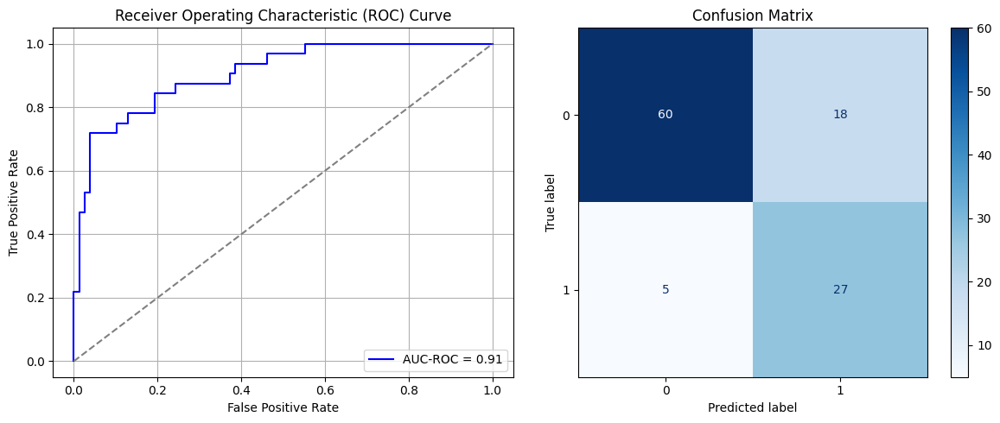

Best threshold based on F1-score: 0.8548559546470642
False Negative Rate: 0.15625
Time elapsed (performance): 0.46458557799996925
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.6548 - loss: 0.6609 - val_AUC: 0.8572 - val_loss: 0.5331
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8589 - loss: 0.4946 - val_AUC: 0.8884 - val_loss: 0.4471
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8917 - loss: 0.4108 - val_AUC: 0.9030 - val_loss: 0.4130
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9162 - loss: 0.3655 - val_AUC: 0.9102 - val_loss: 0.4107
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9110 - loss: 0.3660 - val_AUC: 0.9137 - val_loss: 0.3956
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9143 - loss: 0.3587 - val_AUC: 0.9168 - val_loss: 0.4097
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9202 - loss: 0.3490 - val_AUC: 0.9183 - val_loss: 0.3987
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9191 - loss: 0.3524 - val_AUC: 0.9203 - val_loss: 0.3914
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9340 - loss: 0.3171 - va

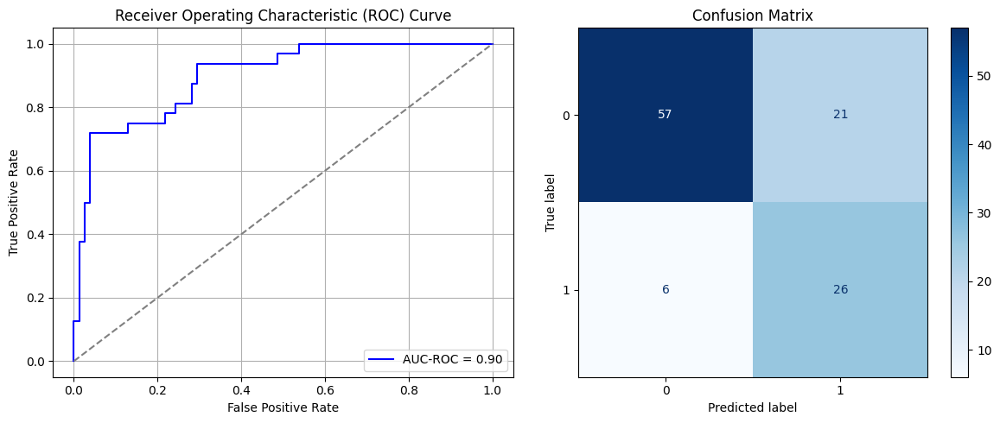

Best threshold based on F1-score: 0.8772129416465759
False Negative Rate: 0.1875
Time elapsed (performance): 0.48035743800028285
(np.float64(0.2692307692307692), np.float64(0.7307692307692308))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - AUC: 0.6287 - loss: 0.6875 - val_AUC: 0.8280 - val_loss: 0.5712
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8323 - loss: 0.5385 - val_AUC: 0.8926 - val_loss: 0.4475
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8695 - loss: 0.4552 - val_AUC: 0.9135 - val_loss: 0.4257
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8891 - loss: 0.4178 - val_AUC: 0.9193 - val_loss: 0.3917
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9024 - loss: 0.3925 - val_AUC: 0.9243 - val_loss: 0.3669
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9083 - loss: 0.3786 - val_AUC: 0.9283 - val_loss: 0.3537
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9174 - loss: 0.3578 - val_AUC: 0.9305 - val_loss: 0.3584
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9158 - loss: 0.3628 - val_AUC: 0.9309 - val_loss: 0.3459
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9161 - loss: 0.3591 - v

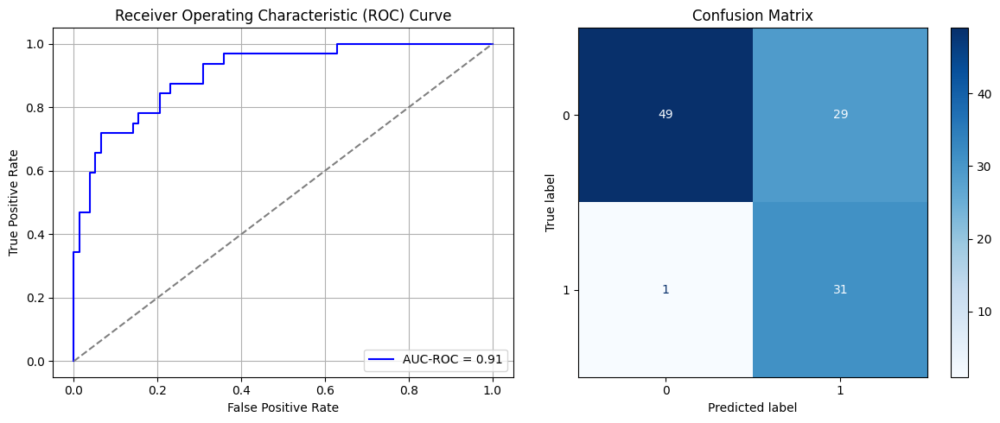

Best threshold based on F1-score: 0.9128737449645996
False Negative Rate: 0.03125
Time elapsed (performance): 0.417256099000042
(np.float64(0.3717948717948718), np.float64(0.6282051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7731 - loss: 0.6386 - val_AUC: 0.8856 - val_loss: 0.5236
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8628 - loss: 0.4974 - val_AUC: 0.9079 - val_loss: 0.4340
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8832 - loss: 0.4310 - val_AUC: 0.9205 - val_loss: 0.3918
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8903 - loss: 0.4096 - val_AUC: 0.9270 - val_loss: 0.3802
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8891 - loss: 0.4083 - val_AUC: 0.9281 - val_loss: 0.3588
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8936 - loss: 0.3977 - val_AUC: 0.9314 - val_loss: 0.3586
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9134 - loss: 0.3606 - val_AUC: 0.9367 - val_loss: 0.3443
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9155 - loss: 0.3620 - val_AUC: 0.9392 - val_loss: 0.3404
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9131 - loss: 0.3653 - va

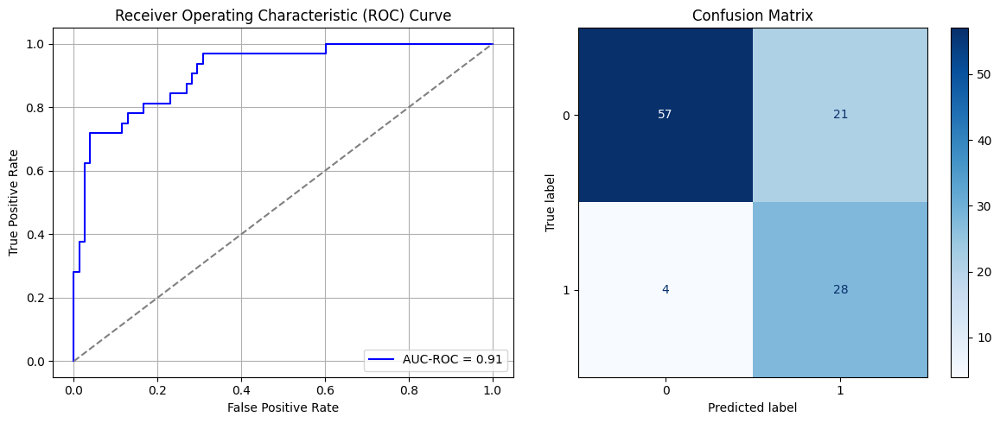

Best threshold based on F1-score: 0.862416684627533
False Negative Rate: 0.125
Time elapsed (performance): 0.4703891819999626
(np.float64(0.2692307692307692), np.float64(0.7307692307692308))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - AUC: 0.7673 - loss: 0.6313 - val_AUC: 0.8864 - val_loss: 0.4886
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8703 - loss: 0.4763 - val_AUC: 0.9022 - val_loss: 0.4295
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8808 - loss: 0.4318 - val_AUC: 0.9101 - val_loss: 0.4038
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8892 - loss: 0.4135 - val_AUC: 0.9151 - val_loss: 0.3805
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8898 - loss: 0.4141 - val_AUC: 0.9193 - val_loss: 0.3730
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9023 - loss: 0.3885 - val_AUC: 0.9227 - val_loss: 0.3645
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9078 - loss: 0.3743 - val_AUC: 0.9261 - val_loss: 0.3585
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9097 - loss: 0.3745 - val_AUC: 0.9268 - val_loss: 0.3762
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9149 - loss: 0.3657 - v

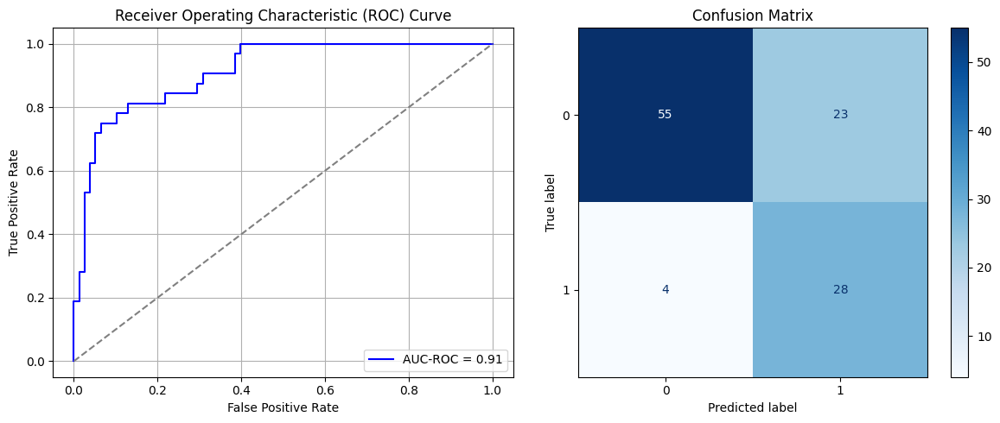

Best threshold based on F1-score: 0.7917959690093994
False Negative Rate: 0.125
Time elapsed (performance): 0.41196862800006784
(np.float64(0.2948717948717949), np.float64(0.7051282051282051))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7351 - loss: 0.6472 - val_AUC: 0.8633 - val_loss: 0.5289
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8531 - loss: 0.5115 - val_AUC: 0.8845 - val_loss: 0.4458
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8894 - loss: 0.4278 - val_AUC: 0.8957 - val_loss: 0.4157
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8824 - loss: 0.4234 - val_AUC: 0.9010 - val_loss: 0.4032
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8964 - loss: 0.3998 - val_AUC: 0.9046 - val_loss: 0.3943
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8943 - loss: 0.4073 - val_AUC: 0.9076 - val_loss: 0.3891
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9104 - loss: 0.3786 - val_AUC: 0.9103 - val_loss: 0.3826
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9067 - loss: 0.3794 - val_AUC: 0.9117 - val_loss: 0.3833
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9107 - loss: 0.3767 - va

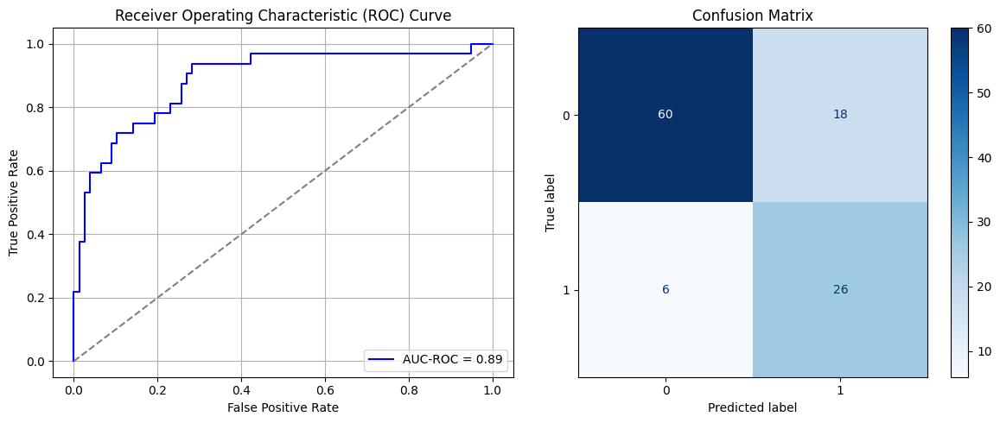

Best threshold based on F1-score: 0.7257291674613953
False Negative Rate: 0.1875
Time elapsed (performance): 0.4456565190002948
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.7282 - loss: 0.6527 - val_AUC: 0.8682 - val_loss: 0.5396
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8602 - loss: 0.4995 - val_AUC: 0.8945 - val_loss: 0.4270
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8920 - loss: 0.4063 - val_AUC: 0.9168 - val_loss: 0.3882
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8918 - loss: 0.4147 - val_AUC: 0.9211 - val_loss: 0.3700
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9071 - loss: 0.3763 - val_AUC: 0.9230 - val_loss: 0.3872
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9142 - loss: 0.3693 - val_AUC: 0.9275 - val_loss: 0.3572
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9029 - loss: 0.3750 - val_AUC: 0.9306 - val_loss: 0.3440
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9189 - loss: 0.3514 - val_AUC: 0.9329 - val_loss: 0.3364
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9270 - loss: 0.3351 - va

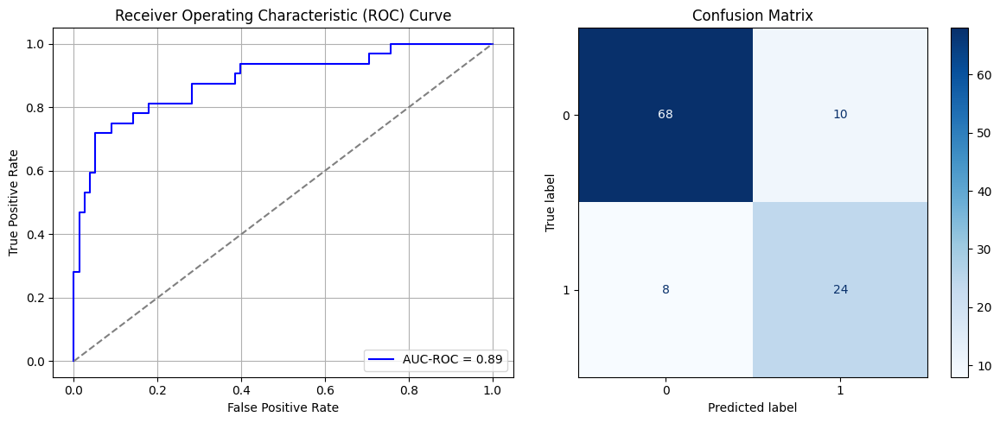

Best threshold based on F1-score: 0.739983320236206
False Negative Rate: 0.25
Time elapsed (performance): 4.16727666099996
(np.float64(0.1282051282051282), np.float64(0.8717948717948718))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7250 - loss: 0.6397 - val_AUC: 0.8867 - val_loss: 0.5243
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8565 - loss: 0.5086 - val_AUC: 0.9073 - val_loss: 0.4209
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8783 - loss: 0.4428 - val_AUC: 0.9154 - val_loss: 0.3849
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8950 - loss: 0.4060 - val_AUC: 0.9200 - val_loss: 0.3957
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9095 - loss: 0.3737 - val_AUC: 0.9212 - val_loss: 0.3678
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9063 - loss: 0.3764 - val_AUC: 0.9192 - val_loss: 0.3973
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9076 - loss: 0.3754 - val_AUC: 0.9208 - val_loss: 0.3648
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9022 - loss: 0.3862 - val_AUC: 0.9201 - val_loss: 0.3818
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9045 - loss: 0.3826 - v

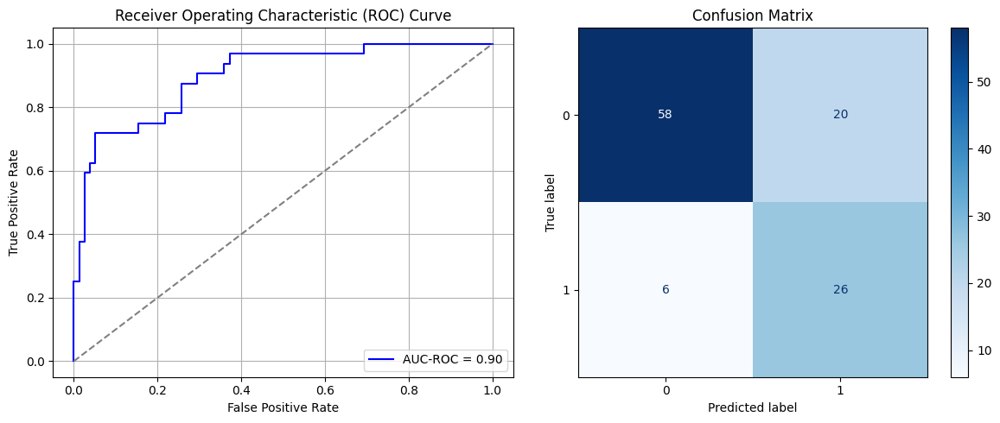

Best threshold based on F1-score: 0.8636336326599121
False Negative Rate: 0.1875
Time elapsed (performance): 0.502073614999972
(np.float64(0.2564102564102564), np.float64(0.7435897435897436))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6392 - loss: 0.6827 - val_AUC: 0.8807 - val_loss: 0.5360
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8651 - loss: 0.5071 - val_AUC: 0.9127 - val_loss: 0.3958
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8882 - loss: 0.4168 - val_AUC: 0.9274 - val_loss: 0.3603
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8857 - loss: 0.4140 - val_AUC: 0.9345 - val_loss: 0.3431
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9011 - loss: 0.3853 - val_AUC: 0.9378 - val_loss: 0.3340
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9094 - loss: 0.3745 - val_AUC: 0.9404 - val_loss: 0.3388
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9111 - loss: 0.3688 - val_AUC: 0.9421 - val_loss: 0.3209
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9225 - loss: 0.3397 - val_AUC: 0.9416 - val_loss: 0.3306
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9183 - loss: 0.3520 - v

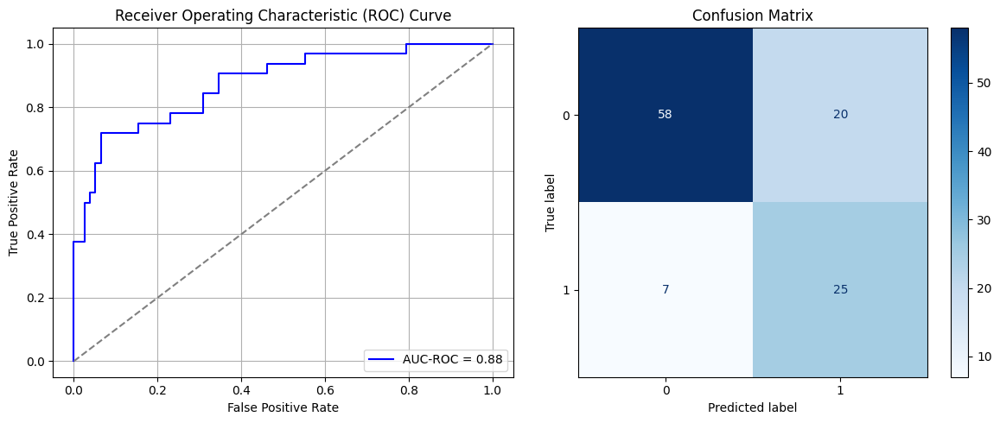

Best threshold based on F1-score: 0.8827324509620667
False Negative Rate: 0.21875
Time elapsed (performance): 0.44246841599942854
(np.float64(0.2564102564102564), np.float64(0.7435897435897436))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6933 - loss: 0.6563 - val_AUC: 0.8747 - val_loss: 0.5432
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8571 - loss: 0.5058 - val_AUC: 0.8970 - val_loss: 0.4299
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8769 - loss: 0.4386 - val_AUC: 0.9082 - val_loss: 0.4087
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8938 - loss: 0.4039 - val_AUC: 0.9150 - val_loss: 0.3827
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9080 - loss: 0.3760 - val_AUC: 0.9200 - val_loss: 0.3738
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9093 - loss: 0.3787 - val_AUC: 0.9230 - val_loss: 0.3671
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9111 - loss: 0.3700 - val_AUC: 0.9255 - val_loss: 0.3717
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9050 - loss: 0.3802 - val_AUC: 0.9281 - val_loss: 0.3645
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9034 - loss: 0.3852 - v

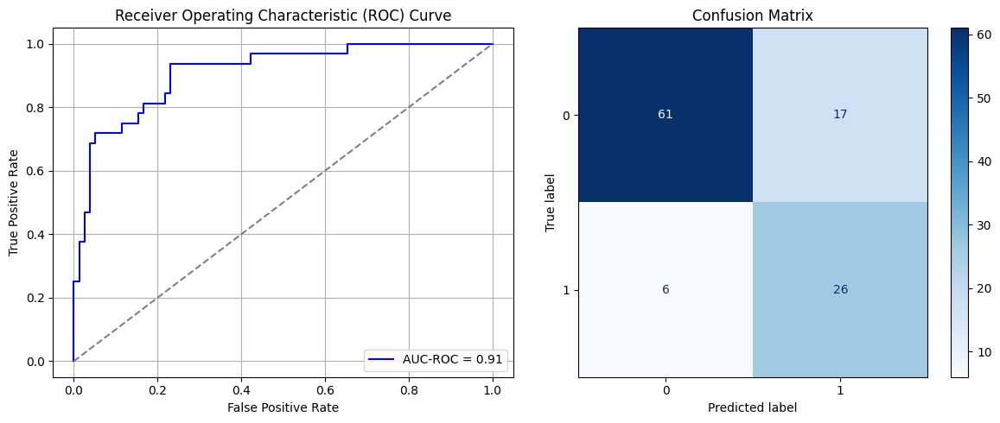

Best threshold based on F1-score: 0.8843890428543091
False Negative Rate: 0.1875
Time elapsed (performance): 0.5200444080001034
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7038 - loss: 0.6544 - val_AUC: 0.8705 - val_loss: 0.5303
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8646 - loss: 0.5042 - val_AUC: 0.8988 - val_loss: 0.4331
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8712 - loss: 0.4511 - val_AUC: 0.9081 - val_loss: 0.3973
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8931 - loss: 0.4061 - val_AUC: 0.9134 - val_loss: 0.3847
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8911 - loss: 0.4090 - val_AUC: 0.9188 - val_loss: 0.3696
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9080 - loss: 0.3811 - val_AUC: 0.9227 - val_loss: 0.3752
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9200 - loss: 0.3503 - val_AUC: 0.9255 - val_loss: 0.3572
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9181 - loss: 0.3514 - val_AUC: 0.9266 - val_loss: 0.3534
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9152 - loss: 0.3647 - va

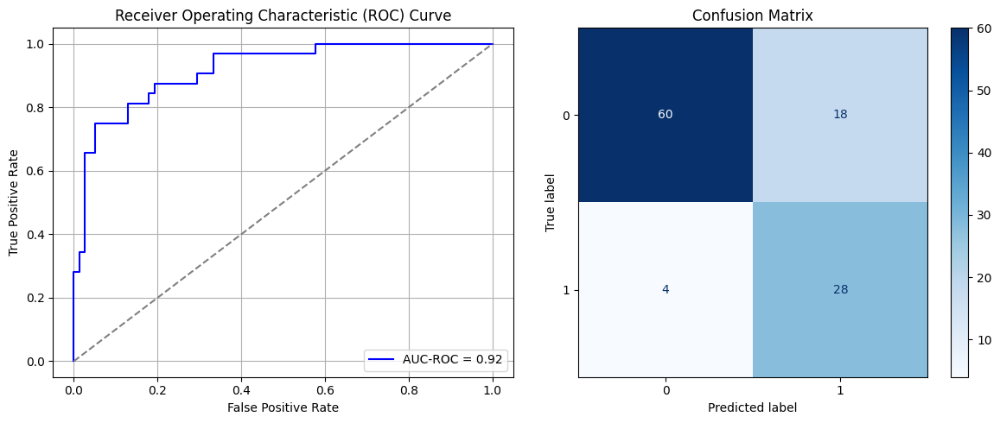

Best threshold based on F1-score: 0.7616559267044067
False Negative Rate: 0.125
Time elapsed (performance): 0.47261717400033376
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7020 - loss: 0.6615 - val_AUC: 0.8611 - val_loss: 0.5563
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8598 - loss: 0.5191 - val_AUC: 0.8911 - val_loss: 0.4431
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8760 - loss: 0.4399 - val_AUC: 0.9051 - val_loss: 0.4064
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8815 - loss: 0.4218 - val_AUC: 0.9142 - val_loss: 0.3807
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8984 - loss: 0.3900 - val_AUC: 0.9192 - val_loss: 0.3683
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.8994 - loss: 0.3840 - val_AUC: 0.9232 - val_loss: 0.3646
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8945 - loss: 0.3918 - val_AUC: 0.9258 - val_loss: 0.3544
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9048 - loss: 0.3772 - val_AUC: 0.9262 - val_loss: 0.3613
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9142 - loss: 0.3595 - v

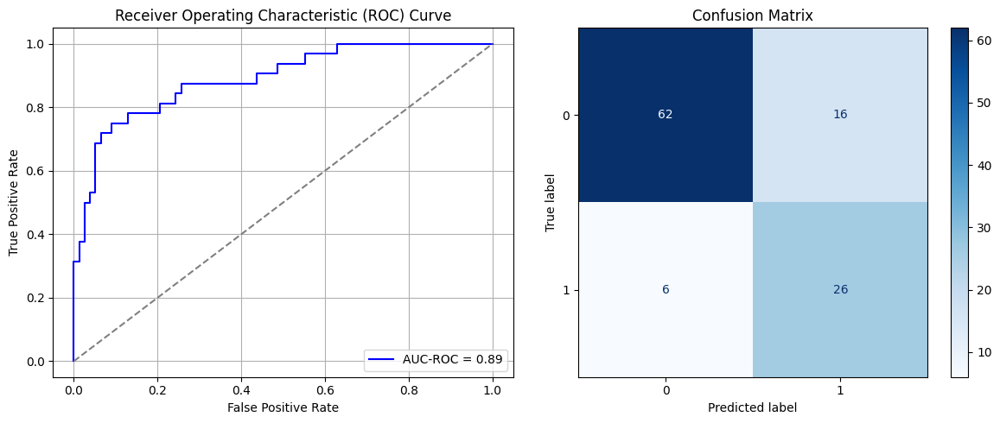

Best threshold based on F1-score: 0.7486323118209839
False Negative Rate: 0.1875
Time elapsed (performance): 0.47856253999998444
(np.float64(0.20512820512820512), np.float64(0.7948717948717949))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7710 - loss: 0.6350 - val_AUC: 0.8779 - val_loss: 0.4818
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8568 - loss: 0.4748 - val_AUC: 0.9002 - val_loss: 0.4210
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8914 - loss: 0.4070 - val_AUC: 0.9113 - val_loss: 0.3974
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8941 - loss: 0.4102 - val_AUC: 0.9162 - val_loss: 0.3796
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9013 - loss: 0.3851 - val_AUC: 0.9214 - val_loss: 0.3818
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8913 - loss: 0.3947 - val_AUC: 0.9233 - val_loss: 0.3794
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9143 - loss: 0.3551 - val_AUC: 0.9245 - val_loss: 0.3780
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9219 - loss: 0.3484 - val_AUC: 0.9248 - val_loss: 0.3669
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9061 - loss: 0.3761 - v

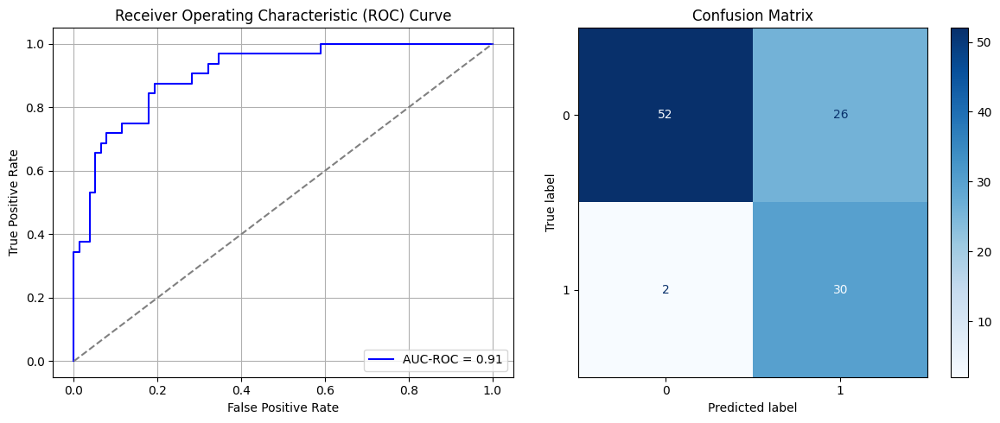

Best threshold based on F1-score: 0.8884850740432739
False Negative Rate: 0.0625
Time elapsed (performance): 0.48189370399995823
(np.float64(0.3333333333333333), np.float64(0.6666666666666667))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6139 - loss: 0.6719 - val_AUC: 0.8956 - val_loss: 0.5097
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8444 - loss: 0.5171 - val_AUC: 0.9170 - val_loss: 0.4117
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8779 - loss: 0.4371 - val_AUC: 0.9247 - val_loss: 0.3857
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8749 - loss: 0.4318 - val_AUC: 0.9276 - val_loss: 0.3632
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.8892 - loss: 0.4098 - val_AUC: 0.9297 - val_loss: 0.3586
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9156 - loss: 0.3697 - val_AUC: 0.9302 - val_loss: 0.3505
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9052 - loss: 0.3825 - val_AUC: 0.9295 - val_loss: 0.3753
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9201 - loss: 0.3452 - val_AUC: 0.9322 - val_loss: 0.3445
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9218 - loss: 0.3478 - v

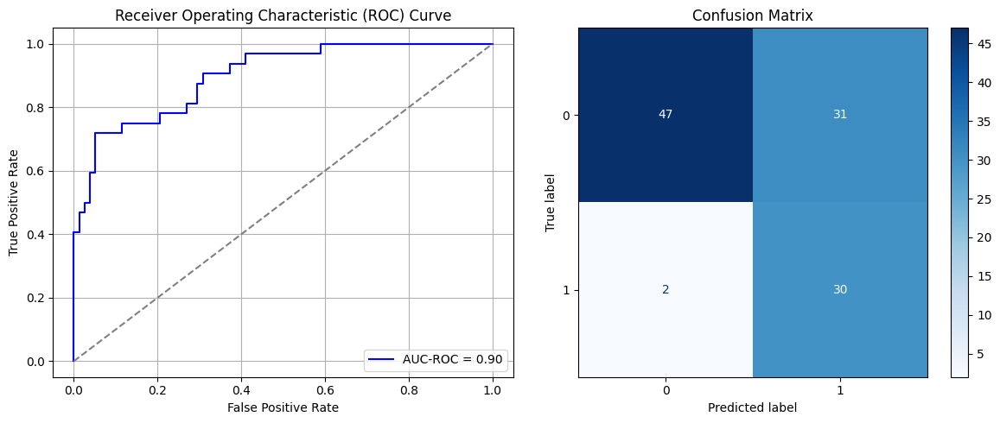

Best threshold based on F1-score: 0.9144081473350525
False Negative Rate: 0.0625
Time elapsed (performance): 0.48888774500028376
(np.float64(0.3974358974358974), np.float64(0.6025641025641026))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7094 - loss: 0.6540 - val_AUC: 0.8682 - val_loss: 0.5435
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8725 - loss: 0.5016 - val_AUC: 0.8968 - val_loss: 0.4315
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8871 - loss: 0.4276 - val_AUC: 0.9076 - val_loss: 0.3986
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8952 - loss: 0.4034 - val_AUC: 0.9140 - val_loss: 0.3979
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9005 - loss: 0.3945 - val_AUC: 0.9183 - val_loss: 0.3782
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9151 - loss: 0.3636 - val_AUC: 0.9188 - val_loss: 0.3907
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8992 - loss: 0.3890 - val_AUC: 0.9211 - val_loss: 0.3716
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9146 - loss: 0.3603 - val_AUC: 0.9212 - val_loss: 0.3701
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9093 - loss: 0.3714 - va

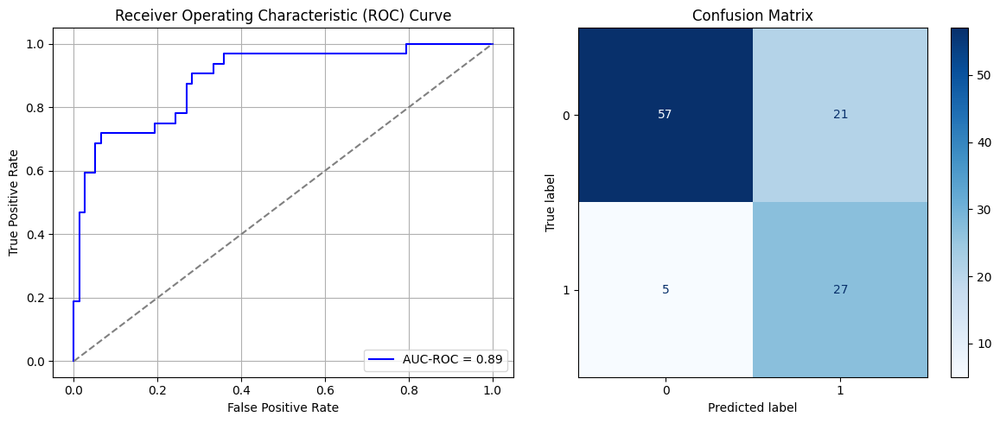

Best threshold based on F1-score: 0.8570652008056641
False Negative Rate: 0.15625
Time elapsed (performance): 0.48818425399986154
(np.float64(0.2692307692307692), np.float64(0.7307692307692308))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6702 - loss: 0.6752 - val_AUC: 0.8501 - val_loss: 0.5586
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8621 - loss: 0.5140 - val_AUC: 0.8876 - val_loss: 0.4437
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8879 - loss: 0.4262 - val_AUC: 0.9078 - val_loss: 0.4064
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8984 - loss: 0.3990 - val_AUC: 0.9193 - val_loss: 0.3784
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9053 - loss: 0.3722 - val_AUC: 0.9280 - val_loss: 0.3598
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9069 - loss: 0.3714 - val_AUC: 0.9314 - val_loss: 0.3525
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.9208 - loss: 0.3365 - val_AUC: 0.9348 - val_loss: 0.3461
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9228 - loss: 0.3348 - val_AUC: 0.9359 - val_loss: 0.3352
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9014 - loss: 0.3733 - v

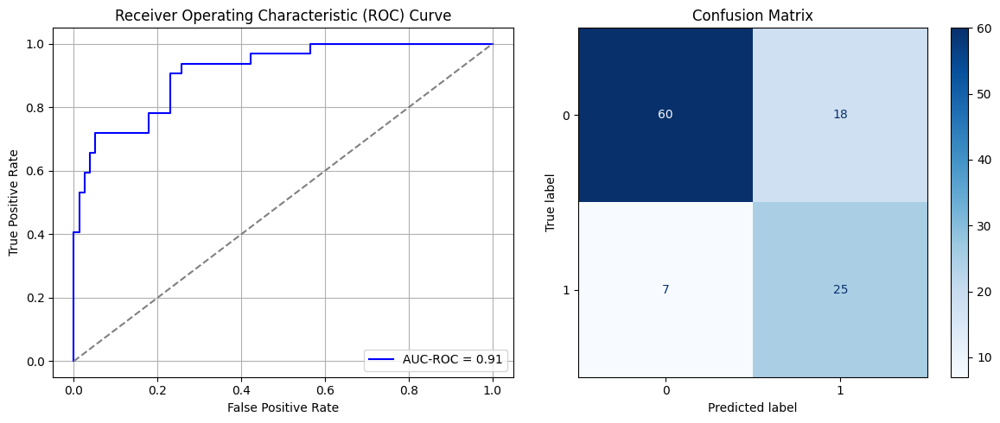

Best threshold based on F1-score: 0.8935211300849915
False Negative Rate: 0.21875
Time elapsed (performance): 0.6969117859998732
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7522 - loss: 0.6371 - val_AUC: 0.8743 - val_loss: 0.5055
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8451 - loss: 0.5031 - val_AUC: 0.9034 - val_loss: 0.4218
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8938 - loss: 0.4106 - val_AUC: 0.9168 - val_loss: 0.3863
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8897 - loss: 0.4073 - val_AUC: 0.9234 - val_loss: 0.3659
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9018 - loss: 0.3929 - val_AUC: 0.9277 - val_loss: 0.3579
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9053 - loss: 0.3766 - val_AUC: 0.9315 - val_loss: 0.3665
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9097 - loss: 0.3755 - val_AUC: 0.9340 - val_loss: 0.3434
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9090 - loss: 0.3702 - val_AUC: 0.9349 - val_loss: 0.3415
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9085 - loss: 0.3714 - va

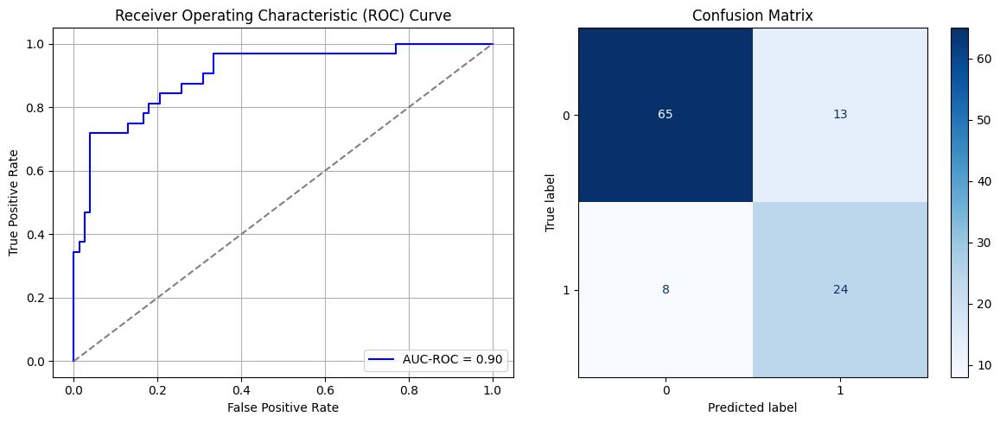

Best threshold based on F1-score: 0.879777193069458
False Negative Rate: 0.25
Time elapsed (performance): 0.5070152450007299
(np.float64(0.16666666666666666), np.float64(0.8333333333333334))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - AUC: 0.6262 - loss: 0.6738 - val_AUC: 0.8708 - val_loss: 0.5063
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - AUC: 0.8620 - loss: 0.4809 - val_AUC: 0.8918 - val_loss: 0.4355
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8698 - loss: 0.4491 - val_AUC: 0.9019 - val_loss: 0.4085
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8928 - loss: 0.4056 - val_AUC: 0.9090 - val_loss: 0.3953
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8986 - loss: 0.3988 - val_AUC: 0.9128 - val_loss: 0.3927
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8893 - loss: 0.4038 - val_AUC: 0.9171 - val_loss: 0.3779
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9159 - loss: 0.3541 - val_AUC: 0.9191 - val_loss: 0.3736
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9078 - loss: 0.3724 - val_AUC: 0.9201 - val_loss: 0.3928
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9031 - loss: 0.3848 - v

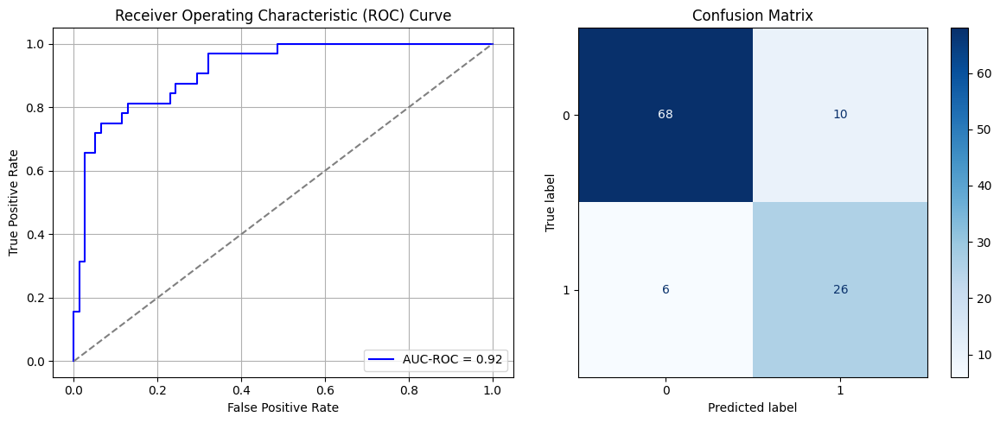

Best threshold based on F1-score: 0.6492732167243958
False Negative Rate: 0.1875
Time elapsed (performance): 0.4849061750001056
(np.float64(0.1282051282051282), np.float64(0.8717948717948718))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7135 - loss: 0.6419 - val_AUC: 0.8740 - val_loss: 0.4987
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8610 - loss: 0.4891 - val_AUC: 0.8987 - val_loss: 0.4357
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8813 - loss: 0.4339 - val_AUC: 0.9088 - val_loss: 0.3956
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8856 - loss: 0.4165 - val_AUC: 0.9169 - val_loss: 0.3805
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9047 - loss: 0.3856 - val_AUC: 0.9227 - val_loss: 0.3722
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8997 - loss: 0.3885 - val_AUC: 0.9249 - val_loss: 0.3903
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9082 - loss: 0.3649 - val_AUC: 0.9268 - val_loss: 0.3601
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9199 - loss: 0.3450 - val_AUC: 0.9283 - val_loss: 0.3807
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9040 - loss: 0.3760 - v

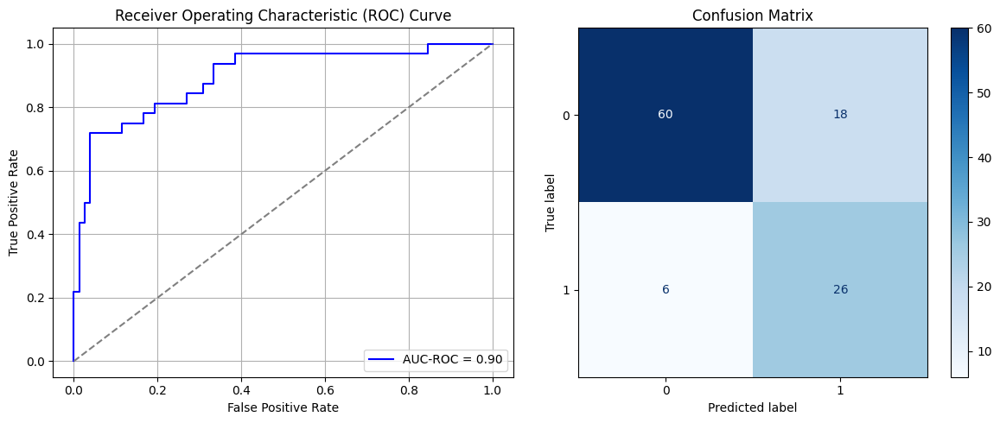

Best threshold based on F1-score: 0.9127176403999329
False Negative Rate: 0.1875
Time elapsed (performance): 0.4825892720000411
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - AUC: 0.7124 - loss: 0.6472 - val_AUC: 0.8767 - val_loss: 0.5011
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8536 - loss: 0.4892 - val_AUC: 0.9016 - val_loss: 0.4140
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8838 - loss: 0.4273 - val_AUC: 0.9172 - val_loss: 0.3871
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8932 - loss: 0.4019 - val_AUC: 0.9243 - val_loss: 0.3780
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8999 - loss: 0.3940 - val_AUC: 0.9293 - val_loss: 0.3532
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9019 - loss: 0.3968 - val_AUC: 0.9345 - val_loss: 0.3492
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9061 - loss: 0.3830 - val_AUC: 0.9390 - val_loss: 0.3393
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9054 - loss: 0.3823 - val_AUC: 0.9384 - val_loss: 0.3529
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9105 - loss: 0.3675 - v

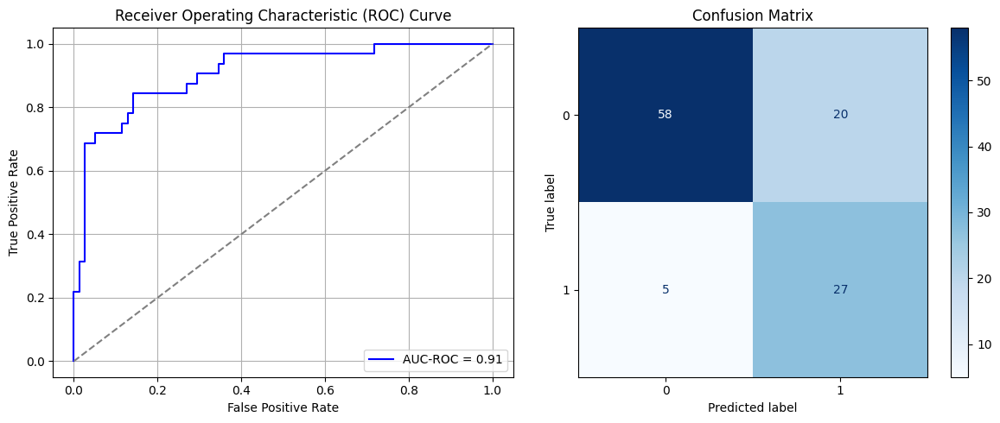

Best threshold based on F1-score: 0.9023200869560242
False Negative Rate: 0.15625
Time elapsed (performance): 0.47318160899976647
(np.float64(0.2564102564102564), np.float64(0.7435897435897436))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7221 - loss: 0.6486 - val_AUC: 0.8484 - val_loss: 0.5363
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8697 - loss: 0.4837 - val_AUC: 0.8759 - val_loss: 0.4527
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8945 - loss: 0.4080 - val_AUC: 0.8893 - val_loss: 0.4374
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8956 - loss: 0.4062 - val_AUC: 0.8967 - val_loss: 0.4211
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9061 - loss: 0.3785 - val_AUC: 0.8998 - val_loss: 0.4165
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9041 - loss: 0.3774 - val_AUC: 0.9053 - val_loss: 0.3981
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9117 - loss: 0.3732 - val_AUC: 0.9041 - val_loss: 0.3972
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9116 - loss: 0.3693 - val_AUC: 0.9076 - val_loss: 0.3928
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9062 - loss: 0.3783 - va

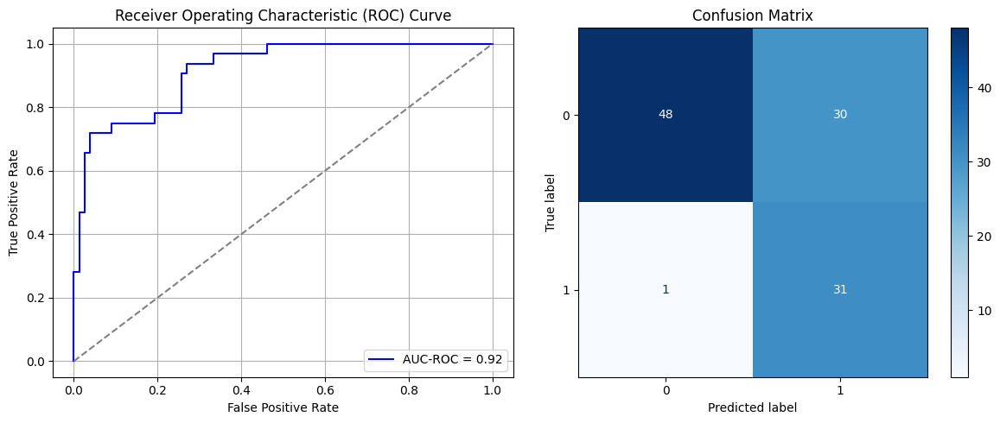

Best threshold based on F1-score: 0.9160436391830444
False Negative Rate: 0.03125
Time elapsed (performance): 0.4635313569997379
(np.float64(0.38461538461538464), np.float64(0.6153846153846154))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - AUC: 0.7502 - loss: 0.6349 - val_AUC: 0.8730 - val_loss: 0.5032
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8727 - loss: 0.4718 - val_AUC: 0.8963 - val_loss: 0.4443
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8872 - loss: 0.4214 - val_AUC: 0.9054 - val_loss: 0.4198
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8923 - loss: 0.4126 - val_AUC: 0.9106 - val_loss: 0.3984
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9020 - loss: 0.3846 - val_AUC: 0.9123 - val_loss: 0.4000
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9049 - loss: 0.3809 - val_AUC: 0.9145 - val_loss: 0.3885
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9139 - loss: 0.3591 - val_AUC: 0.9169 - val_loss: 0.3811
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9110 - loss: 0.3610 - val_AUC: 0.9178 - val_loss: 0.3792
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9073 - loss: 0.3738 - v

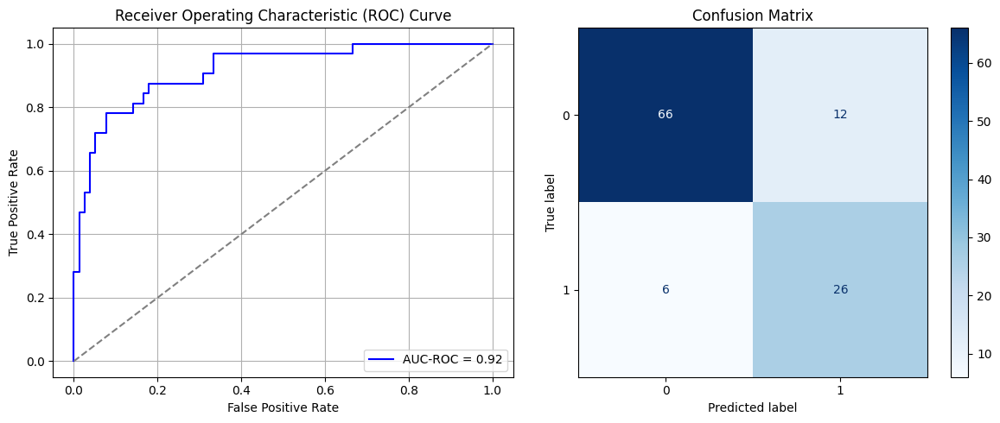

Best threshold based on F1-score: 0.6099260449409485
False Negative Rate: 0.1875
Time elapsed (performance): 0.5025906629998644
(np.float64(0.15384615384615385), np.float64(0.8461538461538461))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6386 - loss: 0.6770 - val_AUC: 0.8319 - val_loss: 0.5642
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8446 - loss: 0.5302 - val_AUC: 0.8680 - val_loss: 0.4689
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8773 - loss: 0.4415 - val_AUC: 0.8934 - val_loss: 0.4305
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8910 - loss: 0.4142 - val_AUC: 0.9019 - val_loss: 0.4154
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8908 - loss: 0.4110 - val_AUC: 0.9066 - val_loss: 0.3985
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9038 - loss: 0.3832 - val_AUC: 0.9124 - val_loss: 0.4003
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9091 - loss: 0.3766 - val_AUC: 0.9154 - val_loss: 0.4045
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9046 - loss: 0.3805 - val_AUC: 0.9180 - val_loss: 0.3798
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9067 - loss: 0.3836 - va

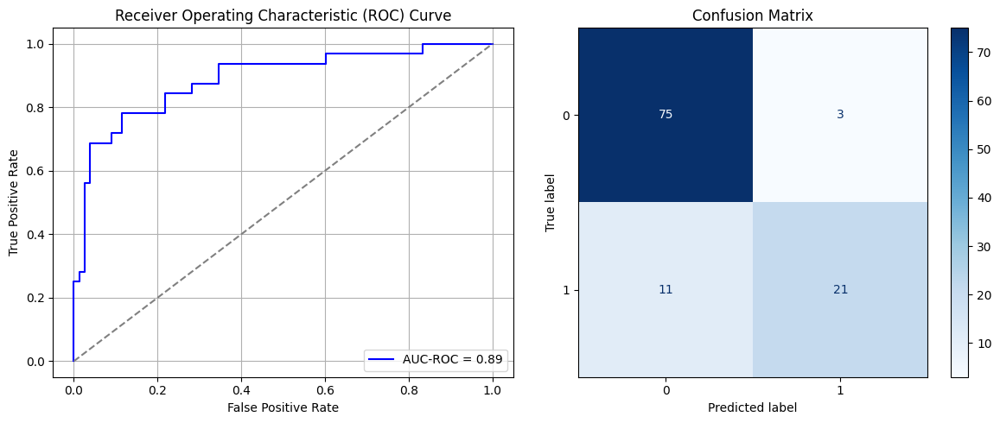

Best threshold based on F1-score: 0.44680869579315186
False Negative Rate: 0.34375
Time elapsed (performance): 0.4739351150001312
(np.float64(0.038461538461538464), np.float64(0.9615384615384616))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - AUC: 0.7061 - loss: 0.6658 - val_AUC: 0.8572 - val_loss: 0.5786
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8683 - loss: 0.5298 - val_AUC: 0.8788 - val_loss: 0.4752
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8870 - loss: 0.4304 - val_AUC: 0.8916 - val_loss: 0.4216
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8956 - loss: 0.3992 - val_AUC: 0.8979 - val_loss: 0.4110
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8922 - loss: 0.4052 - val_AUC: 0.9057 - val_loss: 0.3993
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9071 - loss: 0.3761 - val_AUC: 0.9102 - val_loss: 0.3931
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9050 - loss: 0.3798 - val_AUC: 0.9099 - val_loss: 0.3949
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9196 - loss: 0.3512 - val_AUC: 0.9131 - val_loss: 0.3821
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9120 - loss: 0.3639 - v

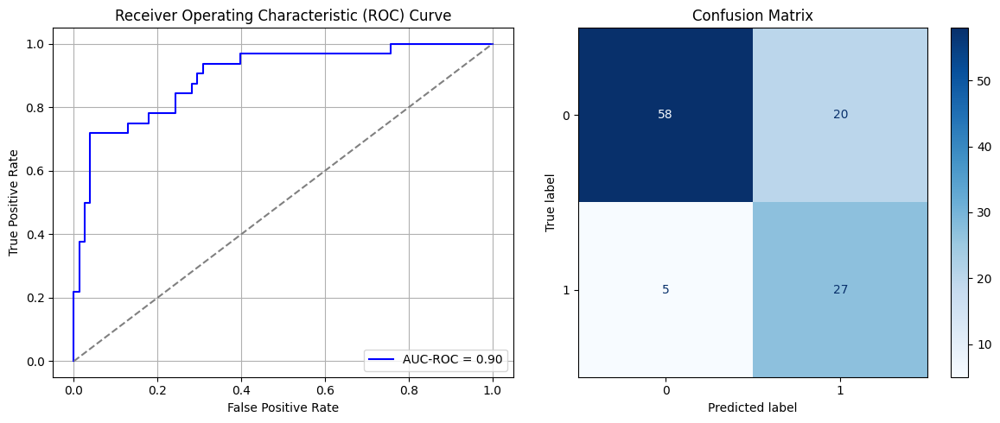

Best threshold based on F1-score: 0.8930830955505371
False Negative Rate: 0.15625
Time elapsed (performance): 0.4778652550003244
(np.float64(0.2564102564102564), np.float64(0.7435897435897436))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6087 - loss: 0.6862 - val_AUC: 0.8936 - val_loss: 0.5326
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8560 - loss: 0.5143 - val_AUC: 0.9023 - val_loss: 0.4218
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8969 - loss: 0.4149 - val_AUC: 0.9163 - val_loss: 0.3955
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8842 - loss: 0.4344 - val_AUC: 0.9218 - val_loss: 0.3799
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9042 - loss: 0.3913 - val_AUC: 0.9270 - val_loss: 0.3644
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9025 - loss: 0.3921 - val_AUC: 0.9275 - val_loss: 0.4172
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8869 - loss: 0.4159 - val_AUC: 0.9300 - val_loss: 0.3505
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8955 - loss: 0.4028 - val_AUC: 0.9331 - val_loss: 0.3554
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9008 - loss: 0.3896 - va

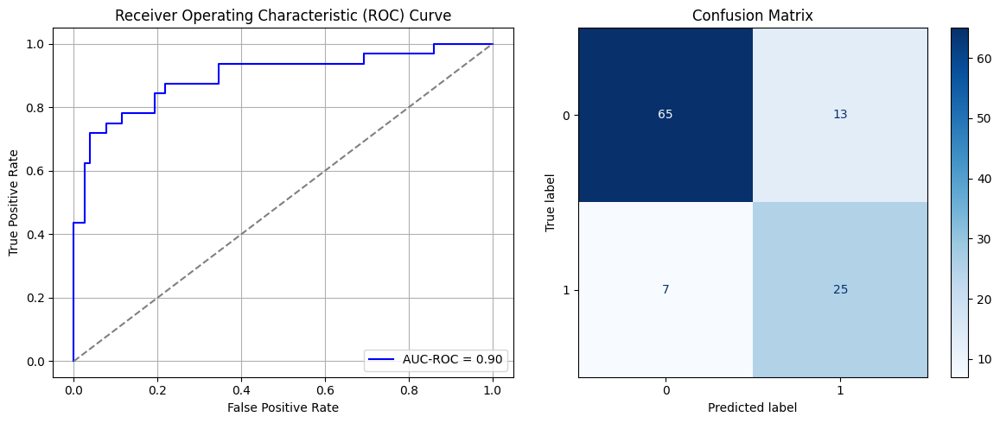

Best threshold based on F1-score: 0.8224805593490601
False Negative Rate: 0.21875
Time elapsed (performance): 0.4515606390004905
(np.float64(0.16666666666666666), np.float64(0.8333333333333334))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - AUC: 0.6409 - loss: 0.6735 - val_AUC: 0.8678 - val_loss: 0.5830
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.8698 - loss: 0.5344 - val_AUC: 0.8981 - val_loss: 0.4266
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8931 - loss: 0.4150 - val_AUC: 0.9126 - val_loss: 0.3916
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8998 - loss: 0.3892 - val_AUC: 0.9204 - val_loss: 0.3791
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9015 - loss: 0.3896 - val_AUC: 0.9266 - val_loss: 0.3574
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9067 - loss: 0.3702 - val_AUC: 0.9301 - val_loss: 0.3440
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9151 - loss: 0.3514 - val_AUC: 0.9311 - val_loss: 0.3492
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9126 - loss: 0.3555 - val_AUC: 0.9319 - val_loss: 0.3381
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9176 - loss: 0.3444 - v

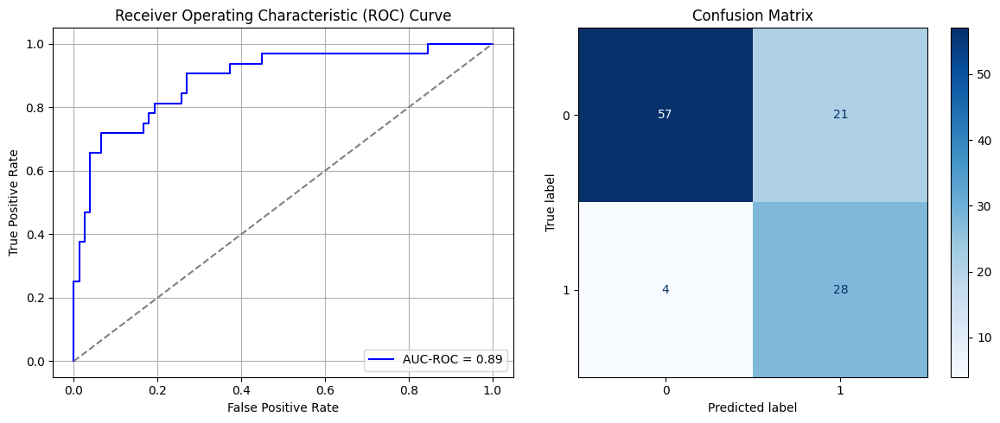

Best threshold based on F1-score: 0.8651574850082397
False Negative Rate: 0.125
Time elapsed (performance): 0.460543969000355
(np.float64(0.2692307692307692), np.float64(0.7307692307692308))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7236 - loss: 0.6449 - val_AUC: 0.8942 - val_loss: 0.5073
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8664 - loss: 0.4920 - val_AUC: 0.9123 - val_loss: 0.4314
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8784 - loss: 0.4311 - val_AUC: 0.9221 - val_loss: 0.3840
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8945 - loss: 0.3985 - val_AUC: 0.9263 - val_loss: 0.3836
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9010 - loss: 0.3846 - val_AUC: 0.9324 - val_loss: 0.3826
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9160 - loss: 0.3536 - val_AUC: 0.9354 - val_loss: 0.3534
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9087 - loss: 0.3700 - val_AUC: 0.9373 - val_loss: 0.3505
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9123 - loss: 0.3560 - val_AUC: 0.9371 - val_loss: 0.3662
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9204 - loss: 0.3416 - va

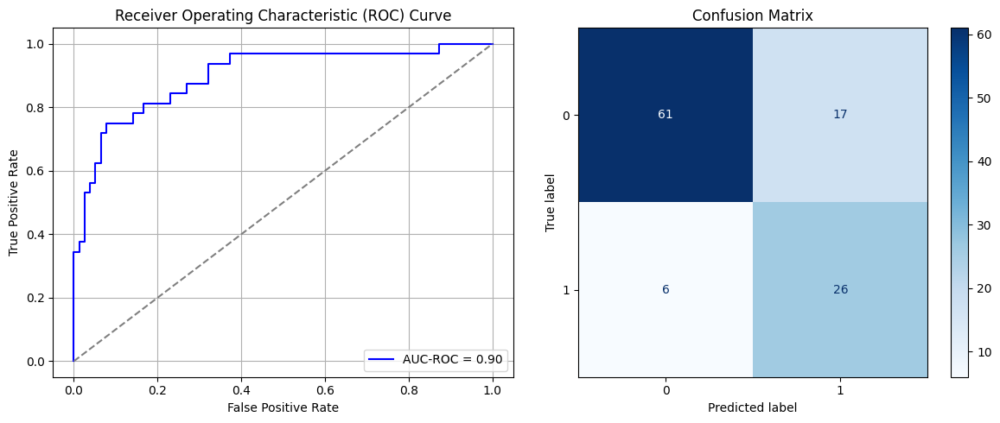

Best threshold based on F1-score: 0.769192099571228
False Negative Rate: 0.1875
Time elapsed (performance): 0.475320797000677
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - AUC: 0.7414 - loss: 0.6414 - val_AUC: 0.8804 - val_loss: 0.4976
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8615 - loss: 0.4845 - val_AUC: 0.9010 - val_loss: 0.4100
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8856 - loss: 0.4218 - val_AUC: 0.9086 - val_loss: 0.3982
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8957 - loss: 0.4030 - val_AUC: 0.9151 - val_loss: 0.3760
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9026 - loss: 0.3835 - val_AUC: 0.9232 - val_loss: 0.3709
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8962 - loss: 0.3913 - val_AUC: 0.9228 - val_loss: 0.3606
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9055 - loss: 0.3764 - val_AUC: 0.9258 - val_loss: 0.3800
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9083 - loss: 0.3729 - val_AUC: 0.9284 - val_loss: 0.3595
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9126 - loss: 0.3697 - v

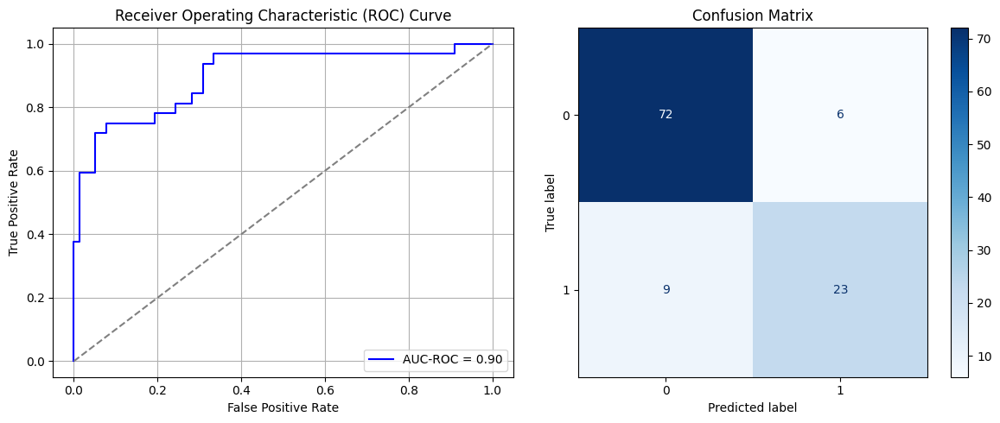

Best threshold based on F1-score: 0.5848163962364197
False Negative Rate: 0.28125
Time elapsed (performance): 0.4702653470003497
(np.float64(0.07692307692307693), np.float64(0.9230769230769231))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.8055 - loss: 0.6191 - val_AUC: 0.8500 - val_loss: 0.5041
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8704 - loss: 0.4666 - val_AUC: 0.8751 - val_loss: 0.4470
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8704 - loss: 0.4429 - val_AUC: 0.8881 - val_loss: 0.4290
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9035 - loss: 0.3818 - val_AUC: 0.8999 - val_loss: 0.4089
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9001 - loss: 0.3877 - val_AUC: 0.9055 - val_loss: 0.3974
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9140 - loss: 0.3593 - val_AUC: 0.9115 - val_loss: 0.3852
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9134 - loss: 0.3573 - val_AUC: 0.9130 - val_loss: 0.3889
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9227 - loss: 0.3476 - val_AUC: 0.9148 - val_loss: 0.3775
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9155 - loss: 0.3584 - va

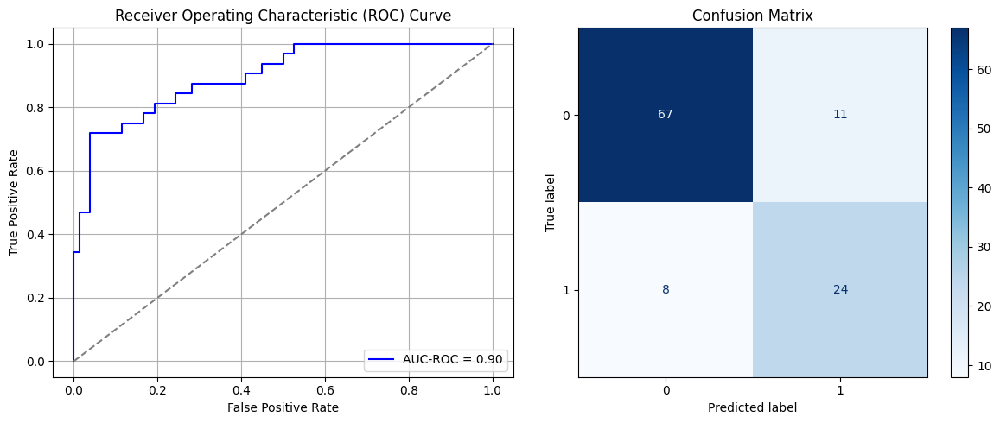

Best threshold based on F1-score: 0.7939255237579346
False Negative Rate: 0.25
Time elapsed (performance): 0.4979988750001212
(np.float64(0.14102564102564102), np.float64(0.858974358974359))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - AUC: 0.6850 - loss: 0.6517 - val_AUC: 0.8638 - val_loss: 0.5170
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8572 - loss: 0.4933 - val_AUC: 0.8870 - val_loss: 0.4451
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8834 - loss: 0.4233 - val_AUC: 0.8981 - val_loss: 0.4143
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8904 - loss: 0.4064 - val_AUC: 0.9085 - val_loss: 0.4064
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9018 - loss: 0.3875 - val_AUC: 0.9139 - val_loss: 0.3824
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9064 - loss: 0.3771 - val_AUC: 0.9163 - val_loss: 0.3757
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9022 - loss: 0.3845 - val_AUC: 0.9192 - val_loss: 0.3692
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9123 - loss: 0.3663 - val_AUC: 0.9240 - val_loss: 0.3900
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9138 - loss: 0.3672 - v

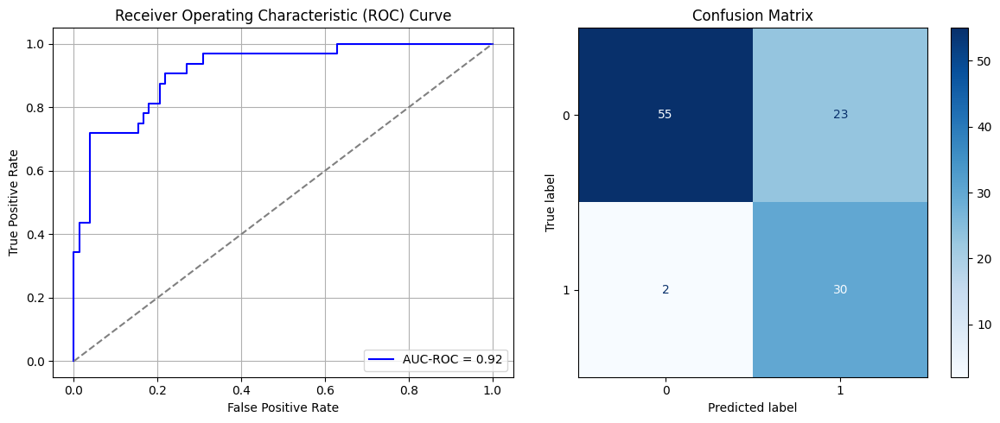

Best threshold based on F1-score: 0.9340762495994568
False Negative Rate: 0.0625
Time elapsed (performance): 0.4730741550001767
(np.float64(0.2948717948717949), np.float64(0.7051282051282051))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6771 - loss: 0.6543 - val_AUC: 0.8443 - val_loss: 0.5388
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8475 - loss: 0.5085 - val_AUC: 0.8956 - val_loss: 0.4415
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8878 - loss: 0.4206 - val_AUC: 0.9150 - val_loss: 0.3899
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8985 - loss: 0.3885 - val_AUC: 0.9235 - val_loss: 0.3609
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9030 - loss: 0.3843 - val_AUC: 0.9280 - val_loss: 0.3783
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9026 - loss: 0.3786 - val_AUC: 0.9318 - val_loss: 0.3393
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9185 - loss: 0.3521 - val_AUC: 0.9328 - val_loss: 0.3381
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9080 - loss: 0.3710 - val_AUC: 0.9327 - val_loss: 0.3572
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9040 - loss: 0.3731 - va

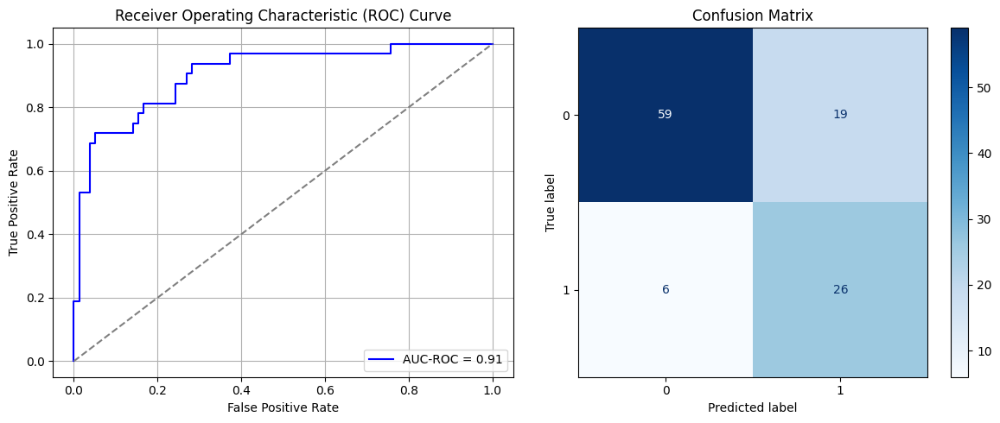

Best threshold based on F1-score: 0.8926445841789246
False Negative Rate: 0.1875
Time elapsed (performance): 0.5101227150007617
(np.float64(0.24358974358974358), np.float64(0.7564102564102564))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.7813 - loss: 0.6448 - val_AUC: 0.8729 - val_loss: 0.5319
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8462 - loss: 0.5103 - val_AUC: 0.8952 - val_loss: 0.4492
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8808 - loss: 0.4328 - val_AUC: 0.9051 - val_loss: 0.4090
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8870 - loss: 0.4164 - val_AUC: 0.9144 - val_loss: 0.3835
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9035 - loss: 0.3824 - val_AUC: 0.9218 - val_loss: 0.3721
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9065 - loss: 0.3806 - val_AUC: 0.9210 - val_loss: 0.3782
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9144 - loss: 0.3657 - val_AUC: 0.9234 - val_loss: 0.3690
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9055 - loss: 0.3747 - val_AUC: 0.9264 - val_loss: 0.3625
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9153 - loss: 0.3577 - v

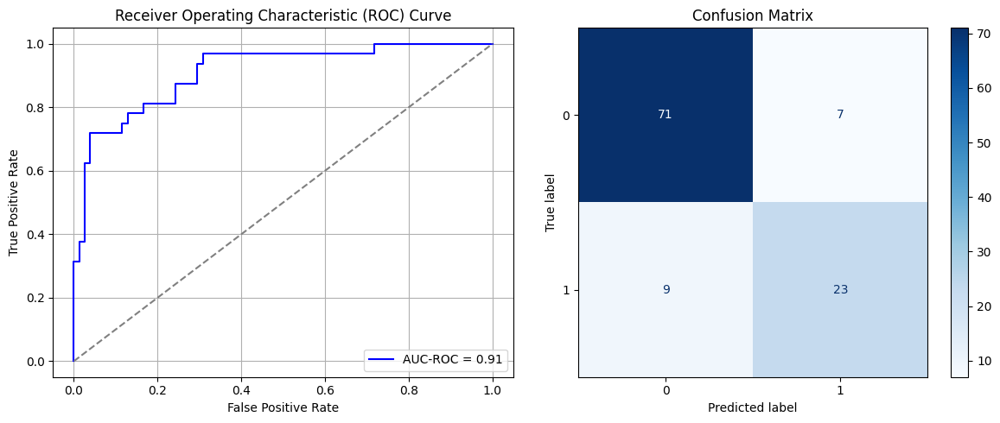

Best threshold based on F1-score: 0.6494930386543274
False Negative Rate: 0.28125
Time elapsed (performance): 0.5102389229996334
(np.float64(0.08974358974358974), np.float64(0.9102564102564102))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6889 - loss: 0.6657 - val_AUC: 0.8427 - val_loss: 0.5422
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8499 - loss: 0.5154 - val_AUC: 0.8732 - val_loss: 0.4623
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8772 - loss: 0.4341 - val_AUC: 0.8874 - val_loss: 0.4405
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8895 - loss: 0.4169 - val_AUC: 0.8981 - val_loss: 0.4268
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8999 - loss: 0.3951 - val_AUC: 0.9039 - val_loss: 0.4166
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9012 - loss: 0.3904 - val_AUC: 0.9108 - val_loss: 0.3889
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9089 - loss: 0.3736 - val_AUC: 0.9138 - val_loss: 0.3918
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9095 - loss: 0.3781 - val_AUC: 0.9171 - val_loss: 0.3778
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9150 - loss: 0.3627 - va

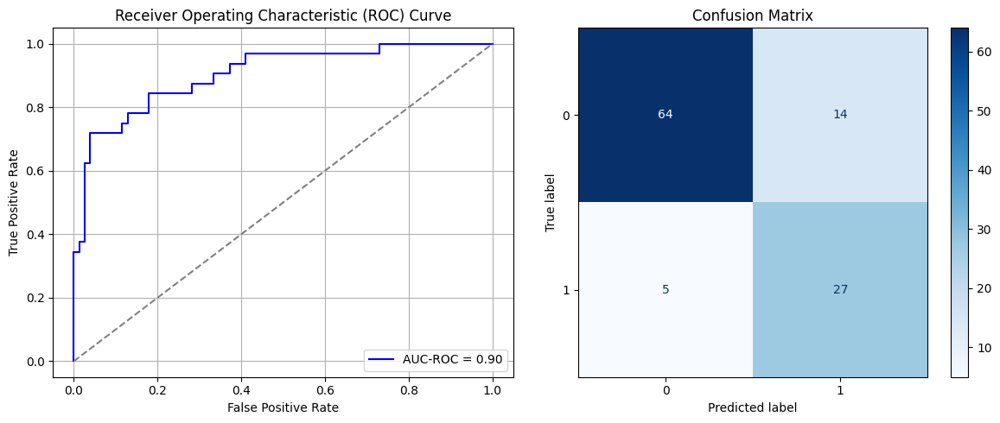

Best threshold based on F1-score: 0.8192622661590576
False Negative Rate: 0.15625
Time elapsed (performance): 0.518831751000107
(np.float64(0.1794871794871795), np.float64(0.8205128205128205))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - AUC: 0.6805 - loss: 0.6611 - val_AUC: 0.8698 - val_loss: 0.5361
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8623 - loss: 0.5025 - val_AUC: 0.8931 - val_loss: 0.4430
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8798 - loss: 0.4319 - val_AUC: 0.9056 - val_loss: 0.4028
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9019 - loss: 0.3922 - val_AUC: 0.9143 - val_loss: 0.3891
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8781 - loss: 0.4179 - val_AUC: 0.9194 - val_loss: 0.3875
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9016 - loss: 0.3832 - val_AUC: 0.9220 - val_loss: 0.3785
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9070 - loss: 0.3761 - val_AUC: 0.9249 - val_loss: 0.3722
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9021 - loss: 0.3725 - val_AUC: 0.9266 - val_loss: 0.3792
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9095 - loss: 0.3700 - v

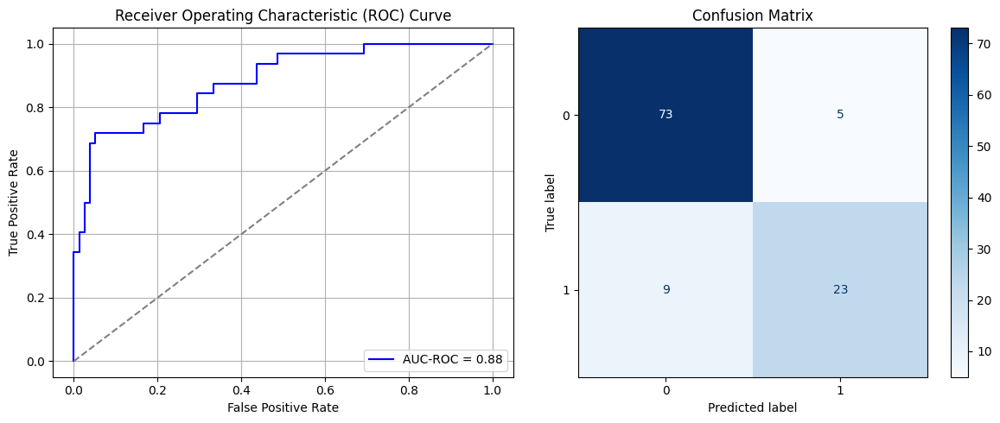

Best threshold based on F1-score: 0.6663135886192322
False Negative Rate: 0.28125
Time elapsed (performance): 0.4900639850002335
(np.float64(0.0641025641025641), np.float64(0.9358974358974359))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6968 - loss: 0.6433 - val_AUC: 0.8674 - val_loss: 0.5042
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8664 - loss: 0.4786 - val_AUC: 0.8885 - val_loss: 0.4422
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8959 - loss: 0.4043 - val_AUC: 0.9003 - val_loss: 0.4150
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9029 - loss: 0.3806 - val_AUC: 0.9073 - val_loss: 0.4022
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8993 - loss: 0.3867 - val_AUC: 0.9111 - val_loss: 0.3961
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9066 - loss: 0.3763 - val_AUC: 0.9148 - val_loss: 0.3890
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9180 - loss: 0.3499 - val_AUC: 0.9173 - val_loss: 0.3901
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9012 - loss: 0.3808 - val_AUC: 0.9198 - val_loss: 0.3797
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9162 - loss: 0.3576 - va

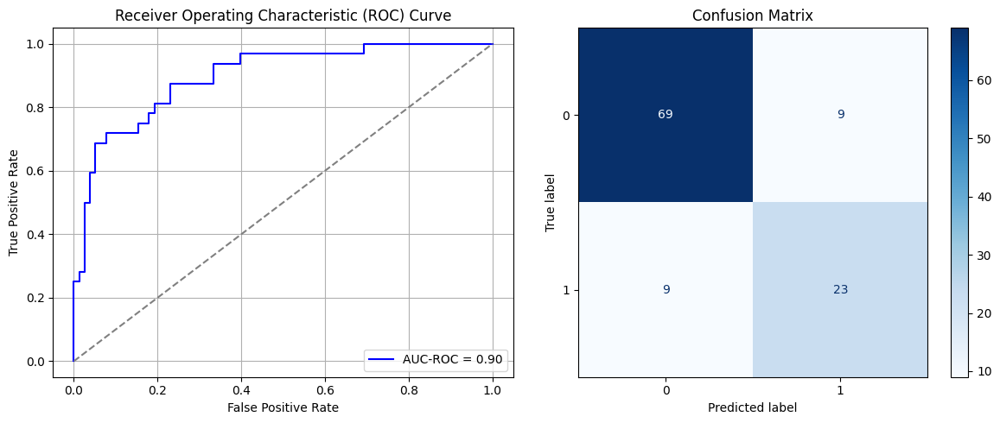

Best threshold based on F1-score: 0.759909451007843
False Negative Rate: 0.28125
Time elapsed (performance): 0.6869371109996791
(np.float64(0.11538461538461539), np.float64(0.8846153846153846))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.7249 - loss: 0.6431 - val_AUC: 0.8751 - val_loss: 0.5001
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8620 - loss: 0.4828 - val_AUC: 0.8985 - val_loss: 0.4129
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8896 - loss: 0.4113 - val_AUC: 0.9131 - val_loss: 0.3940
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8902 - loss: 0.4011 - val_AUC: 0.9212 - val_loss: 0.3717
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9026 - loss: 0.3859 - val_AUC: 0.9268 - val_loss: 0.3556
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9101 - loss: 0.3663 - val_AUC: 0.9314 - val_loss: 0.3567
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9244 - loss: 0.3341 - val_AUC: 0.9336 - val_loss: 0.3421
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9207 - loss: 0.3423 - val_AUC: 0.9357 - val_loss: 0.3433
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9203 - loss: 0.3450 - va

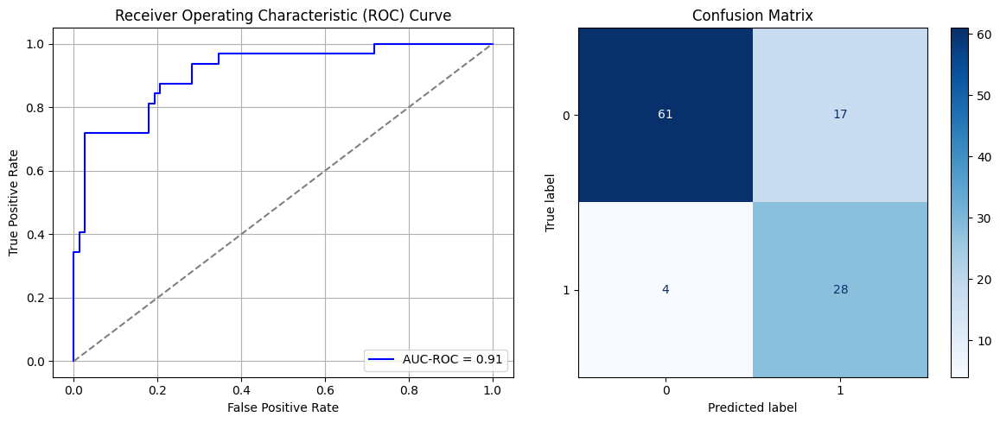

Best threshold based on F1-score: 0.9315723180770874
False Negative Rate: 0.125
Time elapsed (performance): 0.5083126789995731
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7121 - loss: 0.6436 - val_AUC: 0.8735 - val_loss: 0.5146
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8742 - loss: 0.4795 - val_AUC: 0.9020 - val_loss: 0.4356
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8827 - loss: 0.4254 - val_AUC: 0.9101 - val_loss: 0.3970
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9073 - loss: 0.3784 - val_AUC: 0.9177 - val_loss: 0.3768
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9103 - loss: 0.3706 - val_AUC: 0.9237 - val_loss: 0.3740
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9172 - loss: 0.3602 - val_AUC: 0.9256 - val_loss: 0.3755
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9006 - loss: 0.3761 - val_AUC: 0.9280 - val_loss: 0.3532
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9176 - loss: 0.3523 - val_AUC: 0.9304 - val_loss: 0.3497
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9158 - loss: 0.3490 - va

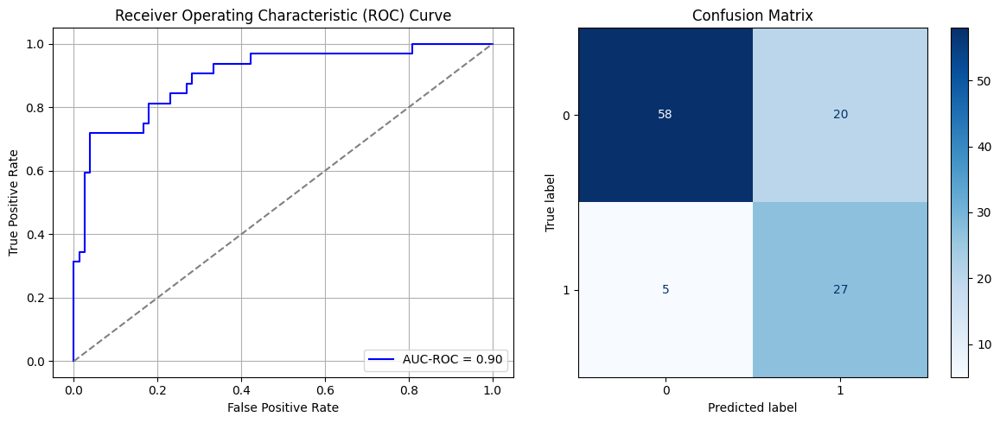

Best threshold based on F1-score: 0.8810083270072937
False Negative Rate: 0.15625
Time elapsed (performance): 0.6676787260003039
(np.float64(0.2564102564102564), np.float64(0.7435897435897436))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.6768 - loss: 0.6661 - val_AUC: 0.8503 - val_loss: 0.5520
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8649 - loss: 0.5140 - val_AUC: 0.8811 - val_loss: 0.4614
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8757 - loss: 0.4508 - val_AUC: 0.8944 - val_loss: 0.4156
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8943 - loss: 0.4098 - val_AUC: 0.9011 - val_loss: 0.4145
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9130 - loss: 0.3777 - val_AUC: 0.9066 - val_loss: 0.3920
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9002 - loss: 0.3883 - val_AUC: 0.9109 - val_loss: 0.3829
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9115 - loss: 0.3677 - val_AUC: 0.9140 - val_loss: 0.3807
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9160 - loss: 0.3619 - val_AUC: 0.9181 - val_loss: 0.3722
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9077 - loss: 0.3745 - va

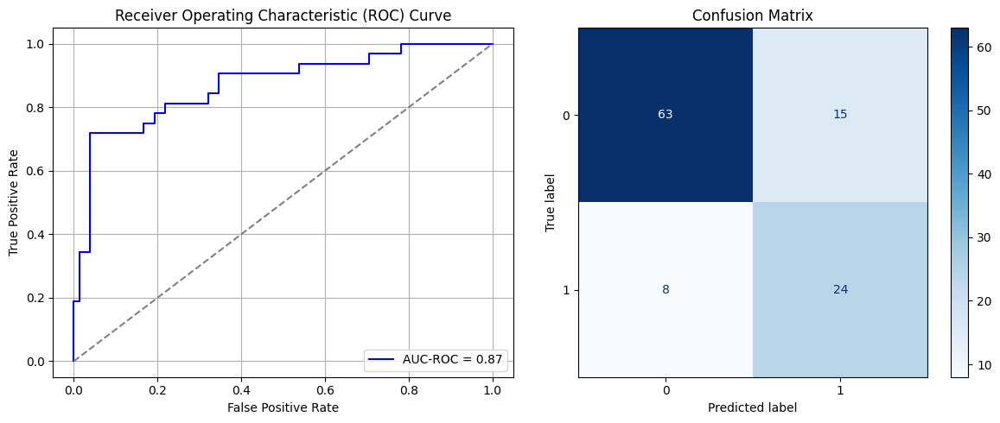

Best threshold based on F1-score: 0.8561210036277771
False Negative Rate: 0.25
Time elapsed (performance): 0.5233755970002676
(np.float64(0.19230769230769232), np.float64(0.8076923076923077))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.6668 - loss: 0.6614 - val_AUC: 0.8939 - val_loss: 0.5047
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8761 - loss: 0.4839 - val_AUC: 0.9222 - val_loss: 0.3955
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8877 - loss: 0.4228 - val_AUC: 0.9336 - val_loss: 0.3635
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9056 - loss: 0.3872 - val_AUC: 0.9389 - val_loss: 0.3449
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9070 - loss: 0.3801 - val_AUC: 0.9404 - val_loss: 0.3365
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9218 - loss: 0.3482 - val_AUC: 0.9428 - val_loss: 0.3427
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9152 - loss: 0.3595 - val_AUC: 0.9439 - val_loss: 0.3388
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9172 - loss: 0.3516 - val_AUC: 0.9449 - val_loss: 0.3207
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9072 - loss: 0.3724 - v

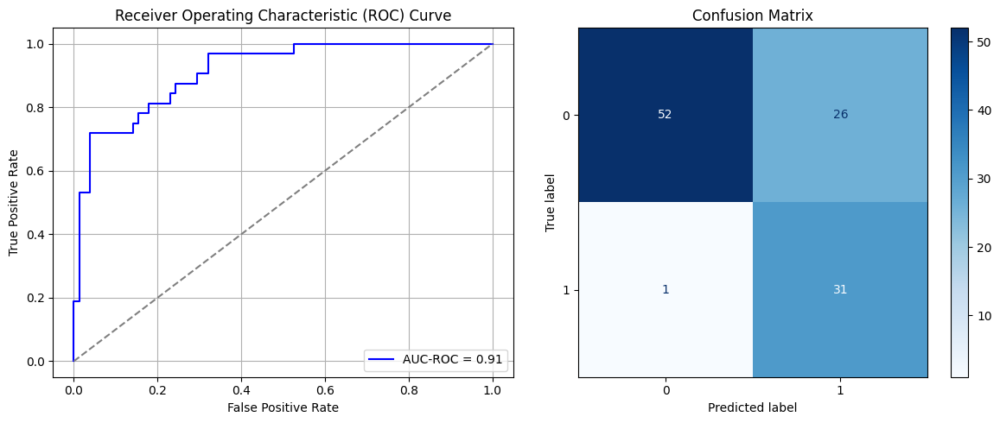

Best threshold based on F1-score: 0.9506540894508362
False Negative Rate: 0.03125
Time elapsed (performance): 0.4796619840008134
(np.float64(0.3333333333333333), np.float64(0.6666666666666667))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - AUC: 0.7467 - loss: 0.6313 - val_AUC: 0.8909 - val_loss: 0.4888
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8766 - loss: 0.4685 - val_AUC: 0.9111 - val_loss: 0.4072
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8826 - loss: 0.4282 - val_AUC: 0.9217 - val_loss: 0.3751
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9004 - loss: 0.3831 - val_AUC: 0.9282 - val_loss: 0.3721
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9062 - loss: 0.3785 - val_AUC: 0.9312 - val_loss: 0.3738
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9043 - loss: 0.3822 - val_AUC: 0.9317 - val_loss: 0.3492
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9154 - loss: 0.3601 - val_AUC: 0.9355 - val_loss: 0.3572
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9147 - loss: 0.3605 - val_AUC: 0.9361 - val_loss: 0.3350
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9203 - loss: 0.3423 - v

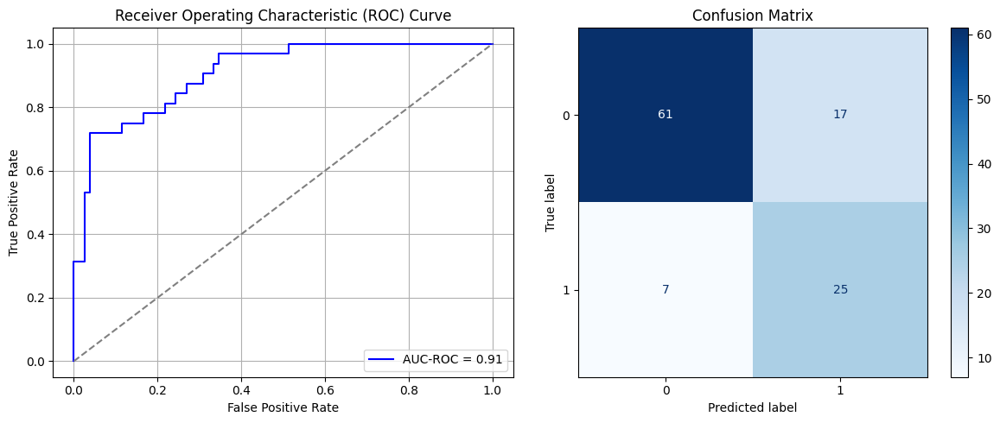

Best threshold based on F1-score: 0.8380745053291321
False Negative Rate: 0.21875
Time elapsed (performance): 0.4988186119999227
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7612 - loss: 0.6401 - val_AUC: 0.8280 - val_loss: 0.5511
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8437 - loss: 0.5154 - val_AUC: 0.8688 - val_loss: 0.4620
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8716 - loss: 0.4443 - val_AUC: 0.8910 - val_loss: 0.4269
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8950 - loss: 0.4033 - val_AUC: 0.9039 - val_loss: 0.4020
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8940 - loss: 0.4004 - val_AUC: 0.9114 - val_loss: 0.3869
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9102 - loss: 0.3745 - val_AUC: 0.9175 - val_loss: 0.3757
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8967 - loss: 0.3969 - val_AUC: 0.9182 - val_loss: 0.4052
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8941 - loss: 0.4026 - val_AUC: 0.9236 - val_loss: 0.3620
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9178 - loss: 0.3613 - va

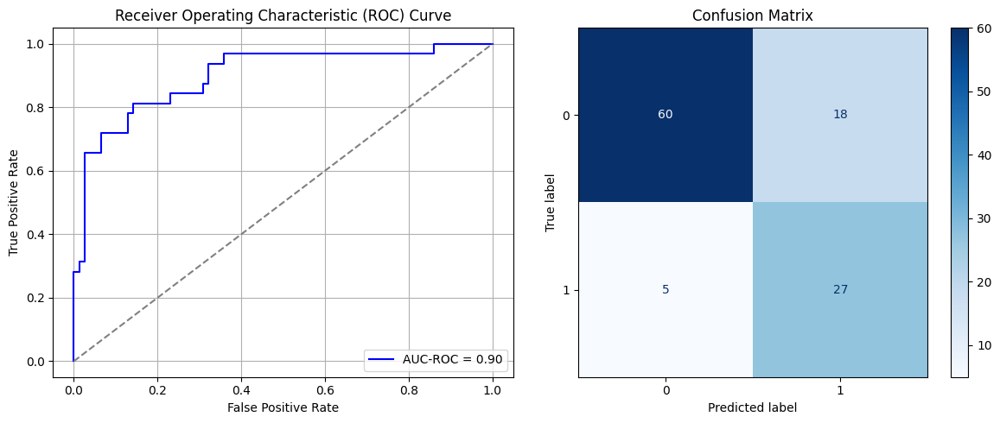

Best threshold based on F1-score: 0.853570282459259
False Negative Rate: 0.15625
Time elapsed (performance): 0.517320085999927
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.7484 - loss: 0.6347 - val_AUC: 0.8814 - val_loss: 0.5078
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8778 - loss: 0.4700 - val_AUC: 0.9082 - val_loss: 0.4175
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8890 - loss: 0.4110 - val_AUC: 0.9175 - val_loss: 0.3816
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8996 - loss: 0.3966 - val_AUC: 0.9243 - val_loss: 0.3763
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9089 - loss: 0.3777 - val_AUC: 0.9275 - val_loss: 0.3699
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9009 - loss: 0.3853 - val_AUC: 0.9299 - val_loss: 0.3737
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9175 - loss: 0.3615 - val_AUC: 0.9315 - val_loss: 0.3538
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9076 - loss: 0.3734 - val_AUC: 0.9320 - val_loss: 0.3684
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9220 - loss: 0.3455 - va

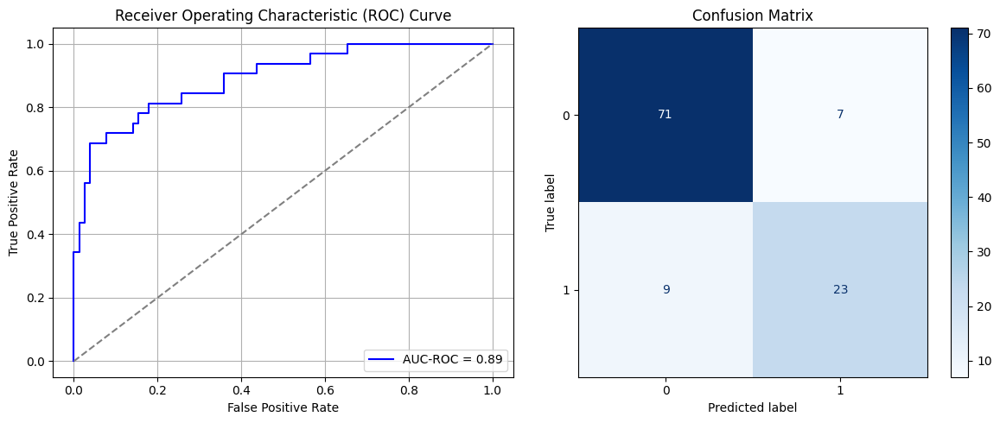

Best threshold based on F1-score: 0.7053013443946838
False Negative Rate: 0.28125
Time elapsed (performance): 0.501978197000426
(np.float64(0.08974358974358974), np.float64(0.9102564102564102))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - AUC: 0.6584 - loss: 0.6565 - val_AUC: 0.8728 - val_loss: 0.5066
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8658 - loss: 0.4835 - val_AUC: 0.8983 - val_loss: 0.4218
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8860 - loss: 0.4193 - val_AUC: 0.9107 - val_loss: 0.3892
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8996 - loss: 0.3975 - val_AUC: 0.9187 - val_loss: 0.3851
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8987 - loss: 0.3964 - val_AUC: 0.9230 - val_loss: 0.3657
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9109 - loss: 0.3713 - val_AUC: 0.9268 - val_loss: 0.3641
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9090 - loss: 0.3714 - val_AUC: 0.9291 - val_loss: 0.3652
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9164 - loss: 0.3627 - val_AUC: 0.9296 - val_loss: 0.3544
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9190 - loss: 0.3559 - v

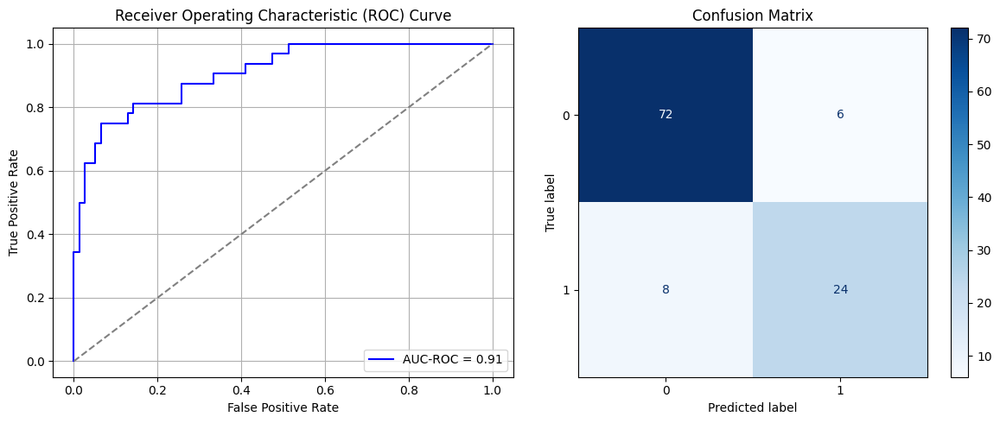

Best threshold based on F1-score: 0.5497172474861145
False Negative Rate: 0.25
Time elapsed (performance): 0.5249160200000915
(np.float64(0.07692307692307693), np.float64(0.9230769230769231))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - AUC: 0.7611 - loss: 0.6367 - val_AUC: 0.8623 - val_loss: 0.5041
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8629 - loss: 0.4773 - val_AUC: 0.8938 - val_loss: 0.4226
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8755 - loss: 0.4375 - val_AUC: 0.9048 - val_loss: 0.4101
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8941 - loss: 0.4090 - val_AUC: 0.9132 - val_loss: 0.3934
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8975 - loss: 0.3940 - val_AUC: 0.9188 - val_loss: 0.3764
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9105 - loss: 0.3714 - val_AUC: 0.9209 - val_loss: 0.3757
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9142 - loss: 0.3644 - val_AUC: 0.9235 - val_loss: 0.3662
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9101 - loss: 0.3668 - val_AUC: 0.9242 - val_loss: 0.3649
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9160 - loss: 0.3579 - v

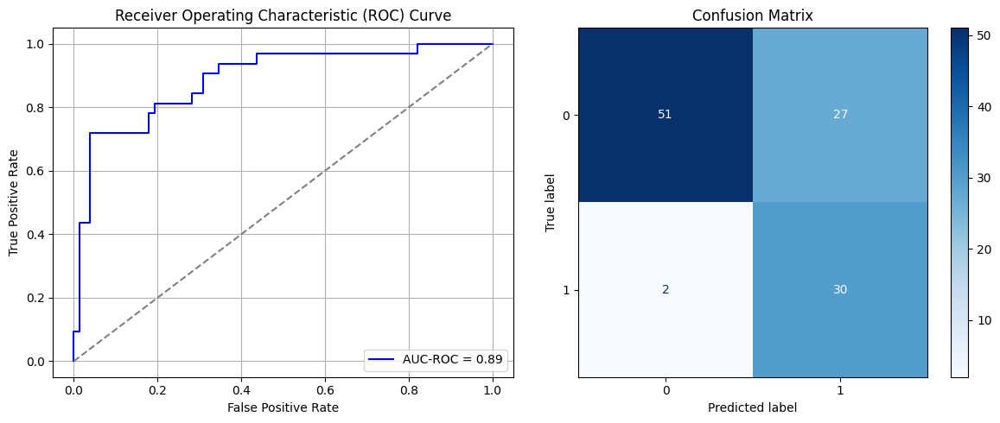

Best threshold based on F1-score: 0.9450660943984985
False Negative Rate: 0.0625
Time elapsed (performance): 0.5434119620003912
(np.float64(0.34615384615384615), np.float64(0.6538461538461539))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - AUC: 0.7449 - loss: 0.6242 - val_AUC: 0.8875 - val_loss: 0.4800
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8611 - loss: 0.4838 - val_AUC: 0.9125 - val_loss: 0.3967
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8917 - loss: 0.4164 - val_AUC: 0.9240 - val_loss: 0.3685
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8828 - loss: 0.4211 - val_AUC: 0.9305 - val_loss: 0.3539
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8861 - loss: 0.4120 - val_AUC: 0.9356 - val_loss: 0.3422
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9128 - loss: 0.3721 - val_AUC: 0.9361 - val_loss: 0.3477
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9120 - loss: 0.3744 - val_AUC: 0.9387 - val_loss: 0.3442
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9165 - loss: 0.3659 - val_AUC: 0.9393 - val_loss: 0.3464
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9144 - loss: 0.3622 - v

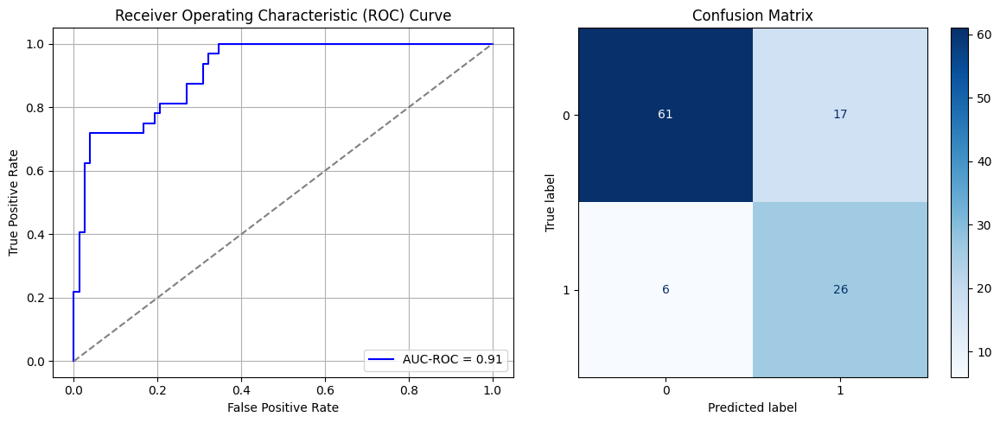

Best threshold based on F1-score: 0.9178581237792969
False Negative Rate: 0.1875
Time elapsed (performance): 0.523235661000399
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - AUC: 0.6249 - loss: 0.6673 - val_AUC: 0.8752 - val_loss: 0.5320
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8662 - loss: 0.4911 - val_AUC: 0.9021 - val_loss: 0.4418
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8893 - loss: 0.4217 - val_AUC: 0.9142 - val_loss: 0.3932
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8943 - loss: 0.4012 - val_AUC: 0.9191 - val_loss: 0.3767
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9067 - loss: 0.3778 - val_AUC: 0.9235 - val_loss: 0.3638
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9071 - loss: 0.3773 - val_AUC: 0.9258 - val_loss: 0.3555
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9031 - loss: 0.3754 - val_AUC: 0.9276 - val_loss: 0.3503
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9215 - loss: 0.3463 - val_AUC: 0.9278 - val_loss: 0.3498
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.9178 - loss: 0.3543 - v

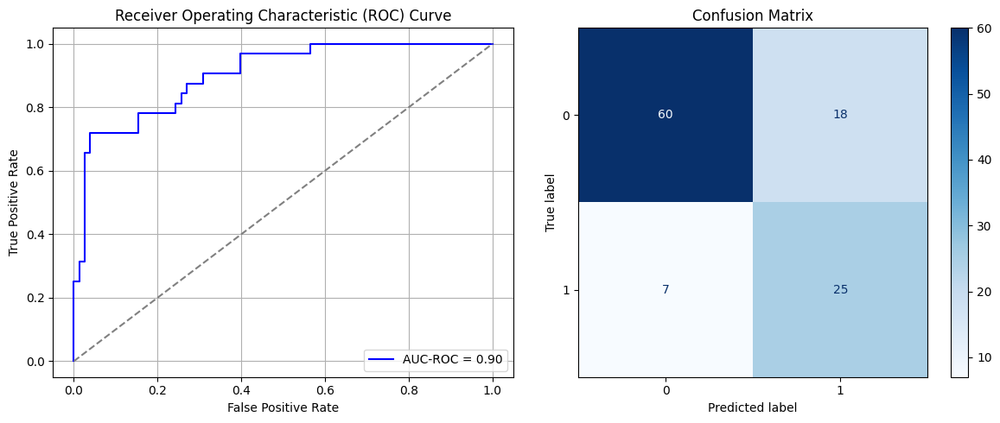

Best threshold based on F1-score: 0.8983647227287292
False Negative Rate: 0.21875
Time elapsed (performance): 0.5564544179997029
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - AUC: 0.6582 - loss: 0.6710 - val_AUC: 0.8384 - val_loss: 0.5635
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8486 - loss: 0.5252 - val_AUC: 0.8843 - val_loss: 0.4533
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8839 - loss: 0.4337 - val_AUC: 0.9015 - val_loss: 0.4112
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8902 - loss: 0.4132 - val_AUC: 0.9097 - val_loss: 0.3887
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8901 - loss: 0.4075 - val_AUC: 0.9156 - val_loss: 0.3802
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9166 - loss: 0.3581 - val_AUC: 0.9187 - val_loss: 0.3703
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8978 - loss: 0.3912 - val_AUC: 0.9212 - val_loss: 0.4283
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9130 - loss: 0.3645 - val_AUC: 0.9258 - val_loss: 0.3594
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9156 - loss: 0.3590 - v

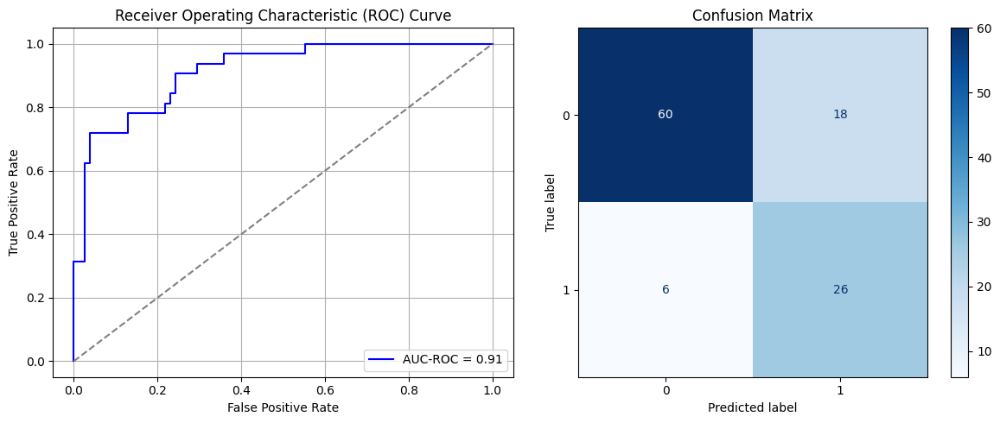

Best threshold based on F1-score: 0.866023600101471
False Negative Rate: 0.1875
Time elapsed (performance): 0.49771848599993973
(np.float64(0.23076923076923078), np.float64(0.7692307692307692))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - AUC: 0.7612 - loss: 0.6269 - val_AUC: 0.8728 - val_loss: 0.4981
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8741 - loss: 0.4638 - val_AUC: 0.9040 - val_loss: 0.4195
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9004 - loss: 0.3984 - val_AUC: 0.9176 - val_loss: 0.3876
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.8897 - loss: 0.4088 - val_AUC: 0.9253 - val_loss: 0.3925
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9016 - loss: 0.3963 - val_AUC: 0.9305 - val_loss: 0.3718
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9080 - loss: 0.3744 - val_AUC: 0.9328 - val_loss: 0.3638
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9158 - loss: 0.3594 - val_AUC: 0.9334 - val_loss: 0.3897
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9059 - loss: 0.3840 - val_AUC: 0.9352 - val_loss: 0.3445
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - AUC: 0.9223 - loss: 0.3451 - v

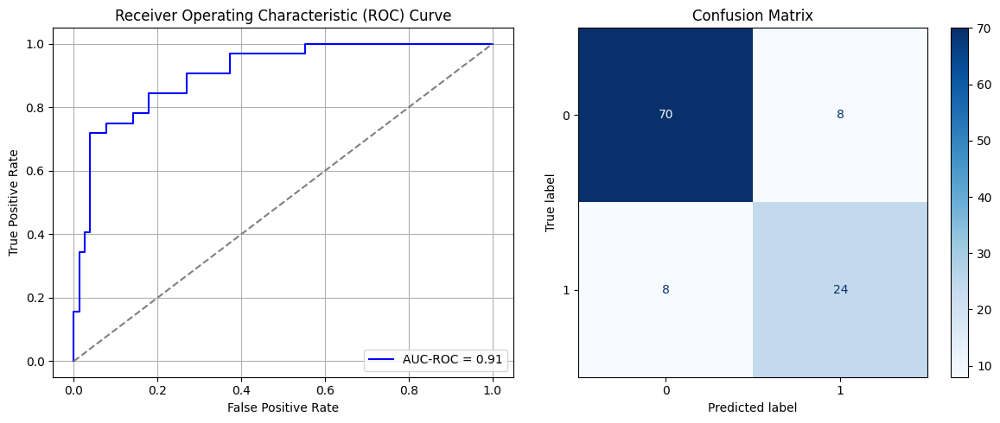

Best threshold based on F1-score: 0.7631419897079468
False Negative Rate: 0.25
Time elapsed (performance): 0.5403419160002159
(np.float64(0.10256410256410256), np.float64(0.8974358974358975))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - AUC: 0.7416 - loss: 0.6400 - val_AUC: 0.8601 - val_loss: 0.5115
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8759 - loss: 0.4612 - val_AUC: 0.8864 - val_loss: 0.4359
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8921 - loss: 0.4037 - val_AUC: 0.9029 - val_loss: 0.4067
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8983 - loss: 0.3903 - val_AUC: 0.9115 - val_loss: 0.3906
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9041 - loss: 0.3772 - val_AUC: 0.9180 - val_loss: 0.4198
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9081 - loss: 0.3737 - val_AUC: 0.9217 - val_loss: 0.3762
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9168 - loss: 0.3478 - val_AUC: 0.9242 - val_loss: 0.3845
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9077 - loss: 0.3721 - val_AUC: 0.9255 - val_loss: 0.3622
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9106 - loss: 0.3619 - v

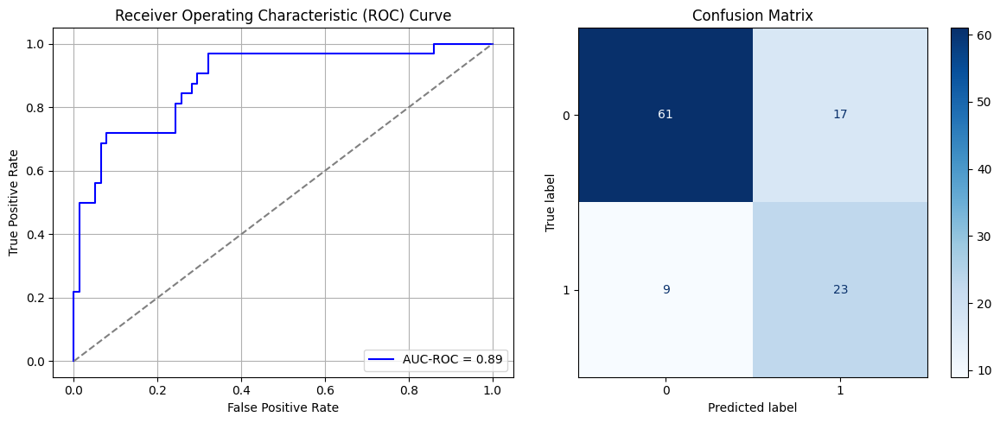

Best threshold based on F1-score: 0.8016217350959778
False Negative Rate: 0.28125
Time elapsed (performance): 0.6816803829997298
(np.float64(0.21794871794871795), np.float64(0.782051282051282))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - AUC: 0.7807 - loss: 0.6485 - val_AUC: 0.8749 - val_loss: 0.5378
Epoch 2/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - AUC: 0.8729 - loss: 0.4965 - val_AUC: 0.8942 - val_loss: 0.4369
Epoch 3/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8726 - loss: 0.4503 - val_AUC: 0.9046 - val_loss: 0.4084
Epoch 4/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8806 - loss: 0.4356 - val_AUC: 0.9116 - val_loss: 0.3911
Epoch 5/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8895 - loss: 0.4108 - val_AUC: 0.9153 - val_loss: 0.3859
Epoch 6/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.8992 - loss: 0.3856 - val_AUC: 0.9191 - val_loss: 0.3724
Epoch 7/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9046 - loss: 0.3818 - val_AUC: 0.9205 - val_loss: 0.3820
Epoch 8/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9059 - loss: 0.3822 - val_AUC: 0.9234 - val_loss: 0.3593
Epoch 9/10
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - AUC: 0.9115 - loss: 0.3684 - v

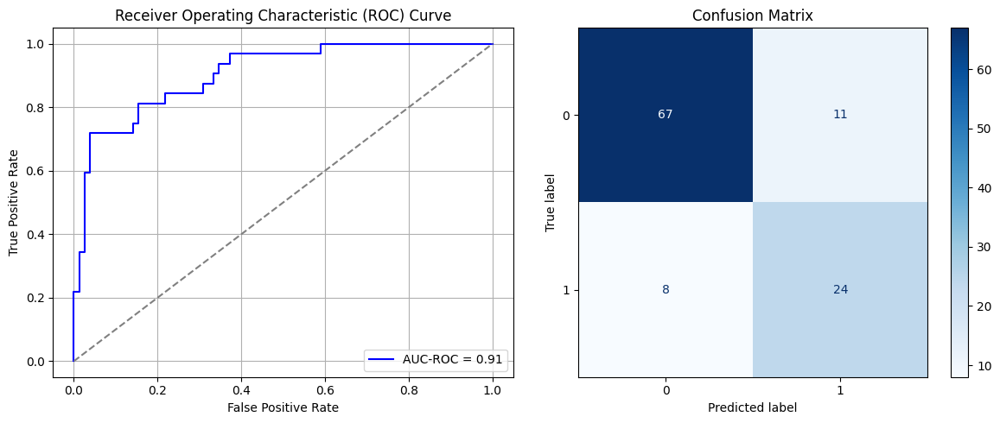

Best threshold based on F1-score: 0.7580199241638184
False Negative Rate: 0.25
Time elapsed (performance): 0.5750628590003544
(np.float64(0.14102564102564102), np.float64(0.858974358974359))
    Source time       FPR       TNR      FNR      TPR  Target time
0      8.658368  0.230769  0.769231  0.15625  0.84375     0.464586
1      4.776161  0.269231  0.730769  0.18750  0.81250     0.480357
2      5.732298  0.371795  0.628205  0.03125  0.96875     0.417256
3      4.946169  0.269231  0.730769  0.12500  0.87500     0.470389
4      6.129743  0.294872  0.705128  0.12500  0.87500     0.411969
5      4.926388  0.230769  0.769231  0.18750  0.81250     0.445657
6      6.238936  0.128205  0.871795  0.25000  0.75000     4.167277
7      6.432286  0.256410  0.743590  0.18750  0.81250     0.502074
8      5.127719  0.256410  0.743590  0.21875  0.78125     0.442468
9      6.348536  0.217949  0.782051  0.18750  0.81250     0.520044
10     5.079910  0.230769  0.769231  0.12500  0.87500     0.472617
11   

In [70]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

m = 10

k = oversample_size/undersample_size * m
print(k)

# np.random.seed(123)

for i in range(times):
    start = np.random.choice(int(k), 10)
    # print(start)

    Row = []

    Row = []

    for j in range(len(start)):
      for l in range(int(undersample_size/m)):
        row = start[j]+int(k*l)-1
        Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)

In [71]:
print(ParamFit)
ParamFit.to_csv('Sy2_RUS.csv')

    Source time       FPR       TNR      FNR      TPR  Target time
0      8.658368  0.230769  0.769231  0.15625  0.84375     0.464586
1      4.776161  0.269231  0.730769  0.18750  0.81250     0.480357
2      5.732298  0.371795  0.628205  0.03125  0.96875     0.417256
3      4.946169  0.269231  0.730769  0.12500  0.87500     0.470389
4      6.129743  0.294872  0.705128  0.12500  0.87500     0.411969
5      4.926388  0.230769  0.769231  0.18750  0.81250     0.445657
6      6.238936  0.128205  0.871795  0.25000  0.75000     4.167277
7      6.432286  0.256410  0.743590  0.18750  0.81250     0.502074
8      5.127719  0.256410  0.743590  0.21875  0.78125     0.442468
9      6.348536  0.217949  0.782051  0.18750  0.81250     0.520044
10     5.079910  0.230769  0.769231  0.12500  0.87500     0.472617
11     6.744455  0.205128  0.794872  0.18750  0.81250     0.478563
12     5.199268  0.333333  0.666667  0.06250  0.93750     0.481894
13     6.384933  0.397436  0.602564  0.06250  0.93750     0.48

# Random Oversampling (ROS):

## Simple Random Sampling with Replacement:

In this case, we investigate the effectiveness of Random Oversampling methods, beginning with Simple Random Sampling (SRS) with replacement. For this, we perform random resampling from the minority class of size $N_1$ to generate an additional sample of size $N_0-N_1$, such that the oversampled minority class will have the same size as the majority class.

In [72]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

1389
2925


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 4s 13ms/step - AUC: 0.7959 - loss: 0.5898 - val_AUC: 0.8830 - val_loss: 0.4401
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - AUC: 0.8935 - loss: 0.4073 - val_AUC: 0.8991 - val_loss: 0.4060
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9083 - loss: 0.3697 - val_AUC: 0.9069 - val_loss: 0.3957
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.9200 - loss: 0.3531 - val_AUC: 0.9075 - val_loss: 0.4061
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - AUC: 0.9277 - loss: 0.3327 - val_AUC: 0.9088 - val_loss: 0.4156
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.9192 - loss: 0.3541 - val_AUC: 0.9076 - val_loss: 0.4018
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9245 - loss: 0.3370 - val_AUC: 0.9088 - val_loss: 0.3998
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - AUC: 0.9293 - loss: 0.3266 - val_AUC: 0.9078 - val_loss: 0.3971
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - AUC: 0.933

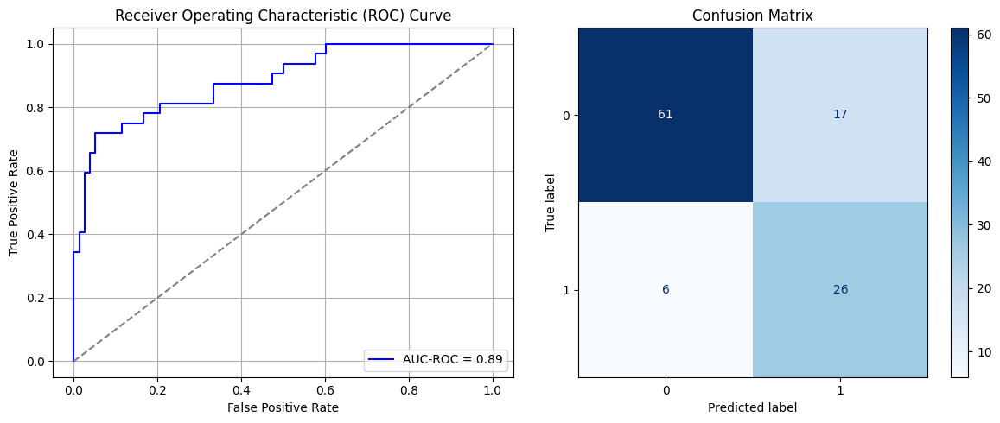

Best threshold based on F1-score: 0.9064522385597229
False Negative Rate: 0.1875
Time elapsed (performance): 0.47148278699933144
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7852 - loss: 0.6054 - val_AUC: 0.8667 - val_loss: 0.4592
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8990 - loss: 0.4012 - val_AUC: 0.8829 - val_loss: 0.4565
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9030 - loss: 0.3914 - val_AUC: 0.8903 - val_loss: 0.4210
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9184 - loss: 0.3586 - val_AUC: 0.8932 - val_loss: 0.4175
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9152 - loss: 0.3570 - val_AUC: 0.8977 - val_loss: 0.4145
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9235 - loss: 0.3479 - val_AUC: 0.8983 - val_loss: 0.4325
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9268 - loss: 0.3380 - val_AUC: 0.8987 - val_loss: 0.4127
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9176 - loss: 0.3572 - val_AUC: 0.9009 - val_loss: 0.4121
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9279 -

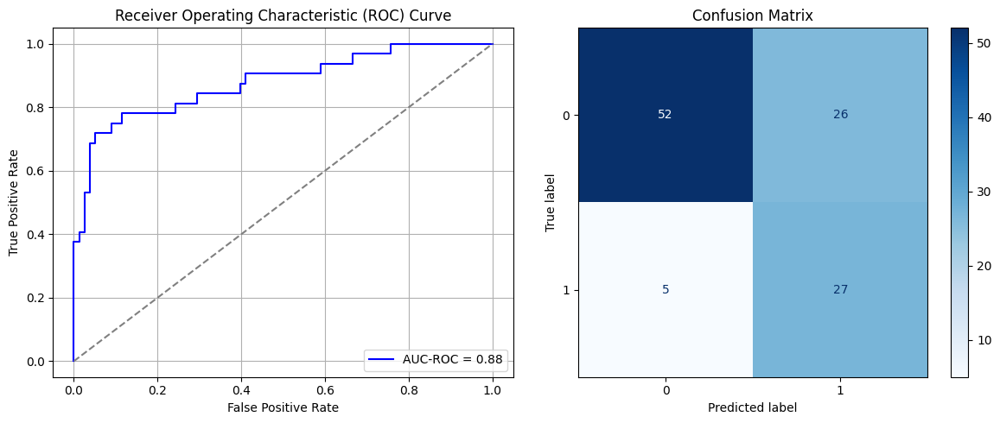

Best threshold based on F1-score: 0.9345743656158447
False Negative Rate: 0.15625
Time elapsed (performance): 0.4688029420003659
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7887 - loss: 0.6126 - val_AUC: 0.8769 - val_loss: 0.4408
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8966 - loss: 0.4022 - val_AUC: 0.8882 - val_loss: 0.4217
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9092 - loss: 0.3772 - val_AUC: 0.8925 - val_loss: 0.4180
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9124 - loss: 0.3643 - val_AUC: 0.8935 - val_loss: 0.4224
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9265 - loss: 0.3434 - val_AUC: 0.8935 - val_loss: 0.4178
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9303 - loss: 0.3295 - val_AUC: 0.8934 - val_loss: 0.4190
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9221 - loss: 0.3462 - val_AUC: 0.8943 - val_loss: 0.4234
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9330 - loss: 0.3275 - val_AUC: 0.8953 - val_loss: 0.4164
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9310 -

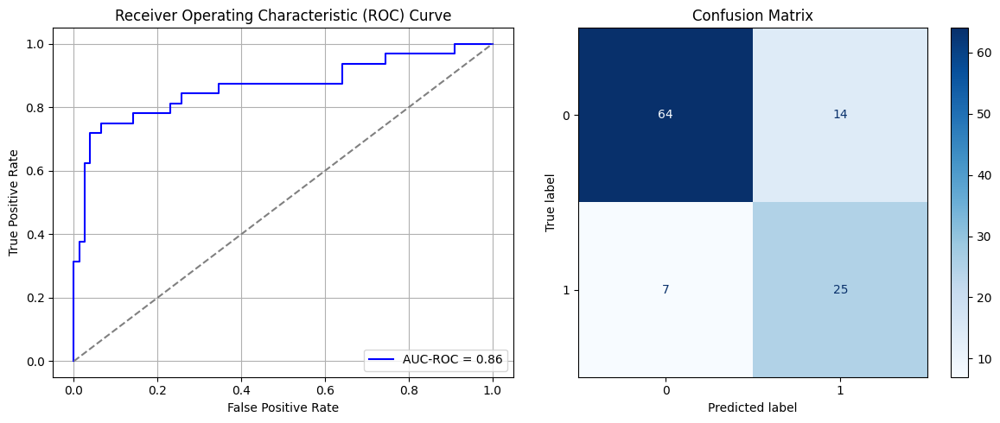

Best threshold based on F1-score: 0.8392230868339539
False Negative Rate: 0.21875
Time elapsed (performance): 0.4912719889998698
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7262 - loss: 0.6212 - val_AUC: 0.8663 - val_loss: 0.4631
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8752 - loss: 0.4426 - val_AUC: 0.8863 - val_loss: 0.4254
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9039 - loss: 0.3861 - val_AUC: 0.8911 - val_loss: 0.4632
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9106 - loss: 0.3728 - val_AUC: 0.8982 - val_loss: 0.4199
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9166 - loss: 0.3617 - val_AUC: 0.8977 - val_loss: 0.4097
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9138 - loss: 0.3640 - val_AUC: 0.8998 - val_loss: 0.4199
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9218 - loss: 0.3523 - val_AUC: 0.8994 - val_loss: 0.4153
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9271 - loss: 0.3354 - val_AUC: 0.9009 - val_loss: 0.4116
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9331 -

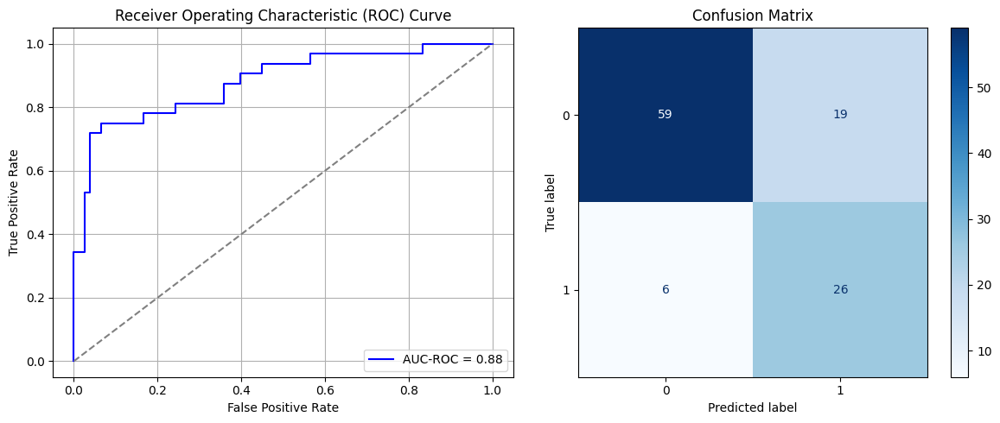

Best threshold based on F1-score: 0.9039612412452698
False Negative Rate: 0.1875
Time elapsed (performance): 0.6546833270003845
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7785 - loss: 0.6075 - val_AUC: 0.8718 - val_loss: 0.4557
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8946 - loss: 0.4131 - val_AUC: 0.8850 - val_loss: 0.4239
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9062 - loss: 0.3825 - val_AUC: 0.8900 - val_loss: 0.4173
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9212 - loss: 0.3521 - val_AUC: 0.8936 - val_loss: 0.4170
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9230 - loss: 0.3487 - val_AUC: 0.8932 - val_loss: 0.4255
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9228 - loss: 0.3492 - val_AUC: 0.8943 - val_loss: 0.4145
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9179 - loss: 0.3621 - val_AUC: 0.8953 - val_loss: 0.4261
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9225 - loss: 0.3514 - val_AUC: 0.8967 - val_loss: 0.4370
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9231 -

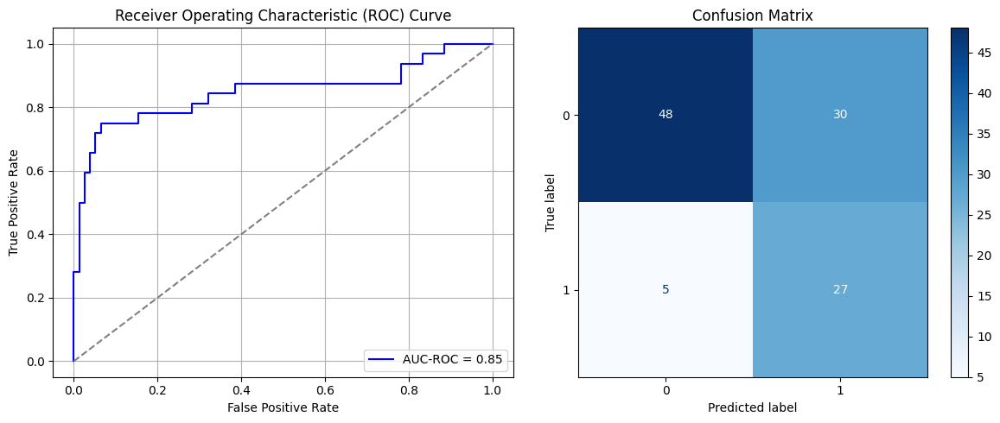

Best threshold based on F1-score: 0.9150946736335754
False Negative Rate: 0.15625
Time elapsed (performance): 0.4667226279998431
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7282 - loss: 0.6108 - val_AUC: 0.8550 - val_loss: 0.4742
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8874 - loss: 0.4212 - val_AUC: 0.8805 - val_loss: 0.4335
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9173 - loss: 0.3610 - val_AUC: 0.8894 - val_loss: 0.4240
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9156 - loss: 0.3612 - val_AUC: 0.8918 - val_loss: 0.4301
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9226 - loss: 0.3472 - val_AUC: 0.8941 - val_loss: 0.4177
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9264 - loss: 0.3436 - val_AUC: 0.8907 - val_loss: 0.4299
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9222 - loss: 0.3424 - val_AUC: 0.8961 - val_loss: 0.4189
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9320 - loss: 0.3244 - val_AUC: 0.8947 - val_loss: 0.4171
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9248 -

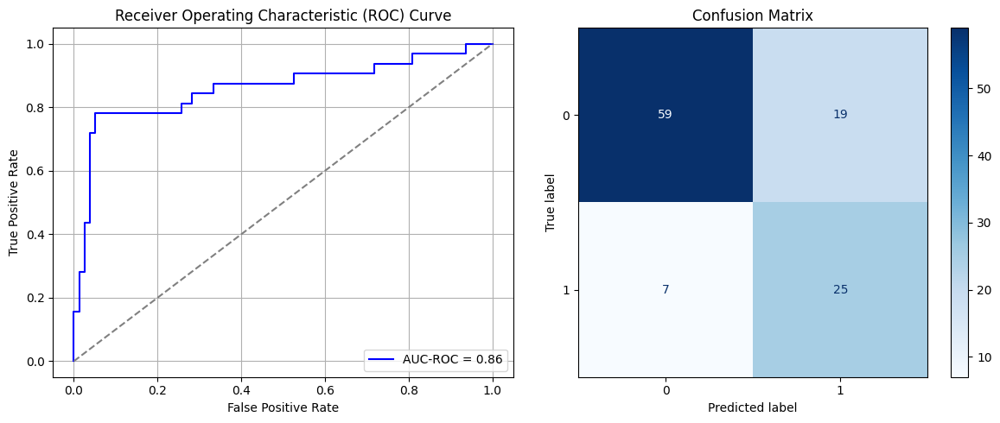

Best threshold based on F1-score: 0.8356949090957642
False Negative Rate: 0.21875
Time elapsed (performance): 0.4796180559997083
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7860 - loss: 0.5970 - val_AUC: 0.8721 - val_loss: 0.4512
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9057 - loss: 0.3850 - val_AUC: 0.8880 - val_loss: 0.4269
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9105 - loss: 0.3698 - val_AUC: 0.8929 - val_loss: 0.4205
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9283 - loss: 0.3376 - val_AUC: 0.8946 - val_loss: 0.4301
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9184 - loss: 0.3527 - val_AUC: 0.8934 - val_loss: 0.4302
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9349 - loss: 0.3177 - val_AUC: 0.8965 - val_loss: 0.4187
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9211 - loss: 0.3463 - val_AUC: 0.8951 - val_loss: 0.4244
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9372 - loss: 0.3133 - val_AUC: 0.8973 - val_loss: 0.4471
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9345 -

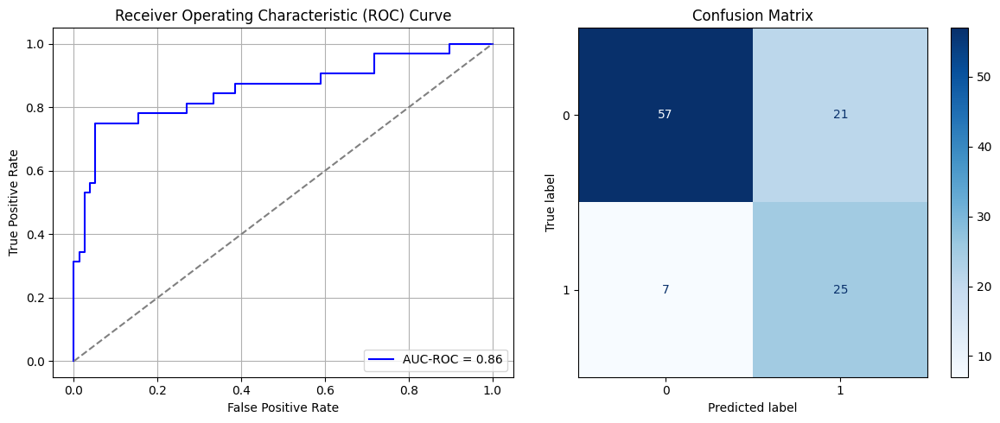

Best threshold based on F1-score: 0.8749786019325256
False Negative Rate: 0.21875
Time elapsed (performance): 0.6647457899998699
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7788 - loss: 0.6102 - val_AUC: 0.8793 - val_loss: 0.4441
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8834 - loss: 0.4221 - val_AUC: 0.8928 - val_loss: 0.4139
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9153 - loss: 0.3664 - val_AUC: 0.9000 - val_loss: 0.4024
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9159 - loss: 0.3611 - val_AUC: 0.9030 - val_loss: 0.3973
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9220 - loss: 0.3491 - val_AUC: 0.9012 - val_loss: 0.4213
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9266 - loss: 0.3376 - val_AUC: 0.9052 - val_loss: 0.3966
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9257 - loss: 0.3389 - val_AUC: 0.9071 - val_loss: 0.3920
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9248 - loss: 0.3378 - val_AUC: 0.9050 - val_loss: 0.3992
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9301 -

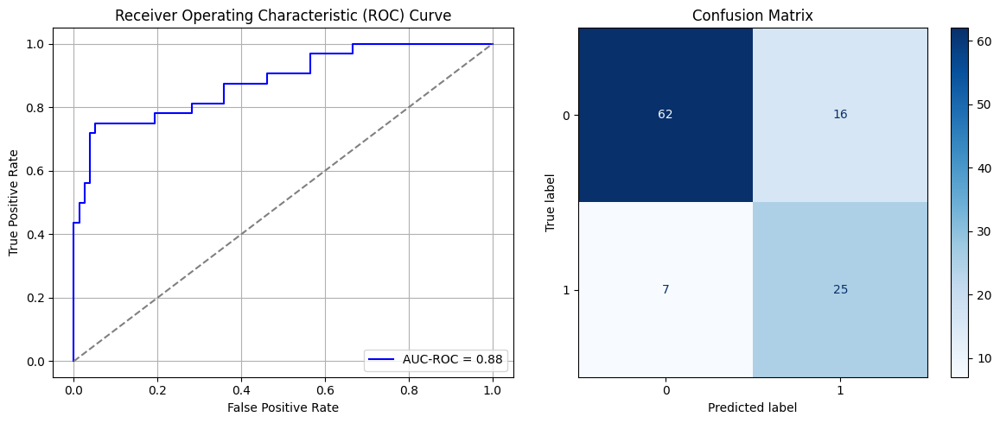

Best threshold based on F1-score: 0.7580294013023376
False Negative Rate: 0.21875
Time elapsed (performance): 0.49156072699952347
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7534 - loss: 0.6110 - val_AUC: 0.8768 - val_loss: 0.4563
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8938 - loss: 0.4105 - val_AUC: 0.8887 - val_loss: 0.4261
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9071 - loss: 0.3788 - val_AUC: 0.8959 - val_loss: 0.4116
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9078 - loss: 0.3766 - val_AUC: 0.9005 - val_loss: 0.4030
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9263 - loss: 0.3362 - val_AUC: 0.9010 - val_loss: 0.4047
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9205 - loss: 0.3488 - val_AUC: 0.9033 - val_loss: 0.4036
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9290 - loss: 0.3335 - val_AUC: 0.9038 - val_loss: 0.3991
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9303 - loss: 0.3292 - val_AUC: 0.9029 - val_loss: 0.4132
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9308 -

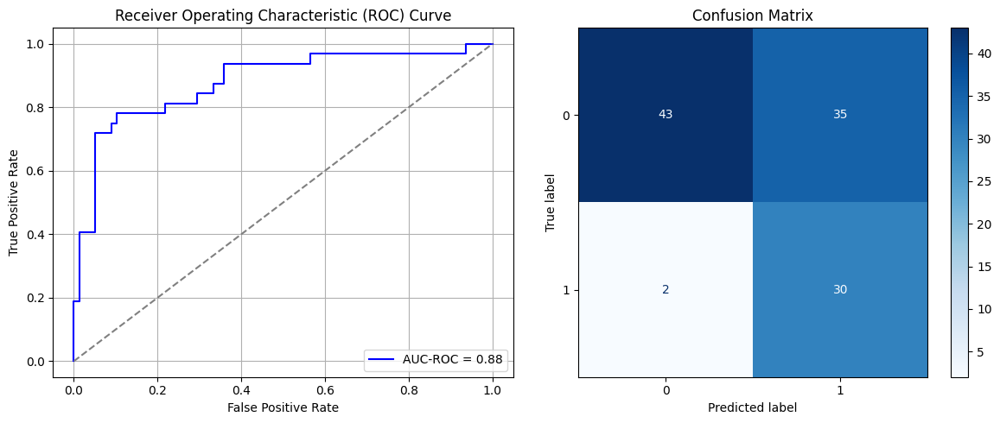

Best threshold based on F1-score: 0.9760172367095947
False Negative Rate: 0.0625
Time elapsed (performance): 0.48174282599939033
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7534 - loss: 0.6051 - val_AUC: 0.8620 - val_loss: 0.4669
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4352 - val_AUC: 0.8905 - val_loss: 0.4228
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9145 - loss: 0.3714 - val_AUC: 0.8981 - val_loss: 0.4132
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9103 - loss: 0.3733 - val_AUC: 0.9021 - val_loss: 0.4033
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9195 - loss: 0.3508 - val_AUC: 0.9037 - val_loss: 0.4026
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9225 - loss: 0.3425 - val_AUC: 0.9041 - val_loss: 0.4013
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9238 - loss: 0.3486 - val_AUC: 0.9052 - val_loss: 0.4057
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9177 - loss: 0.3545 - val_AUC: 0.9054 - val_loss: 0.4043
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9271 -

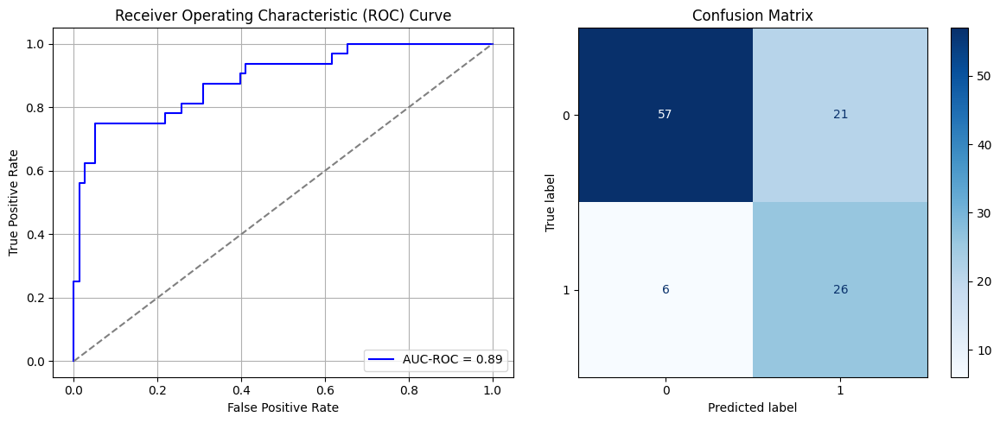

Best threshold based on F1-score: 0.9074756503105164
False Negative Rate: 0.1875
Time elapsed (performance): 0.48257434100014507
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7631 - loss: 0.6184 - val_AUC: 0.8738 - val_loss: 0.4566
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8830 - loss: 0.4290 - val_AUC: 0.8962 - val_loss: 0.4158
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9123 - loss: 0.3693 - val_AUC: 0.9025 - val_loss: 0.4068
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9068 - loss: 0.3800 - val_AUC: 0.9063 - val_loss: 0.3989
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9200 - loss: 0.3507 - val_AUC: 0.9068 - val_loss: 0.3977
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9160 - loss: 0.3629 - val_AUC: 0.9078 - val_loss: 0.4076
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9211 - loss: 0.3501 - val_AUC: 0.9078 - val_loss: 0.3997
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9292 - loss: 0.3334 - val_AUC: 0.9082 - val_loss: 0.4044
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9301 -

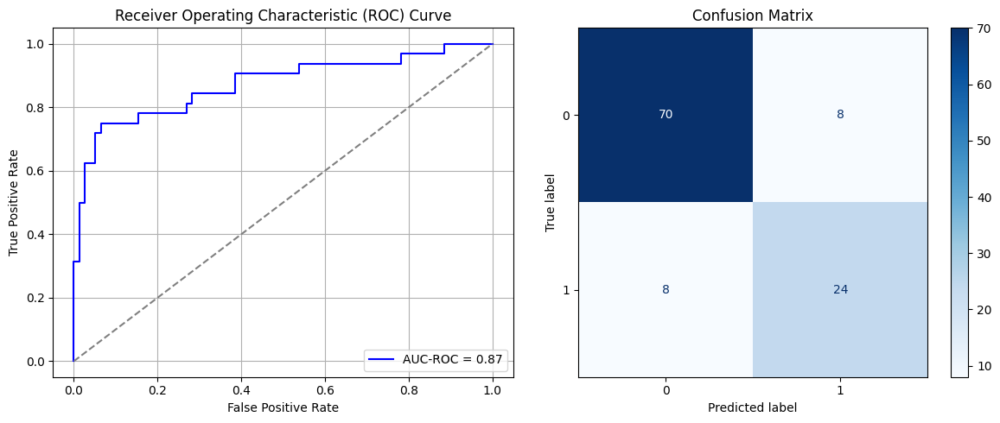

Best threshold based on F1-score: 0.6384127736091614
False Negative Rate: 0.25
Time elapsed (performance): 0.5078001739993852
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.7304 - loss: 0.6200 - val_AUC: 0.8565 - val_loss: 0.4772
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8962 - loss: 0.4023 - val_AUC: 0.8812 - val_loss: 0.4352
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9081 - loss: 0.3756 - val_AUC: 0.8871 - val_loss: 0.4350
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9169 - loss: 0.3579 - val_AUC: 0.8919 - val_loss: 0.4181
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9202 - loss: 0.3493 - val_AUC: 0.8944 - val_loss: 0.4174
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9241 - loss: 0.3435 - val_AUC: 0.8945 - val_loss: 0.4150
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9212 - loss: 0.3481 - val_AUC: 0.8917 - val_loss: 0.4246
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9283 - loss: 0.3299 - val_AUC: 0.8950 - val_loss: 0.4152
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9325 -

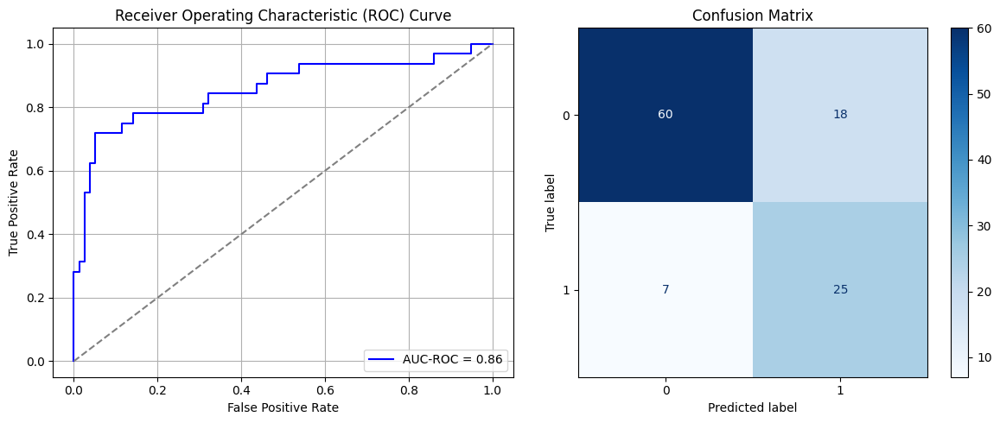

Best threshold based on F1-score: 0.8691956996917725
False Negative Rate: 0.21875
Time elapsed (performance): 0.4831013670000175
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7954 - loss: 0.6021 - val_AUC: 0.8582 - val_loss: 0.4740
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8934 - loss: 0.4137 - val_AUC: 0.8818 - val_loss: 0.4329
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9086 - loss: 0.3763 - val_AUC: 0.8940 - val_loss: 0.4139
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9184 - loss: 0.3574 - val_AUC: 0.8968 - val_loss: 0.4121
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9207 - loss: 0.3514 - val_AUC: 0.9004 - val_loss: 0.4068
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9290 - loss: 0.3340 - val_AUC: 0.9021 - val_loss: 0.4045
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9288 - loss: 0.3336 - val_AUC: 0.9037 - val_loss: 0.4132
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9291 - loss: 0.3337 - val_AUC: 0.9025 - val_loss: 0.4118
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9300 -

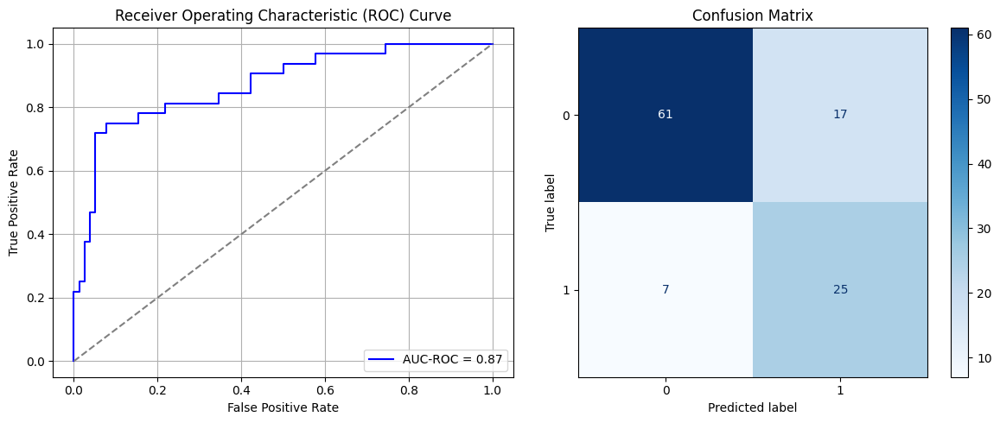

Best threshold based on F1-score: 0.903344988822937
False Negative Rate: 0.21875
Time elapsed (performance): 0.48879108399978577
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7702 - loss: 0.6123 - val_AUC: 0.8643 - val_loss: 0.4589
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8906 - loss: 0.4177 - val_AUC: 0.8870 - val_loss: 0.4276
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9163 - loss: 0.3631 - val_AUC: 0.8955 - val_loss: 0.4053
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9137 - loss: 0.3639 - val_AUC: 0.8986 - val_loss: 0.4047
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9206 - loss: 0.3537 - val_AUC: 0.9003 - val_loss: 0.4001
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9179 - loss: 0.3605 - val_AUC: 0.9012 - val_loss: 0.4006
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9238 - loss: 0.3428 - val_AUC: 0.9031 - val_loss: 0.4042
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9370 - loss: 0.3149 - val_AUC: 0.9041 - val_loss: 0.3947
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9301 -

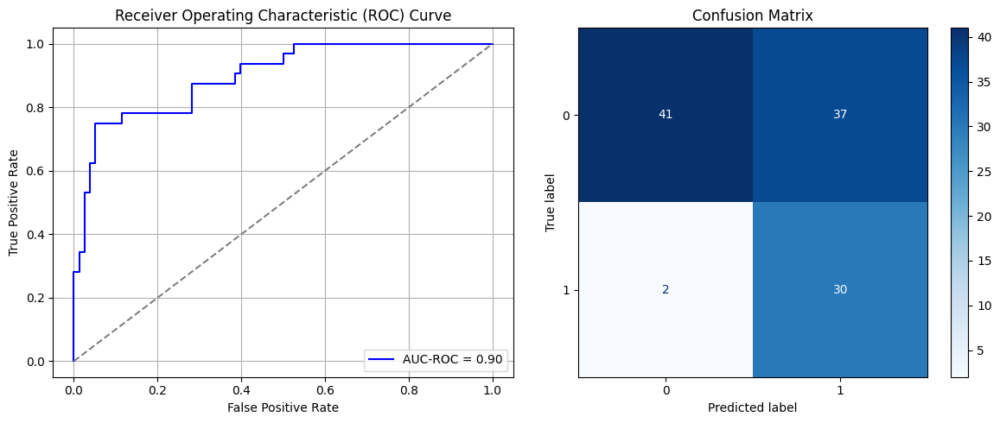

Best threshold based on F1-score: 0.9319536089897156
False Negative Rate: 0.0625
Time elapsed (performance): 0.4988827429988305
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7733 - loss: 0.6033 - val_AUC: 0.8740 - val_loss: 0.4474
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8900 - loss: 0.4161 - val_AUC: 0.8922 - val_loss: 0.4351
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9073 - loss: 0.3786 - val_AUC: 0.8973 - val_loss: 0.4177
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9143 - loss: 0.3670 - val_AUC: 0.8998 - val_loss: 0.4079
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9220 - loss: 0.3502 - val_AUC: 0.9028 - val_loss: 0.3998
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9211 - loss: 0.3520 - val_AUC: 0.9032 - val_loss: 0.4131
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9274 - loss: 0.3310 - val_AUC: 0.9028 - val_loss: 0.4044
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9282 - loss: 0.3340 - val_AUC: 0.9035 - val_loss: 0.4019
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9340 -

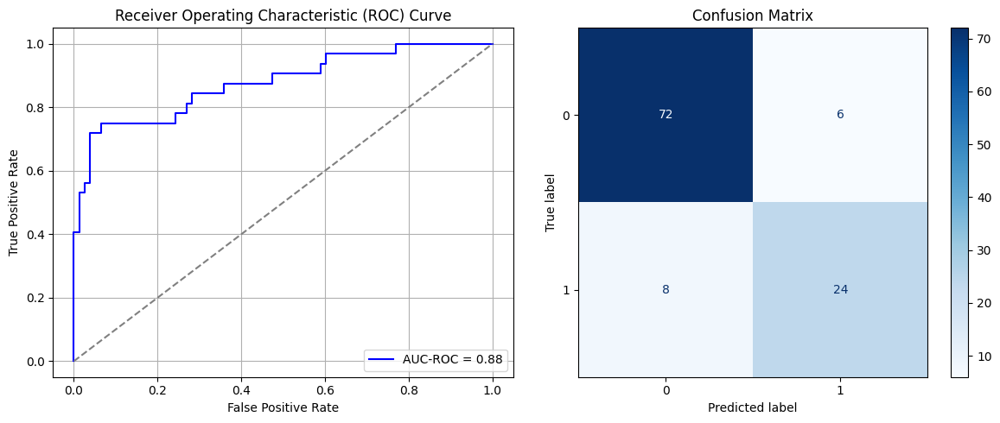

Best threshold based on F1-score: 0.7035752534866333
False Negative Rate: 0.25
Time elapsed (performance): 0.6125922689989238
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.7524 - loss: 0.6085 - val_AUC: 0.8791 - val_loss: 0.4379
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8904 - loss: 0.4133 - val_AUC: 0.9007 - val_loss: 0.4020
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9107 - loss: 0.3774 - val_AUC: 0.9065 - val_loss: 0.3932
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9164 - loss: 0.3620 - val_AUC: 0.9090 - val_loss: 0.4039
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9100 - loss: 0.3735 - val_AUC: 0.9095 - val_loss: 0.3896
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9197 - loss: 0.3501 - val_AUC: 0.9096 - val_loss: 0.3938
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9219 - loss: 0.3494 - val_AUC: 0.9123 - val_loss: 0.3878
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9308 - loss: 0.3297 - val_AUC: 0.9101 - val_loss: 0.3927
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9303 -

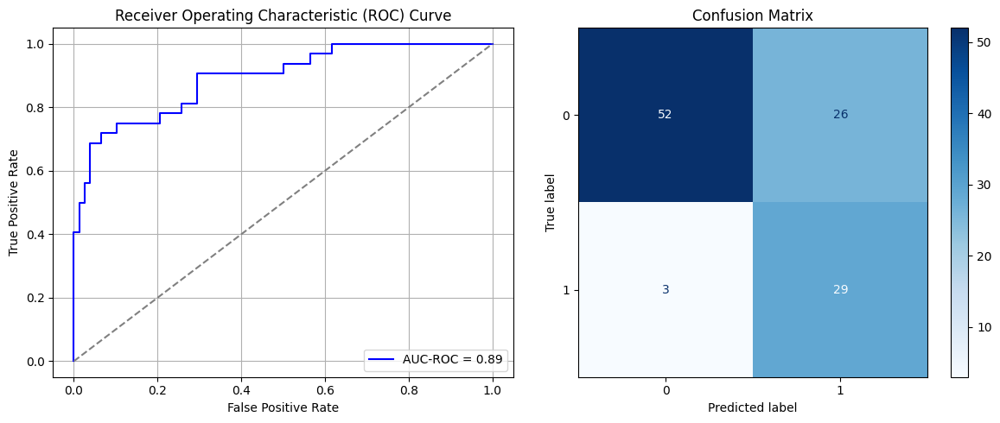

Best threshold based on F1-score: 0.9530146718025208
False Negative Rate: 0.09375
Time elapsed (performance): 0.4615713940002024
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7574 - loss: 0.6009 - val_AUC: 0.8647 - val_loss: 0.4610
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8934 - loss: 0.4094 - val_AUC: 0.8842 - val_loss: 0.4387
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9004 - loss: 0.3915 - val_AUC: 0.8876 - val_loss: 0.4268
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9100 - loss: 0.3683 - val_AUC: 0.8909 - val_loss: 0.4199
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9249 - loss: 0.3428 - val_AUC: 0.8944 - val_loss: 0.4174
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9222 - loss: 0.3447 - val_AUC: 0.8954 - val_loss: 0.4201
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9289 - loss: 0.3306 - val_AUC: 0.8949 - val_loss: 0.4286
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9326 - loss: 0.3199 - val_AUC: 0.8964 - val_loss: 0.4568
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9271 -

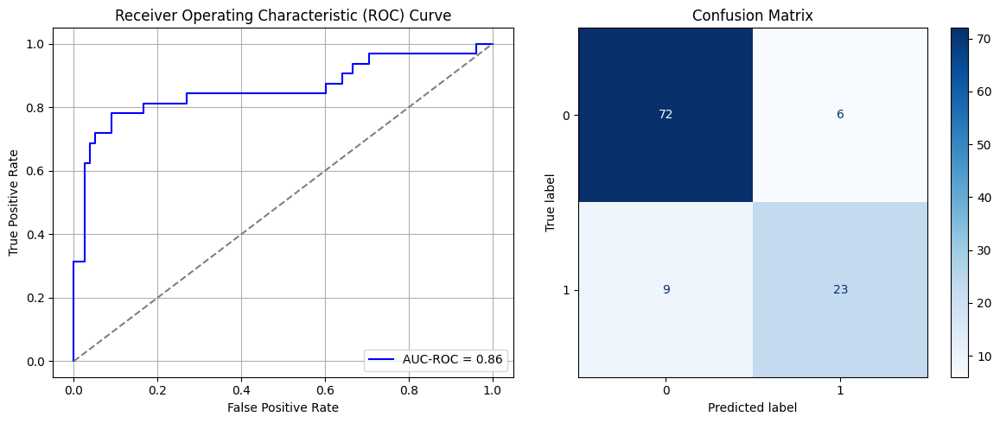

Best threshold based on F1-score: 0.40697193145751953
False Negative Rate: 0.28125
Time elapsed (performance): 0.47869689999970433
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7644 - loss: 0.6120 - val_AUC: 0.8731 - val_loss: 0.4536
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8866 - loss: 0.4182 - val_AUC: 0.8914 - val_loss: 0.4182
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9033 - loss: 0.3826 - val_AUC: 0.8976 - val_loss: 0.4413
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9113 - loss: 0.3739 - val_AUC: 0.8995 - val_loss: 0.4054
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9210 - loss: 0.3505 - val_AUC: 0.9005 - val_loss: 0.4044
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9202 - loss: 0.3547 - val_AUC: 0.9008 - val_loss: 0.4023
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9222 - loss: 0.3443 - val_AUC: 0.9030 - val_loss: 0.4037
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9329 - loss: 0.3194 - val_AUC: 0.9049 - val_loss: 0.3995
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9180 -

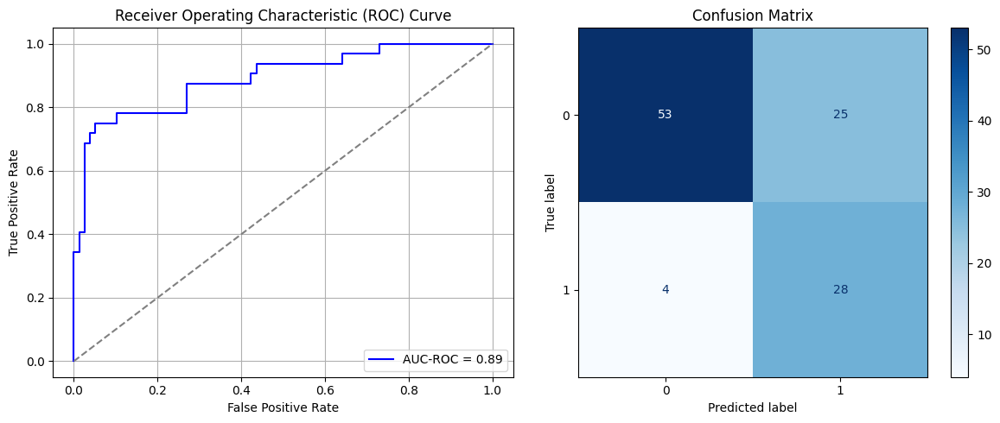

Best threshold based on F1-score: 0.9047291278839111
False Negative Rate: 0.125
Time elapsed (performance): 0.6338791140005924
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7403 - loss: 0.6164 - val_AUC: 0.8680 - val_loss: 0.4615
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8866 - loss: 0.4235 - val_AUC: 0.8920 - val_loss: 0.4266
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9028 - loss: 0.3901 - val_AUC: 0.9024 - val_loss: 0.4022
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9118 - loss: 0.3657 - val_AUC: 0.9040 - val_loss: 0.4024
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9199 - loss: 0.3530 - val_AUC: 0.9086 - val_loss: 0.3930
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9193 - loss: 0.3505 - val_AUC: 0.9090 - val_loss: 0.3937
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9142 - loss: 0.3634 - val_AUC: 0.9087 - val_loss: 0.3970
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9183 - loss: 0.3500 - val_AUC: 0.9084 - val_loss: 0.3996
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9313 -

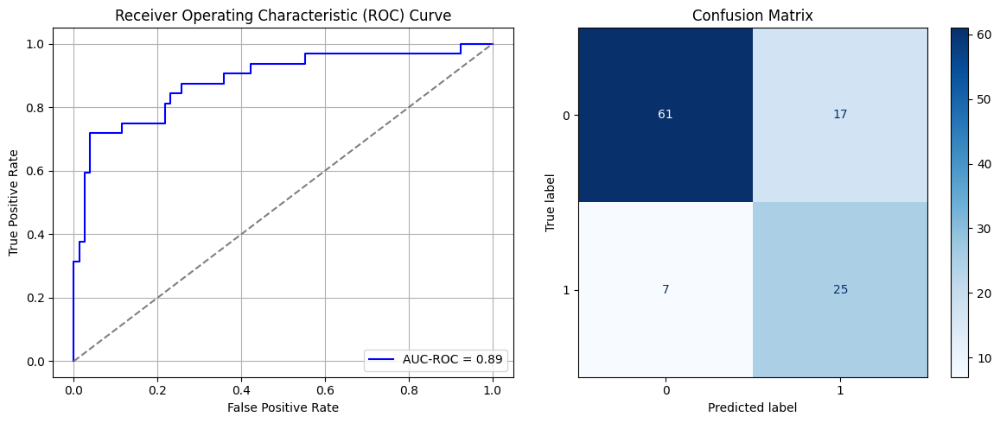

Best threshold based on F1-score: 0.8493227958679199
False Negative Rate: 0.21875
Time elapsed (performance): 0.4727106589998584
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.7781 - loss: 0.6048 - val_AUC: 0.8807 - val_loss: 0.4471
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8952 - loss: 0.4082 - val_AUC: 0.8979 - val_loss: 0.4072
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9028 - loss: 0.3877 - val_AUC: 0.9034 - val_loss: 0.3984
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9111 - loss: 0.3703 - val_AUC: 0.9057 - val_loss: 0.3967
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9125 - loss: 0.3647 - val_AUC: 0.9051 - val_loss: 0.3986
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9117 - loss: 0.3650 - val_AUC: 0.9052 - val_loss: 0.3973
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9235 - loss: 0.3423 - val_AUC: 0.9075 - val_loss: 0.3931
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9261 - loss: 0.3328 - val_AUC: 0.9071 - val_loss: 0.3948
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9271 -

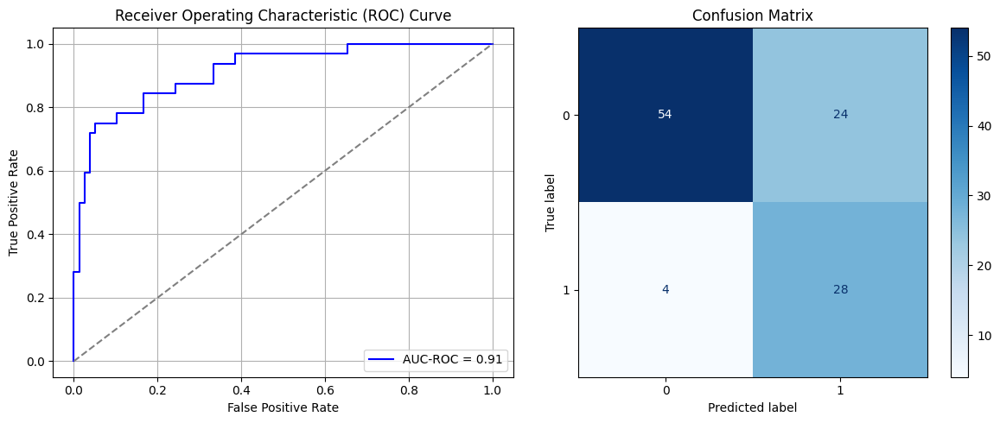

Best threshold based on F1-score: 0.8838162422180176
False Negative Rate: 0.125
Time elapsed (performance): 0.4823171939988242
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7509 - loss: 0.6186 - val_AUC: 0.8552 - val_loss: 0.4738
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8754 - loss: 0.4420 - val_AUC: 0.8781 - val_loss: 0.4405
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8988 - loss: 0.3951 - val_AUC: 0.8888 - val_loss: 0.4204
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9060 - loss: 0.3772 - val_AUC: 0.8911 - val_loss: 0.4242
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9175 - loss: 0.3561 - val_AUC: 0.8916 - val_loss: 0.4336
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9194 - loss: 0.3505 - val_AUC: 0.8924 - val_loss: 0.4456
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9226 - loss: 0.3496 - val_AUC: 0.8907 - val_loss: 0.4212
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9211 - loss: 0.3491 - val_AUC: 0.8933 - val_loss: 0.4212
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9318 -

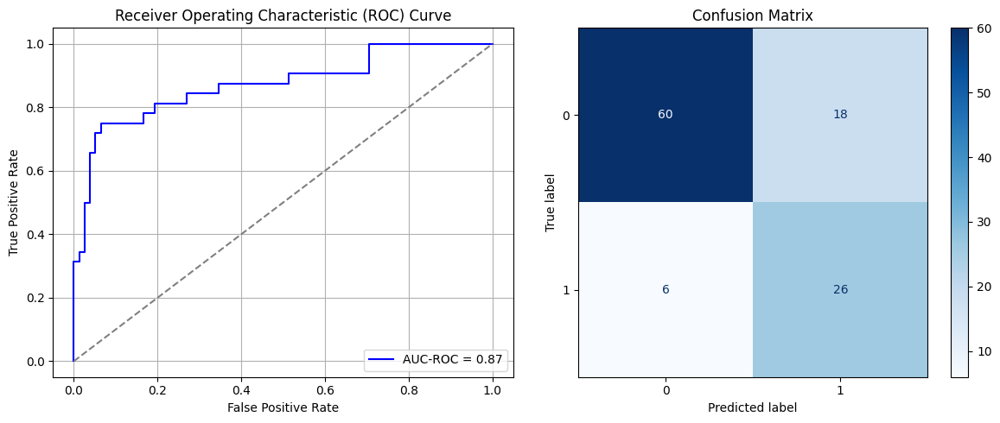

Best threshold based on F1-score: 0.7904387712478638
False Negative Rate: 0.1875
Time elapsed (performance): 0.48720145799961756
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7342 - loss: 0.6131 - val_AUC: 0.8685 - val_loss: 0.4540
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8970 - loss: 0.4004 - val_AUC: 0.8857 - val_loss: 0.4292
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9115 - loss: 0.3662 - val_AUC: 0.8926 - val_loss: 0.4173
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9223 - loss: 0.3475 - val_AUC: 0.8946 - val_loss: 0.4236
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9196 - loss: 0.3557 - val_AUC: 0.9008 - val_loss: 0.4089
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9269 - loss: 0.3326 - val_AUC: 0.9006 - val_loss: 0.4111
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9341 - loss: 0.3197 - val_AUC: 0.9029 - val_loss: 0.4053
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9349 - loss: 0.3202 - val_AUC: 0.9000 - val_loss: 0.4191
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9333 -

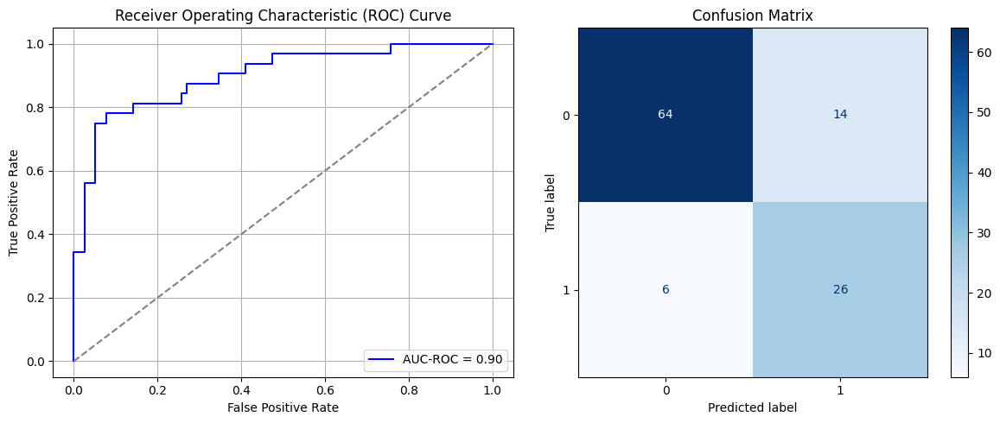

Best threshold based on F1-score: 0.8700699806213379
False Negative Rate: 0.1875
Time elapsed (performance): 0.6984823519997008
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7439 - loss: 0.6045 - val_AUC: 0.8676 - val_loss: 0.4592
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8924 - loss: 0.4136 - val_AUC: 0.8887 - val_loss: 0.4205
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9140 - loss: 0.3664 - val_AUC: 0.8928 - val_loss: 0.4159
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9072 - loss: 0.3772 - val_AUC: 0.8971 - val_loss: 0.4118
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9235 - loss: 0.3441 - val_AUC: 0.8997 - val_loss: 0.4268
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9279 - loss: 0.3394 - val_AUC: 0.8998 - val_loss: 0.4152
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9333 - loss: 0.3239 - val_AUC: 0.9000 - val_loss: 0.4103
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9340 - loss: 0.3197 - val_AUC: 0.8992 - val_loss: 0.4148
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9283 -

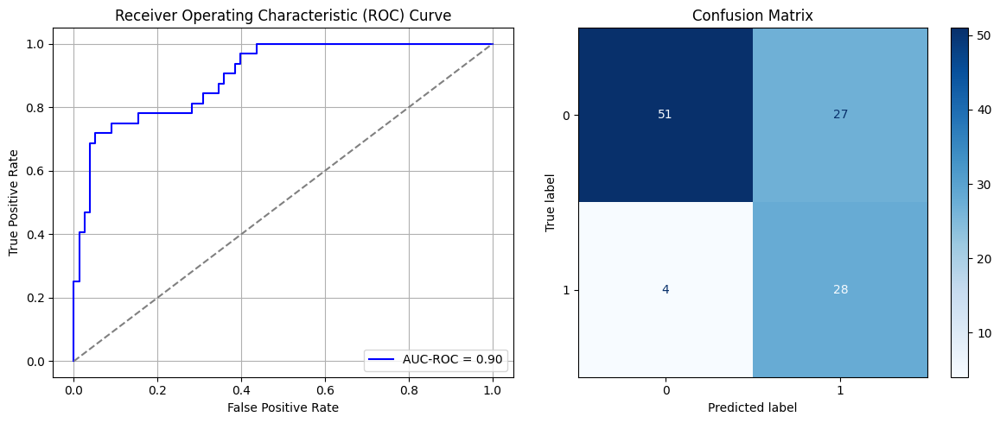

Best threshold based on F1-score: 0.9368679523468018
False Negative Rate: 0.125
Time elapsed (performance): 0.4786335829994641
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7063 - loss: 0.6190 - val_AUC: 0.8672 - val_loss: 0.4609
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8900 - loss: 0.4158 - val_AUC: 0.8864 - val_loss: 0.4332
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9011 - loss: 0.3891 - val_AUC: 0.8914 - val_loss: 0.4232
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9155 - loss: 0.3617 - val_AUC: 0.8955 - val_loss: 0.4252
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9154 - loss: 0.3620 - val_AUC: 0.8977 - val_loss: 0.4148
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9272 - loss: 0.3405 - val_AUC: 0.8993 - val_loss: 0.4251
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9321 - loss: 0.3303 - val_AUC: 0.9017 - val_loss: 0.4274
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9218 - loss: 0.3539 - val_AUC: 0.9012 - val_loss: 0.4099
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9309 -

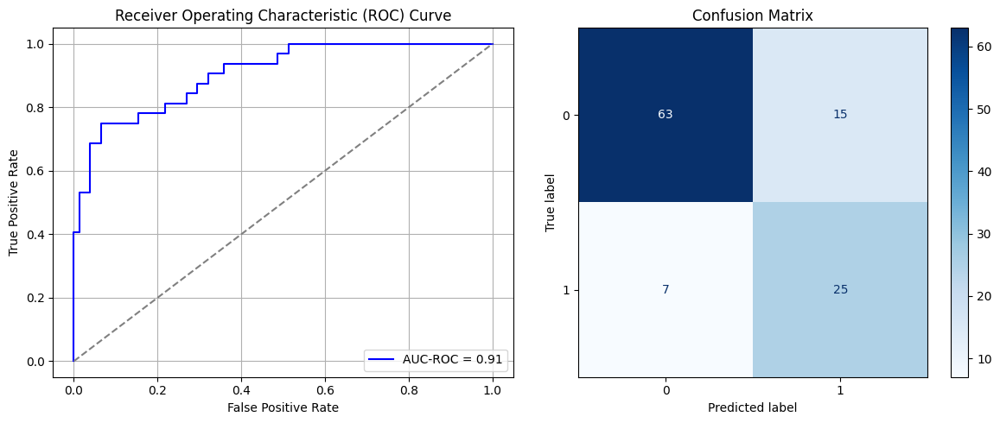

Best threshold based on F1-score: 0.8192875385284424
False Negative Rate: 0.21875
Time elapsed (performance): 0.47750793299928773
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7357 - loss: 0.6158 - val_AUC: 0.8713 - val_loss: 0.4530
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8862 - loss: 0.4228 - val_AUC: 0.8945 - val_loss: 0.4132
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9097 - loss: 0.3764 - val_AUC: 0.9037 - val_loss: 0.4083
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9115 - loss: 0.3631 - val_AUC: 0.9042 - val_loss: 0.3973
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9245 - loss: 0.3425 - val_AUC: 0.9059 - val_loss: 0.3945
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9253 - loss: 0.3386 - val_AUC: 0.9055 - val_loss: 0.4039
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9326 - loss: 0.3254 - val_AUC: 0.9073 - val_loss: 0.3910
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9234 - loss: 0.3422 - val_AUC: 0.9064 - val_loss: 0.4054
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9271 -

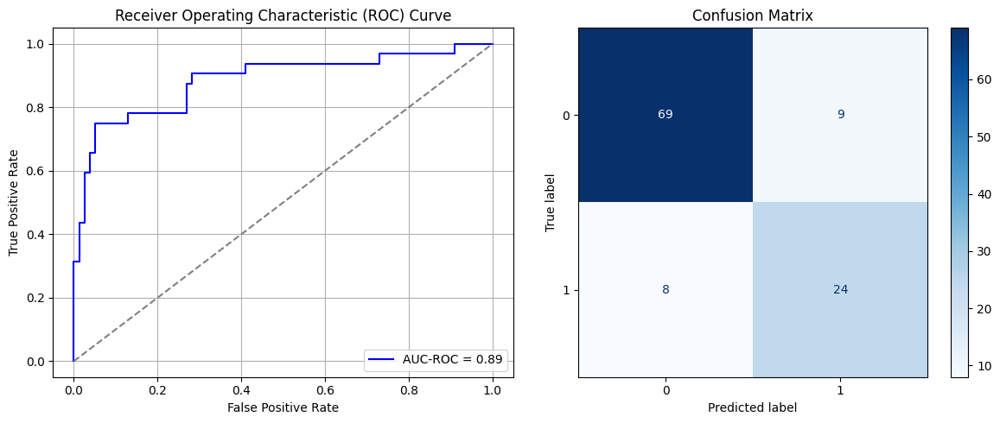

Best threshold based on F1-score: 0.7892442941665649
False Negative Rate: 0.25
Time elapsed (performance): 0.4903801269992982
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7660 - loss: 0.6028 - val_AUC: 0.8670 - val_loss: 0.4538
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8836 - loss: 0.4258 - val_AUC: 0.8846 - val_loss: 0.4275
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9113 - loss: 0.3734 - val_AUC: 0.8929 - val_loss: 0.4143
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9132 - loss: 0.3663 - val_AUC: 0.8962 - val_loss: 0.4337
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9230 - loss: 0.3457 - val_AUC: 0.8977 - val_loss: 0.4092
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9203 - loss: 0.3522 - val_AUC: 0.8982 - val_loss: 0.4145
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9292 - loss: 0.3356 - val_AUC: 0.8979 - val_loss: 0.4240
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9221 - loss: 0.3506 - val_AUC: 0.9011 - val_loss: 0.4138
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9222 -

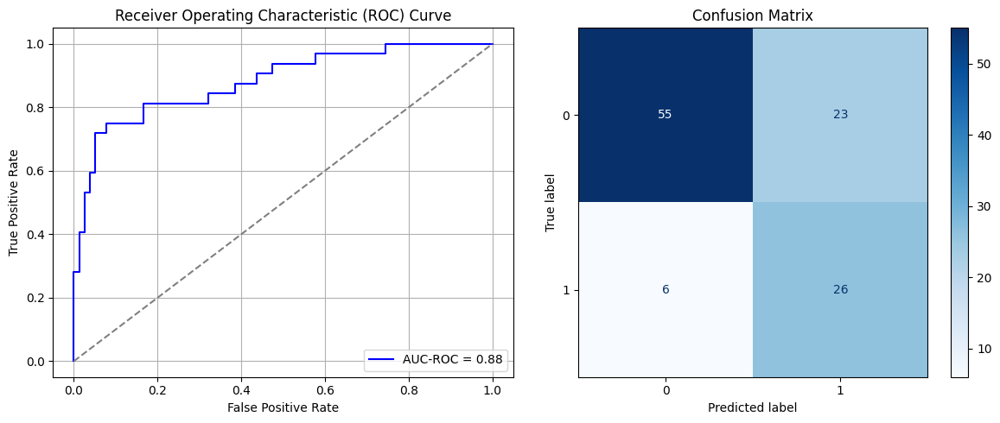

Best threshold based on F1-score: 0.8775731325149536
False Negative Rate: 0.1875
Time elapsed (performance): 0.7362551789992722
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.7848 - loss: 0.6087 - val_AUC: 0.8691 - val_loss: 0.4570
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8958 - loss: 0.4062 - val_AUC: 0.8893 - val_loss: 0.4248
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9092 - loss: 0.3760 - val_AUC: 0.8990 - val_loss: 0.4058
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9182 - loss: 0.3586 - val_AUC: 0.9016 - val_loss: 0.4023
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9193 - loss: 0.3539 - val_AUC: 0.9056 - val_loss: 0.4102
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9255 - loss: 0.3415 - val_AUC: 0.9081 - val_loss: 0.4106
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9193 - loss: 0.3519 - val_AUC: 0.9079 - val_loss: 0.3943
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9219 - loss: 0.3464 - val_AUC: 0.9092 - val_loss: 0.4001
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9187 -

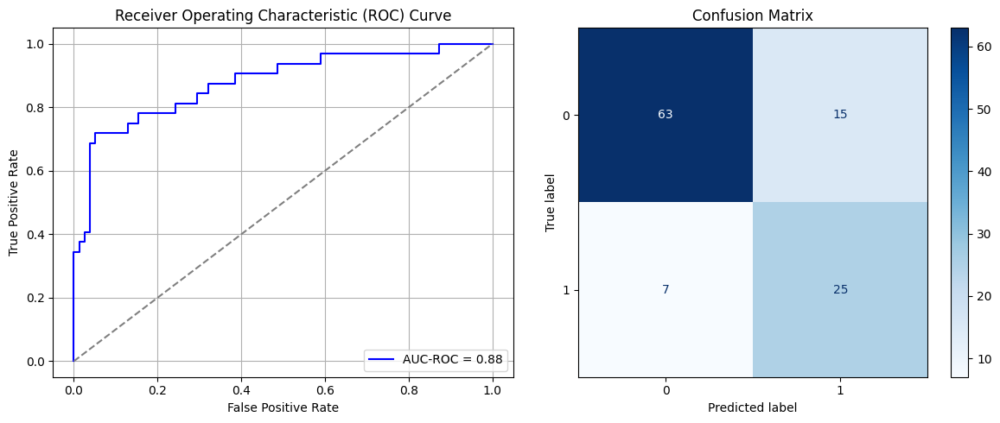

Best threshold based on F1-score: 0.7422236800193787
False Negative Rate: 0.21875
Time elapsed (performance): 0.5163471409996419
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7207 - loss: 0.6159 - val_AUC: 0.8794 - val_loss: 0.4410
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8885 - loss: 0.4192 - val_AUC: 0.8978 - val_loss: 0.4167
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9148 - loss: 0.3665 - val_AUC: 0.9040 - val_loss: 0.4053
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9146 - loss: 0.3658 - val_AUC: 0.9072 - val_loss: 0.4114
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9139 - loss: 0.3623 - val_AUC: 0.9082 - val_loss: 0.3954
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9194 - loss: 0.3493 - val_AUC: 0.9068 - val_loss: 0.3961
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9202 - loss: 0.3515 - val_AUC: 0.9080 - val_loss: 0.3960
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9298 - loss: 0.3284 - val_AUC: 0.9076 - val_loss: 0.3951
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9244 -

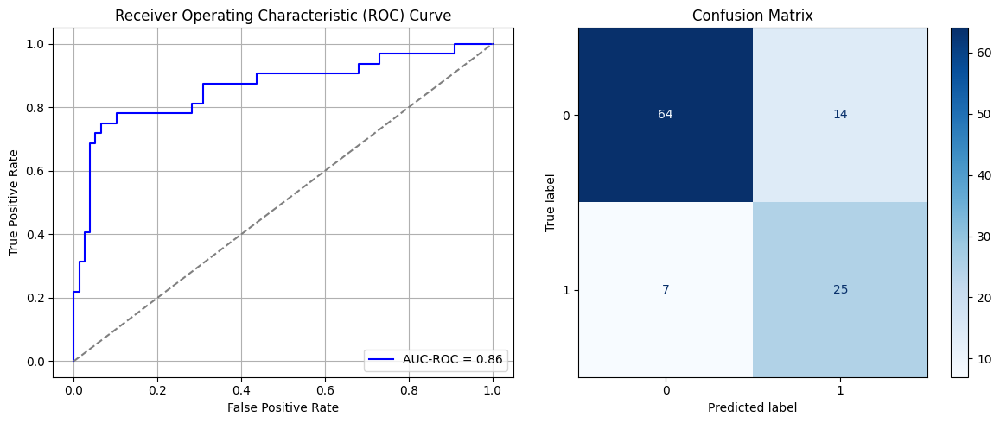

Best threshold based on F1-score: 0.6995565891265869
False Negative Rate: 0.21875
Time elapsed (performance): 0.46557231299993873
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7700 - loss: 0.6093 - val_AUC: 0.8761 - val_loss: 0.4496
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9037 - loss: 0.3877 - val_AUC: 0.8907 - val_loss: 0.4346
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9145 - loss: 0.3623 - val_AUC: 0.8960 - val_loss: 0.4174
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9174 - loss: 0.3585 - val_AUC: 0.8997 - val_loss: 0.4140
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9242 - loss: 0.3411 - val_AUC: 0.9004 - val_loss: 0.4153
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9157 - loss: 0.3566 - val_AUC: 0.9000 - val_loss: 0.4286
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9237 - loss: 0.3455 - val_AUC: 0.9023 - val_loss: 0.4104
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9295 - loss: 0.3272 - val_AUC: 0.9025 - val_loss: 0.4123
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9305 -

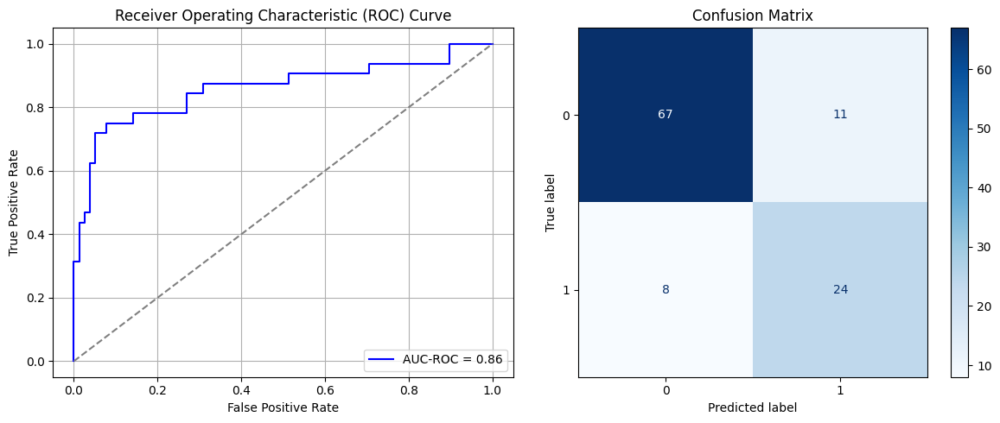

Best threshold based on F1-score: 0.8569695353507996
False Negative Rate: 0.25
Time elapsed (performance): 0.5199528800003463
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7615 - loss: 0.6120 - val_AUC: 0.8667 - val_loss: 0.4589
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8863 - loss: 0.4246 - val_AUC: 0.8876 - val_loss: 0.4209
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9068 - loss: 0.3848 - val_AUC: 0.8946 - val_loss: 0.4160
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9100 - loss: 0.3728 - val_AUC: 0.8984 - val_loss: 0.4049
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9085 - loss: 0.3760 - val_AUC: 0.8988 - val_loss: 0.4088
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9135 - loss: 0.3671 - val_AUC: 0.8991 - val_loss: 0.4069
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9224 - loss: 0.3467 - val_AUC: 0.9014 - val_loss: 0.4010
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9242 - loss: 0.3446 - val_AUC: 0.9005 - val_loss: 0.4033
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9256 -

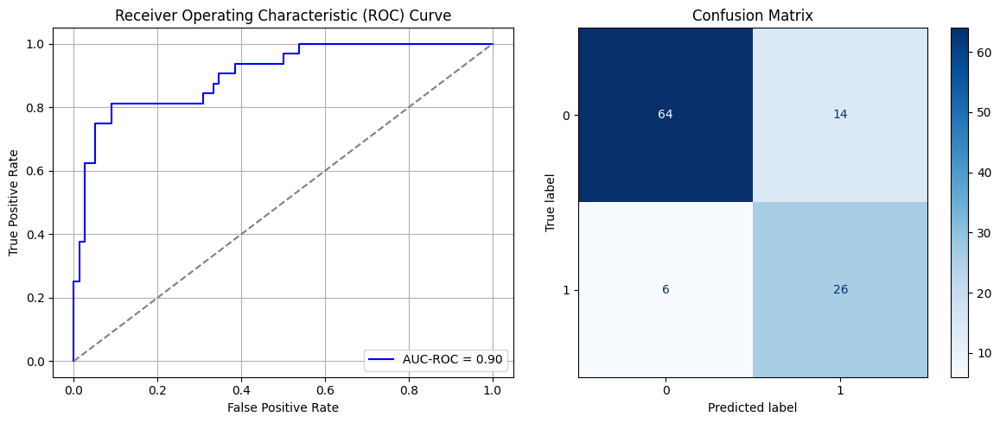

Best threshold based on F1-score: 0.599953293800354
False Negative Rate: 0.1875
Time elapsed (performance): 0.5181669379999221
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.7194 - loss: 0.6268 - val_AUC: 0.8626 - val_loss: 0.4647
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8899 - loss: 0.4158 - val_AUC: 0.8901 - val_loss: 0.4240
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9180 - loss: 0.3652 - val_AUC: 0.8993 - val_loss: 0.4062
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9057 - loss: 0.3800 - val_AUC: 0.9005 - val_loss: 0.4213
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9182 - loss: 0.3527 - val_AUC: 0.8988 - val_loss: 0.4095
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9174 - loss: 0.3563 - val_AUC: 0.9005 - val_loss: 0.4017
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9214 - loss: 0.3432 - val_AUC: 0.9036 - val_loss: 0.4153
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9317 - loss: 0.3305 - val_AUC: 0.9031 - val_loss: 0.4031
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9337 -

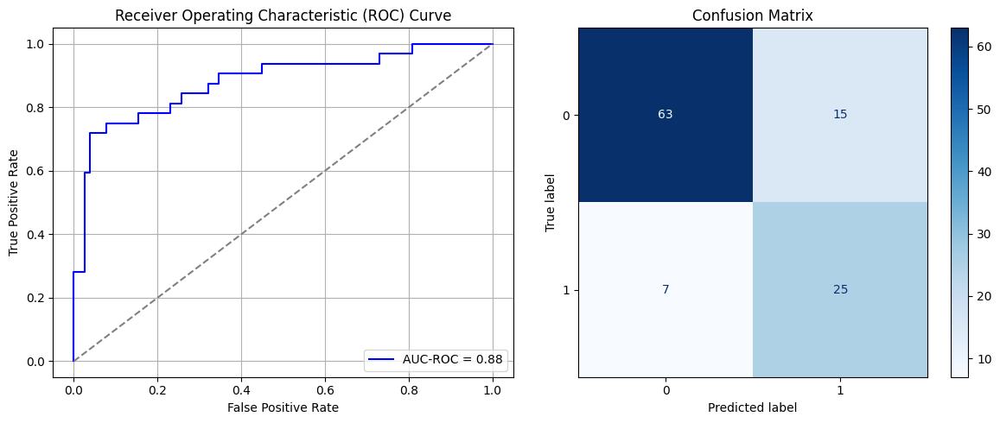

Best threshold based on F1-score: 0.8655039072036743
False Negative Rate: 0.21875
Time elapsed (performance): 5.983691906001695
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.7991 - loss: 0.5750 - val_AUC: 0.8711 - val_loss: 0.4539
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9065 - loss: 0.3909 - val_AUC: 0.8890 - val_loss: 0.4181
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9112 - loss: 0.3765 - val_AUC: 0.8933 - val_loss: 0.4141
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9246 - loss: 0.3480 - val_AUC: 0.8926 - val_loss: 0.4459
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9128 - loss: 0.3694 - val_AUC: 0.8972 - val_loss: 0.4133
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9341 - loss: 0.3215 - val_AUC: 0.8981 - val_loss: 0.4179
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9362 - loss: 0.3151 - val_AUC: 0.8977 - val_loss: 0.4091
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9301 - loss: 0.3318 - val_AUC: 0.8971 - val_loss: 0.4124
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9348 -

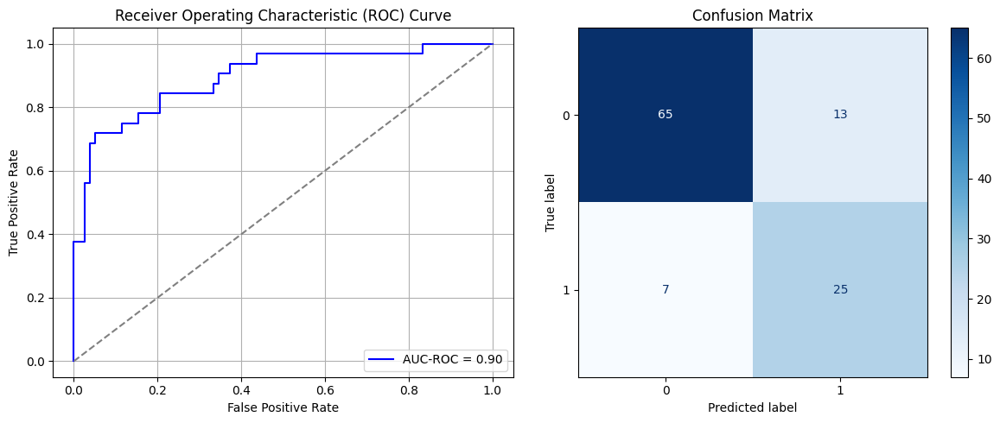

Best threshold based on F1-score: 0.8770128488540649
False Negative Rate: 0.21875
Time elapsed (performance): 0.5342740329997469
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.7837 - loss: 0.6101 - val_AUC: 0.8724 - val_loss: 0.4526
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8910 - loss: 0.4160 - val_AUC: 0.8900 - val_loss: 0.4264
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9075 - loss: 0.3765 - val_AUC: 0.8944 - val_loss: 0.4153
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9128 - loss: 0.3696 - val_AUC: 0.8971 - val_loss: 0.4089
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9219 - loss: 0.3470 - val_AUC: 0.8988 - val_loss: 0.4096
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9221 - loss: 0.3457 - val_AUC: 0.8981 - val_loss: 0.4305
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9300 - loss: 0.3317 - val_AUC: 0.8994 - val_loss: 0.4124
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9287 - loss: 0.3341 - val_AUC: 0.9002 - val_loss: 0.4037
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9322 -

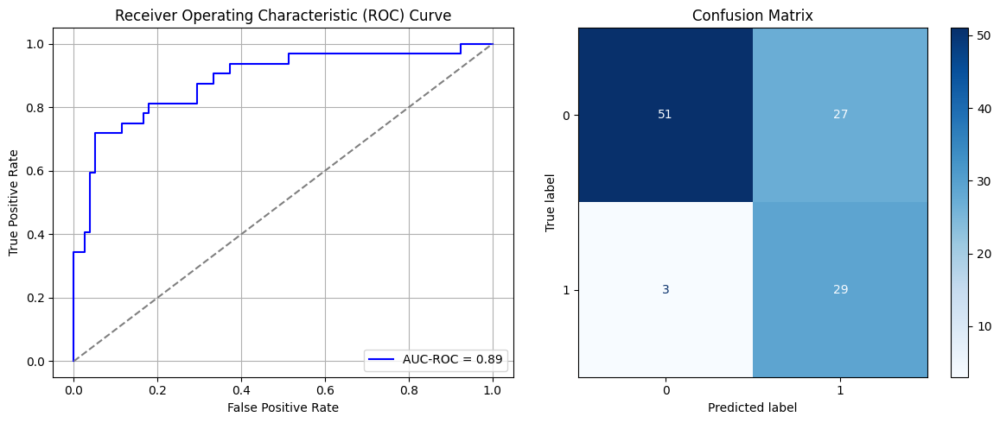

Best threshold based on F1-score: 0.9652578830718994
False Negative Rate: 0.09375
Time elapsed (performance): 0.5142969750013435
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7375 - loss: 0.6197 - val_AUC: 0.8719 - val_loss: 0.4684
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9063 - loss: 0.3937 - val_AUC: 0.8889 - val_loss: 0.4244
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9190 - loss: 0.3591 - val_AUC: 0.8994 - val_loss: 0.4075
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9157 - loss: 0.3613 - val_AUC: 0.9004 - val_loss: 0.4065
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9240 - loss: 0.3444 - val_AUC: 0.9052 - val_loss: 0.3996
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9349 - loss: 0.3225 - val_AUC: 0.9035 - val_loss: 0.4015
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9315 - loss: 0.3269 - val_AUC: 0.9020 - val_loss: 0.4271
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9337 - loss: 0.3258 - val_AUC: 0.9051 - val_loss: 0.3975
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9308 -

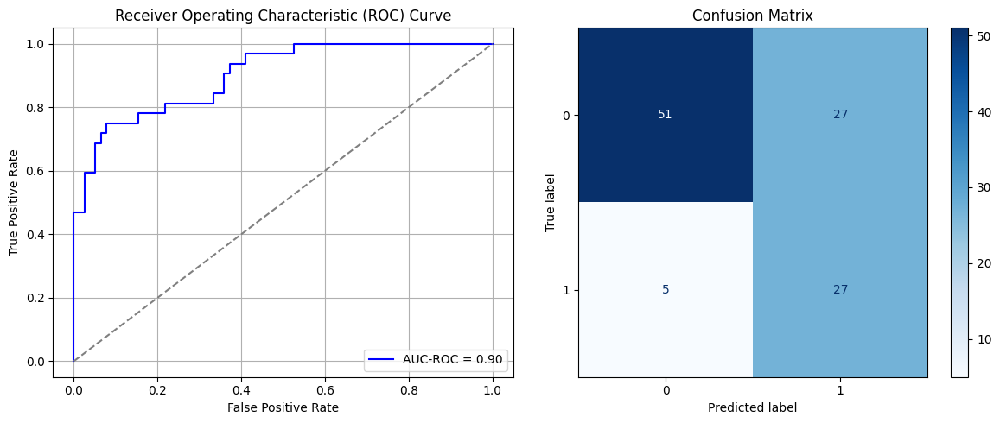

Best threshold based on F1-score: 0.863411545753479
False Negative Rate: 0.15625
Time elapsed (performance): 0.5010497429993848
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7321 - loss: 0.6159 - val_AUC: 0.8776 - val_loss: 0.4454
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8960 - loss: 0.4080 - val_AUC: 0.8960 - val_loss: 0.4151
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9103 - loss: 0.3746 - val_AUC: 0.9020 - val_loss: 0.3995
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9213 - loss: 0.3498 - val_AUC: 0.9054 - val_loss: 0.4000
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9179 - loss: 0.3549 - val_AUC: 0.9065 - val_loss: 0.4008
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9232 - loss: 0.3436 - val_AUC: 0.9081 - val_loss: 0.3923
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9225 - loss: 0.3487 - val_AUC: 0.9095 - val_loss: 0.3920
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9293 - loss: 0.3311 - val_AUC: 0.9067 - val_loss: 0.3948
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9300 -

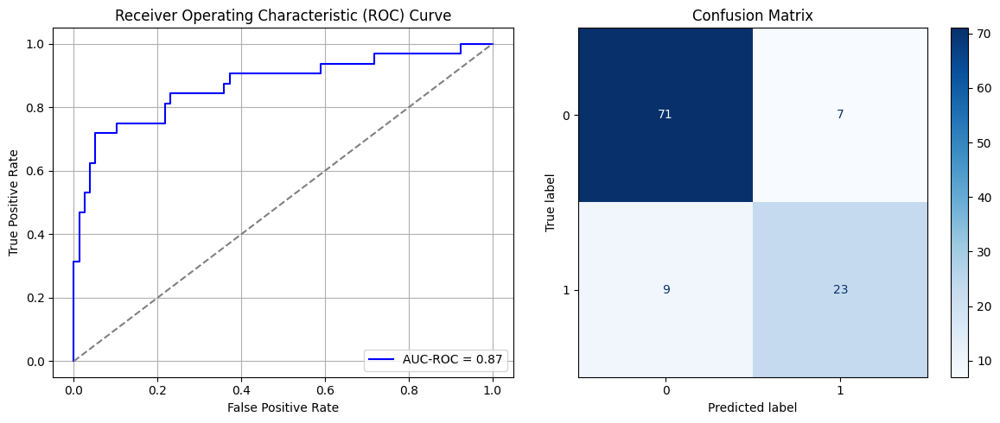

Best threshold based on F1-score: 0.6794276237487793
False Negative Rate: 0.28125
Time elapsed (performance): 0.5008487410013913
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7511 - loss: 0.6175 - val_AUC: 0.8595 - val_loss: 0.4727
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8788 - loss: 0.4348 - val_AUC: 0.8834 - val_loss: 0.4306
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9019 - loss: 0.3913 - val_AUC: 0.8927 - val_loss: 0.4180
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9112 - loss: 0.3755 - val_AUC: 0.8983 - val_loss: 0.4085
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9186 - loss: 0.3568 - val_AUC: 0.9021 - val_loss: 0.4232
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9141 - loss: 0.3619 - val_AUC: 0.8993 - val_loss: 0.4108
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9274 - loss: 0.3399 - val_AUC: 0.9028 - val_loss: 0.4004
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9285 - loss: 0.3363 - val_AUC: 0.9013 - val_loss: 0.4048
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9379 -

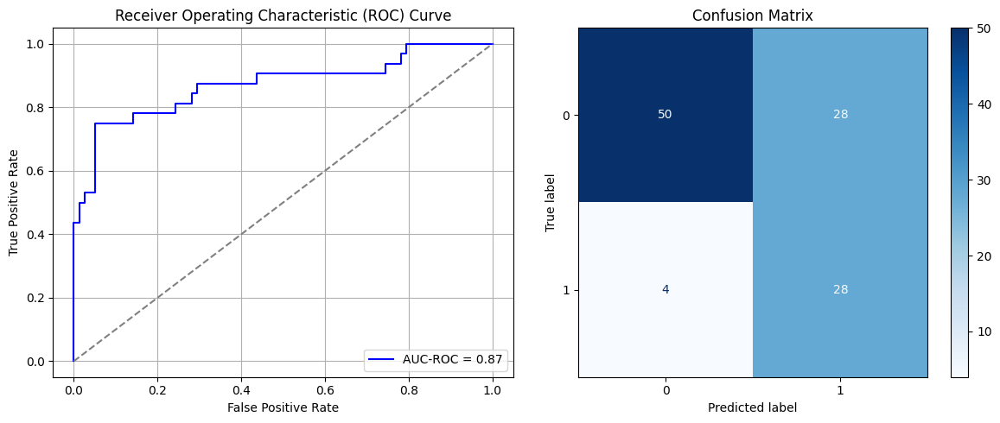

Best threshold based on F1-score: 0.9335055947303772
False Negative Rate: 0.125
Time elapsed (performance): 0.6020769239985384
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6991 - loss: 0.6200 - val_AUC: 0.8561 - val_loss: 0.4752
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8895 - loss: 0.4229 - val_AUC: 0.8780 - val_loss: 0.4381
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9146 - loss: 0.3704 - val_AUC: 0.8880 - val_loss: 0.4259
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9216 - loss: 0.3516 - val_AUC: 0.8903 - val_loss: 0.4228
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9236 - loss: 0.3391 - val_AUC: 0.8929 - val_loss: 0.4236
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9312 - loss: 0.3267 - val_AUC: 0.8925 - val_loss: 0.4217
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9255 - loss: 0.3400 - val_AUC: 0.8945 - val_loss: 0.4222
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9295 - loss: 0.3299 - val_AUC: 0.8952 - val_loss: 0.4269
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9277 -

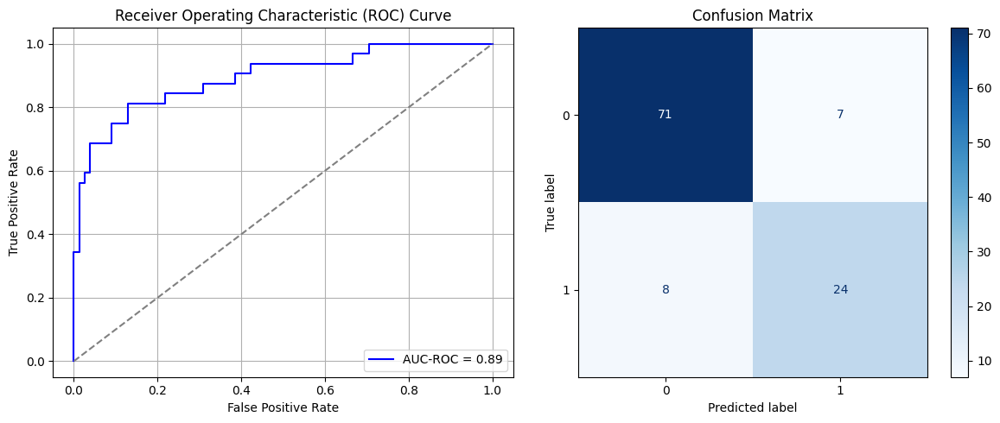

Best threshold based on F1-score: 0.613456666469574
False Negative Rate: 0.25
Time elapsed (performance): 0.5097036089991889
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7617 - loss: 0.6182 - val_AUC: 0.8754 - val_loss: 0.4484
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8918 - loss: 0.4137 - val_AUC: 0.8956 - val_loss: 0.4100
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9043 - loss: 0.3832 - val_AUC: 0.8996 - val_loss: 0.3999
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9075 - loss: 0.3791 - val_AUC: 0.9017 - val_loss: 0.3978
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9136 - loss: 0.3651 - val_AUC: 0.9037 - val_loss: 0.4040
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9267 - loss: 0.3387 - val_AUC: 0.9018 - val_loss: 0.3953
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9179 - loss: 0.3552 - val_AUC: 0.9025 - val_loss: 0.3987
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9266 - loss: 0.3376 - val_AUC: 0.9036 - val_loss: 0.4056
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9290 -

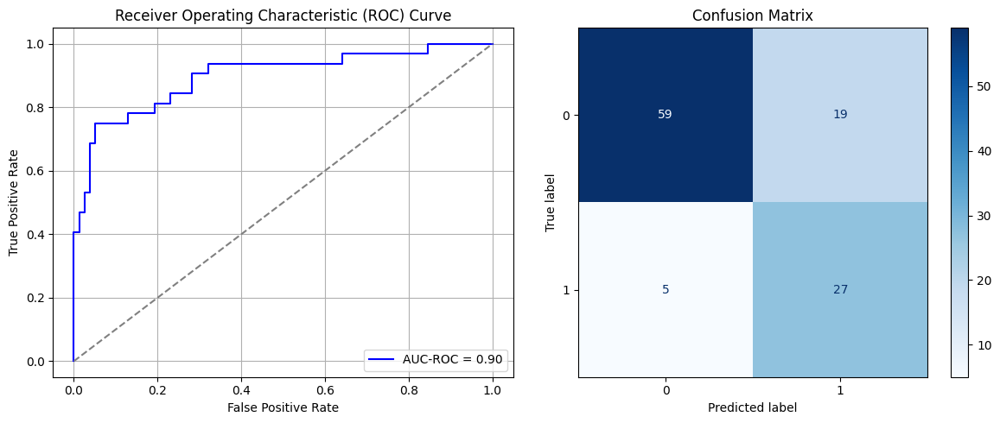

Best threshold based on F1-score: 0.8733802437782288
False Negative Rate: 0.15625
Time elapsed (performance): 0.5021518529993045
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7973 - loss: 0.5942 - val_AUC: 0.8685 - val_loss: 0.4546
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8928 - loss: 0.4058 - val_AUC: 0.8876 - val_loss: 0.4219
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9174 - loss: 0.3641 - val_AUC: 0.8954 - val_loss: 0.4143
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9222 - loss: 0.3529 - val_AUC: 0.9005 - val_loss: 0.4070
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9289 - loss: 0.3395 - val_AUC: 0.9003 - val_loss: 0.4082
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9278 - loss: 0.3411 - val_AUC: 0.9007 - val_loss: 0.4265
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9295 - loss: 0.3339 - val_AUC: 0.9026 - val_loss: 0.4055
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9236 - loss: 0.3448 - val_AUC: 0.9026 - val_loss: 0.4056
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9303 -

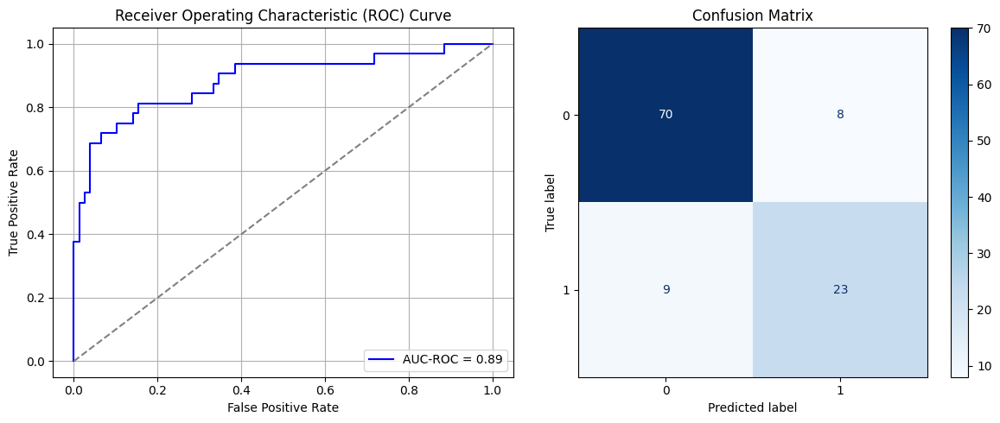

Best threshold based on F1-score: 0.7837250232696533
False Negative Rate: 0.28125
Time elapsed (performance): 0.5047092589993554
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8012 - loss: 0.5862 - val_AUC: 0.8779 - val_loss: 0.4437
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8922 - loss: 0.4116 - val_AUC: 0.8971 - val_loss: 0.4139
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9139 - loss: 0.3705 - val_AUC: 0.9030 - val_loss: 0.3998
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9169 - loss: 0.3613 - val_AUC: 0.9063 - val_loss: 0.3988
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9223 - loss: 0.3483 - val_AUC: 0.9064 - val_loss: 0.4045
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9242 - loss: 0.3445 - val_AUC: 0.9080 - val_loss: 0.3945
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9339 - loss: 0.3268 - val_AUC: 0.9075 - val_loss: 0.3911
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9325 - loss: 0.3275 - val_AUC: 0.9102 - val_loss: 0.3876
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9283 -

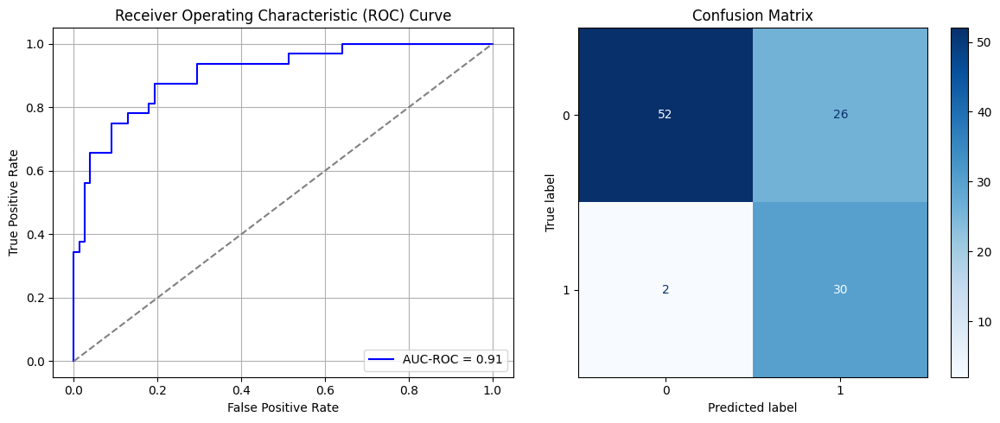

Best threshold based on F1-score: 0.9194217324256897
False Negative Rate: 0.0625
Time elapsed (performance): 0.7049590779988648
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7418 - loss: 0.6074 - val_AUC: 0.8690 - val_loss: 0.4570
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8888 - loss: 0.4165 - val_AUC: 0.8913 - val_loss: 0.4302
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9114 - loss: 0.3701 - val_AUC: 0.8966 - val_loss: 0.4163
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9195 - loss: 0.3496 - val_AUC: 0.9000 - val_loss: 0.4127
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9281 - loss: 0.3319 - val_AUC: 0.9001 - val_loss: 0.4122
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9272 - loss: 0.3395 - val_AUC: 0.9018 - val_loss: 0.4118
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9320 - loss: 0.3236 - val_AUC: 0.9040 - val_loss: 0.4166
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9328 - loss: 0.3265 - val_AUC: 0.9044 - val_loss: 0.4021
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9381 -

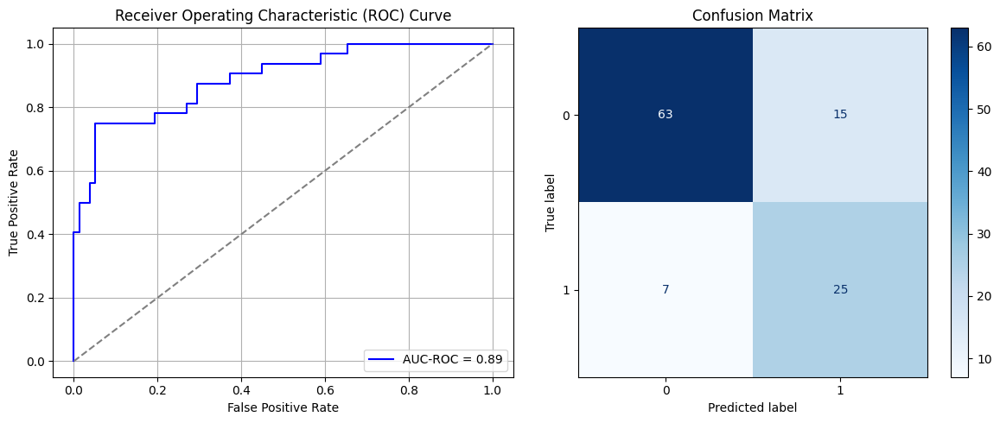

Best threshold based on F1-score: 0.7581213712692261
False Negative Rate: 0.21875
Time elapsed (performance): 0.5193770519999816
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.7674 - loss: 0.6048 - val_AUC: 0.8720 - val_loss: 0.4553
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.8972 - loss: 0.4019 - val_AUC: 0.8880 - val_loss: 0.4379
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9153 - loss: 0.3649 - val_AUC: 0.8966 - val_loss: 0.4098
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9176 - loss: 0.3572 - val_AUC: 0.8970 - val_loss: 0.4401
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9165 - loss: 0.3565 - val_AUC: 0.8974 - val_loss: 0.4100
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9242 - loss: 0.3402 - val_AUC: 0.9009 - val_loss: 0.4056
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9313 - loss: 0.3209 - val_AUC: 0.9014 - val_loss: 0.4208
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9235 - loss: 0.3442 - val_AUC: 0.9011 - val_loss: 0.4091
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9345 -

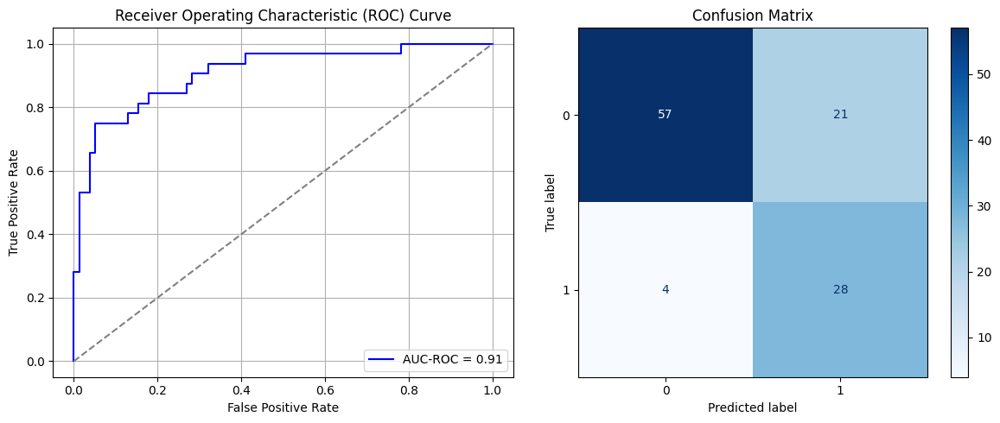

Best threshold based on F1-score: 0.9058683514595032
False Negative Rate: 0.125
Time elapsed (performance): 0.5310495980011183
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7877 - loss: 0.5910 - val_AUC: 0.8770 - val_loss: 0.4419
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8885 - loss: 0.4146 - val_AUC: 0.8936 - val_loss: 0.4166
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9095 - loss: 0.3747 - val_AUC: 0.9019 - val_loss: 0.4039
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9179 - loss: 0.3602 - val_AUC: 0.9043 - val_loss: 0.4070
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9225 - loss: 0.3500 - val_AUC: 0.9050 - val_loss: 0.4058
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9229 - loss: 0.3487 - val_AUC: 0.9039 - val_loss: 0.4047
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9304 - loss: 0.3339 - val_AUC: 0.9017 - val_loss: 0.4086
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9287 - loss: 0.3384 - val_AUC: 0.9036 - val_loss: 0.4104
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9303 -

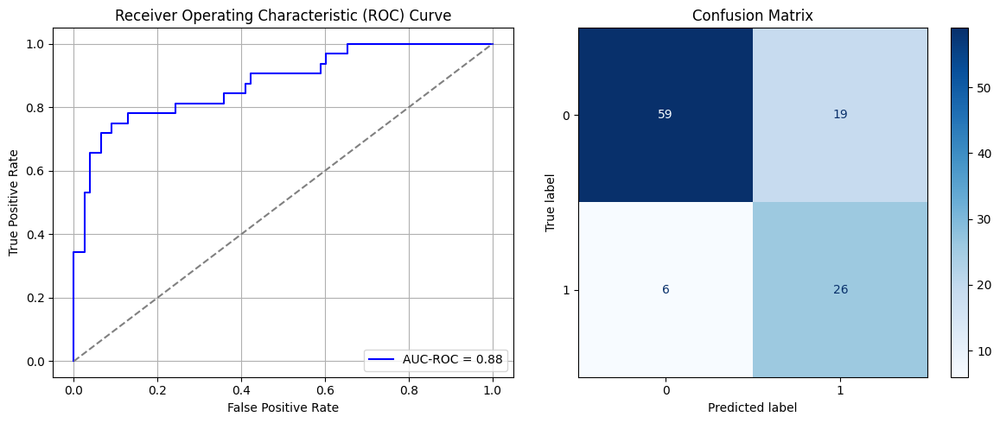

Best threshold based on F1-score: 0.9200595617294312
False Negative Rate: 0.1875
Time elapsed (performance): 0.5525705460004247
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7967 - loss: 0.5798 - val_AUC: 0.8657 - val_loss: 0.4571
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8963 - loss: 0.4040 - val_AUC: 0.8857 - val_loss: 0.4265
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9184 - loss: 0.3572 - val_AUC: 0.8894 - val_loss: 0.4271
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9168 - loss: 0.3531 - val_AUC: 0.8919 - val_loss: 0.4293
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9295 - loss: 0.3277 - val_AUC: 0.8930 - val_loss: 0.4298
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9229 - loss: 0.3448 - val_AUC: 0.8929 - val_loss: 0.4285
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9327 - loss: 0.3253 - val_AUC: 0.8974 - val_loss: 0.4176
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9306 - loss: 0.3270 - val_AUC: 0.8978 - val_loss: 0.4162
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9305 -

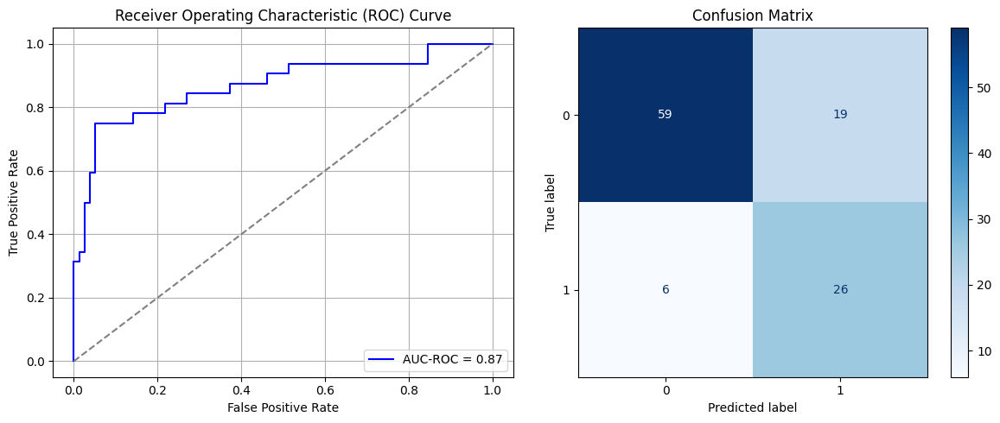

Best threshold based on F1-score: 0.9018053412437439
False Negative Rate: 0.1875
Time elapsed (performance): 0.8392113570007496
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6872 - loss: 0.6247 - val_AUC: 0.8630 - val_loss: 0.4582
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9031 - loss: 0.3952 - val_AUC: 0.8820 - val_loss: 0.4605
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9134 - loss: 0.3727 - val_AUC: 0.8877 - val_loss: 0.4225
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9160 - loss: 0.3640 - val_AUC: 0.8908 - val_loss: 0.4209
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9203 - loss: 0.3518 - val_AUC: 0.8920 - val_loss: 0.4301
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9229 - loss: 0.3512 - val_AUC: 0.8951 - val_loss: 0.4180
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9242 - loss: 0.3439 - val_AUC: 0.8938 - val_loss: 0.4207
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9269 - loss: 0.3321 - val_AUC: 0.8953 - val_loss: 0.4263
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9308 -

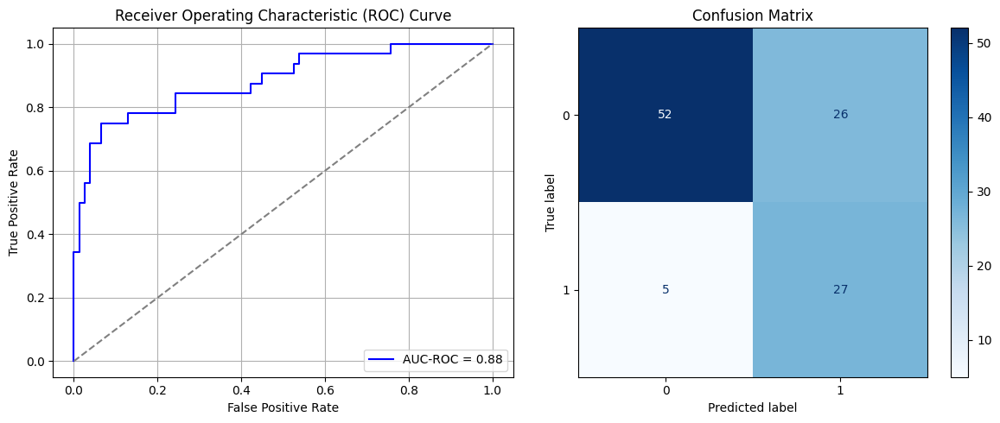

Best threshold based on F1-score: 0.8959411978721619
False Negative Rate: 0.15625
Time elapsed (performance): 0.5204933290006011
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.7635 - loss: 0.5975 - val_AUC: 0.8669 - val_loss: 0.4540
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8986 - loss: 0.4026 - val_AUC: 0.8872 - val_loss: 0.4269
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9157 - loss: 0.3647 - val_AUC: 0.8951 - val_loss: 0.4142
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9185 - loss: 0.3611 - val_AUC: 0.8985 - val_loss: 0.4064
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9264 - loss: 0.3400 - val_AUC: 0.8980 - val_loss: 0.4135
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9182 - loss: 0.3563 - val_AUC: 0.8981 - val_loss: 0.4165
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9241 - loss: 0.3463 - val_AUC: 0.8988 - val_loss: 0.4077
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9308 - loss: 0.3298 - val_AUC: 0.9008 - val_loss: 0.4176
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9204 -

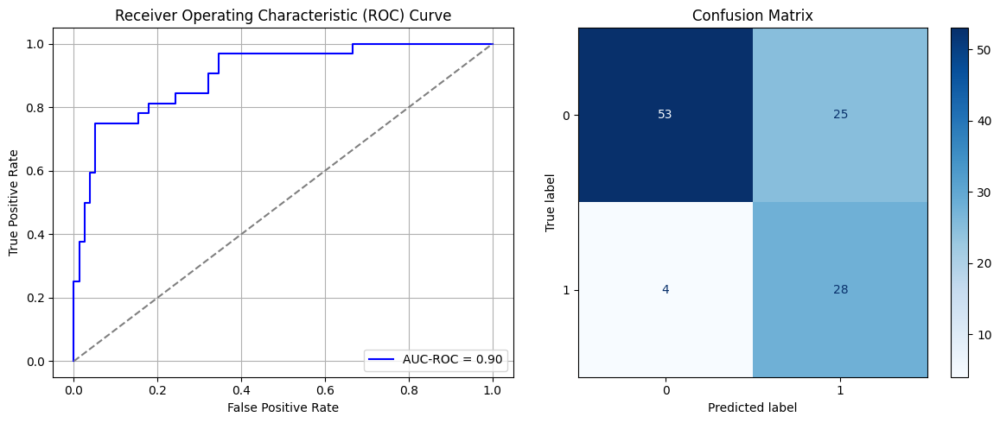

Best threshold based on F1-score: 0.9007860422134399
False Negative Rate: 0.125
Time elapsed (performance): 0.5258737509993807
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7940 - loss: 0.5993 - val_AUC: 0.8669 - val_loss: 0.4647
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8825 - loss: 0.4281 - val_AUC: 0.8867 - val_loss: 0.4382
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9084 - loss: 0.3765 - val_AUC: 0.8988 - val_loss: 0.4116
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9159 - loss: 0.3591 - val_AUC: 0.9031 - val_loss: 0.4120
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9215 - loss: 0.3441 - val_AUC: 0.9056 - val_loss: 0.3987
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9261 - loss: 0.3367 - val_AUC: 0.9056 - val_loss: 0.4070
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9237 - loss: 0.3453 - val_AUC: 0.9049 - val_loss: 0.4048
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9294 - loss: 0.3308 - val_AUC: 0.9072 - val_loss: 0.3997
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9376 -

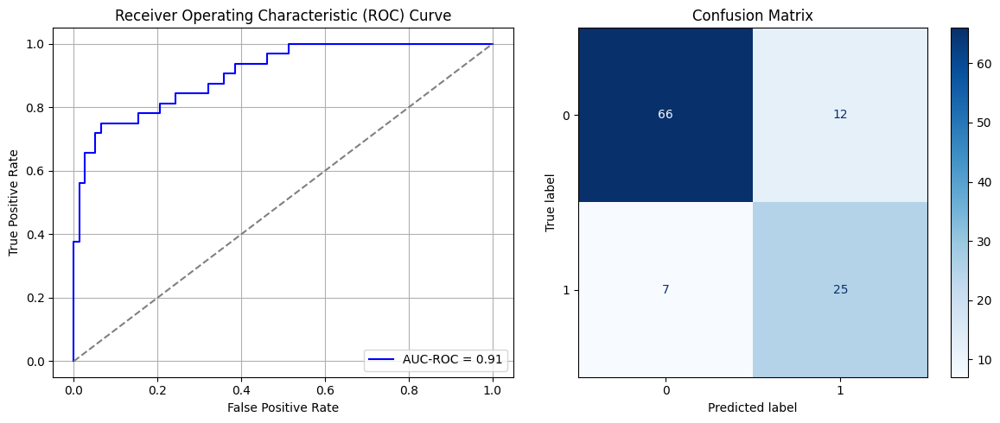

Best threshold based on F1-score: 0.7462351322174072
False Negative Rate: 0.21875
Time elapsed (performance): 0.5348148689990921
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7953 - loss: 0.6072 - val_AUC: 0.8778 - val_loss: 0.4484
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8919 - loss: 0.4112 - val_AUC: 0.8934 - val_loss: 0.4183
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9190 - loss: 0.3603 - val_AUC: 0.8992 - val_loss: 0.4091
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9135 - loss: 0.3629 - val_AUC: 0.9005 - val_loss: 0.4121
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9244 - loss: 0.3404 - val_AUC: 0.9022 - val_loss: 0.4118
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9183 - loss: 0.3550 - val_AUC: 0.9019 - val_loss: 0.4064
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9311 - loss: 0.3210 - val_AUC: 0.9036 - val_loss: 0.4049
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9290 - loss: 0.3321 - val_AUC: 0.9030 - val_loss: 0.4051
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9278 -

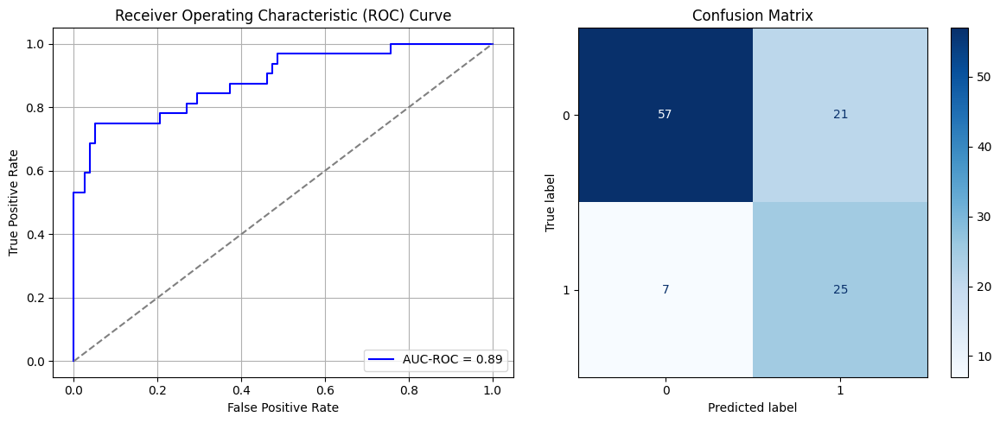

Best threshold based on F1-score: 0.9045188426971436
False Negative Rate: 0.21875
Time elapsed (performance): 0.7439191639987257
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7858 - loss: 0.6008 - val_AUC: 0.8643 - val_loss: 0.4604
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8826 - loss: 0.4285 - val_AUC: 0.8852 - val_loss: 0.4309
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9104 - loss: 0.3720 - val_AUC: 0.8964 - val_loss: 0.4281
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9097 - loss: 0.3752 - val_AUC: 0.8989 - val_loss: 0.4066
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9171 - loss: 0.3604 - val_AUC: 0.9000 - val_loss: 0.4310
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9189 - loss: 0.3550 - val_AUC: 0.8989 - val_loss: 0.4090
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9202 - loss: 0.3522 - val_AUC: 0.9056 - val_loss: 0.4127
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9292 - loss: 0.3353 - val_AUC: 0.9079 - val_loss: 0.3936
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9326 -

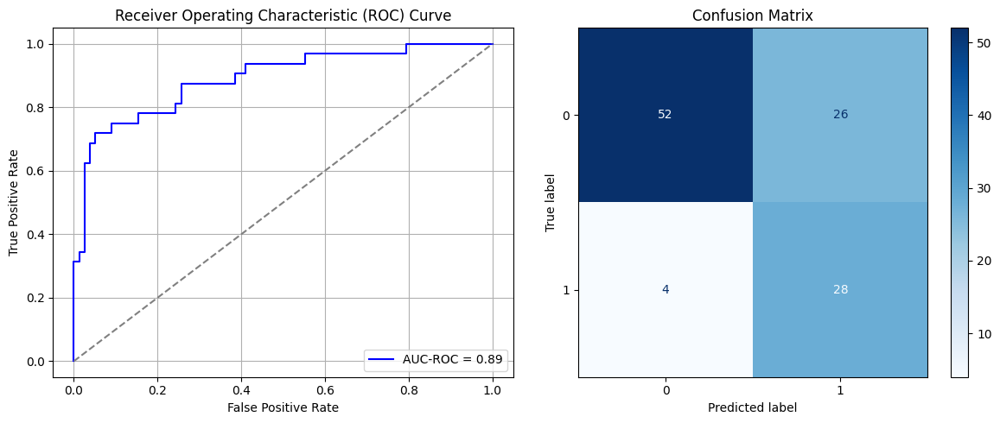

Best threshold based on F1-score: 0.9400848746299744
False Negative Rate: 0.125
Time elapsed (performance): 0.5425888509998913
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.6988 - loss: 0.6248 - val_AUC: 0.8763 - val_loss: 0.4427
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8964 - loss: 0.4122 - val_AUC: 0.8888 - val_loss: 0.4205
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8969 - loss: 0.4014 - val_AUC: 0.8899 - val_loss: 0.4181
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9048 - loss: 0.3828 - val_AUC: 0.8966 - val_loss: 0.4108
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9146 - loss: 0.3645 - val_AUC: 0.8976 - val_loss: 0.4065
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9198 - loss: 0.3524 - val_AUC: 0.8990 - val_loss: 0.4050
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9198 - loss: 0.3530 - val_AUC: 0.8996 - val_loss: 0.4042
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9207 - loss: 0.3447 - val_AUC: 0.8998 - val_loss: 0.4052
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9275 -

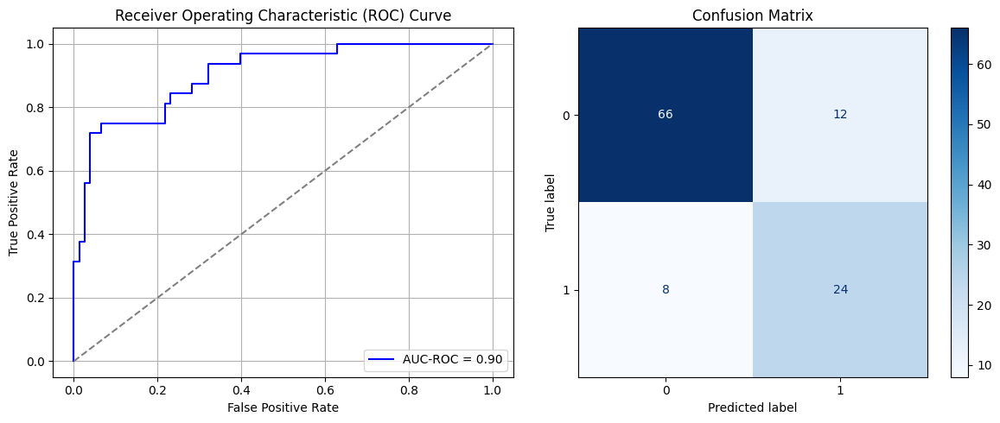

Best threshold based on F1-score: 0.8377623558044434
False Negative Rate: 0.25
Time elapsed (performance): 0.5107552319987008


In [74]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_min_ros = data_S_minority.sample(n=oversample_size - undersample_size, replace=True)
    data_S_SRS_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_SRS_ROS = data_S_SRS_ROS.iloc[:, :-1]
    y_S_SRS_ROS = data_S_SRS_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS_ROS, y_S_SRS_ROS, test_size=0.20, random_state=0)
    model_SRS_ROS = create_dnn_model(X_S_train.shape[1])
    result_SRS_ROS = train_and_evaluate(model_SRS_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS_ROS = Transductive_TL(model_SRS_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS_ROS)
    FPR.append(result_TL_SRS_ROS[0])
    TNR.append(result_TL_SRS_ROS[1])
    FNR.append(result_TL_SRS_ROS[2])
    TPR.append(result_TL_SRS_ROS[3])
    TL_time.append(result_TL_SRS_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [75]:
print(ParamFit)
ParamFit.to_csv('SRS_ROS2.csv')

    Source time       FPR       TNR      FNR      TPR  Target time
0     16.574095  0.217949  0.782051  0.18750  0.81250     0.471483
1      9.760051  0.333333  0.666667  0.15625  0.84375     0.468803
2      8.837884  0.179487  0.820513  0.21875  0.78125     0.491272
3      7.858711  0.243590  0.756410  0.18750  0.81250     0.654683
4      7.253595  0.384615  0.615385  0.15625  0.84375     0.466723
5      9.475200  0.243590  0.756410  0.21875  0.78125     0.479618
6      7.603313  0.269231  0.730769  0.21875  0.78125     0.664746
7      7.767410  0.205128  0.794872  0.21875  0.78125     0.491561
8      8.332300  0.448718  0.551282  0.06250  0.93750     0.481743
9      9.014952  0.269231  0.730769  0.18750  0.81250     0.482574
10     7.870088  0.102564  0.897436  0.25000  0.75000     0.507800
11     9.182852  0.230769  0.769231  0.21875  0.78125     0.483101
12     8.692912  0.217949  0.782051  0.21875  0.78125     0.488791
13     9.748456  0.474359  0.525641  0.06250  0.93750     0.49

## Systematic Resampling:

In this case, we examine the possibility of performing Random Oversampling on the minority class using systematic sampling. For this purpose, taking a sampling interval of $k$, we would compile a total of $k*\frac{N_0-N_1}{N_1}$ systematic samples from the minority class in order to balance the dataset. We sample the starting point from 1 to $k$ *with replacement*, since a highly imbalanced dataset will require sampling with replacement in order to achieve a balanced dataset.

In particular, taking $k=10$ yields a number of samples of $k*\frac{N_0-N_1}{N_1}= 11.05 \approx 11$, so we take $k=10$.

In [76]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

1389
2925


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7216 - loss: 0.6271 - val_AUC: 0.8788 - val_loss: 0.4559
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8824 - loss: 0.4292 - val_AUC: 0.8943 - val_loss: 0.4129
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8955 - loss: 0.3993 - val_AUC: 0.9007 - val_loss: 0.4071
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9110 - loss: 0.3692 - val_AUC: 0.9053 - val_loss: 0.4000
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9073 - loss: 0.3740 - val_AUC: 0.9073 - val_loss: 0.3948
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9170 - loss: 0.3525 - val_AUC: 0.9081 - val_loss: 0.3922
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9172 - loss: 0.3532 - val_AUC: 0.9082 - val_loss: 0.3943
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9252 - loss: 0.3355 - val_AUC: 0.9072 - val_loss: 0.3952
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9273 -

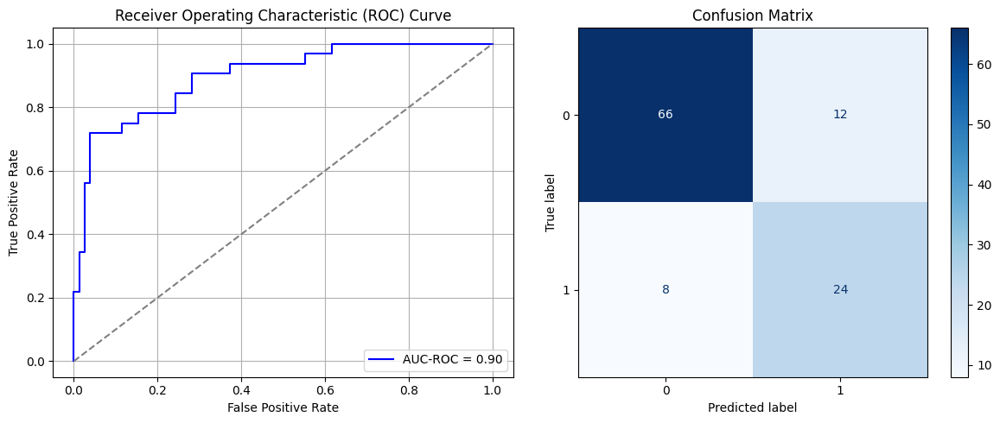

Best threshold based on F1-score: 0.8754097819328308
False Negative Rate: 0.25
Time elapsed (performance): 0.44641483099985635
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6927 - loss: 0.6324 - val_AUC: 0.8745 - val_loss: 0.4463
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8789 - loss: 0.4303 - val_AUC: 0.8978 - val_loss: 0.4143
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8988 - loss: 0.3908 - val_AUC: 0.9074 - val_loss: 0.3934
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9175 - loss: 0.3543 - val_AUC: 0.9091 - val_loss: 0.3896
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9123 - loss: 0.3653 - val_AUC: 0.9097 - val_loss: 0.3970
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9197 - loss: 0.3489 - val_AUC: 0.9115 - val_loss: 0.3877
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9270 - loss: 0.3398 - val_AUC: 0.9125 - val_loss: 0.3831
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9252 - loss: 0.3403 - val_AUC: 0.9122 - val_loss: 0.3926
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9268 -

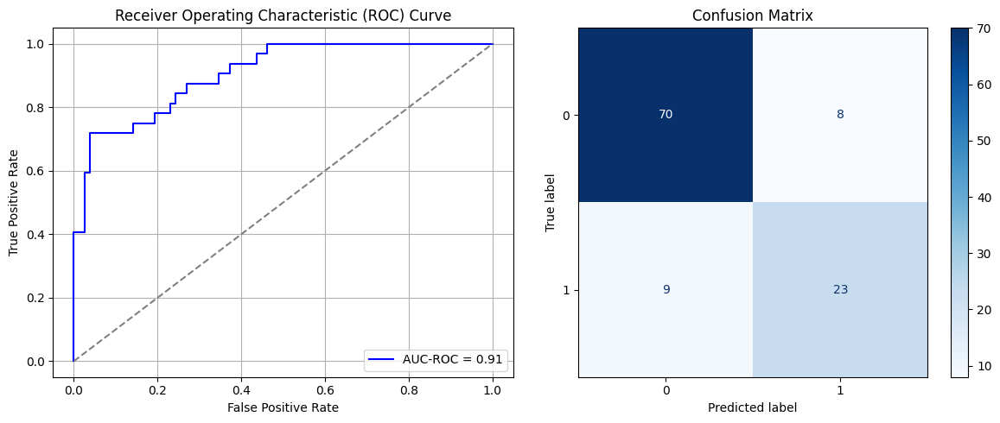

Best threshold based on F1-score: 0.7720889449119568
False Negative Rate: 0.28125
Time elapsed (performance): 0.659835557000406
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7741 - loss: 0.5957 - val_AUC: 0.8813 - val_loss: 0.4415
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8941 - loss: 0.4068 - val_AUC: 0.8969 - val_loss: 0.4312
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9124 - loss: 0.3691 - val_AUC: 0.9033 - val_loss: 0.4016
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9139 - loss: 0.3641 - val_AUC: 0.9057 - val_loss: 0.4005
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9196 - loss: 0.3531 - val_AUC: 0.9049 - val_loss: 0.4105
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9062 - loss: 0.3759 - val_AUC: 0.9077 - val_loss: 0.4063
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9214 - loss: 0.3472 - val_AUC: 0.9073 - val_loss: 0.3965
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9269 - loss: 0.3313 - val_AUC: 0.9080 - val_loss: 0.3948
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9227 -

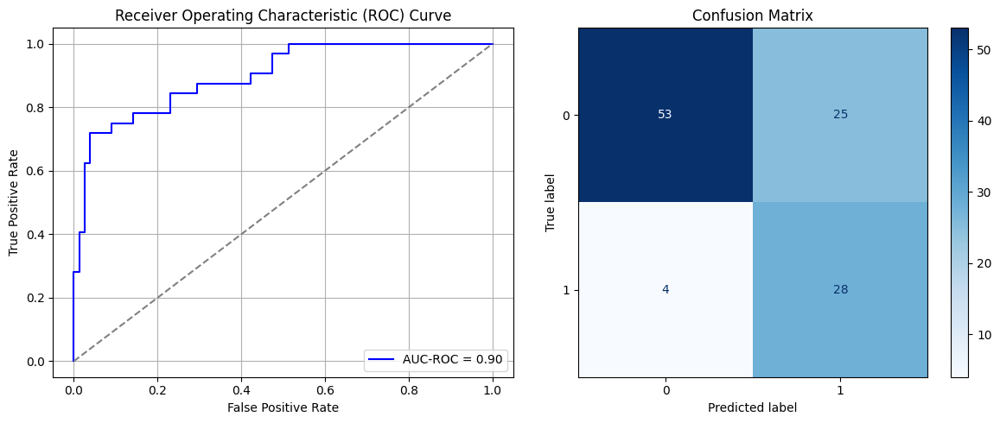

Best threshold based on F1-score: 0.949316680431366
False Negative Rate: 0.125
Time elapsed (performance): 0.4844718559998
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7325 - loss: 0.6153 - val_AUC: 0.8863 - val_loss: 0.4754
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8955 - loss: 0.4110 - val_AUC: 0.9023 - val_loss: 0.4085
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9050 - loss: 0.3819 - val_AUC: 0.9090 - val_loss: 0.3869
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9117 - loss: 0.3661 - val_AUC: 0.9124 - val_loss: 0.3813
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9141 - loss: 0.3640 - val_AUC: 0.9133 - val_loss: 0.4072
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9216 - loss: 0.3454 - val_AUC: 0.9150 - val_loss: 0.3759
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9268 - loss: 0.3402 - val_AUC: 0.9163 - val_loss: 0.3821
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9268 - loss: 0.3280 - val_AUC: 0.9144 - val_loss: 0.3757
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9203 -

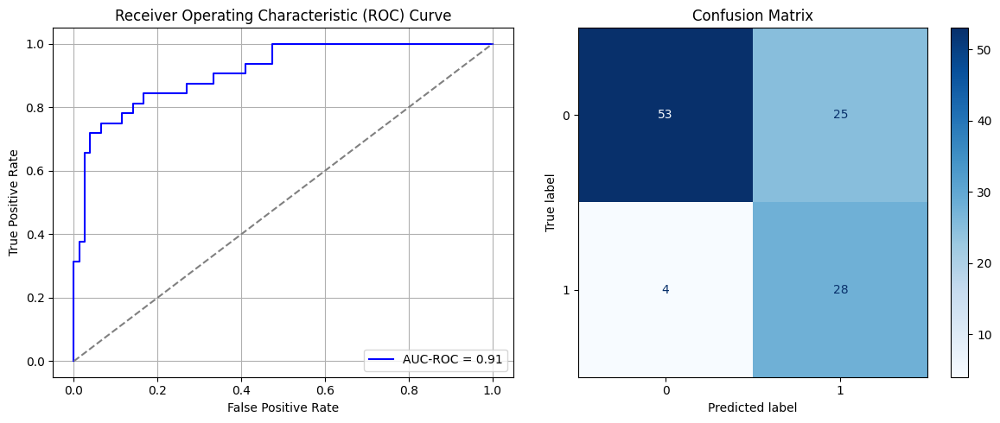

Best threshold based on F1-score: 0.8885524272918701
False Negative Rate: 0.125
Time elapsed (performance): 0.48758125599852065
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8192 - loss: 0.5759 - val_AUC: 0.8842 - val_loss: 0.4325
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8947 - loss: 0.4043 - val_AUC: 0.8989 - val_loss: 0.4105
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9033 - loss: 0.3882 - val_AUC: 0.9056 - val_loss: 0.3939
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9128 - loss: 0.3646 - val_AUC: 0.9075 - val_loss: 0.4084
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9164 - loss: 0.3538 - val_AUC: 0.9093 - val_loss: 0.3863
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9147 - loss: 0.3577 - val_AUC: 0.9098 - val_loss: 0.3882
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9212 - loss: 0.3407 - val_AUC: 0.9114 - val_loss: 0.3813
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9239 - loss: 0.3463 - val_AUC: 0.9117 - val_loss: 0.3792
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9265 -

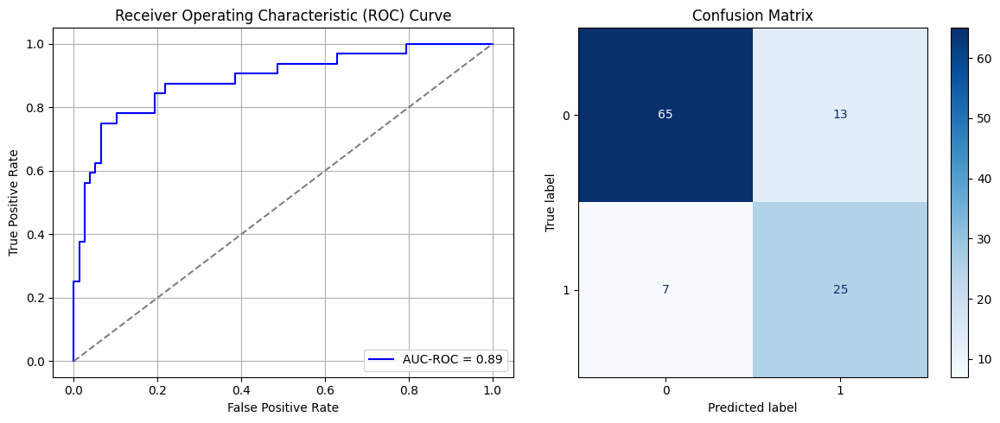

Best threshold based on F1-score: 0.7611463069915771
False Negative Rate: 0.21875
Time elapsed (performance): 0.4646510500006116
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7632 - loss: 0.5926 - val_AUC: 0.8832 - val_loss: 0.4393
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8973 - loss: 0.3981 - val_AUC: 0.8998 - val_loss: 0.4101
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9044 - loss: 0.3837 - val_AUC: 0.9058 - val_loss: 0.3901
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9142 - loss: 0.3642 - val_AUC: 0.9094 - val_loss: 0.4016
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9209 - loss: 0.3473 - val_AUC: 0.9096 - val_loss: 0.3829
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9267 - loss: 0.3375 - val_AUC: 0.9112 - val_loss: 0.3858
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9276 - loss: 0.3318 - val_AUC: 0.9099 - val_loss: 0.3803
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9200 - loss: 0.3510 - val_AUC: 0.9113 - val_loss: 0.3847
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9287 -

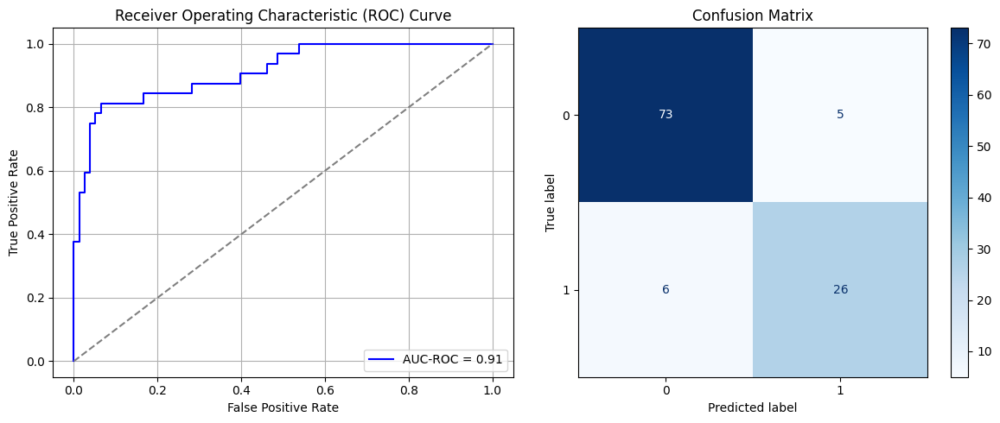

Best threshold based on F1-score: 0.5065023899078369
False Negative Rate: 0.1875
Time elapsed (performance): 0.6514172699990013
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7690 - loss: 0.6010 - val_AUC: 0.8871 - val_loss: 0.4287
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8949 - loss: 0.4068 - val_AUC: 0.9015 - val_loss: 0.4034
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9091 - loss: 0.3743 - val_AUC: 0.9093 - val_loss: 0.3889
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9164 - loss: 0.3561 - val_AUC: 0.9111 - val_loss: 0.3821
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9137 - loss: 0.3652 - val_AUC: 0.9124 - val_loss: 0.3861
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9131 - loss: 0.3684 - val_AUC: 0.9131 - val_loss: 0.3792
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9157 - loss: 0.3521 - val_AUC: 0.9139 - val_loss: 0.3767
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9277 - loss: 0.3294 - val_AUC: 0.9152 - val_loss: 0.3836
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9230 -

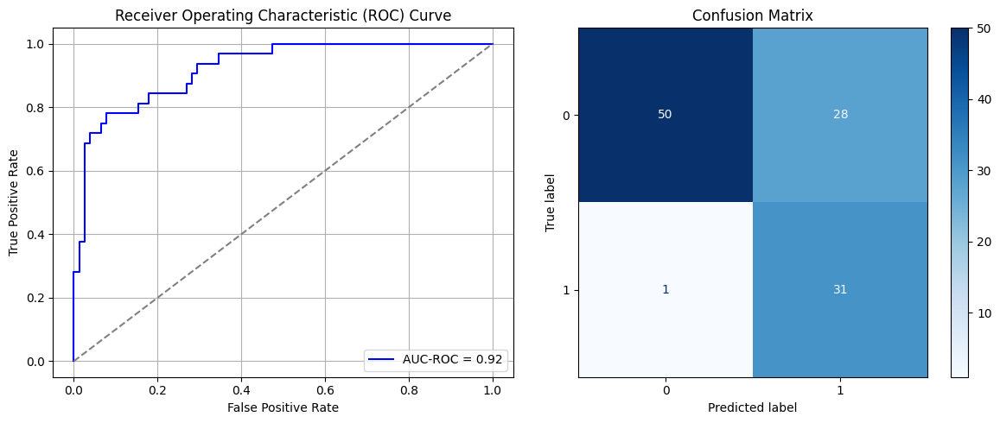

Best threshold based on F1-score: 0.8588448166847229
False Negative Rate: 0.03125
Time elapsed (performance): 0.4764363809990755
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7737 - loss: 0.5996 - val_AUC: 0.8775 - val_loss: 0.4471
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8866 - loss: 0.4219 - val_AUC: 0.8931 - val_loss: 0.4170
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9083 - loss: 0.3764 - val_AUC: 0.8998 - val_loss: 0.4111
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9097 - loss: 0.3714 - val_AUC: 0.9029 - val_loss: 0.3976
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9111 - loss: 0.3667 - val_AUC: 0.9048 - val_loss: 0.4061
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9212 - loss: 0.3440 - val_AUC: 0.9061 - val_loss: 0.3997
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9184 - loss: 0.3550 - val_AUC: 0.9081 - val_loss: 0.3932
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9228 - loss: 0.3452 - val_AUC: 0.9085 - val_loss: 0.3922
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9261 -

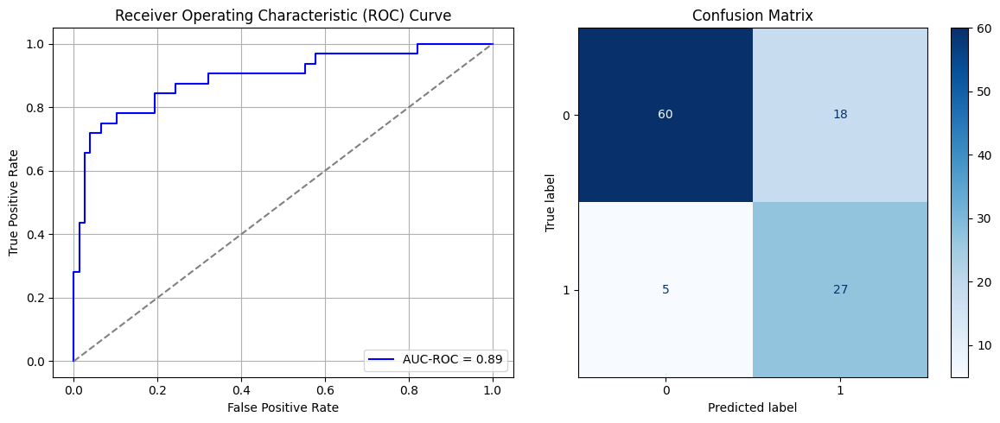

Best threshold based on F1-score: 0.8439394235610962
False Negative Rate: 0.15625
Time elapsed (performance): 0.4708843539992813
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7936 - loss: 0.5964 - val_AUC: 0.8784 - val_loss: 0.4402
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8832 - loss: 0.4238 - val_AUC: 0.8965 - val_loss: 0.4016
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8928 - loss: 0.4020 - val_AUC: 0.9045 - val_loss: 0.4063
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9023 - loss: 0.3791 - val_AUC: 0.9082 - val_loss: 0.3897
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9173 - loss: 0.3530 - val_AUC: 0.9104 - val_loss: 0.3920
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9124 - loss: 0.3615 - val_AUC: 0.9120 - val_loss: 0.3771
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9232 - loss: 0.3412 - val_AUC: 0.9138 - val_loss: 0.3746
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9284 - loss: 0.3321 - val_AUC: 0.9142 - val_loss: 0.3791
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9275 -

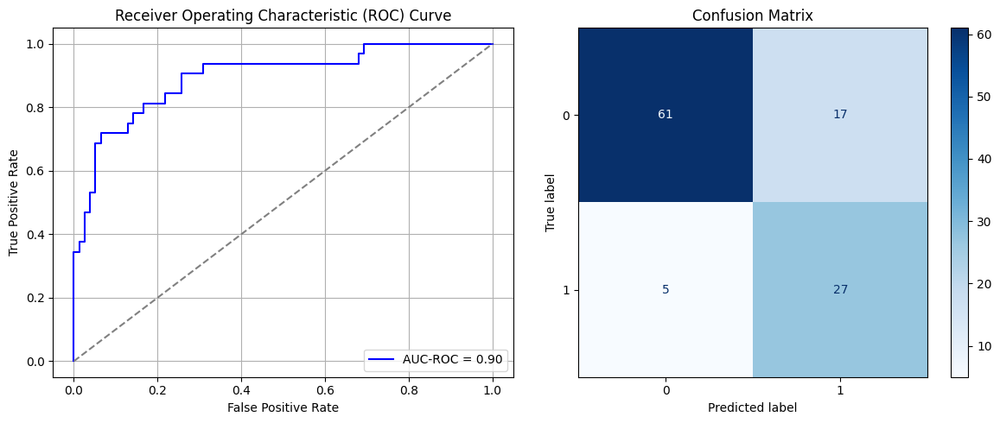

Best threshold based on F1-score: 0.8087894916534424
False Negative Rate: 0.15625
Time elapsed (performance): 0.6726639709995652
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7804 - loss: 0.5997 - val_AUC: 0.8861 - val_loss: 0.4333
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8915 - loss: 0.4142 - val_AUC: 0.8988 - val_loss: 0.4032
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9087 - loss: 0.3733 - val_AUC: 0.9049 - val_loss: 0.4028
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9126 - loss: 0.3653 - val_AUC: 0.9073 - val_loss: 0.3935
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9145 - loss: 0.3635 - val_AUC: 0.9087 - val_loss: 0.3897
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9139 - loss: 0.3652 - val_AUC: 0.9105 - val_loss: 0.3948
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9261 - loss: 0.3426 - val_AUC: 0.9102 - val_loss: 0.3940
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9244 - loss: 0.3448 - val_AUC: 0.9127 - val_loss: 0.3820
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9316 -

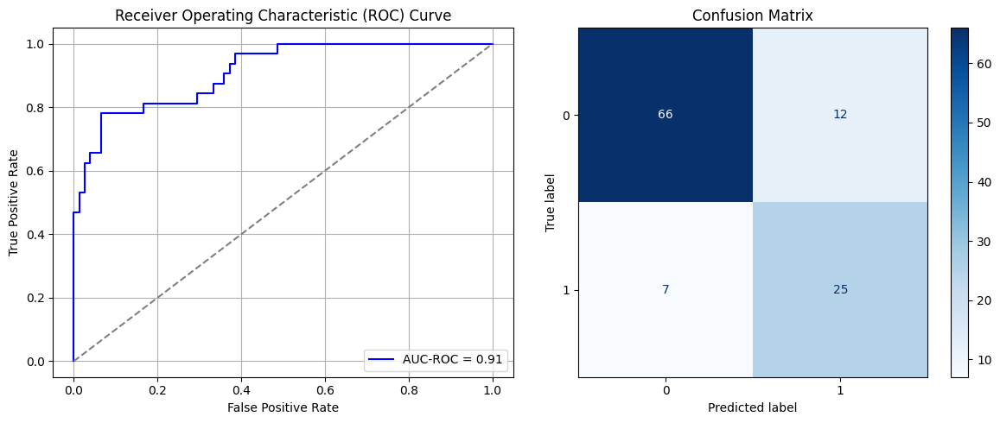

Best threshold based on F1-score: 0.7645694017410278
False Negative Rate: 0.21875
Time elapsed (performance): 0.4888969929997984
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7696 - loss: 0.6078 - val_AUC: 0.8764 - val_loss: 0.4441
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8830 - loss: 0.4232 - val_AUC: 0.8953 - val_loss: 0.4172
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8945 - loss: 0.3966 - val_AUC: 0.9013 - val_loss: 0.4033
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9082 - loss: 0.3702 - val_AUC: 0.9062 - val_loss: 0.3900
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9094 - loss: 0.3735 - val_AUC: 0.9066 - val_loss: 0.3932
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9141 - loss: 0.3623 - val_AUC: 0.9107 - val_loss: 0.3847
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9089 - loss: 0.3699 - val_AUC: 0.9113 - val_loss: 0.3852
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9182 - loss: 0.3543 - val_AUC: 0.9114 - val_loss: 0.3906
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9222 -

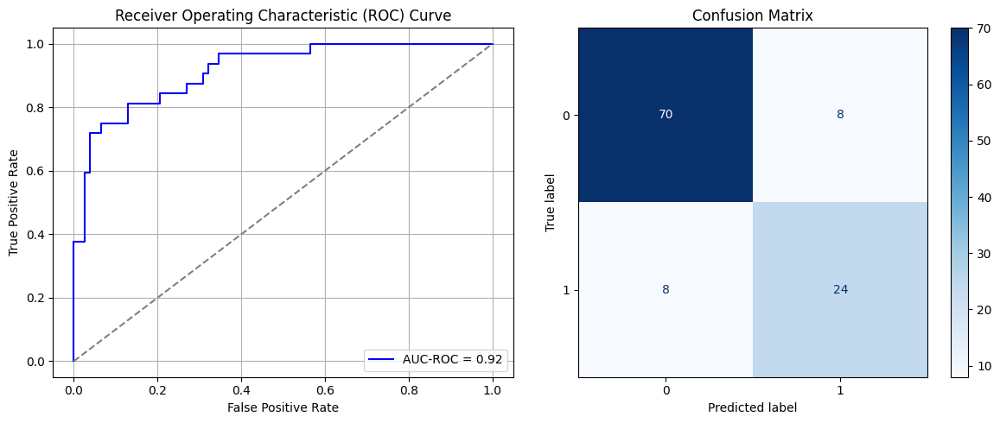

Best threshold based on F1-score: 0.8050225377082825
False Negative Rate: 0.25
Time elapsed (performance): 0.4824578070001735
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7047 - loss: 0.6267 - val_AUC: 0.8779 - val_loss: 0.4479
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8711 - loss: 0.4416 - val_AUC: 0.8970 - val_loss: 0.4263
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8896 - loss: 0.4113 - val_AUC: 0.9037 - val_loss: 0.4069
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9088 - loss: 0.3733 - val_AUC: 0.9067 - val_loss: 0.3946
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9117 - loss: 0.3682 - val_AUC: 0.9064 - val_loss: 0.3980
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9122 - loss: 0.3673 - val_AUC: 0.9085 - val_loss: 0.3929
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9175 - loss: 0.3555 - val_AUC: 0.9060 - val_loss: 0.4179
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9253 - loss: 0.3391 - val_AUC: 0.9086 - val_loss: 0.3959
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9305 -

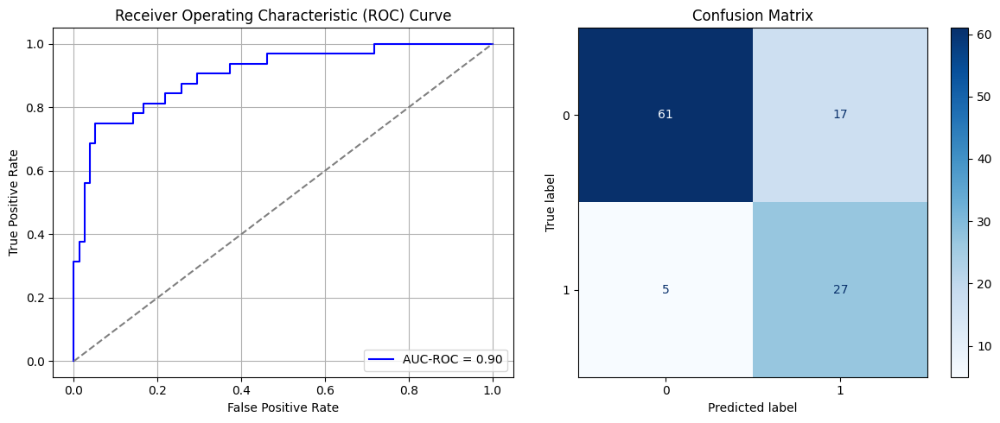

Best threshold based on F1-score: 0.864197313785553
False Negative Rate: 0.15625
Time elapsed (performance): 0.4766507059994183
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7790 - loss: 0.6098 - val_AUC: 0.8879 - val_loss: 0.4316
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8915 - loss: 0.4116 - val_AUC: 0.9043 - val_loss: 0.4002
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9037 - loss: 0.3857 - val_AUC: 0.9074 - val_loss: 0.3994
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9085 - loss: 0.3727 - val_AUC: 0.9111 - val_loss: 0.3851
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9140 - loss: 0.3607 - val_AUC: 0.9151 - val_loss: 0.3853
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9132 - loss: 0.3656 - val_AUC: 0.9158 - val_loss: 0.3782
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9193 - loss: 0.3466 - val_AUC: 0.9160 - val_loss: 0.3772
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9150 - loss: 0.3573 - val_AUC: 0.9162 - val_loss: 0.3797
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9272 -

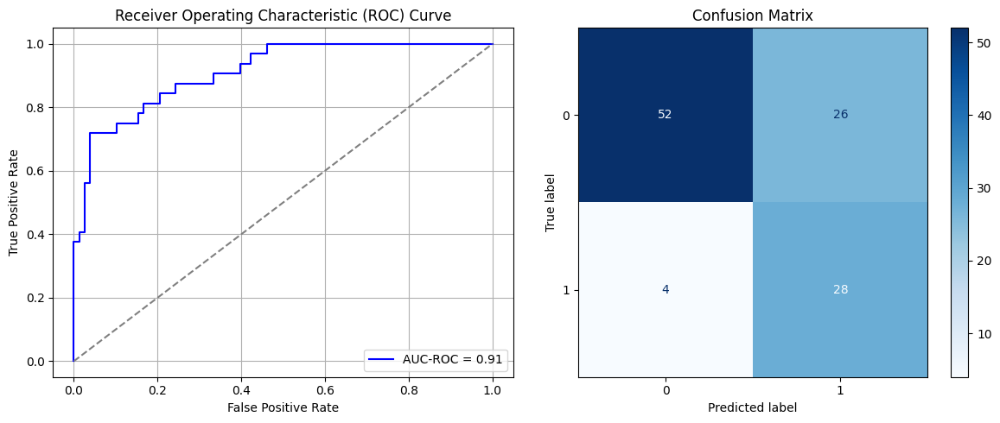

Best threshold based on F1-score: 0.9389438033103943
False Negative Rate: 0.125
Time elapsed (performance): 0.7045787529987138
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7437 - loss: 0.6112 - val_AUC: 0.8837 - val_loss: 0.4353
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8849 - loss: 0.4197 - val_AUC: 0.9018 - val_loss: 0.4033
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8917 - loss: 0.4026 - val_AUC: 0.9060 - val_loss: 0.4001
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9064 - loss: 0.3741 - val_AUC: 0.9099 - val_loss: 0.3996
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9165 - loss: 0.3619 - val_AUC: 0.9121 - val_loss: 0.3799
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9176 - loss: 0.3537 - val_AUC: 0.9131 - val_loss: 0.3790
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9211 - loss: 0.3479 - val_AUC: 0.9138 - val_loss: 0.3802
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9142 - loss: 0.3605 - val_AUC: 0.9150 - val_loss: 0.3740
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9250 -

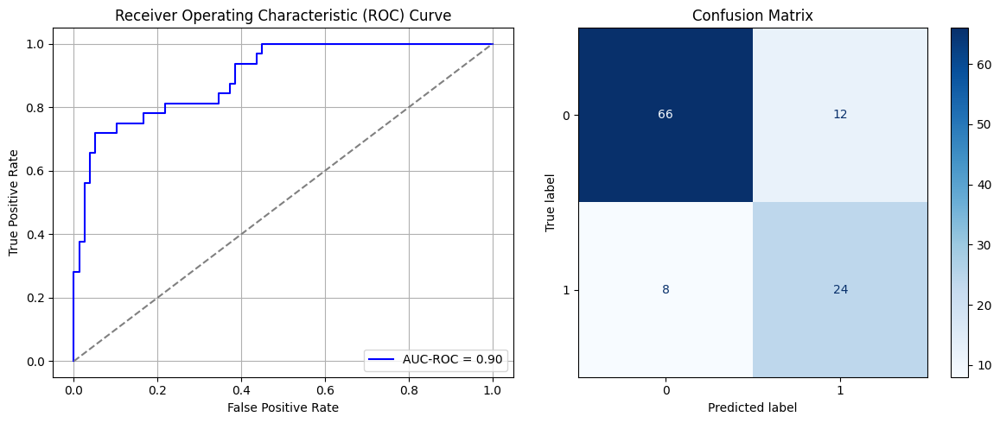

Best threshold based on F1-score: 0.7571247220039368
False Negative Rate: 0.25
Time elapsed (performance): 0.4530741759990633
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7658 - loss: 0.6030 - val_AUC: 0.8714 - val_loss: 0.4535
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8829 - loss: 0.4283 - val_AUC: 0.8866 - val_loss: 0.4279
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8950 - loss: 0.3996 - val_AUC: 0.8969 - val_loss: 0.4119
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9112 - loss: 0.3655 - val_AUC: 0.8988 - val_loss: 0.4245
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9141 - loss: 0.3631 - val_AUC: 0.9007 - val_loss: 0.4022
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9191 - loss: 0.3547 - val_AUC: 0.9004 - val_loss: 0.4039
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9193 - loss: 0.3502 - val_AUC: 0.9018 - val_loss: 0.4118
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9268 - loss: 0.3360 - val_AUC: 0.9019 - val_loss: 0.4001
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9239 -

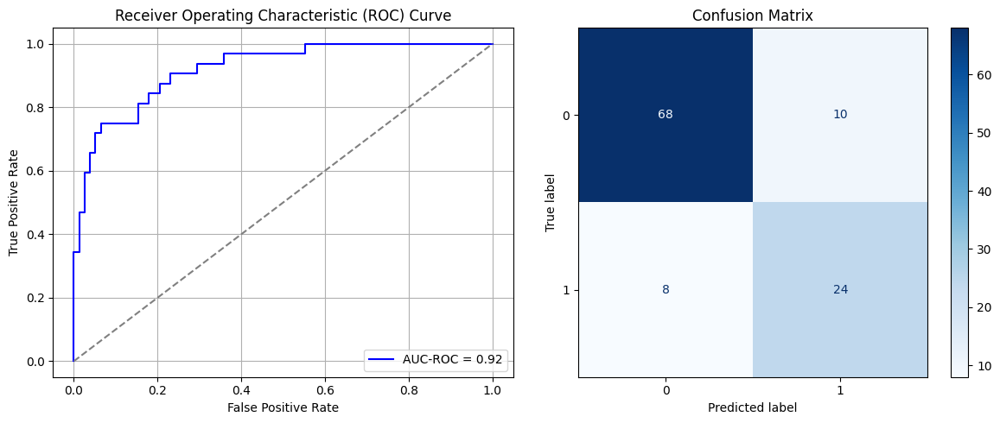

Best threshold based on F1-score: 0.7854036092758179
False Negative Rate: 0.25
Time elapsed (performance): 0.4860564800001157
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7631 - loss: 0.6026 - val_AUC: 0.8799 - val_loss: 0.4378
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8907 - loss: 0.4152 - val_AUC: 0.8979 - val_loss: 0.4120
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9051 - loss: 0.3854 - val_AUC: 0.9020 - val_loss: 0.3966
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9164 - loss: 0.3622 - val_AUC: 0.9060 - val_loss: 0.3898
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9191 - loss: 0.3526 - val_AUC: 0.9073 - val_loss: 0.3881
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9179 - loss: 0.3539 - val_AUC: 0.9075 - val_loss: 0.3935
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9248 - loss: 0.3436 - val_AUC: 0.9094 - val_loss: 0.3904
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9215 - loss: 0.3495 - val_AUC: 0.9116 - val_loss: 0.3816
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9164 -

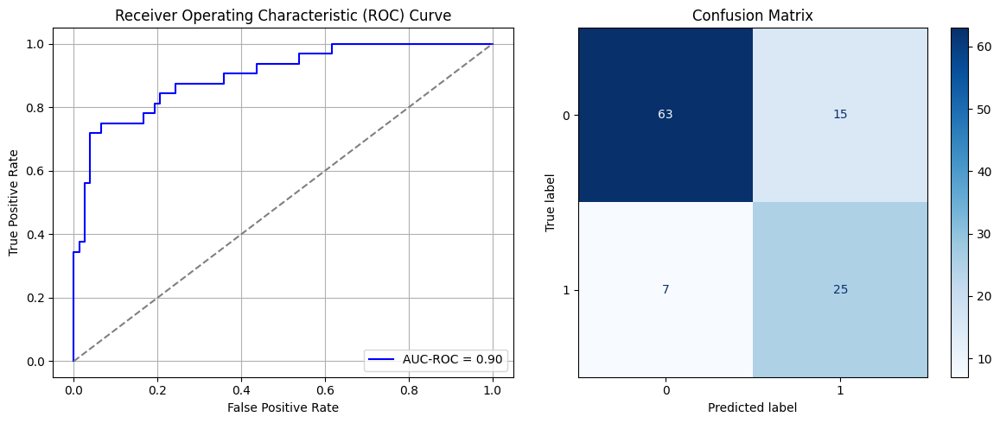

Best threshold based on F1-score: 0.850512683391571
False Negative Rate: 0.21875
Time elapsed (performance): 0.46363987199947587
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7642 - loss: 0.6101 - val_AUC: 0.8737 - val_loss: 0.4482
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8857 - loss: 0.4228 - val_AUC: 0.8965 - val_loss: 0.4157
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9067 - loss: 0.3792 - val_AUC: 0.9030 - val_loss: 0.4214
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9135 - loss: 0.3687 - val_AUC: 0.9059 - val_loss: 0.3948
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9206 - loss: 0.3555 - val_AUC: 0.9082 - val_loss: 0.3919
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9193 - loss: 0.3560 - val_AUC: 0.9088 - val_loss: 0.3973
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9134 - loss: 0.3648 - val_AUC: 0.9078 - val_loss: 0.3931
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9256 - loss: 0.3439 - val_AUC: 0.9085 - val_loss: 0.3932
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9257 -

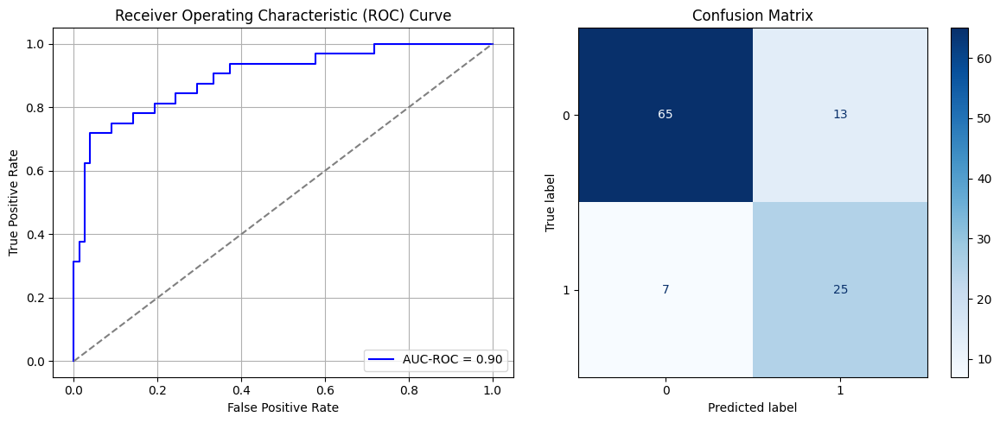

Best threshold based on F1-score: 0.8620880842208862
False Negative Rate: 0.21875
Time elapsed (performance): 0.4881962529998418
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7132 - loss: 0.6300 - val_AUC: 0.8794 - val_loss: 0.4487
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8706 - loss: 0.4478 - val_AUC: 0.9011 - val_loss: 0.4062
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8974 - loss: 0.3983 - val_AUC: 0.9088 - val_loss: 0.3935
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9105 - loss: 0.3715 - val_AUC: 0.9131 - val_loss: 0.3827
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9162 - loss: 0.3598 - val_AUC: 0.9147 - val_loss: 0.3816
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9162 - loss: 0.3629 - val_AUC: 0.9162 - val_loss: 0.3832
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9226 - loss: 0.3467 - val_AUC: 0.9165 - val_loss: 0.3769
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9191 - loss: 0.3531 - val_AUC: 0.9170 - val_loss: 0.3832
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9230 -

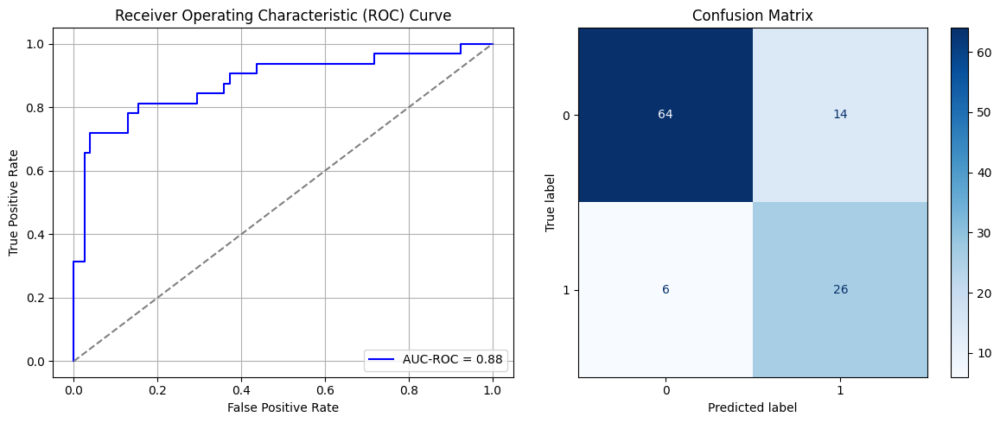

Best threshold based on F1-score: 0.8591429591178894
False Negative Rate: 0.1875
Time elapsed (performance): 0.49698529799934477
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6915 - loss: 0.6357 - val_AUC: 0.8758 - val_loss: 0.4516
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8832 - loss: 0.4267 - val_AUC: 0.8962 - val_loss: 0.4047
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9012 - loss: 0.3910 - val_AUC: 0.9043 - val_loss: 0.3920
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9171 - loss: 0.3607 - val_AUC: 0.9096 - val_loss: 0.3860
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9218 - loss: 0.3500 - val_AUC: 0.9108 - val_loss: 0.3869
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9110 - loss: 0.3670 - val_AUC: 0.9120 - val_loss: 0.3811
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9236 - loss: 0.3394 - val_AUC: 0.9136 - val_loss: 0.3778
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9181 - loss: 0.3528 - val_AUC: 0.9133 - val_loss: 0.3894
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9169 -

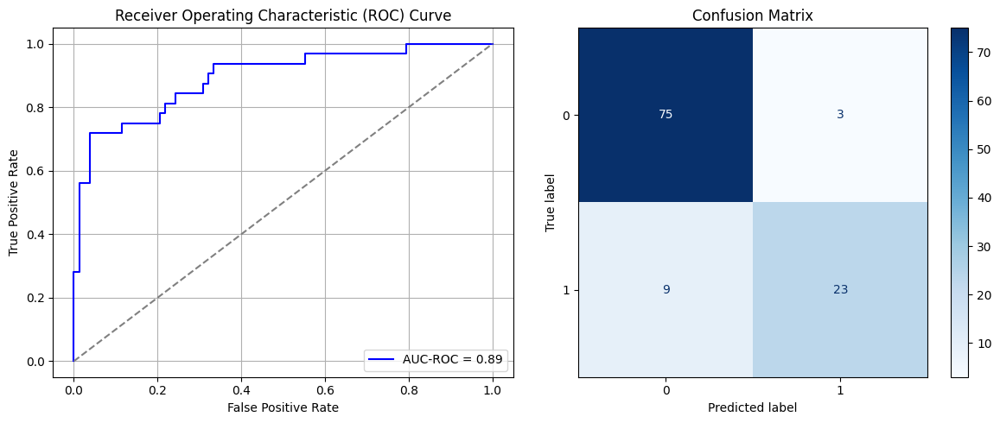

Best threshold based on F1-score: 0.5988938808441162
False Negative Rate: 0.28125
Time elapsed (performance): 0.49171782700068434
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7566 - loss: 0.6165 - val_AUC: 0.8856 - val_loss: 0.4381
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8904 - loss: 0.4139 - val_AUC: 0.9009 - val_loss: 0.4087
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9021 - loss: 0.3860 - val_AUC: 0.9050 - val_loss: 0.3988
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9118 - loss: 0.3703 - val_AUC: 0.9087 - val_loss: 0.3904
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9151 - loss: 0.3592 - val_AUC: 0.9099 - val_loss: 0.3876
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9119 - loss: 0.3670 - val_AUC: 0.9113 - val_loss: 0.3863
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9273 - loss: 0.3313 - val_AUC: 0.9102 - val_loss: 0.4040
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9262 - loss: 0.3395 - val_AUC: 0.9140 - val_loss: 0.3818
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9278 -

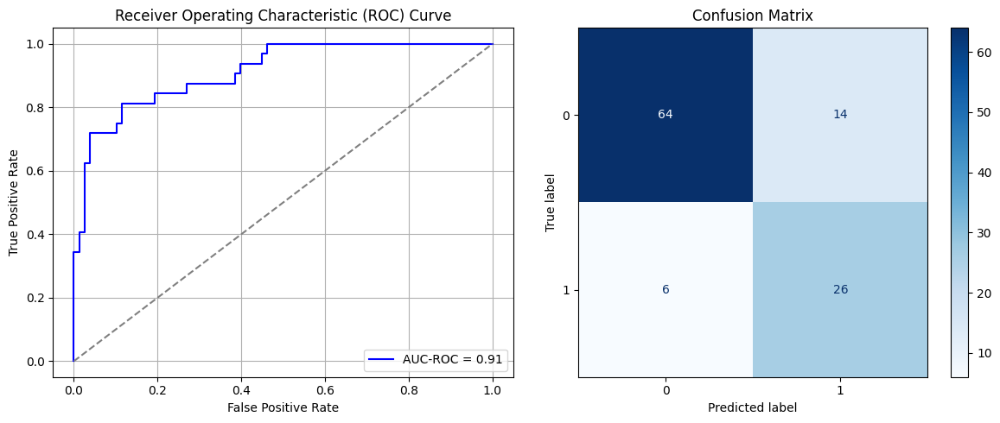

Best threshold based on F1-score: 0.8819610476493835
False Negative Rate: 0.1875
Time elapsed (performance): 0.48591446799946425
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7614 - loss: 0.6216 - val_AUC: 0.8945 - val_loss: 0.4175
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8953 - loss: 0.3989 - val_AUC: 0.9094 - val_loss: 0.3882
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9121 - loss: 0.3673 - val_AUC: 0.9140 - val_loss: 0.3746
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9103 - loss: 0.3701 - val_AUC: 0.9177 - val_loss: 0.3689
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9123 - loss: 0.3622 - val_AUC: 0.9192 - val_loss: 0.3662
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9241 - loss: 0.3430 - val_AUC: 0.9206 - val_loss: 0.3684
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9170 - loss: 0.3489 - val_AUC: 0.9222 - val_loss: 0.3600
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9256 - loss: 0.3312 - val_AUC: 0.9222 - val_loss: 0.3634
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9283 -

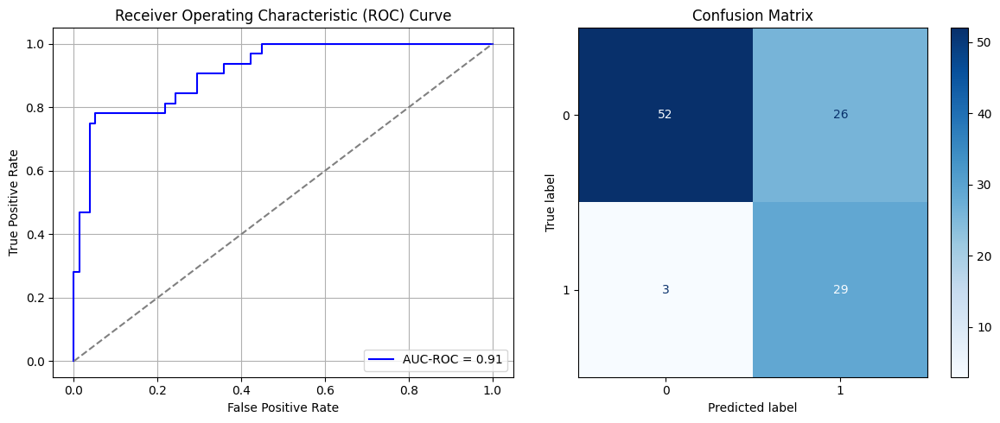

Best threshold based on F1-score: 0.8855571150779724
False Negative Rate: 0.09375
Time elapsed (performance): 0.47144037399993977
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7281 - loss: 0.6145 - val_AUC: 0.8779 - val_loss: 0.4478
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8832 - loss: 0.4284 - val_AUC: 0.8941 - val_loss: 0.4232
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9003 - loss: 0.3927 - val_AUC: 0.9024 - val_loss: 0.3975
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9227 - loss: 0.3483 - val_AUC: 0.9051 - val_loss: 0.3964
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9202 - loss: 0.3498 - val_AUC: 0.9067 - val_loss: 0.4083
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9216 - loss: 0.3422 - val_AUC: 0.9065 - val_loss: 0.4026
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9223 - loss: 0.3455 - val_AUC: 0.9072 - val_loss: 0.3987
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9214 - loss: 0.3483 - val_AUC: 0.9091 - val_loss: 0.3889
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9364 -

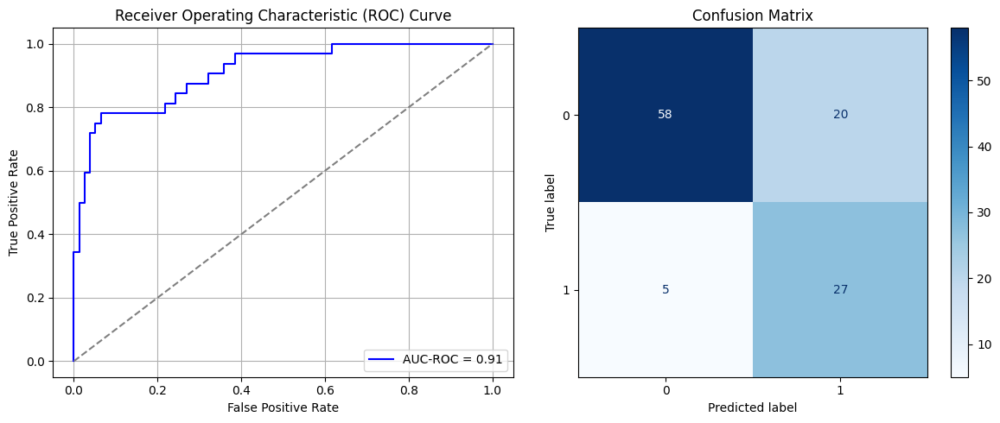

Best threshold based on F1-score: 0.8396655321121216
False Negative Rate: 0.15625
Time elapsed (performance): 0.484458959001131
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.7488 - loss: 0.6225 - val_AUC: 0.8791 - val_loss: 0.4446
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8837 - loss: 0.4286 - val_AUC: 0.8954 - val_loss: 0.4151
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8971 - loss: 0.3955 - val_AUC: 0.9020 - val_loss: 0.4058
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9195 - loss: 0.3555 - val_AUC: 0.9036 - val_loss: 0.4055
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9215 - loss: 0.3504 - val_AUC: 0.9067 - val_loss: 0.3978
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9209 - loss: 0.3511 - val_AUC: 0.9064 - val_loss: 0.4085
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9265 - loss: 0.3389 - val_AUC: 0.9086 - val_loss: 0.3934
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9208 - loss: 0.3503 - val_AUC: 0.9098 - val_loss: 0.3916
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9268 -

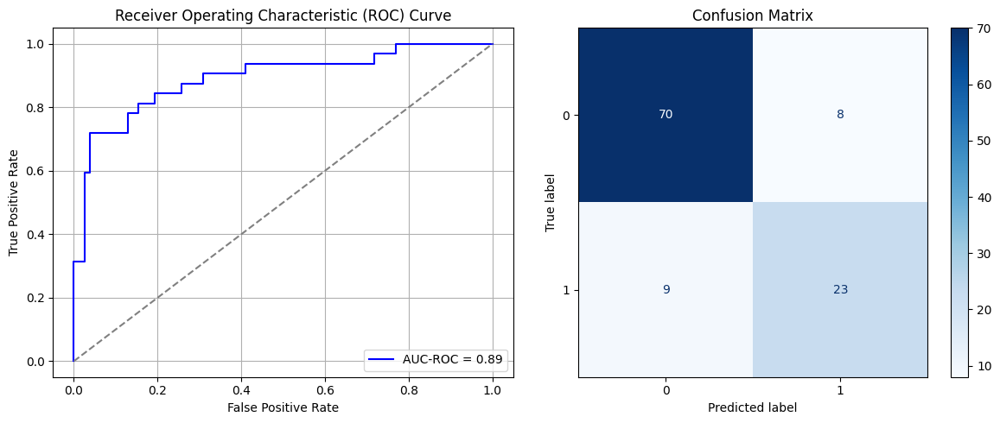

Best threshold based on F1-score: 0.725488543510437
False Negative Rate: 0.28125
Time elapsed (performance): 0.4871052360012982
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 8s 7ms/step - AUC: 0.7837 - loss: 0.5972 - val_AUC: 0.8774 - val_loss: 0.4467
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8885 - loss: 0.4158 - val_AUC: 0.8933 - val_loss: 0.4129
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9076 - loss: 0.3749 - val_AUC: 0.8985 - val_loss: 0.4044
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9114 - loss: 0.3652 - val_AUC: 0.9023 - val_loss: 0.3987
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9122 - loss: 0.3600 - val_AUC: 0.9034 - val_loss: 0.4081
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9230 - loss: 0.3411 - val_AUC: 0.9041 - val_loss: 0.3976
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9250 - loss: 0.3398 - val_AUC: 0.9057 - val_loss: 0.4001
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9236 - loss: 0.3427 - val_AUC: 0.9058 - val_loss: 0.3976
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9223 -

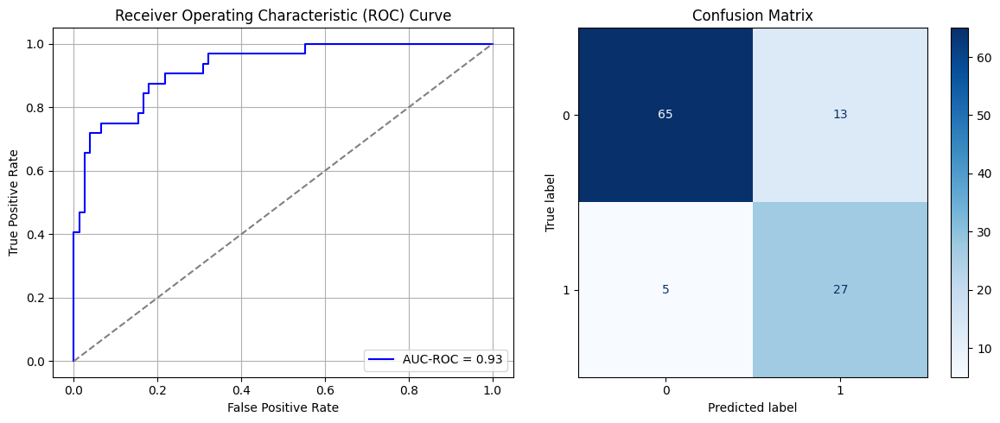

Best threshold based on F1-score: 0.8931317925453186
False Negative Rate: 0.15625
Time elapsed (performance): 0.5233793450006488
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - AUC: 0.7663 - loss: 0.6032 - val_AUC: 0.8883 - val_loss: 0.4365
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8908 - loss: 0.4083 - val_AUC: 0.9035 - val_loss: 0.3988
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9073 - loss: 0.3715 - val_AUC: 0.9082 - val_loss: 0.3899
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9144 - loss: 0.3602 - val_AUC: 0.9106 - val_loss: 0.3851
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9160 - loss: 0.3553 - val_AUC: 0.9117 - val_loss: 0.3890
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9220 - loss: 0.3479 - val_AUC: 0.9143 - val_loss: 0.3817
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9303 - loss: 0.3348 - val_AUC: 0.9139 - val_loss: 0.3802
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9239 - loss: 0.3427 - val_AUC: 0.9130 - val_loss: 0.3809
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9250 

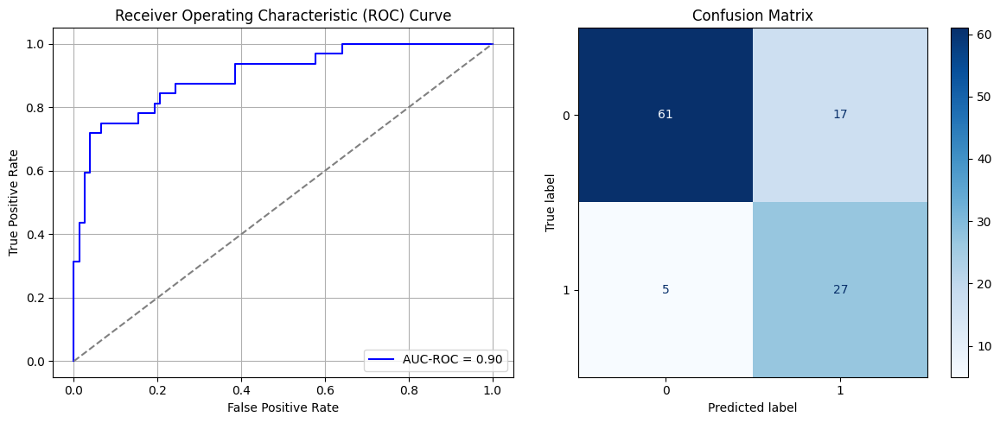

Best threshold based on F1-score: 0.8829076886177063
False Negative Rate: 0.15625
Time elapsed (performance): 0.4955522159998509
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7403 - loss: 0.6298 - val_AUC: 0.8930 - val_loss: 0.4286
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8858 - loss: 0.4255 - val_AUC: 0.9099 - val_loss: 0.3852
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9027 - loss: 0.3844 - val_AUC: 0.9146 - val_loss: 0.3780
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9131 - loss: 0.3641 - val_AUC: 0.9161 - val_loss: 0.3758
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9100 - loss: 0.3691 - val_AUC: 0.9148 - val_loss: 0.3858
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9220 - loss: 0.3452 - val_AUC: 0.9166 - val_loss: 0.3763
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9319 - loss: 0.3246 - val_AUC: 0.9174 - val_loss: 0.3724
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9291 - loss: 0.3320 - val_AUC: 0.9170 - val_loss: 0.3743
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9292 -

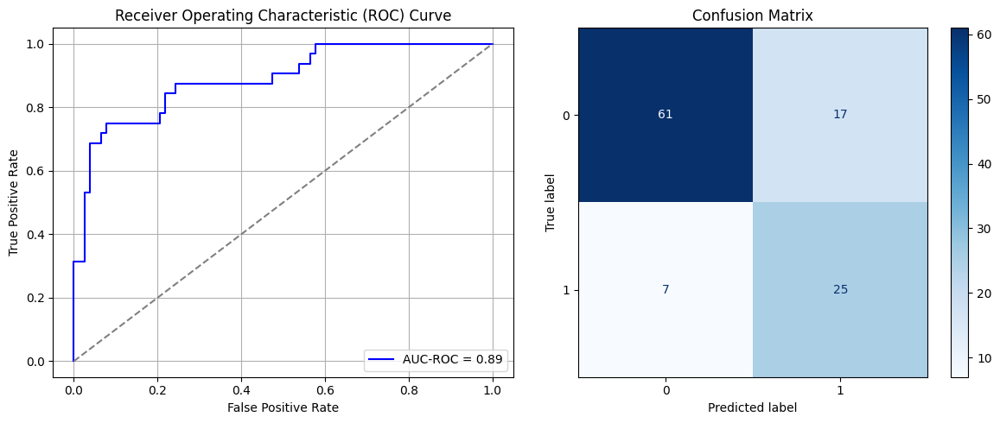

Best threshold based on F1-score: 0.7670390605926514
False Negative Rate: 0.21875
Time elapsed (performance): 0.518385978999504
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7487 - loss: 0.6126 - val_AUC: 0.8873 - val_loss: 0.4349
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8946 - loss: 0.4125 - val_AUC: 0.9055 - val_loss: 0.3988
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9082 - loss: 0.3827 - val_AUC: 0.9106 - val_loss: 0.3848
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9141 - loss: 0.3651 - val_AUC: 0.9109 - val_loss: 0.3822
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9150 - loss: 0.3585 - val_AUC: 0.9112 - val_loss: 0.3885
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9146 - loss: 0.3653 - val_AUC: 0.9121 - val_loss: 0.3841
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9145 - loss: 0.3604 - val_AUC: 0.9142 - val_loss: 0.3831
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9253 - loss: 0.3417 - val_AUC: 0.9152 - val_loss: 0.3939
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9277 -

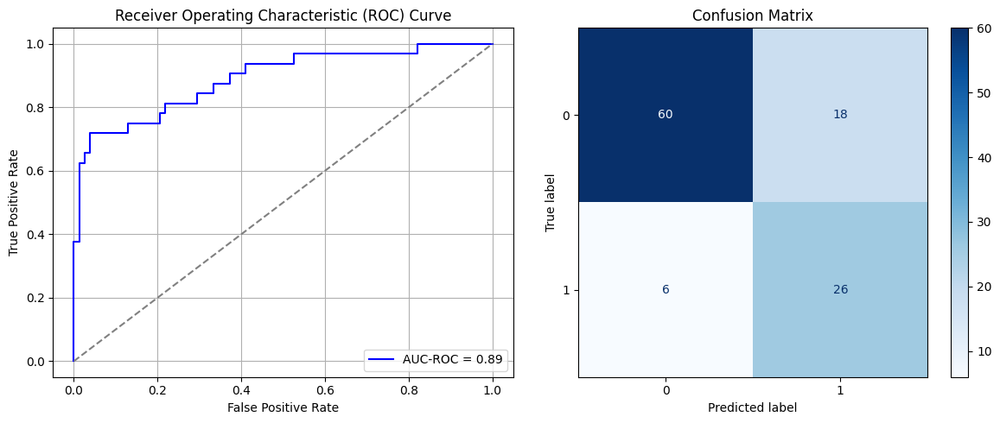

Best threshold based on F1-score: 0.9115896224975586
False Negative Rate: 0.1875
Time elapsed (performance): 0.5088880870007415
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6989 - loss: 0.6350 - val_AUC: 0.8785 - val_loss: 0.4572
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8927 - loss: 0.4140 - val_AUC: 0.8931 - val_loss: 0.4143
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9007 - loss: 0.3833 - val_AUC: 0.8977 - val_loss: 0.4073
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9127 - loss: 0.3657 - val_AUC: 0.8999 - val_loss: 0.4043
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9180 - loss: 0.3556 - val_AUC: 0.9028 - val_loss: 0.4030
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9130 - loss: 0.3618 - val_AUC: 0.9037 - val_loss: 0.4075
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9141 - loss: 0.3636 - val_AUC: 0.9029 - val_loss: 0.4239
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9253 - loss: 0.3405 - val_AUC: 0.9054 - val_loss: 0.3966
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9184 -

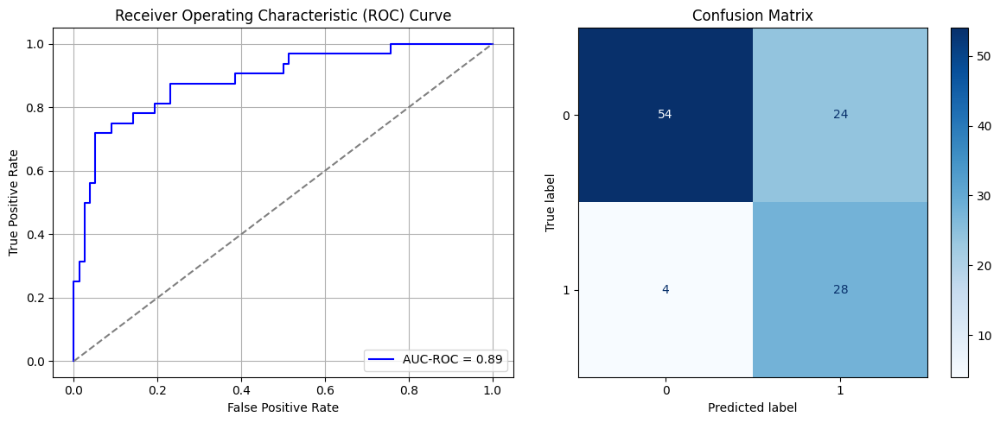

Best threshold based on F1-score: 0.9523158073425293
False Negative Rate: 0.125
Time elapsed (performance): 0.7275922869994247
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6772 - loss: 0.6445 - val_AUC: 0.8748 - val_loss: 0.4583
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.8881 - loss: 0.4264 - val_AUC: 0.8961 - val_loss: 0.4087
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9079 - loss: 0.3770 - val_AUC: 0.9043 - val_loss: 0.3959
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9068 - loss: 0.3774 - val_AUC: 0.9080 - val_loss: 0.3885
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9215 - loss: 0.3461 - val_AUC: 0.9068 - val_loss: 0.4279
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9233 - loss: 0.3487 - val_AUC: 0.9105 - val_loss: 0.3973
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9237 - loss: 0.3433 - val_AUC: 0.9118 - val_loss: 0.3823
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9341 - loss: 0.3198 - val_AUC: 0.9130 - val_loss: 0.3811
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9354 -

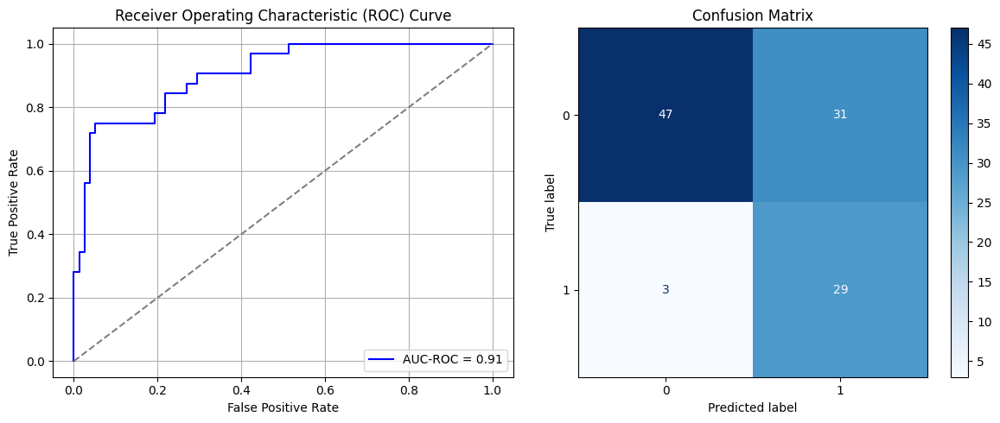

Best threshold based on F1-score: 0.92873615026474
False Negative Rate: 0.09375
Time elapsed (performance): 0.5661512269998639
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7973 - loss: 0.5917 - val_AUC: 0.8848 - val_loss: 0.4349
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8989 - loss: 0.3978 - val_AUC: 0.9042 - val_loss: 0.3900
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9114 - loss: 0.3734 - val_AUC: 0.9105 - val_loss: 0.3841
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9027 - loss: 0.3850 - val_AUC: 0.9117 - val_loss: 0.3800
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9183 - loss: 0.3541 - val_AUC: 0.9149 - val_loss: 0.3834
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9267 - loss: 0.3334 - val_AUC: 0.9148 - val_loss: 0.3762
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9256 - loss: 0.3358 - val_AUC: 0.9152 - val_loss: 0.3925
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9174 - loss: 0.3531 - val_AUC: 0.9168 - val_loss: 0.3704
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9267 -

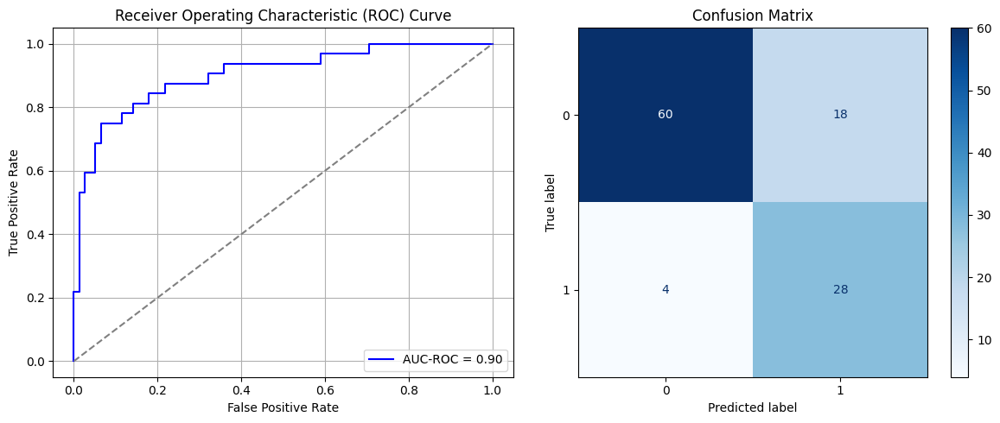

Best threshold based on F1-score: 0.8169585466384888
False Negative Rate: 0.125
Time elapsed (performance): 0.5041909669998859
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7714 - loss: 0.6124 - val_AUC: 0.8740 - val_loss: 0.4490
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8704 - loss: 0.4400 - val_AUC: 0.8973 - val_loss: 0.4176
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9017 - loss: 0.3934 - val_AUC: 0.9046 - val_loss: 0.4018
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9148 - loss: 0.3600 - val_AUC: 0.9088 - val_loss: 0.3918
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9165 - loss: 0.3595 - val_AUC: 0.9092 - val_loss: 0.3877
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9118 - loss: 0.3651 - val_AUC: 0.9104 - val_loss: 0.3866
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9273 - loss: 0.3375 - val_AUC: 0.9125 - val_loss: 0.3925
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9211 - loss: 0.3457 - val_AUC: 0.9107 - val_loss: 0.3988
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9210 -

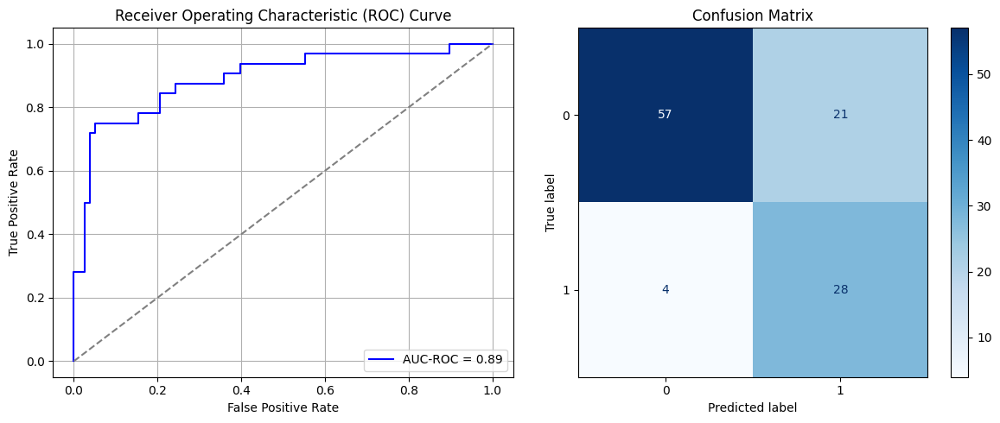

Best threshold based on F1-score: 0.9088717103004456
False Negative Rate: 0.125
Time elapsed (performance): 0.5174255980000453
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7632 - loss: 0.6037 - val_AUC: 0.8783 - val_loss: 0.4424
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8880 - loss: 0.4132 - val_AUC: 0.8982 - val_loss: 0.4058
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - AUC: 0.9049 - loss: 0.3836 - val_AUC: 0.9056 - val_loss: 0.3998
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9133 - loss: 0.3627 - val_AUC: 0.9096 - val_loss: 0.3901
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9132 - loss: 0.3641 - val_AUC: 0.9086 - val_loss: 0.4120
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9273 - loss: 0.3334 - val_AUC: 0.9108 - val_loss: 0.3899
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9252 - loss: 0.3326 - val_AUC: 0.9111 - val_loss: 0.3984
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9273 - loss: 0.3311 - val_AUC: 0.9114 - val_loss: 0.3845
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9280 -

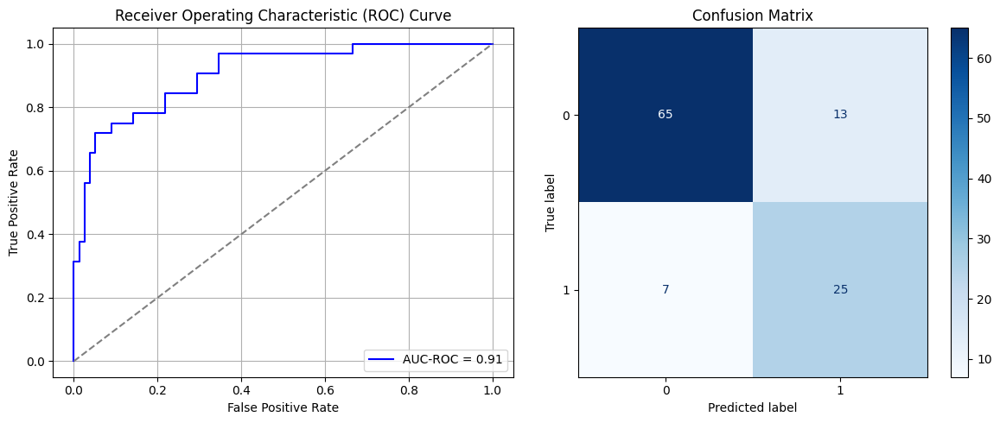

Best threshold based on F1-score: 0.8715779185295105
False Negative Rate: 0.21875
Time elapsed (performance): 0.5253367860004801
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7658 - loss: 0.6101 - val_AUC: 0.8660 - val_loss: 0.4667
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8878 - loss: 0.4223 - val_AUC: 0.8899 - val_loss: 0.4216
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9058 - loss: 0.3808 - val_AUC: 0.8983 - val_loss: 0.4092
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9208 - loss: 0.3514 - val_AUC: 0.9027 - val_loss: 0.4020
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9148 - loss: 0.3620 - val_AUC: 0.9029 - val_loss: 0.4020
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9206 - loss: 0.3473 - val_AUC: 0.9043 - val_loss: 0.4102
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9089 - loss: 0.3724 - val_AUC: 0.9052 - val_loss: 0.4000
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9196 - loss: 0.3480 - val_AUC: 0.9056 - val_loss: 0.3993
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9292 -

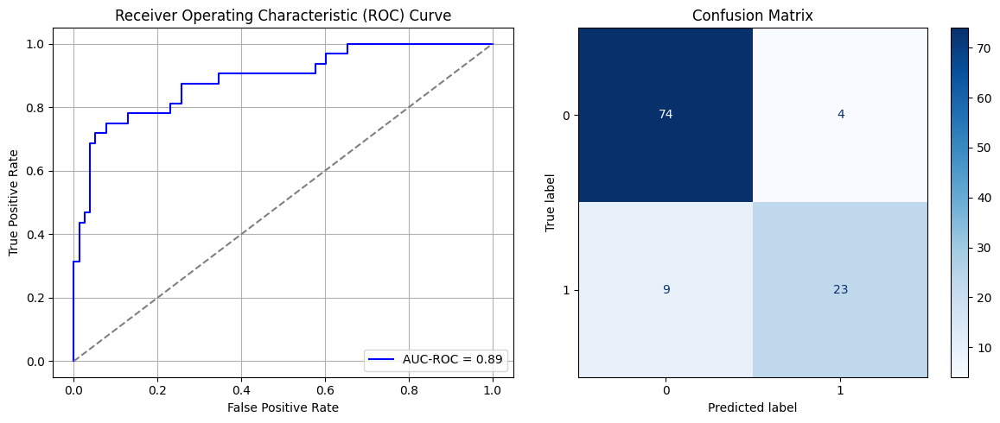

Best threshold based on F1-score: 0.501509428024292
False Negative Rate: 0.28125
Time elapsed (performance): 0.5387109959992813
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.8046 - loss: 0.5941 - val_AUC: 0.8719 - val_loss: 0.4480
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8891 - loss: 0.4094 - val_AUC: 0.8873 - val_loss: 0.4232
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9098 - loss: 0.3750 - val_AUC: 0.8937 - val_loss: 0.4194
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9046 - loss: 0.3812 - val_AUC: 0.8957 - val_loss: 0.4122
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9061 - loss: 0.3757 - val_AUC: 0.8961 - val_loss: 0.4089
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9191 - loss: 0.3488 - val_AUC: 0.8974 - val_loss: 0.4097
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9118 - loss: 0.3606 - val_AUC: 0.8989 - val_loss: 0.4078
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9179 - loss: 0.3467 - val_AUC: 0.8997 - val_loss: 0.4157
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9240 -

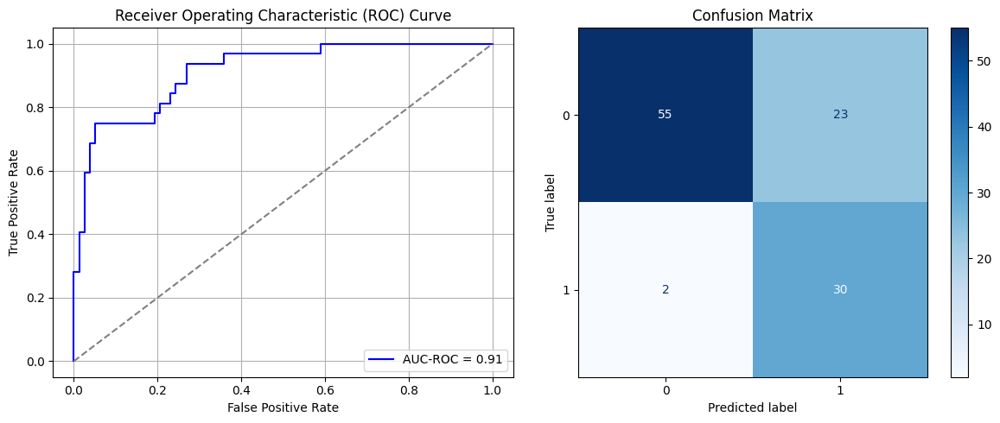

Best threshold based on F1-score: 0.8652979135513306
False Negative Rate: 0.0625
Time elapsed (performance): 0.5153410740003892
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7504 - loss: 0.6198 - val_AUC: 0.8824 - val_loss: 0.4416
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8910 - loss: 0.4158 - val_AUC: 0.9011 - val_loss: 0.4006
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9033 - loss: 0.3851 - val_AUC: 0.9083 - val_loss: 0.3891
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9026 - loss: 0.3827 - val_AUC: 0.9114 - val_loss: 0.3873
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9203 - loss: 0.3462 - val_AUC: 0.9122 - val_loss: 0.3853
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9164 - loss: 0.3570 - val_AUC: 0.9138 - val_loss: 0.3789
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9156 - loss: 0.3614 - val_AUC: 0.9143 - val_loss: 0.3839
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9294 - loss: 0.3286 - val_AUC: 0.9145 - val_loss: 0.3851
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9259 -

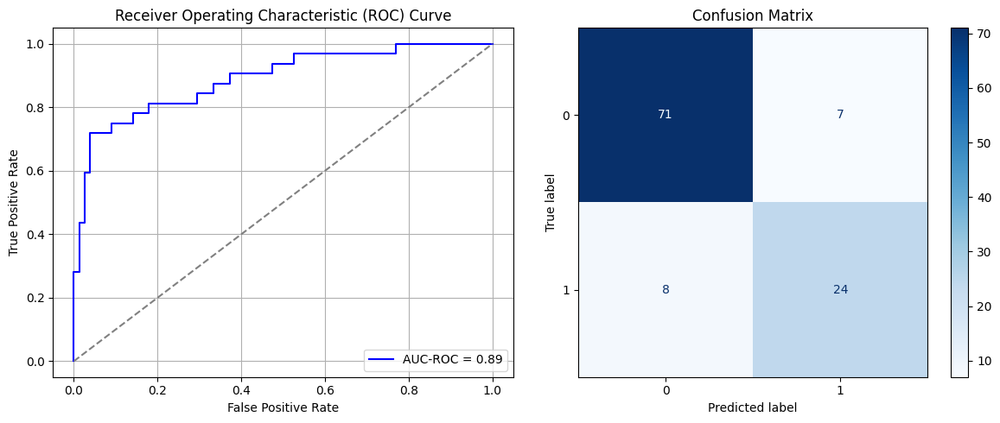

Best threshold based on F1-score: 0.7647055983543396
False Negative Rate: 0.25
Time elapsed (performance): 0.509260043998438
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7587 - loss: 0.6123 - val_AUC: 0.8887 - val_loss: 0.4376
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8926 - loss: 0.4110 - val_AUC: 0.9003 - val_loss: 0.4296
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9092 - loss: 0.3750 - val_AUC: 0.9058 - val_loss: 0.3978
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9124 - loss: 0.3659 - val_AUC: 0.9070 - val_loss: 0.3983
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9076 - loss: 0.3784 - val_AUC: 0.9095 - val_loss: 0.3913
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9109 - loss: 0.3625 - val_AUC: 0.9086 - val_loss: 0.3954
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9147 - loss: 0.3566 - val_AUC: 0.9090 - val_loss: 0.3890
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9211 - loss: 0.3442 - val_AUC: 0.9111 - val_loss: 0.3910
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9176 -

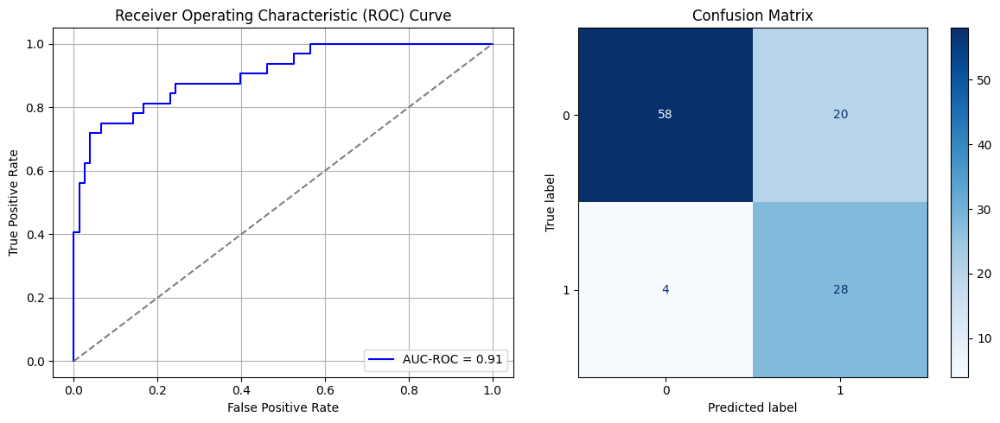

Best threshold based on F1-score: 0.9121043086051941
False Negative Rate: 0.125
Time elapsed (performance): 0.5720244290005212
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7400 - loss: 0.6193 - val_AUC: 0.8704 - val_loss: 0.4547
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8829 - loss: 0.4254 - val_AUC: 0.8900 - val_loss: 0.4215
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9109 - loss: 0.3724 - val_AUC: 0.8974 - val_loss: 0.4104
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9173 - loss: 0.3548 - val_AUC: 0.9010 - val_loss: 0.4033
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9207 - loss: 0.3517 - val_AUC: 0.9023 - val_loss: 0.4064
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9247 - loss: 0.3391 - val_AUC: 0.9052 - val_loss: 0.3987
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9232 - loss: 0.3453 - val_AUC: 0.9045 - val_loss: 0.4007
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9228 - loss: 0.3412 - val_AUC: 0.9057 - val_loss: 0.3992
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9264 -

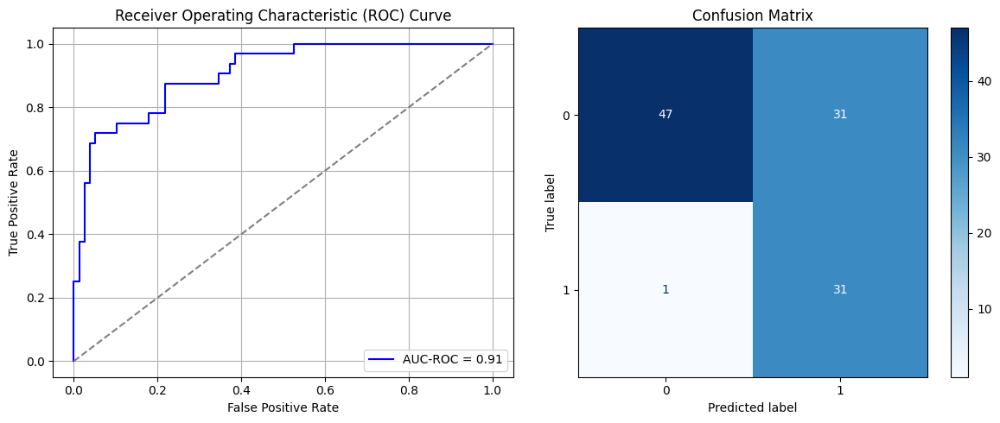

Best threshold based on F1-score: 0.9584059715270996
False Negative Rate: 0.03125
Time elapsed (performance): 0.5274794450015179
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7870 - loss: 0.6267 - val_AUC: 0.8802 - val_loss: 0.4451
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8919 - loss: 0.4146 - val_AUC: 0.8971 - val_loss: 0.4344
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8948 - loss: 0.3971 - val_AUC: 0.9028 - val_loss: 0.4028
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9092 - loss: 0.3748 - val_AUC: 0.9064 - val_loss: 0.3952
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9065 - loss: 0.3779 - val_AUC: 0.9083 - val_loss: 0.3901
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9235 - loss: 0.3390 - val_AUC: 0.9086 - val_loss: 0.3883
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9213 - loss: 0.3497 - val_AUC: 0.9095 - val_loss: 0.3863
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9283 - loss: 0.3330 - val_AUC: 0.9098 - val_loss: 0.3973
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9230 -

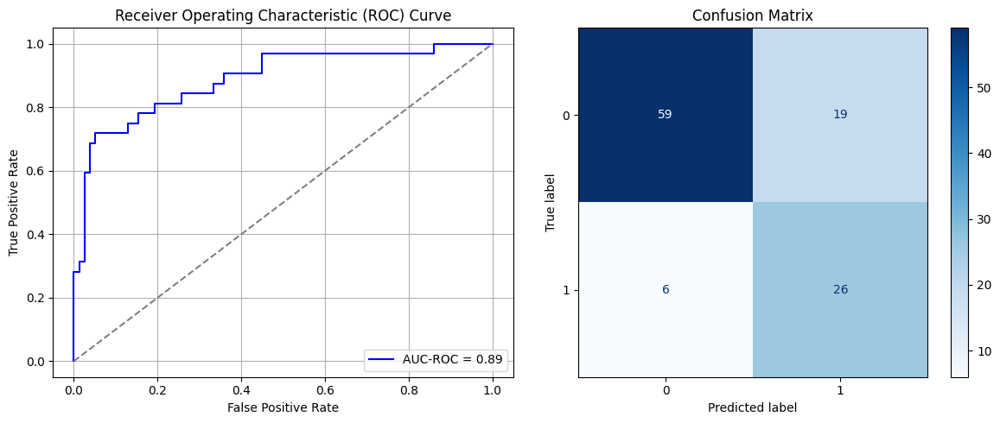

Best threshold based on F1-score: 0.8679297566413879
False Negative Rate: 0.1875
Time elapsed (performance): 0.5606144730008964
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.7910 - loss: 0.5965 - val_AUC: 0.8872 - val_loss: 0.4303
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8872 - loss: 0.4170 - val_AUC: 0.9020 - val_loss: 0.3989
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9038 - loss: 0.3854 - val_AUC: 0.9080 - val_loss: 0.3955
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9128 - loss: 0.3652 - val_AUC: 0.9101 - val_loss: 0.3885
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9119 - loss: 0.3691 - val_AUC: 0.9122 - val_loss: 0.3871
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9216 - loss: 0.3447 - val_AUC: 0.9136 - val_loss: 0.3837
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9160 - loss: 0.3562 - val_AUC: 0.9143 - val_loss: 0.3813
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9217 - loss: 0.3424 - val_AUC: 0.9140 - val_loss: 0.3880
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9236 -

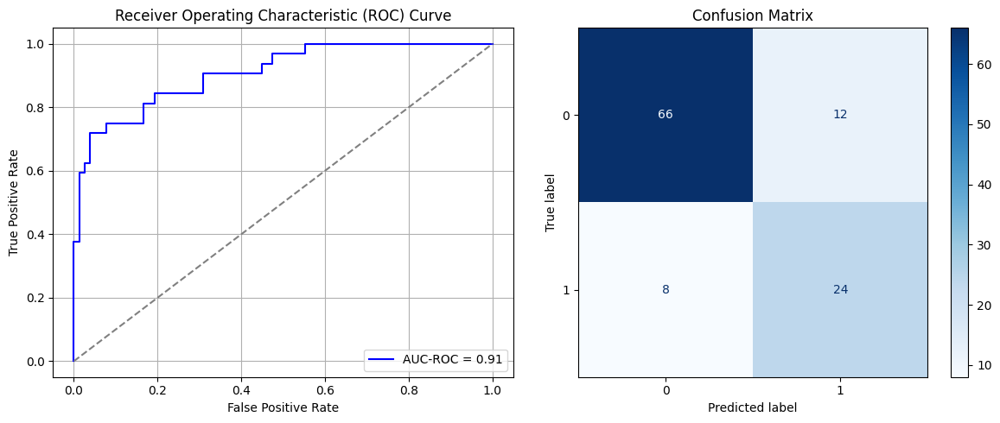

Best threshold based on F1-score: 0.845015287399292
False Negative Rate: 0.25
Time elapsed (performance): 0.5069043729999976
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7244 - loss: 0.6180 - val_AUC: 0.8835 - val_loss: 0.4568
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8793 - loss: 0.4331 - val_AUC: 0.9002 - val_loss: 0.4041
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9034 - loss: 0.3835 - val_AUC: 0.9044 - val_loss: 0.3971
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9150 - loss: 0.3620 - val_AUC: 0.9054 - val_loss: 0.4016
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9122 - loss: 0.3682 - val_AUC: 0.9060 - val_loss: 0.3956
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9063 - loss: 0.3786 - val_AUC: 0.9083 - val_loss: 0.3927
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9182 - loss: 0.3536 - val_AUC: 0.9070 - val_loss: 0.3943
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9145 - loss: 0.3621 - val_AUC: 0.9071 - val_loss: 0.3969
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9293 -

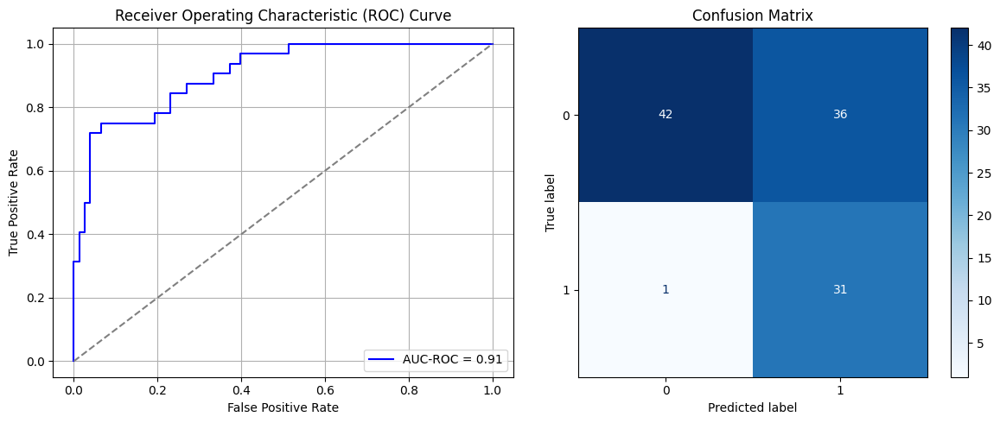

Best threshold based on F1-score: 0.9638186097145081
False Negative Rate: 0.03125
Time elapsed (performance): 0.5160724090001167
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7601 - loss: 0.6121 - val_AUC: 0.8814 - val_loss: 0.4576
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8849 - loss: 0.4238 - val_AUC: 0.8956 - val_loss: 0.4092
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8989 - loss: 0.3912 - val_AUC: 0.9021 - val_loss: 0.3982
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9172 - loss: 0.3596 - val_AUC: 0.9065 - val_loss: 0.3940
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9113 - loss: 0.3689 - val_AUC: 0.9089 - val_loss: 0.3940
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - AUC: 0.9215 - loss: 0.3475 - val_AUC: 0.9092 - val_loss: 0.4212
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9173 - loss: 0.3583 - val_AUC: 0.9116 - val_loss: 0.3846
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9191 - loss: 0.3544 - val_AUC: 0.9123 - val_loss: 0.3888
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9267 -

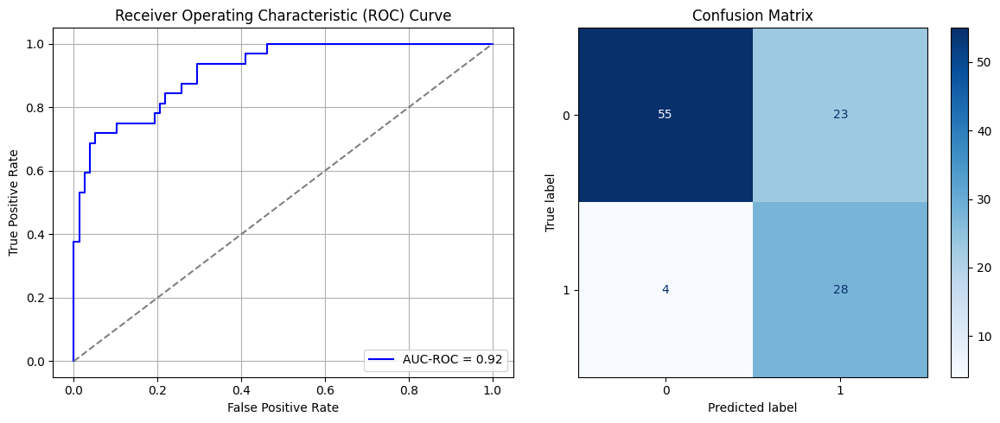

Best threshold based on F1-score: 0.9122370481491089
False Negative Rate: 0.125
Time elapsed (performance): 0.5371755390006001
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7755 - loss: 0.5993 - val_AUC: 0.8773 - val_loss: 0.4466
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8879 - loss: 0.4177 - val_AUC: 0.8911 - val_loss: 0.4512
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9027 - loss: 0.3899 - val_AUC: 0.8993 - val_loss: 0.4108
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9119 - loss: 0.3680 - val_AUC: 0.9036 - val_loss: 0.4111
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9116 - loss: 0.3679 - val_AUC: 0.9058 - val_loss: 0.4156
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9193 - loss: 0.3547 - val_AUC: 0.9074 - val_loss: 0.3958
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9120 - loss: 0.3660 - val_AUC: 0.9071 - val_loss: 0.3936
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.9181 - loss: 0.3542 - val_AUC: 0.9082 - val_loss: 0.3905
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9329 -

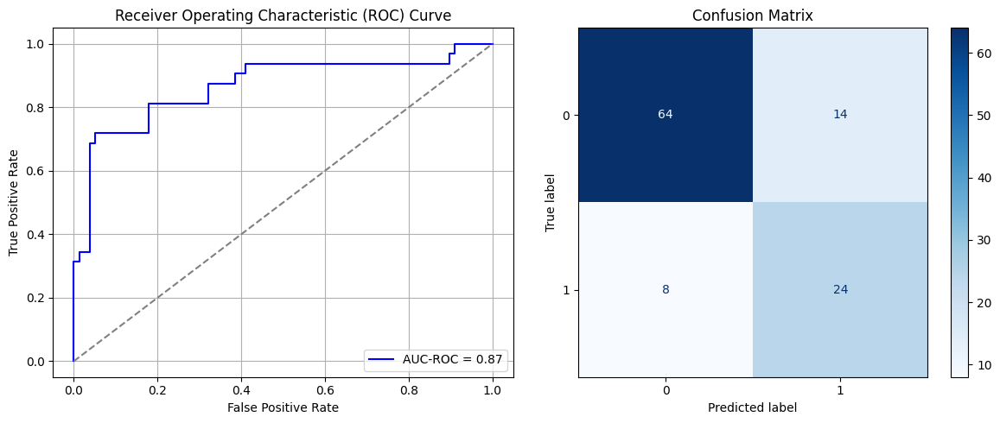

Best threshold based on F1-score: 0.8637003898620605
False Negative Rate: 0.25
Time elapsed (performance): 0.4888920279990998
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8062 - loss: 0.6022 - val_AUC: 0.8939 - val_loss: 0.4192
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8910 - loss: 0.4140 - val_AUC: 0.9098 - val_loss: 0.3859
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8967 - loss: 0.3965 - val_AUC: 0.9114 - val_loss: 0.3801
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9067 - loss: 0.3787 - val_AUC: 0.9139 - val_loss: 0.3750
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9187 - loss: 0.3575 - val_AUC: 0.9156 - val_loss: 0.3802
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9202 - loss: 0.3448 - val_AUC: 0.9162 - val_loss: 0.3716
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9166 - loss: 0.3538 - val_AUC: 0.9160 - val_loss: 0.3714
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9189 - loss: 0.3520 - val_AUC: 0.9179 - val_loss: 0.3679
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9242 -

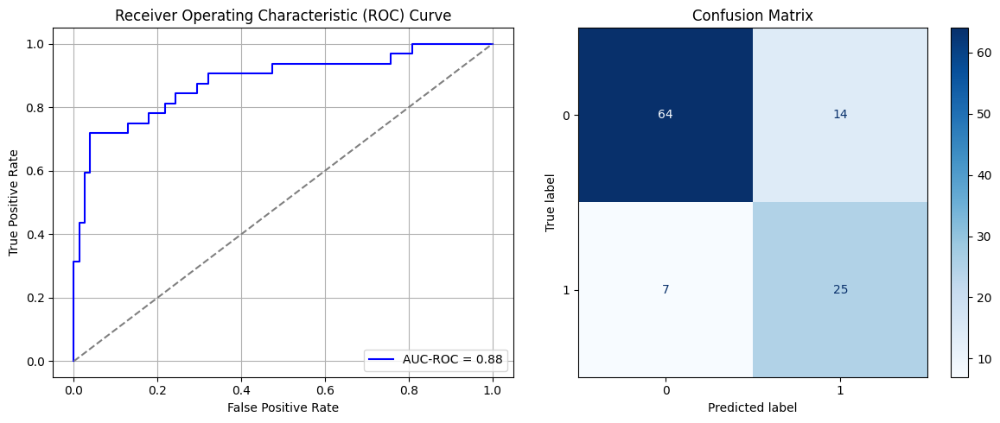

Best threshold based on F1-score: 0.8179521560668945
False Negative Rate: 0.21875
Time elapsed (performance): 0.7518310840005142
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.7734 - loss: 0.5965 - val_AUC: 0.8975 - val_loss: 0.4209
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8881 - loss: 0.4164 - val_AUC: 0.9124 - val_loss: 0.3872
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9016 - loss: 0.3858 - val_AUC: 0.9196 - val_loss: 0.3697
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9034 - loss: 0.3770 - val_AUC: 0.9223 - val_loss: 0.3663
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9155 - loss: 0.3570 - val_AUC: 0.9234 - val_loss: 0.3640
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9142 - loss: 0.3611 - val_AUC: 0.9230 - val_loss: 0.3630
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9146 - loss: 0.3581 - val_AUC: 0.9245 - val_loss: 0.3611
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9236 - loss: 0.3386 - val_AUC: 0.9248 - val_loss: 0.3632
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9259 -

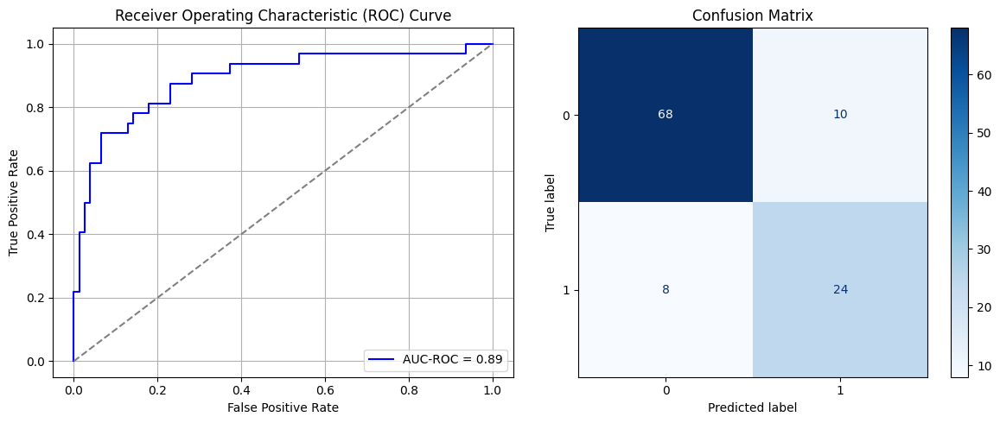

Best threshold based on F1-score: 0.6195647716522217
False Negative Rate: 0.25
Time elapsed (performance): 0.5022988280015852
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.7222 - loss: 0.6189 - val_AUC: 0.8822 - val_loss: 0.4424
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8833 - loss: 0.4263 - val_AUC: 0.8970 - val_loss: 0.4090
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8952 - loss: 0.4010 - val_AUC: 0.9033 - val_loss: 0.4092
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9200 - loss: 0.3529 - val_AUC: 0.9086 - val_loss: 0.3977
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9152 - loss: 0.3603 - val_AUC: 0.9092 - val_loss: 0.3887
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9086 - loss: 0.3706 - val_AUC: 0.9101 - val_loss: 0.3890
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9317 - loss: 0.3216 - val_AUC: 0.9117 - val_loss: 0.3858
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9169 - loss: 0.3574 - val_AUC: 0.9127 - val_loss: 0.3858
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9263 -

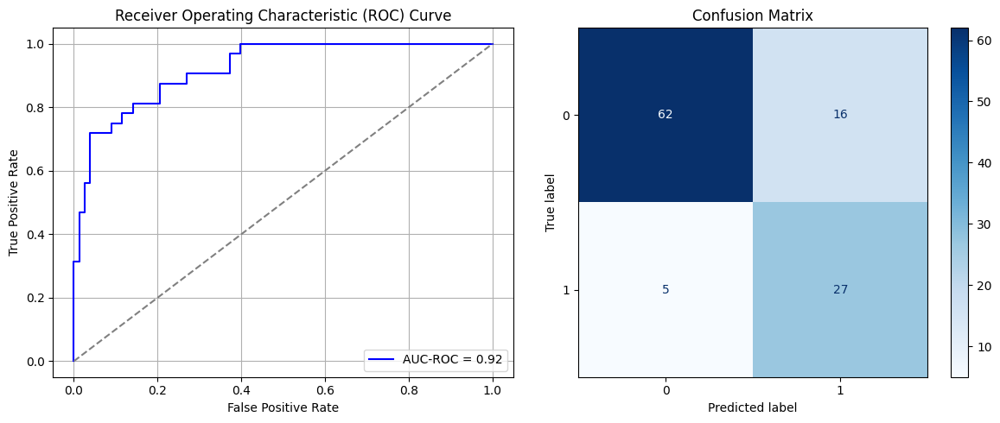

Best threshold based on F1-score: 0.8921401500701904
False Negative Rate: 0.15625
Time elapsed (performance): 0.5476259240003856
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7952 - loss: 0.5807 - val_AUC: 0.8803 - val_loss: 0.4394
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8774 - loss: 0.4345 - val_AUC: 0.8957 - val_loss: 0.4064
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9091 - loss: 0.3758 - val_AUC: 0.9031 - val_loss: 0.3984
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9031 - loss: 0.3776 - val_AUC: 0.9026 - val_loss: 0.3972
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9128 - loss: 0.3629 - val_AUC: 0.9045 - val_loss: 0.3964
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9148 - loss: 0.3629 - val_AUC: 0.9054 - val_loss: 0.3915
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9193 - loss: 0.3479 - val_AUC: 0.9057 - val_loss: 0.3956
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9207 - loss: 0.3517 - val_AUC: 0.9069 - val_loss: 0.3993
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9297 -

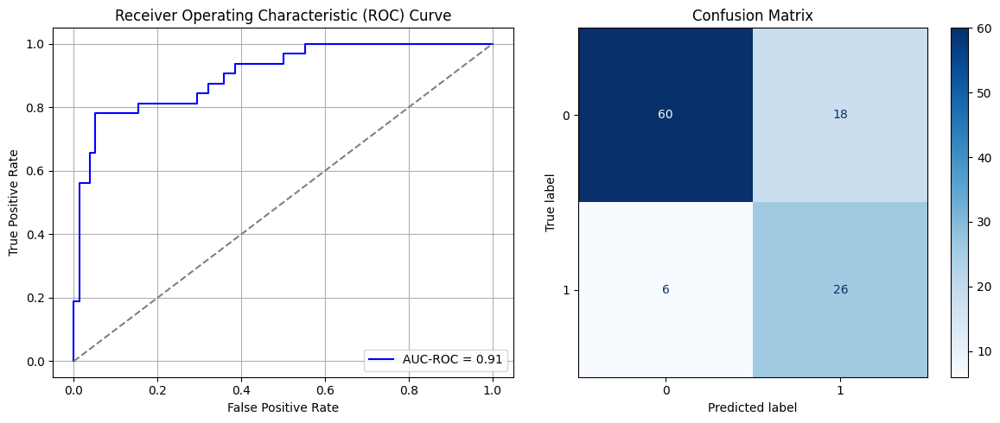

Best threshold based on F1-score: 0.7615839242935181
False Negative Rate: 0.1875
Time elapsed (performance): 0.5582015059990226
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8060 - loss: 0.5924 - val_AUC: 0.8847 - val_loss: 0.4305
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8840 - loss: 0.4224 - val_AUC: 0.9002 - val_loss: 0.4042
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8985 - loss: 0.3931 - val_AUC: 0.9059 - val_loss: 0.4047
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9156 - loss: 0.3574 - val_AUC: 0.9086 - val_loss: 0.3878
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9101 - loss: 0.3712 - val_AUC: 0.9100 - val_loss: 0.3896
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9097 - loss: 0.3709 - val_AUC: 0.9099 - val_loss: 0.3885
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9156 - loss: 0.3574 - val_AUC: 0.9111 - val_loss: 0.3875
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9183 - loss: 0.3516 - val_AUC: 0.9111 - val_loss: 0.3881
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9224 -

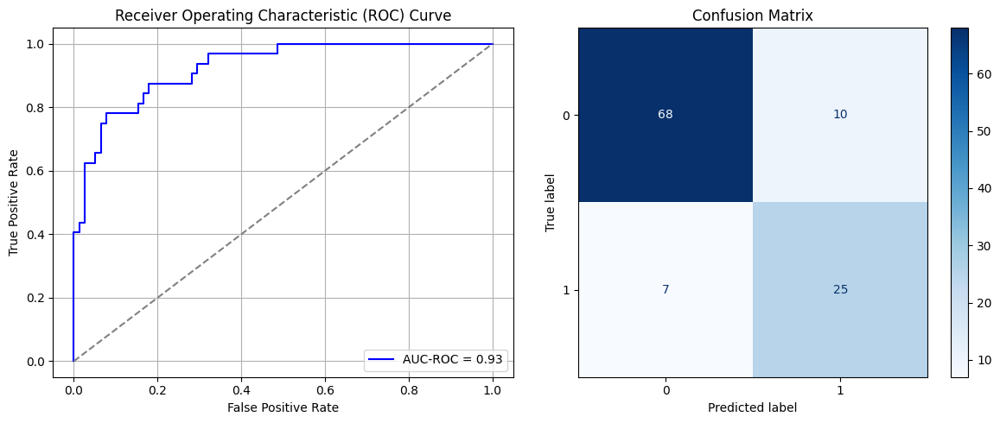

Best threshold based on F1-score: 0.7525495290756226
False Negative Rate: 0.21875
Time elapsed (performance): 0.732566646000123
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7536 - loss: 0.6239 - val_AUC: 0.8758 - val_loss: 0.4532
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8767 - loss: 0.4412 - val_AUC: 0.8975 - val_loss: 0.4082
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8921 - loss: 0.4074 - val_AUC: 0.9055 - val_loss: 0.3937
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9090 - loss: 0.3709 - val_AUC: 0.9097 - val_loss: 0.3880
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9072 - loss: 0.3740 - val_AUC: 0.9133 - val_loss: 0.3805
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9208 - loss: 0.3433 - val_AUC: 0.9143 - val_loss: 0.3788
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9121 - loss: 0.3612 - val_AUC: 0.9128 - val_loss: 0.3872
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9281 - loss: 0.3342 - val_AUC: 0.9118 - val_loss: 0.3948
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9192 -

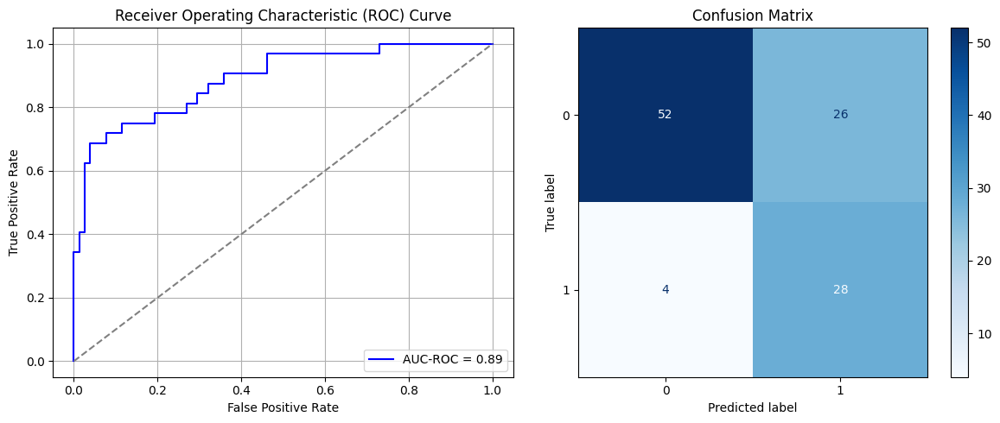

Best threshold based on F1-score: 0.9333468675613403
False Negative Rate: 0.125
Time elapsed (performance): 0.5731114430000162
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.7114 - loss: 0.6264 - val_AUC: 0.8780 - val_loss: 0.4541
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8743 - loss: 0.4404 - val_AUC: 0.8981 - val_loss: 0.4147
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9060 - loss: 0.3826 - val_AUC: 0.9087 - val_loss: 0.3925
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9154 - loss: 0.3611 - val_AUC: 0.9114 - val_loss: 0.3853
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9197 - loss: 0.3500 - val_AUC: 0.9129 - val_loss: 0.3990
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9267 - loss: 0.3396 - val_AUC: 0.9144 - val_loss: 0.3795
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9148 - loss: 0.3634 - val_AUC: 0.9147 - val_loss: 0.3831
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9207 - loss: 0.3457 - val_AUC: 0.9151 - val_loss: 0.3836
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9194 -

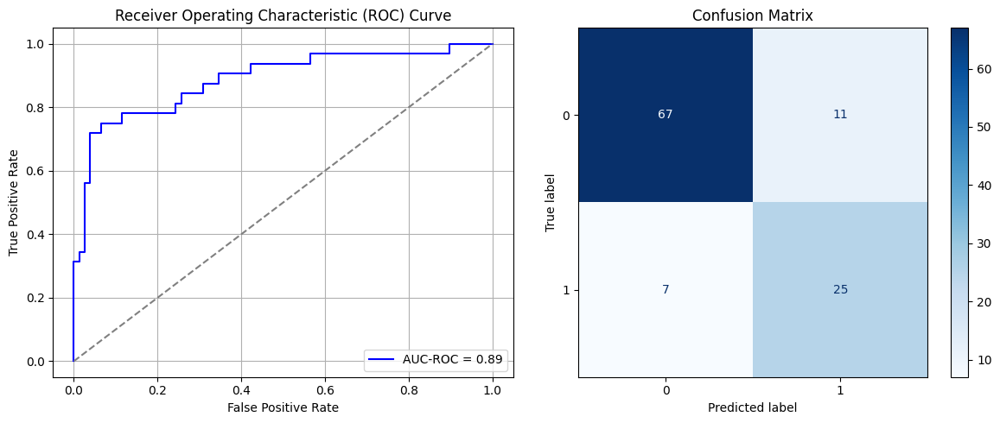

Best threshold based on F1-score: 0.820590615272522
False Negative Rate: 0.21875
Time elapsed (performance): 0.5153966279995075
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.7365 - loss: 0.6222 - val_AUC: 0.8793 - val_loss: 0.4404
Epoch 2/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8780 - loss: 0.4284 - val_AUC: 0.8991 - val_loss: 0.4026
Epoch 3/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8980 - loss: 0.3934 - val_AUC: 0.9068 - val_loss: 0.4154
Epoch 4/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9091 - loss: 0.3764 - val_AUC: 0.9102 - val_loss: 0.4005
Epoch 5/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9188 - loss: 0.3531 - val_AUC: 0.9140 - val_loss: 0.3816
Epoch 6/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9209 - loss: 0.3441 - val_AUC: 0.9147 - val_loss: 0.3815
Epoch 7/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9150 - loss: 0.3568 - val_AUC: 0.9144 - val_loss: 0.3796
Epoch 8/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9257 - loss: 0.3347 - val_AUC: 0.9149 - val_loss: 0.3794
Epoch 9/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9337 -

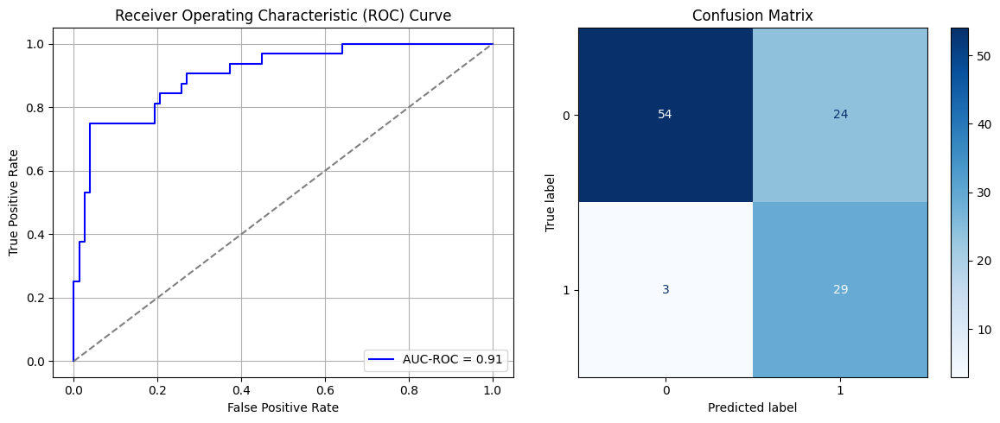

Best threshold based on F1-score: 0.915961503982544
False Negative Rate: 0.09375
Time elapsed (performance): 0.4889191540005413


In [78]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = 10
Nsamples = k*(oversample_size-undersample_size)/undersample_size



for i in range(times):
    start = np.random.choice(int(k), int(Nsamples), replace=True)
    Row = []
    for j in range(len(start)):
      for i in range(int(undersample_size/k)):
        row = start[j]+int(k*i)-1
        Row.append(row)
    data_S_min_ros = pd.DataFrame()
    data_S_min_ros = data_S_minority.iloc[Row]
    data_S_Sy_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_Sy_ROS = data_S_Sy_ROS.iloc[:, :-1]
    y_S_Sy_ROS = data_S_Sy_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy_ROS, y_S_Sy_ROS, test_size=0.20, random_state=0)
    model_Sy_ROS = create_dnn_model(X_S_train.shape[1])
    result_Sy_ROS = train_and_evaluate(model_Sy_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy_ROS = Transductive_TL(model_Sy_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_Sy_ROS)
    FPR.append(result_TL_Sy_ROS[0])
    TNR.append(result_TL_Sy_ROS[1])
    FNR.append(result_TL_Sy_ROS[2])
    TPR.append(result_TL_Sy_ROS[3])
    TL_time.append(result_TL_Sy_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [79]:
print(ParamFit)
ParamFit.to_csv('Sy_ROS2.csv')

    Source time       FPR       TNR      FNR      TPR  Target time
0      9.309035  0.153846  0.846154  0.25000  0.75000     0.446415
1      6.696993  0.102564  0.897436  0.28125  0.71875     0.659836
2      8.203973  0.320513  0.679487  0.12500  0.87500     0.484472
3      8.871136  0.320513  0.679487  0.12500  0.87500     0.487581
4      9.848917  0.166667  0.833333  0.21875  0.78125     0.464651
5      8.381522  0.064103  0.935897  0.18750  0.81250     0.651417
6      7.777831  0.358974  0.641026  0.03125  0.96875     0.476436
7      8.103846  0.230769  0.769231  0.15625  0.84375     0.470884
8      7.942766  0.217949  0.782051  0.15625  0.84375     0.672664
9      7.990054  0.153846  0.846154  0.21875  0.78125     0.488897
10     9.226479  0.102564  0.897436  0.25000  0.75000     0.482458
11     9.305057  0.217949  0.782051  0.15625  0.84375     0.476651
12     8.540341  0.333333  0.666667  0.12500  0.87500     0.704579
13     7.645147  0.153846  0.846154  0.25000  0.75000     0.45